# Simple PINN for an elastic plate with an elliptical hole 

## Geometry

We want to model a quarter of a plate with an elliptical hole. The domain itself is represented by collocation points, the boundaries are represented by uniformly sampled points along the perimeter.

In [36]:
import torch
from torch.optim.lr_scheduler import StepLR, ExponentialLR
import numpy as np
from scipy.stats import qmc
from plotly.express.colors import sequential
import plotly.graph_objects as go
import plotly.figure_factory as ff
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
import pandas as pd
import seaborn as sns


torch.set_default_dtype(torch.float64)
from global_constants import L, R, MU, LBD, N1, N2

from new_plate_elliptic_hole import Plate 

# Elliptical axis in x direction
Rx = 0.14
Ry = R**2 / Rx
# Edge samples
N = 50 #40
# Number of collocation points
M = 500 #500

# Epochs
epochs = 15000#5000
# Batch size
batch_size = 64 #64
# Learning rate
lr = 0.001 #0.0005 
# Scheduler step width
scheduler_step = 2000
# Gamma factor of scheduler
scheduler_gamma = 0.8
expo_gamma = 0.9998
# Number of hidden neurons
hn = 256 #recommended by wang et al

#step width for updating weights
step_size = 1200
#HNEU_split*epochs ->moment for splitting total_NEU to NEU and HNEU 
HNEU_split = 0.0



def generate_radii_list(min_Ra_x, max_Ra_x, step):
    if step == 0:
        rad_x_list = [min_Ra_x, max_Ra_x]
    else:
        num_steps = int((max_Ra_x - min_Ra_x) / step) + 1
        rad_x_list = np.linspace(min_Ra_x, max_Ra_x, num_steps)
        rad_x_list = [round(rad_x, 2) for rad_x in rad_x_list]
    rad_y_list = []
    for rad_x in rad_x_list:
        rad_y_list.append(R**2 / rad_x)
    return rad_x_list, rad_y_list

def generate_multiple_plates(min_Ra_x, max_Ra_x, step_size):

    list_collo = torch.empty(0,3,requires_grad=True)
    list_top = torch.empty(0,3,requires_grad=True)
    list_right = torch.empty(0,3,requires_grad=True)
    list_left = torch.empty(0,3,requires_grad=True)
    list_bottom = torch.empty(0,3,requires_grad=True)
    list_hole = torch.empty(0,5,requires_grad=True)

    rad_x_list, rad_y_list = generate_radii_list(min_Ra_x, max_Ra_x, step_size)
    for rad_x in rad_x_list:
        p1 = Plate(rad_x, N, M)
        #data_one_plate -> [collocation, top, right, left, bottom, hole, n_hole]
        collo_points, top_points, right_points, left_points, bottom_points, hole_points = p1.generate_dataset()
        list_collo = torch.cat((list_collo, collo_points), dim=0)
        list_top = torch.cat((list_top, top_points), dim=0)
        list_right = torch.cat((list_right, right_points), dim=0)
        list_left = torch.cat((list_left, left_points), dim=0)
        list_bottom = torch.cat((list_bottom, bottom_points), dim=0)
        list_hole = torch.cat((list_hole, hole_points), dim=0)
        
    return list_collo, list_top, list_right, list_left, list_bottom, list_hole 

def generate_multiple_plates_dict(min_Ra_x, max_Ra_x):
    dict_plate_points = dict()
    tuples = [
            ("x_collo", 0, 0),
            ("y_collo", 0, 1),
            ("x_top", 1, 0),
            ("y_top", 1, 1),
            ("x_right", 2, 0),
            ("y_right", 2, 1),
            ("x_left", 3, 0),
            ("y_left", 3, 1),
            ("x_bottom", 4, 0),
            ("y_bottom", 4, 1),
            ("x_hole", 5, 0),
            ("y_hole", 5, 1),   
        ] 
    
    rad_x_list, rad_y_list = generate_radii_list(min_Ra_x, max_Ra_x, 0.01)
    for rad_x in rad_x_list:
        p1 = Plate(rad_x, N, M)
        #data_one_plate -> [collocation, top, right, left, bottom, hole, n_hole]
        data_one_plate = p1.generate_dataset()

        for tuple in tuples:
            key = tuple[0]
            dict_plate_points.setdefault(key, []).append(data_one_plate[tuple[1]][:,tuple[2]])
        #plotting one plate
        #p1.plot_plate_with_hole(*data_one_plate)
    for key in dict_plate_points: 
        #appending list of tensors to one tensor
        dict_plate_points[key] = torch.cat(dict_plate_points[key])
        print(key, "besteht aus",dict_plate_points[key].size(), "Datenpunkten")

    collo_points = torch.column_stack([dict_plate_points["x_collo"], dict_plate_points["y_collo"]])
    top_points = torch.column_stack([dict_plate_points["x_top"], dict_plate_points["y_top"]])
    right_points = torch.column_stack([dict_plate_points["x_right"], dict_plate_points["y_right"]])
    left_points = torch.column_stack([dict_plate_points["x_left"], dict_plate_points["y_left"]])
    bottom_points = torch.column_stack([dict_plate_points["x_bottom"], dict_plate_points["y_bottom"]])
    hole_points = torch.column_stack([dict_plate_points["x_hole"], dict_plate_points["y_hole"]])

    return collo_points, top_points, right_points, left_points, bottom_points, hole_points



p99 = Plate(0.14, N, M)
collocation, top, right, left, bottom, hole = p99.generate_dataset()
p99.plot_plate_with_hole(collocation, top, right, left, bottom, hole)


## The ANN model that approximates the displacement field

An ANN might be considered as a generic function approximator. In this case, it should approximated the function $u: \mathcal{R}^2 \rightarrow \mathcal{R}^2$ with five hidden layers having 20 neurons each.

In [37]:

class Net(torch.nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.input_layer = torch.nn.Linear(3, hn)
        self.hidden_layer1 = torch.nn.Linear(hn, hn)
        self.hidden_layer2 = torch.nn.Linear(hn, hn)
        self.hidden_layer3 = torch.nn.Linear(hn, hn)
        self.output_layer = torch.nn.Linear(hn, 2)
                    
        # #for weight initialization with glorot scheme            
        # for layer in [self.hidden_layer1, self.hidden_layer2, self.hidden_layer3, self.hidden_layer4]:
        #     torch.nn.init.xavier_normal_(layer.weight, gain=torch.nn.init.calculate_gain('tanh'))
        #     #sns.displot(m.weight.detach().numpy())
        #     if layer.bias is not None:
        #         layer.bias.detach().zero_()

        #for weight initialization with glorot scheme            
        for m in self.modules():
            if isinstance(m, torch.nn.Linear):
                old_weight = m.weight.clone()
                #sns.displot(old_weight.detach().numpy())
                torch.nn.init.xavier_normal_(m.weight, gain=torch.nn.init.calculate_gain('tanh'))
                #sns.displot(m.weight.detach().numpy())
                if m.bias is not None:
                    m.bias.detach().zero_()

                # Check if the weights have been changed
                if torch.equal(old_weight, m.weight):
                    print("The weights have not been changed")
                else:
                    print("The weights have been successfully changed.")
                    #sns.displot(layer.weight.detach().numpy())
                    plt.show()

        # # Random Weight Factorization: Initialize weights for hidden layers
        # for layer in [self.hidden_layer1, self.hidden_layer2, self.hidden_layer3, self.hidden_layer4]:
        #     old_weight = layer.weight.clone()
        #     #sns.displot(old_weight.detach().numpy())
        #     s, v = torch_factorized_xavier_normal(layer.weight)
        #     layer.weight.data = s * v
        #     if layer.bias is not None:
        #         layer.bias.data.zero_()

            # # Check if the weights have been changed
            # if torch.equal(old_weight, layer.weight):
            #     print("The weights have not been changed")
            # else:
            #     print("The weights have been successfully changed.")
            #     #sns.displot(layer.weight.detach().numpy())
            #     plt.show()



    def forward(self, inputs):
        input_out = torch.tanh(self.input_layer(inputs))
        layer1_out = torch.tanh(self.hidden_layer1(input_out))
        layer2_out = torch.tanh(self.hidden_layer2(layer1_out))
        layer3_out = torch.tanh(self.hidden_layer3(layer2_out))
        output = self.output_layer(layer3_out)
        return output
    
def torch_factorized_xavier_normal(layer_weight, mean=1.0, stddev=0.1):
    w = torch.nn.init.xavier_normal_(layer_weight, gain=torch.nn.init.calculate_gain('tanh'))
    s = torch.normal(mean, stddev, size=layer_weight[:,-1].shape)
    s = torch.exp(s)
    v = w / s
    return s, v


def reset_net_parameters(net):
    for layer in net.children():
        if hasattr(layer, 'reset_parameters'):
            layer.reset_parameters()

#reset all network parameters    
def weight_reset(m):
    reset_parameters = getattr(m, "reset_parameters", None)
    if callable(reset_parameters):
        m.reset_parameters()


#net is initilized in training 
# net = Net()


## The physics

We want to solve linear elasticity on the domain, which means ultimately that we want to minimize the residual of the following PDE 
$$\frac{\partial \sigma_{11}}{\partial x_1} + \frac{\partial \sigma_{12}}{\partial x_2} - b_1 = 0$$
$$\frac{\partial \sigma_{21}}{\partial x_1} + \frac{\partial \sigma_{22}}{\partial x_2} - b_2 = 0$$
with stress 
$$ \sigma_{ij} = 2\mu \varepsilon_{ij} + \lambda \varepsilon_{kk} \delta_{ij} $$
and strain 
$$ \varepsilon_{ij} = \frac{1}{2} \left( \frac{\partial u_i}{\partial x_j} +  \frac{\partial u_j}{\partial x_i}\right).$$

In [38]:
def epsilon(xyr):
    # Compute deformation gradient
    #inputs = torch.column_stack([x,y])
    dudx = torch.func.jacrev(net)(xyr)
    # print(np.shape(xx))
    # print(xx)
    return 0.5 * (dudx[:,:-1] + dudx[:,:-1].T)

# def epsilon(x):
#     # Compute deformation gradient
#     disp = net(x)
#     print(np.shape(disp))
#     print(disp)
#     u = disp[:,0]
#     v = disp[:,1]
#     u_x = torch.autograd.grad(u.sum(), x[:, 0], create_graph=True)[0]
#     v_x = torch.autograd.grad(v.sum(), x[:, 0], create_graph=True)[0]
#     u_y = torch.autograd.grad(u.sum(), x[:, 1], create_graph=True)[0]
#     v_y = torch.autograd.grad(v.sum(), x[:, 1], create_graph=True)[0]

#     gradx = torch.column_stack([u_x, v_x])
#     grady = torch.column_stack([u_y, v_y])
#     gradient = torch.stack([gradx, grady], dim=2)

#    return 0.5 * (gradient + torch.transpose(gradient, 1, 2))

def sigma(xyr):
    # Compute (small deformation) strain
    eps = epsilon(xyr)
    # Compute linear elastic strain (assuming plane stress)
    return 2.0 * MU * eps + (2*LBD*MU)/(2*MU+LBD) * torch.trace(eps) * torch.eye(2)


def pde_residual(xyr):
    # Compute stress gradient
    dsdx = torch.func.jacrev(sigma)(xyr)
    # Momentum balance in x direction
    residual_x = dsdx[0, 0, 0] + dsdx[0, 1, 1] 
    # Momentum balance in y direction
    residual_y = dsdx[1, 0, 0] + dsdx[1, 1, 1]
    return residual_x, residual_y

## Boundary conditions

Left: 

$$ u_1 = 0$$

Bottom: 

$$ u_2 = 0$$

Top: 

$$ \sigma \cdot n = N_2 n$$

Right: 

$$ \sigma \cdot n = N_1 n$$

In [39]:
mse = torch.nn.MSELoss()


def compute_physics_losses(complete_collo, top, right, left, bottom, hole):
    # pde
    res_x, res_y = torch.vmap(pde_residual)(complete_collo)
    zeros = torch.zeros_like(res_x)
    pde_error = mse((res_x), zeros) + mse((res_y), zeros)

    # left boundary
    pred_left = net(left)
    bc_left = torch.zeros_like(pred_left[:, 0])
    left_error = mse(pred_left[:, 0], bc_left)

    # bottom boundary
    pred_bottom = net(bottom)
    bc_bottom = torch.zeros_like(pred_bottom[:, 1])
    bottom_error = mse(pred_bottom[:, 1], bc_bottom)

    # top boundary
    pred_stress_top = torch.vmap(sigma)(top)
    pred_s_top_yy = pred_stress_top[:,1,1]
    pred_s_top_xy = pred_stress_top[:,0,1]
    s_top_yy = N2*torch.ones_like(pred_s_top_yy)
    s_top_xy = torch.zeros_like(pred_s_top_xy)
    top_error = mse(pred_s_top_yy, s_top_yy) + mse(pred_s_top_xy, s_top_xy)

    # right boundary
    pred_stress_right = torch.vmap(sigma)(right)
    pred_s_right_xx = pred_stress_right[:,0,0]
    pred_s_right_xy = pred_stress_right[:,1,0]
    s_right_xx = N1*torch.ones_like(pred_s_right_xx)
    s_right_xy = torch.zeros_like(pred_s_right_xy)
    right_error = mse(pred_s_right_xx, s_right_xx) + mse(pred_s_right_xy, s_right_xy)


    # hole boundary
    stress_hole = torch.vmap(sigma)(hole[:,:3])
    n_hole = hole[:,-2:]
    traction = torch.einsum("...ij,...j->...i", stress_hole, n_hole)
    zeros = torch.zeros_like(traction[:, 0])
    hole_error = mse(traction[:, 0], zeros) + mse(traction[:, 1], zeros)


    return (left_error, right_error, bottom_error, top_error, hole_error, pde_error)

## Training 

The weights have been successfully changed.
The weights have been successfully changed.
The weights have been successfully changed.
The weights have been successfully changed.
The weights have been successfully changed.
Starting with Adam optimizer...


  4%|▍         | 599/15000 [14:59<6:13:31,  1.56s/it]

total_loss: 7.115372024878003, hole_loss:  0.7179562954291019, neumann_loss:  1.5744569115431186, pde_loss: 4.4288292941604, dirichlet_loss: 0.3941295237453817


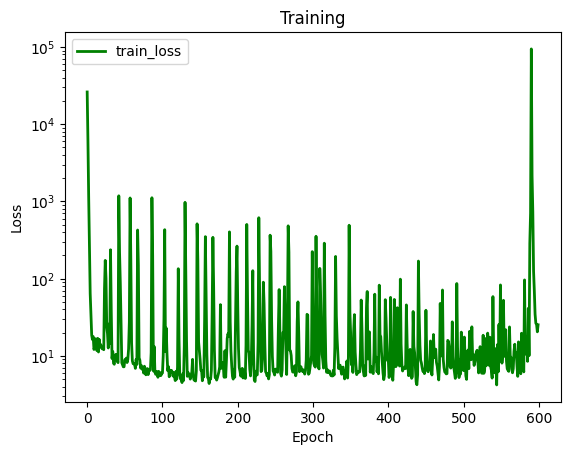

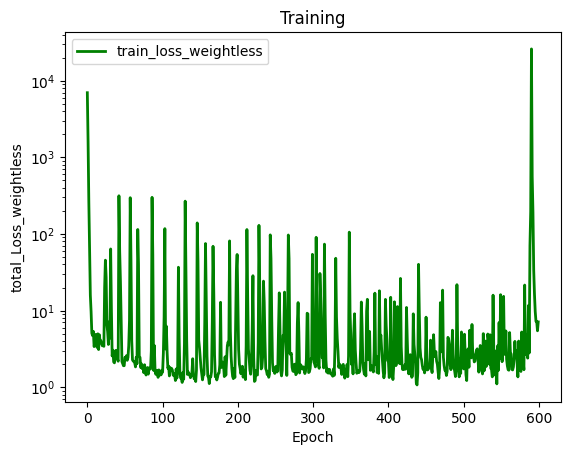

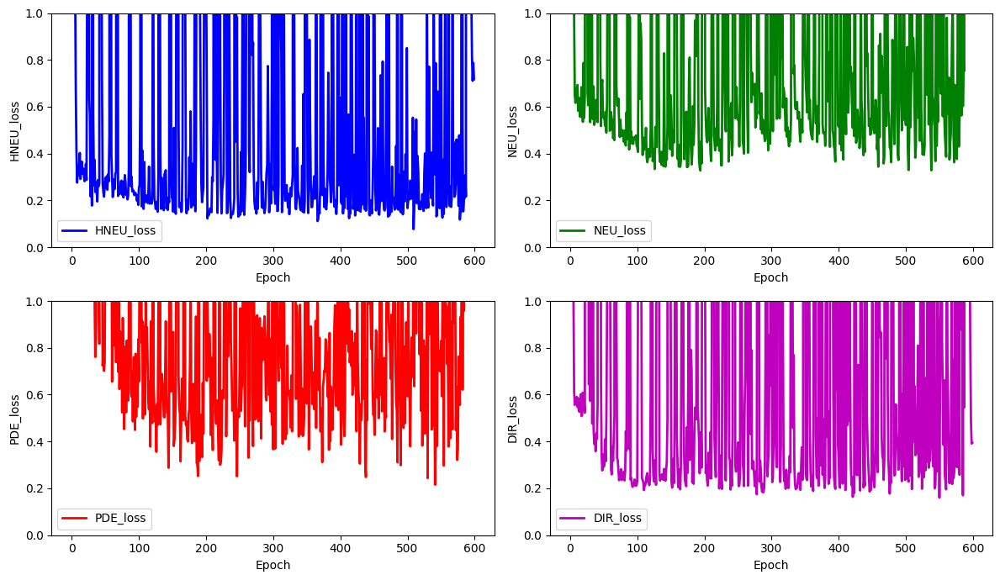

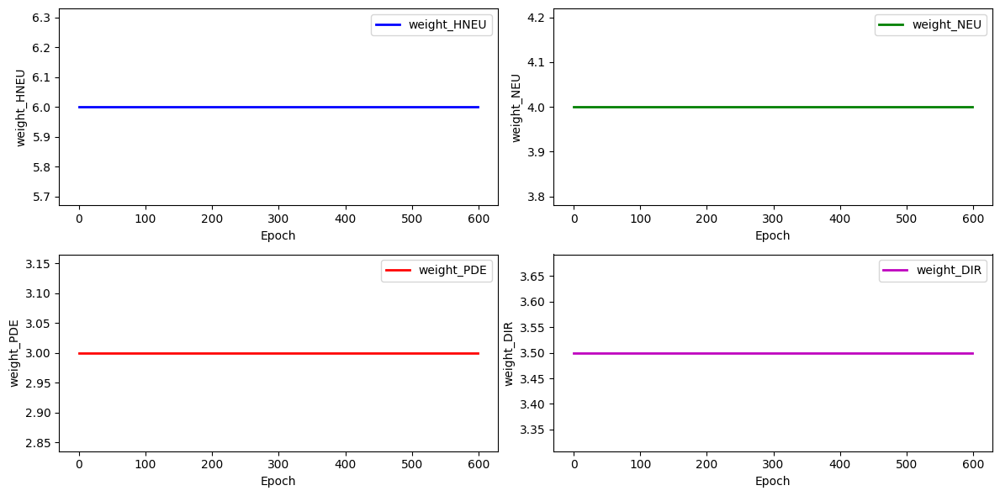

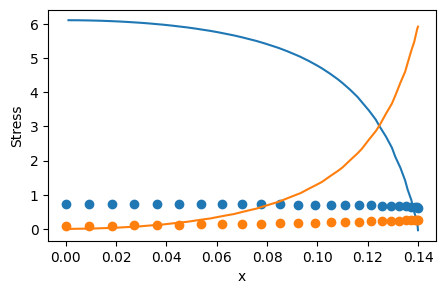

  8%|▊         | 1199/15000 [31:43<6:19:32,  1.65s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 6.523751978527859
for weight 1 new weight_value: 4.0879710155871605
for weight 2 new weight_value: 3.141038272685145
for weight 3 new weight_value: 4.066636185374675
total_loss: 2.954456162084341, hole_loss:  0.4677557440886978, neumann_loss:  0.835260381260035, pde_loss: 0.7737573016619647, dirichlet_loss: 0.8776827350736439


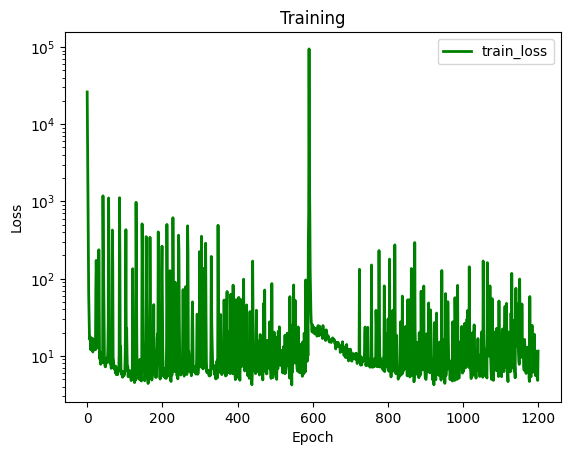

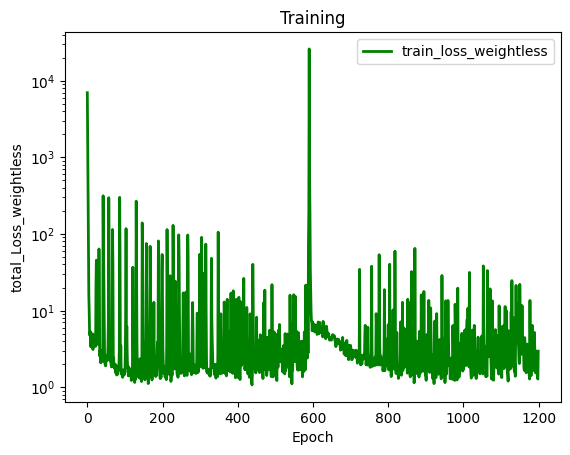

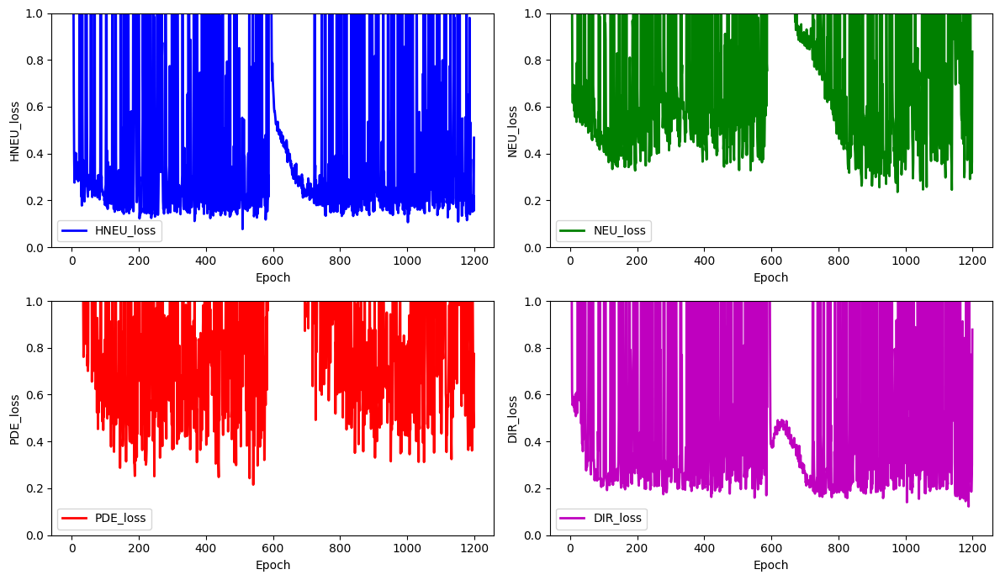

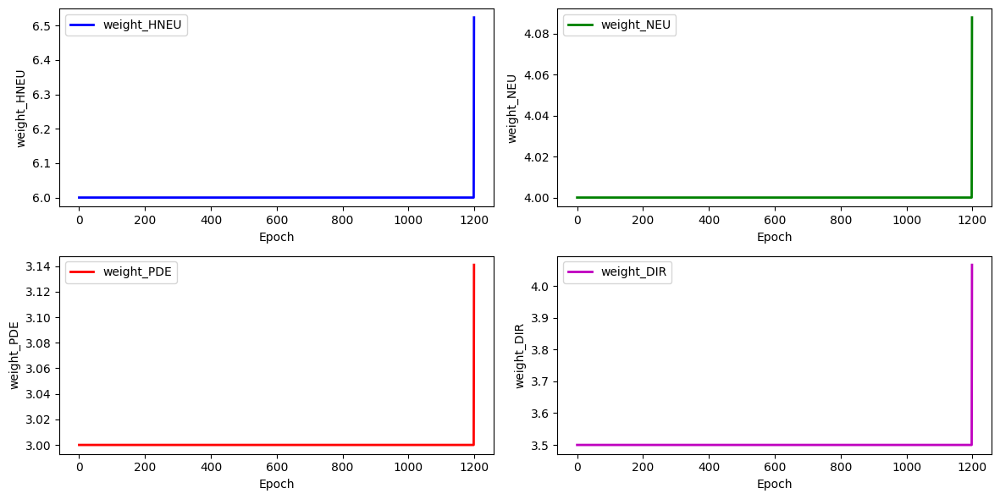

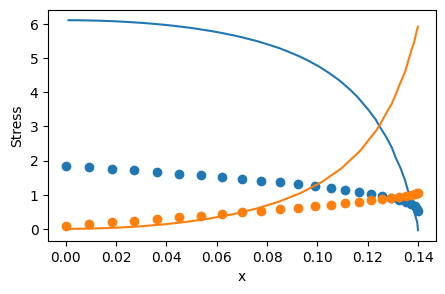

 12%|█▏        | 1799/15000 [48:12<6:00:22,  1.64s/it]

total_loss: 1.8470072098723729, hole_loss:  0.2600903559176472, neumann_loss:  0.44347128480069464, pde_loss: 0.9374428879858547, dirichlet_loss: 0.20600268116817635


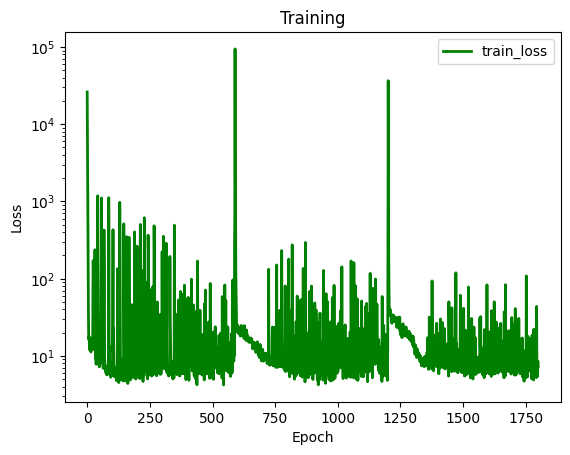

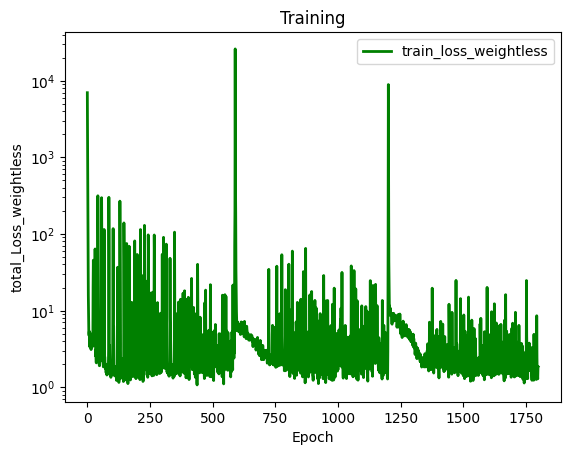

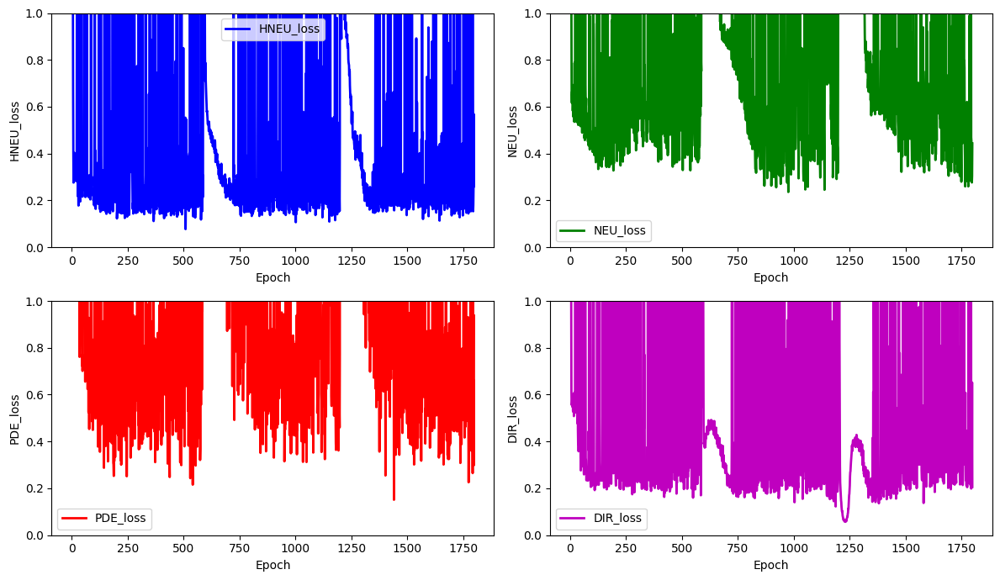

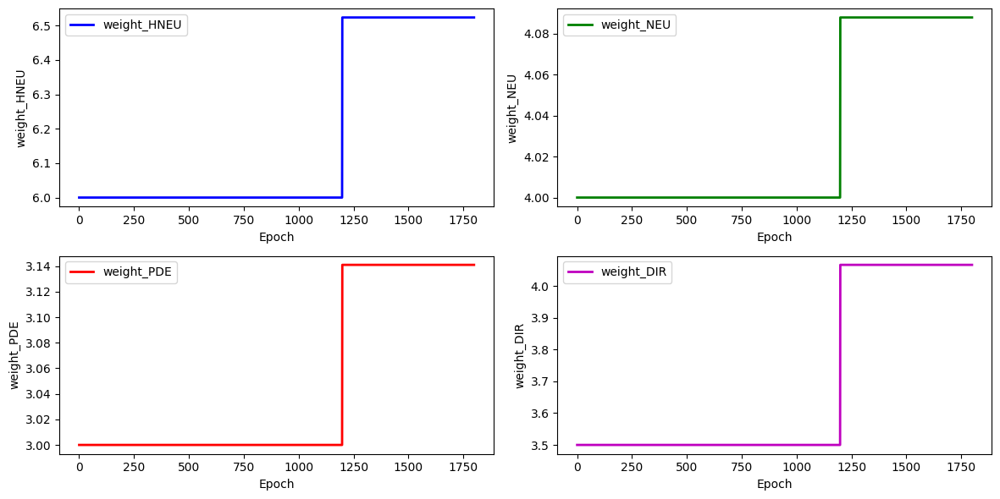

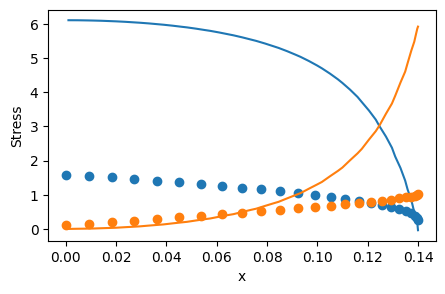

 16%|█▌        | 2399/15000 [1:04:52<5:46:54,  1.65s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 7.570903366294351
for weight 1 new weight_value: 4.172305748748858
for weight 2 new weight_value: 3.13096902904944
for weight 3 new weight_value: 4.2694459551213395
total_loss: 1.114521765466733, hole_loss:  0.1082525948770662, neumann_loss:  0.22213279818409118, pde_loss: 0.39737132441016587, dirichlet_loss: 0.38676504799540956


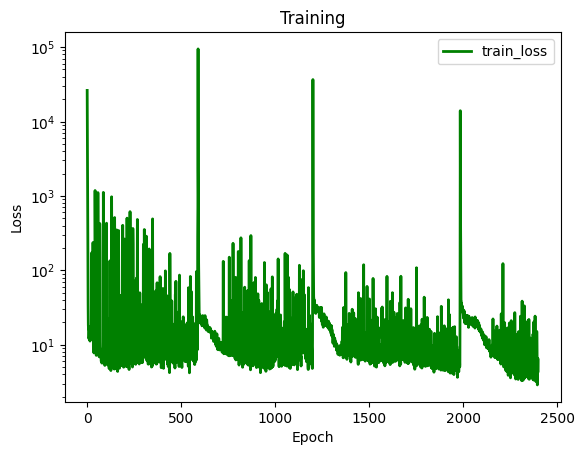

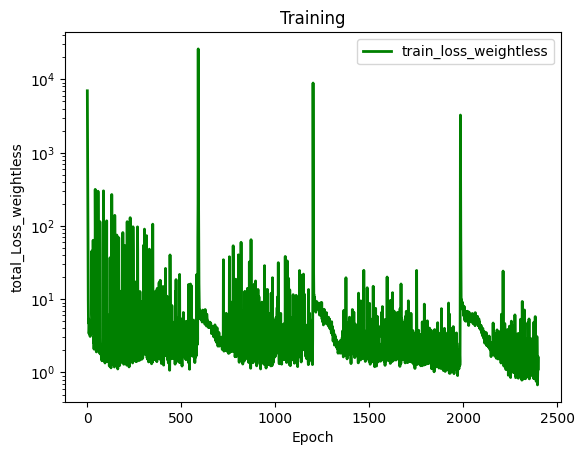

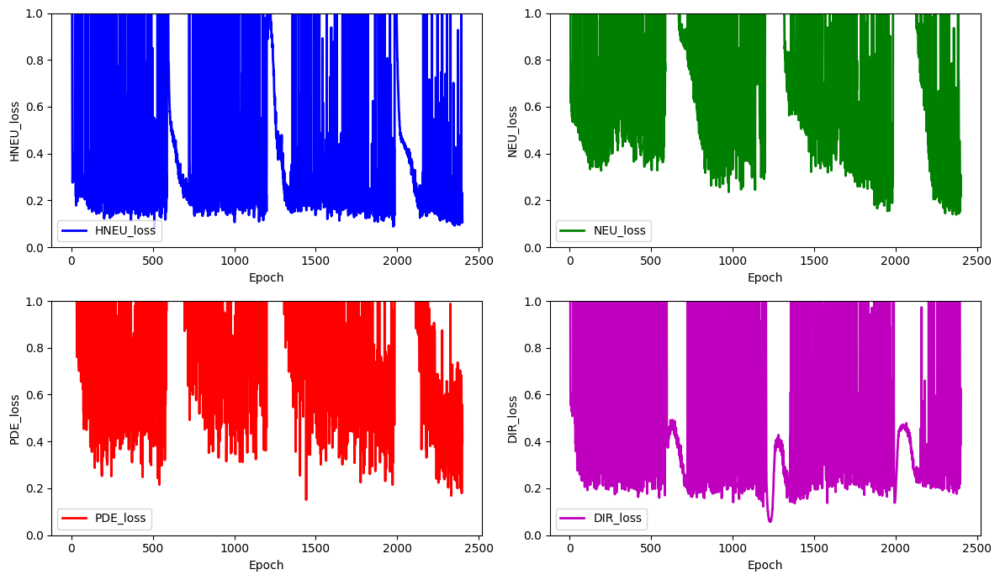

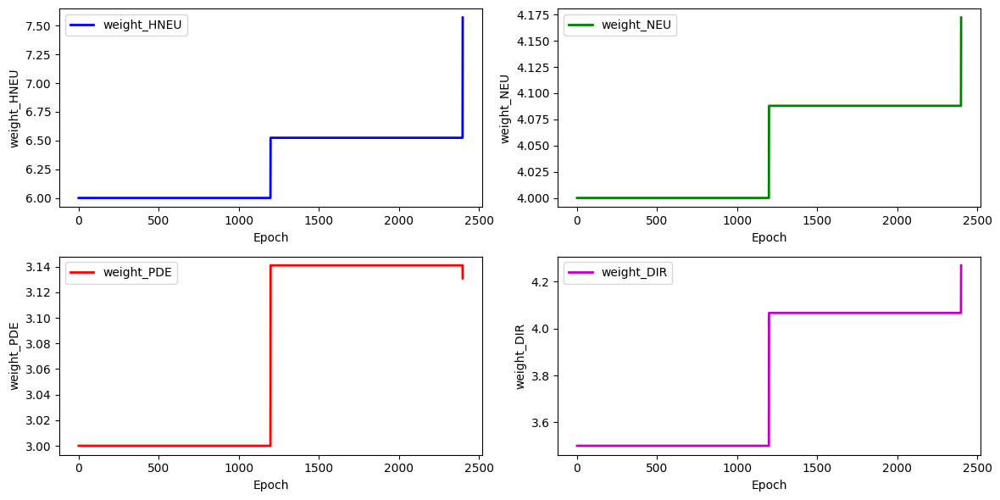

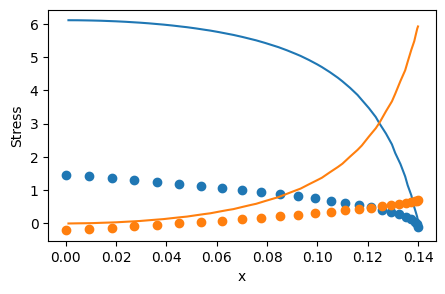

 20%|█▉        | 2999/15000 [1:21:09<5:23:33,  1.62s/it]

total_loss: 1.4299008736315313, hole_loss:  0.1088591719044949, neumann_loss:  0.2719692346886009, pde_loss: 0.32477422869239253, dirichlet_loss: 0.724298238346043


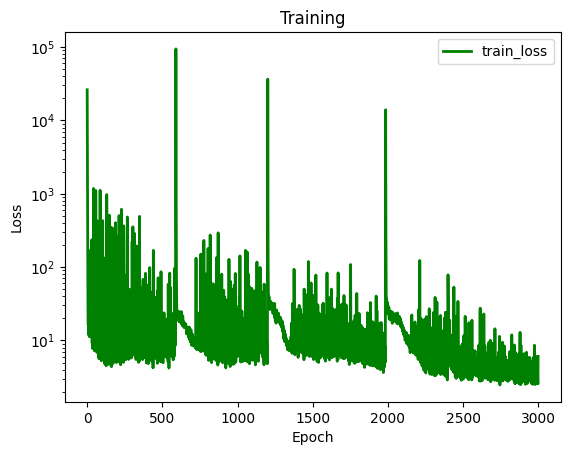

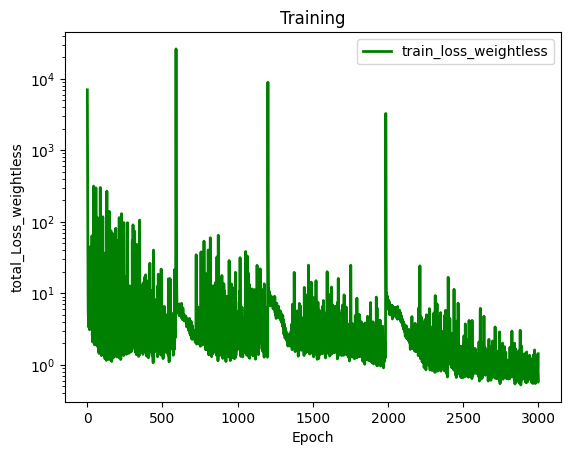

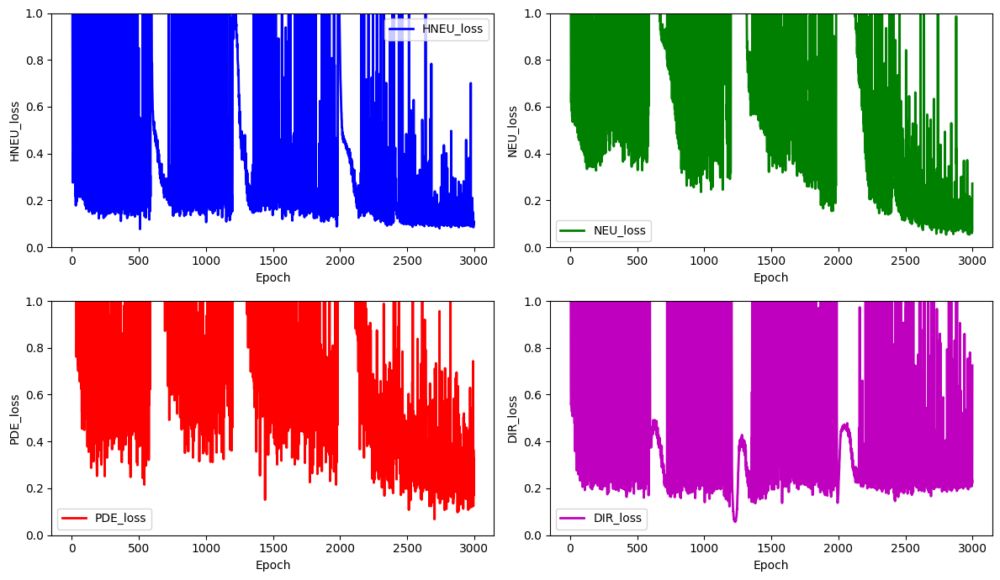

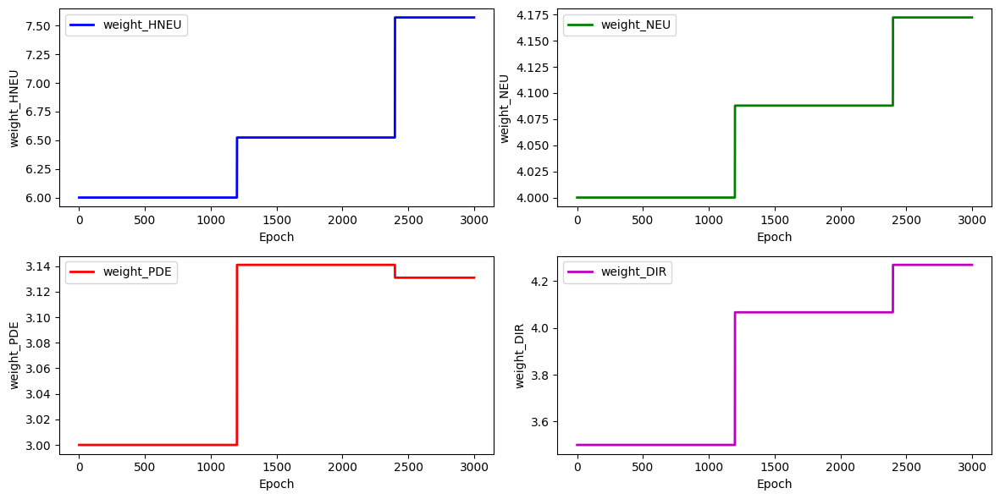

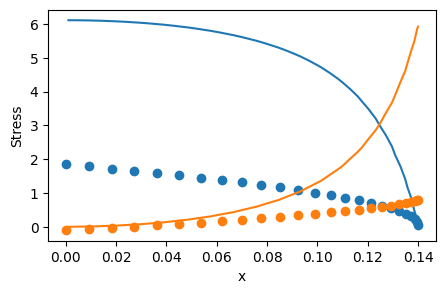

 24%|██▍       | 3599/15000 [1:37:42<5:12:44,  1.65s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 7.654497894006593
for weight 1 new weight_value: 4.191935604515674
for weight 2 new weight_value: 3.0088686996794296
for weight 3 new weight_value: 4.206641505333225
total_loss: 0.8906282419982168, hole_loss:  0.14644204075562933, neumann_loss:  0.16007148703432422, pde_loss: 0.31266567173284243, dirichlet_loss: 0.2714490424754208


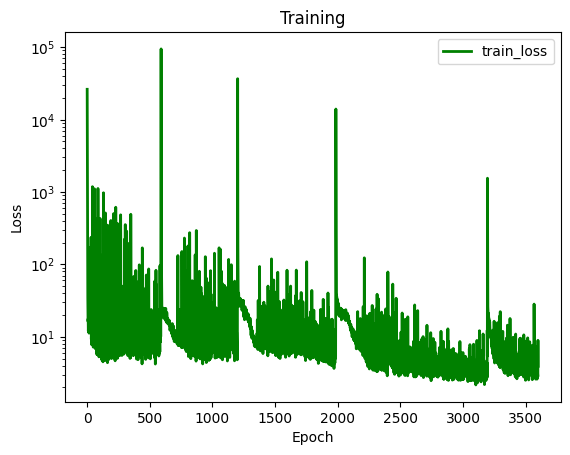

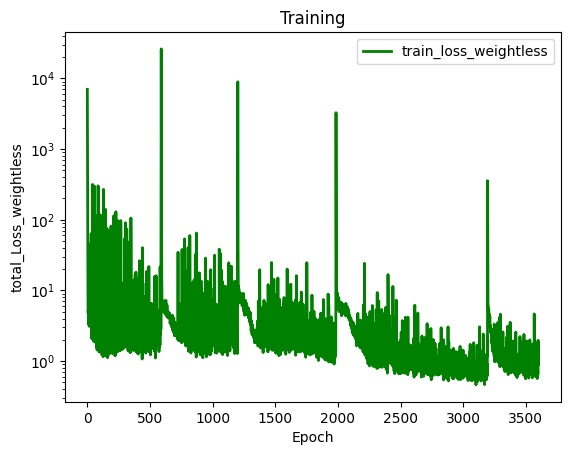

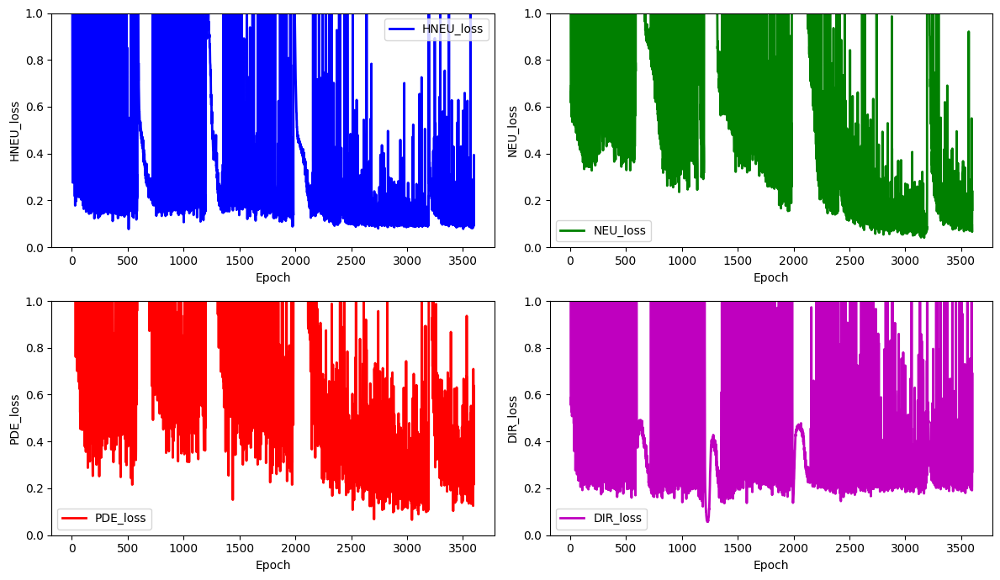

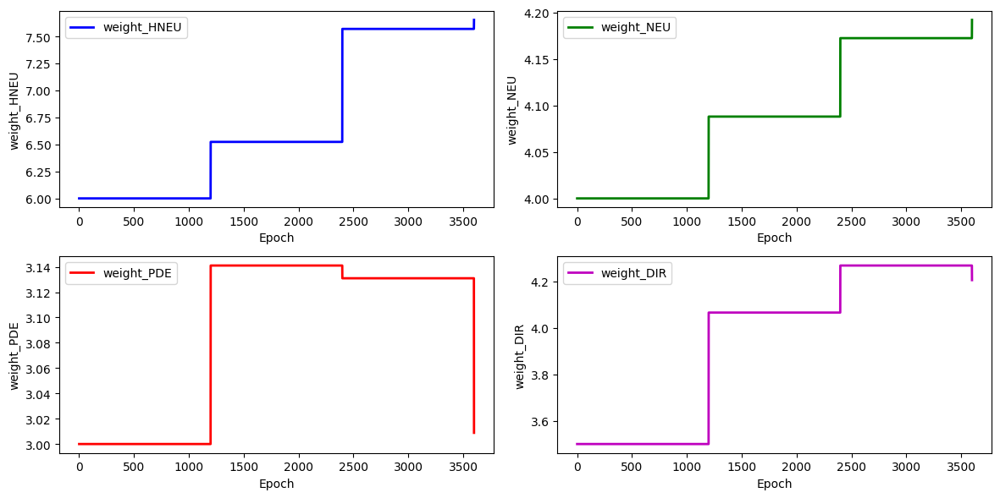

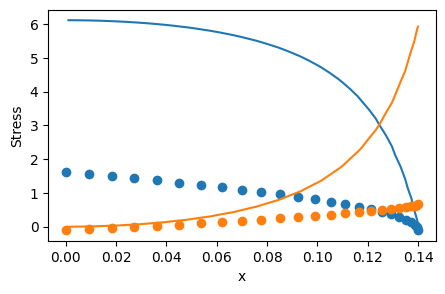

 28%|██▊       | 4199/15000 [1:53:50<4:49:49,  1.61s/it]

total_loss: 0.6434909567307486, hole_loss:  0.11452528720542819, neumann_loss:  0.07947787857124589, pde_loss: 0.26235092891896017, dirichlet_loss: 0.18713686203511437


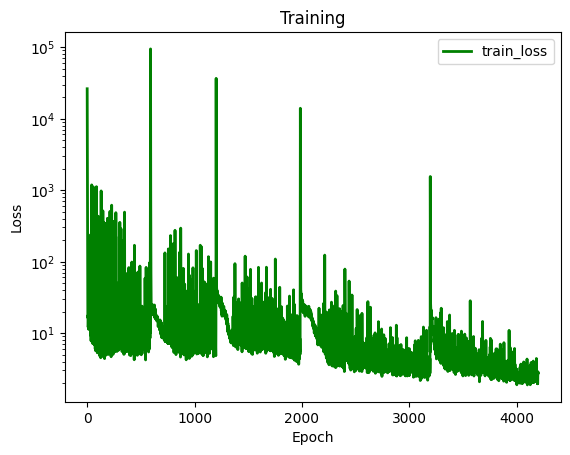

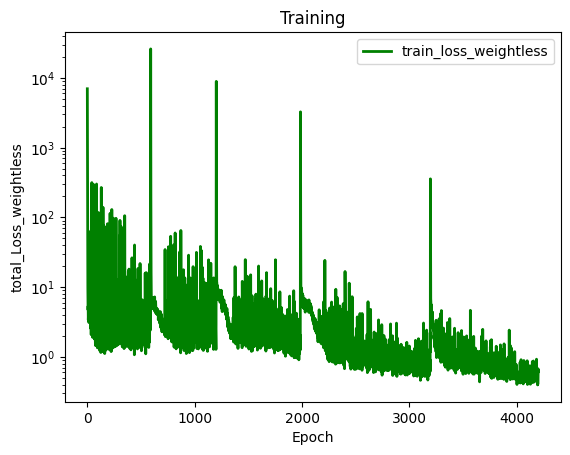

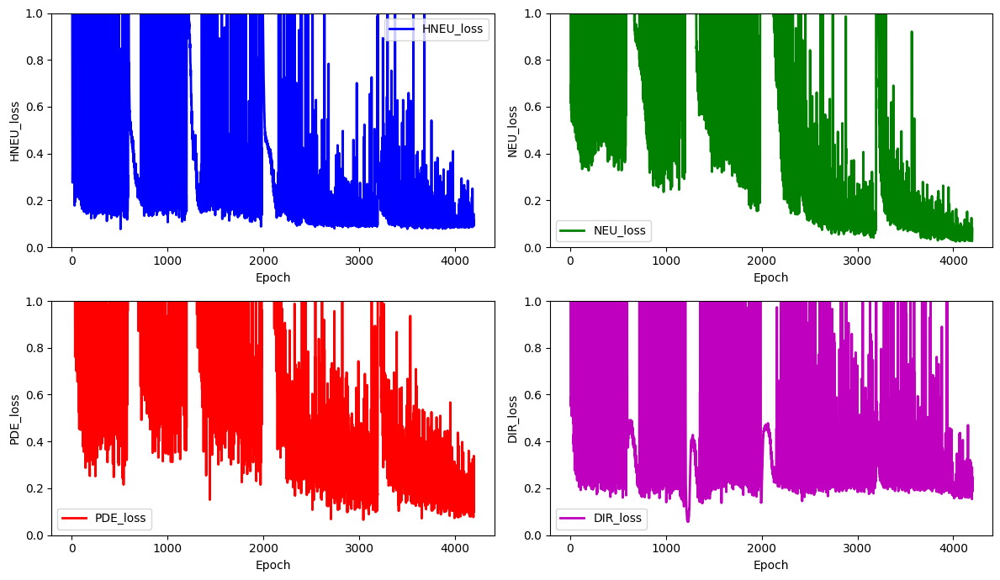

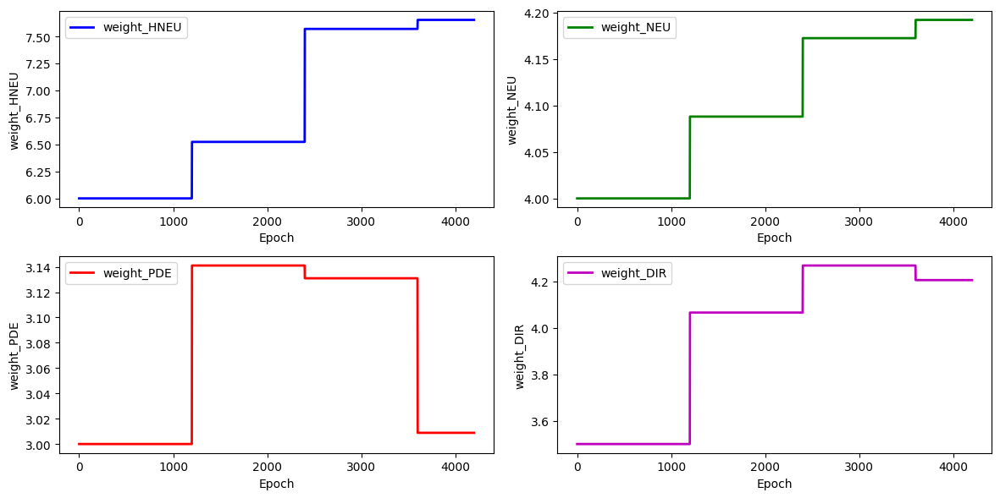

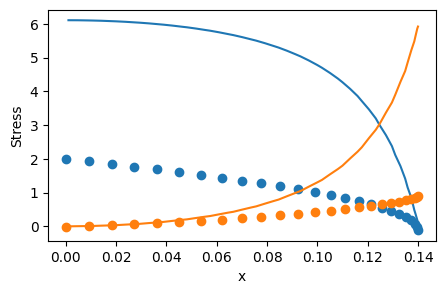

 32%|███▏      | 4799/15000 [2:10:18<4:38:44,  1.64s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 8.429346722451305
for weight 1 new weight_value: 4.387061761282891
for weight 2 new weight_value: 2.907438956583726
for weight 3 new weight_value: 4.761188807187461
total_loss: 0.47255415453213234, hole_loss:  0.13191719935985946, neumann_loss:  0.02293490313873332, pde_loss: 0.15174062038092404, dirichlet_loss: 0.16596143165261557


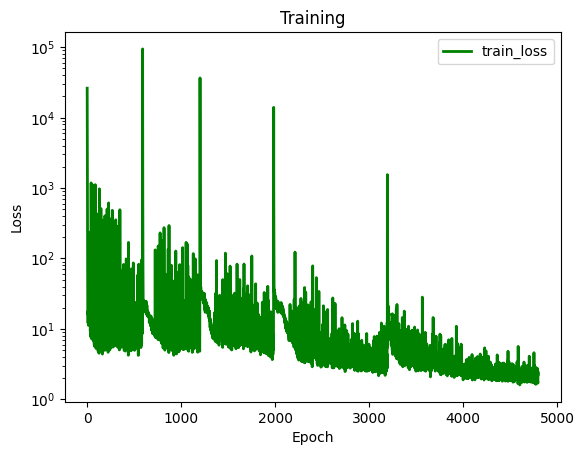

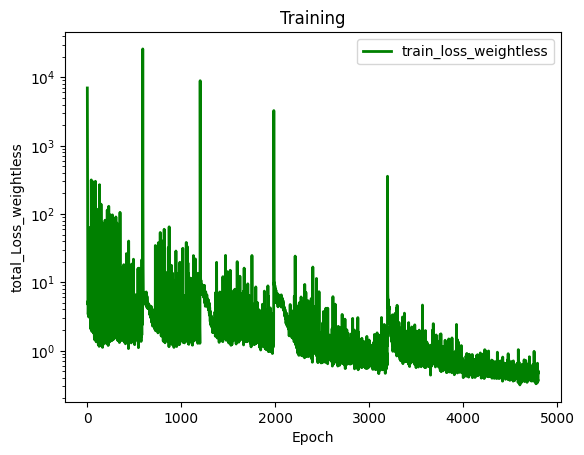

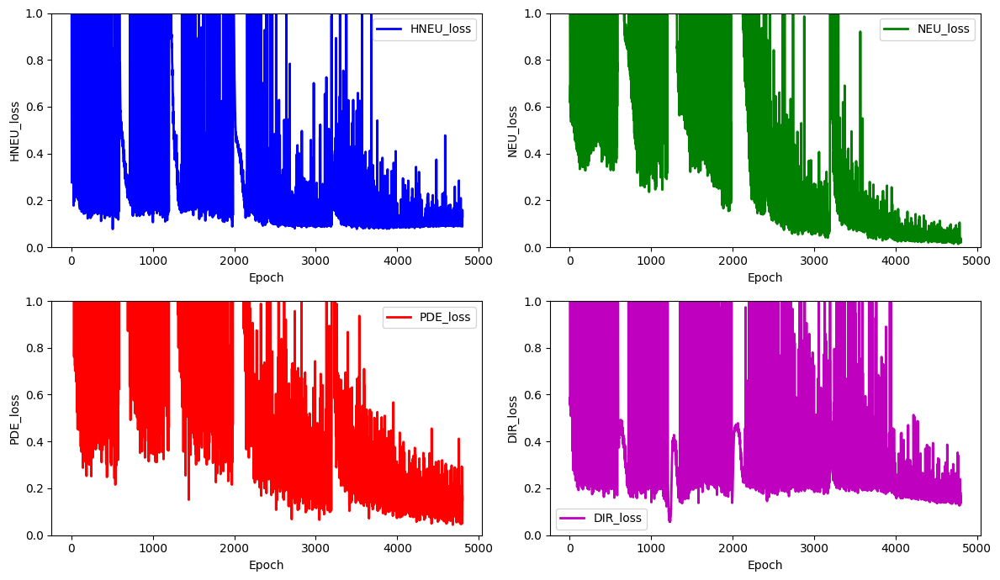

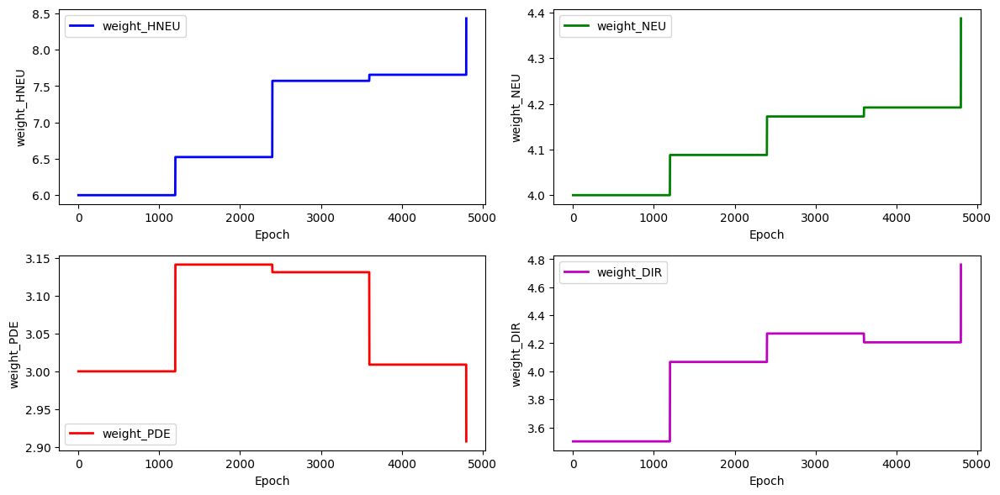

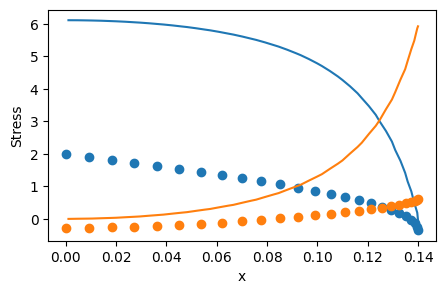

 36%|███▌      | 5399/15000 [2:26:07<4:13:27,  1.58s/it]

total_loss: 0.4568836544163537, hole_loss:  0.10573308656193166, neumann_loss:  0.04065889995729812, pde_loss: 0.19128067476904123, dirichlet_loss: 0.11921099312808267


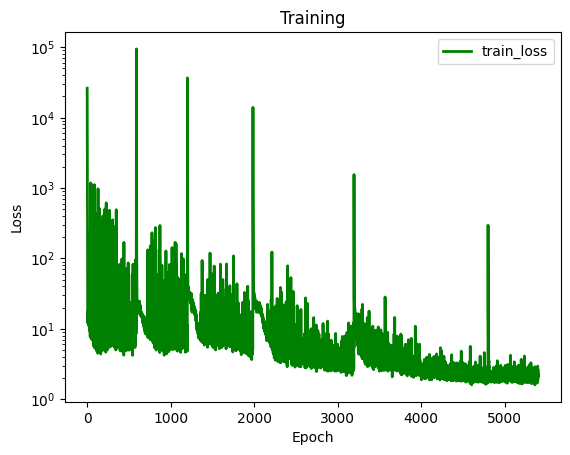

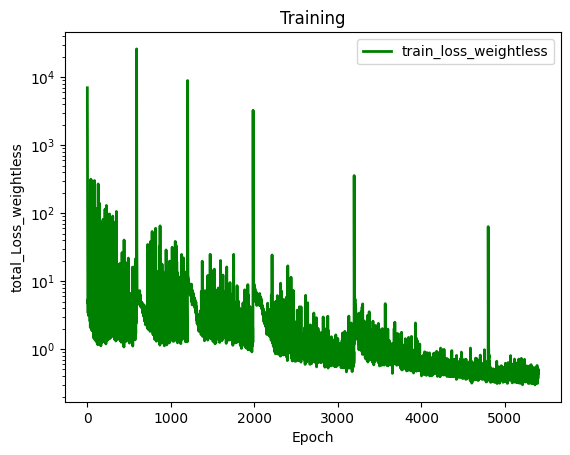

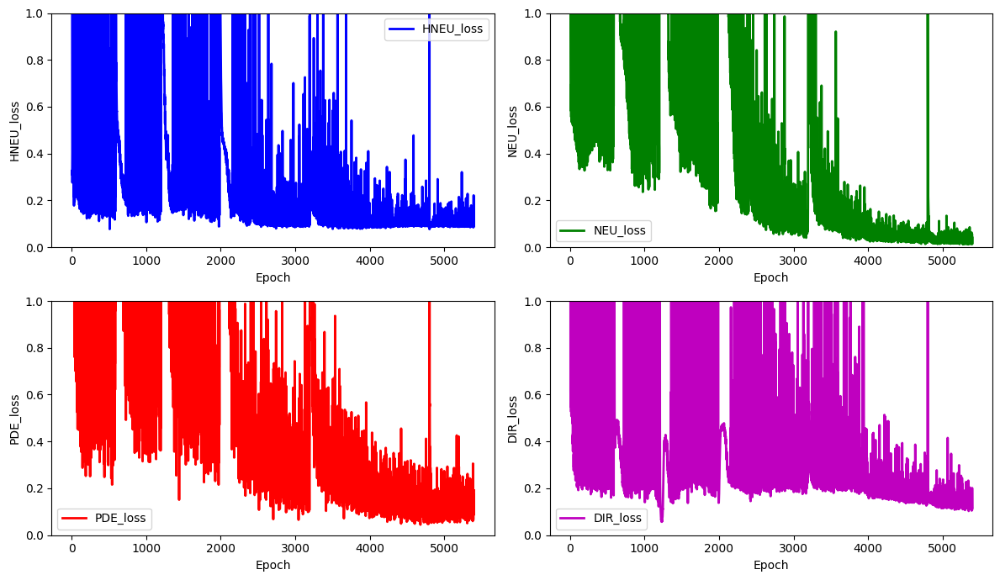

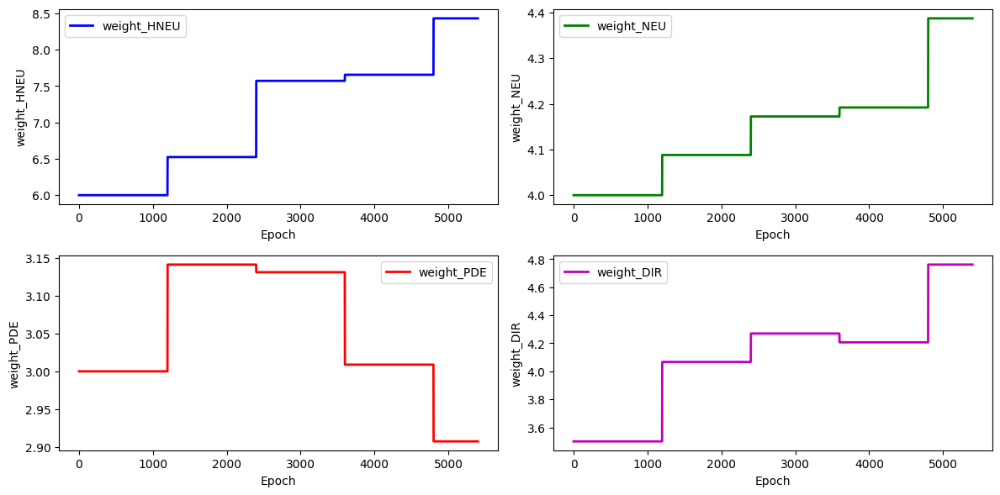

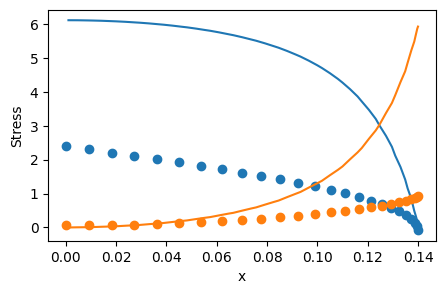

 40%|███▉      | 5999/15000 [2:42:32<4:04:34,  1.63s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 8.650560932469121
for weight 1 new weight_value: 4.484138688136933
for weight 2 new weight_value: 2.789834404920997
for weight 3 new weight_value: 4.8095497244919825
total_loss: 0.45626131467770725, hole_loss:  0.08724072936701628, neumann_loss:  0.013383903373724646, pde_loss: 0.2368020731589184, dirichlet_loss: 0.11883460877804791


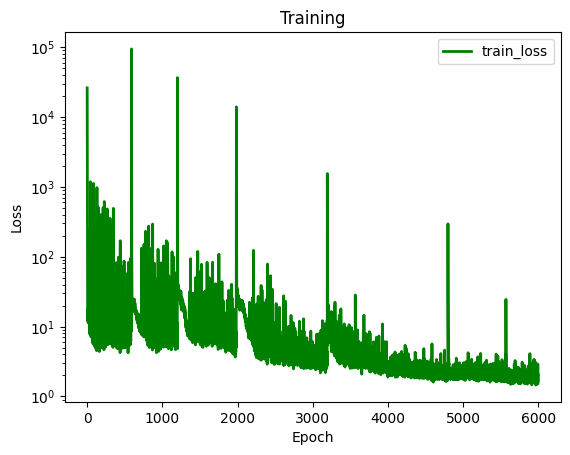

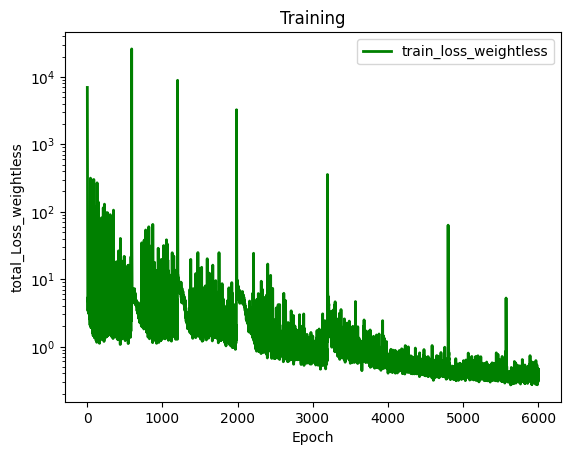

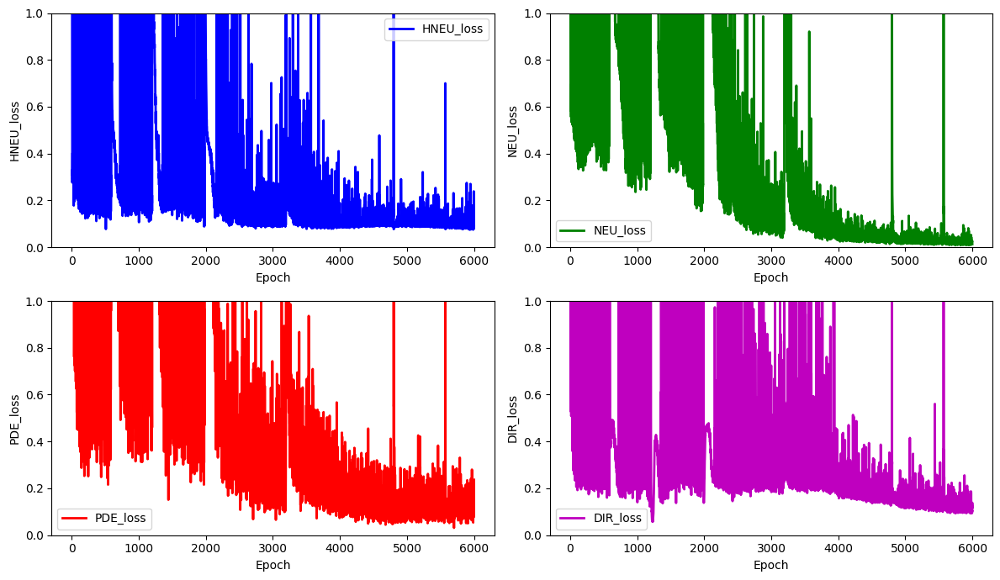

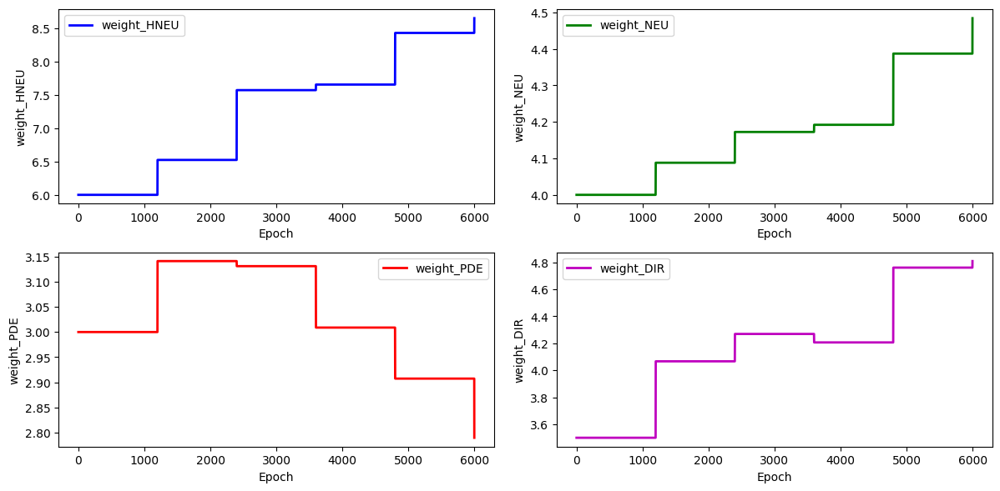

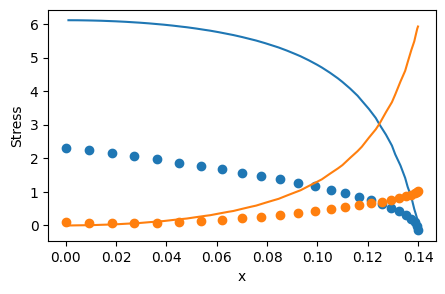

 44%|████▍     | 6599/15000 [2:58:27<3:41:26,  1.58s/it]

total_loss: 0.2927191689856628, hole_loss:  0.0781591163726979, neumann_loss:  0.020507884924255287, pde_loss: 0.11684999690372684, dirichlet_loss: 0.07720217078498275


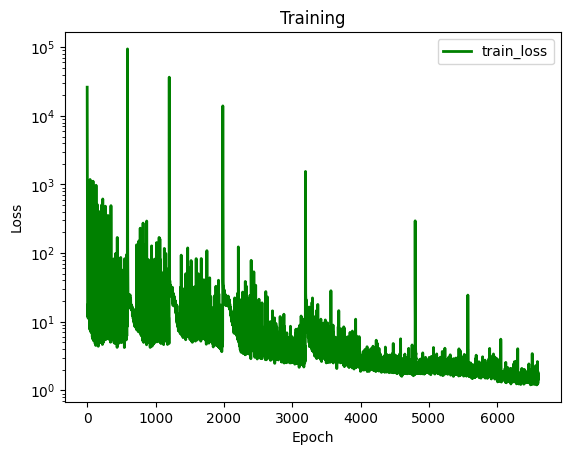

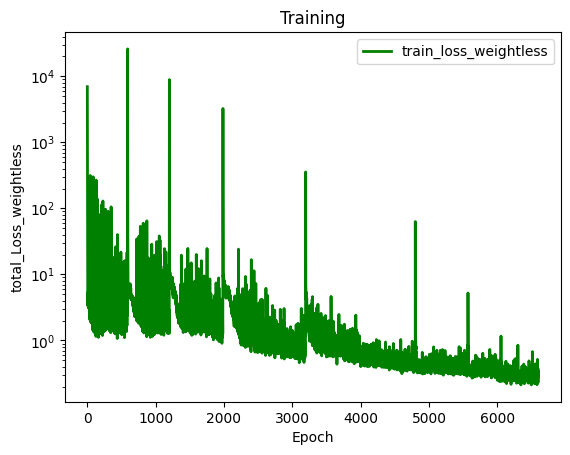

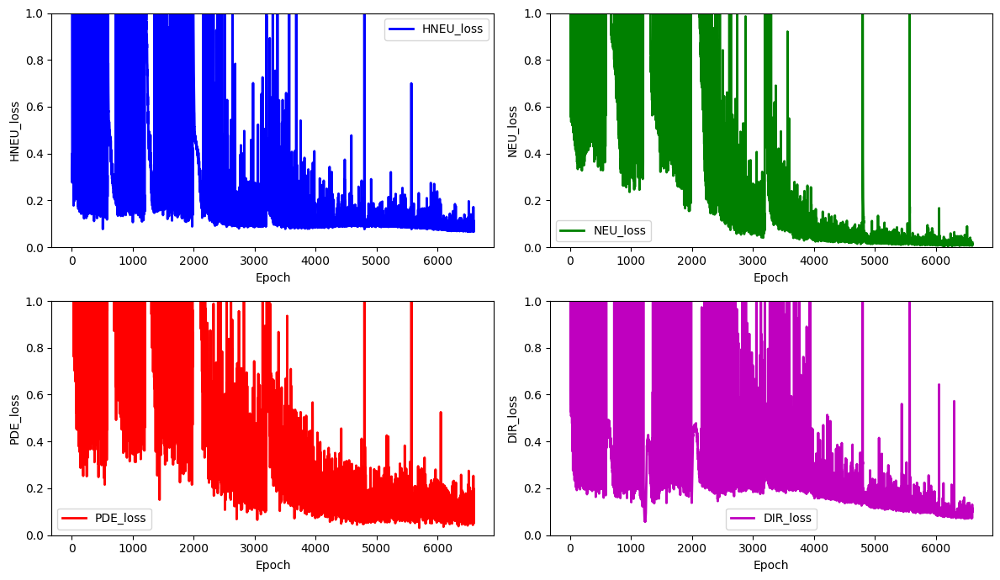

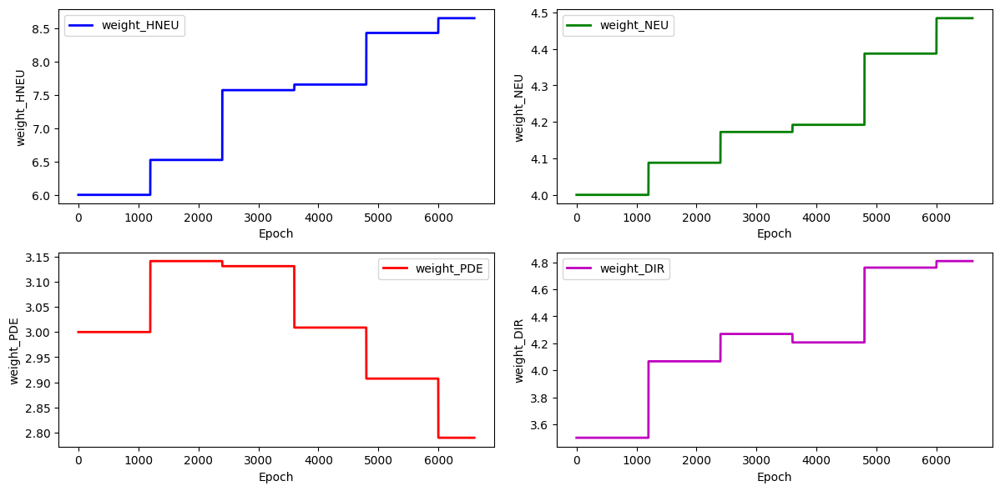

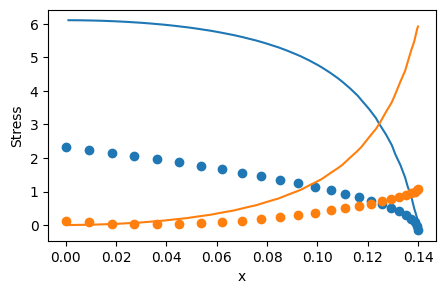

 48%|████▊     | 7199/15000 [3:14:40<3:29:59,  1.62s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 8.85853286083836
for weight 1 new weight_value: 4.353825008213256
for weight 2 new weight_value: 2.619671721517784
for weight 3 new weight_value: 4.811751591018458
total_loss: 0.3072311158179716, hole_loss:  0.06877543071898413, neumann_loss:  0.04309211673078213, pde_loss: 0.11482836468825727, dirichlet_loss: 0.08053520367994806


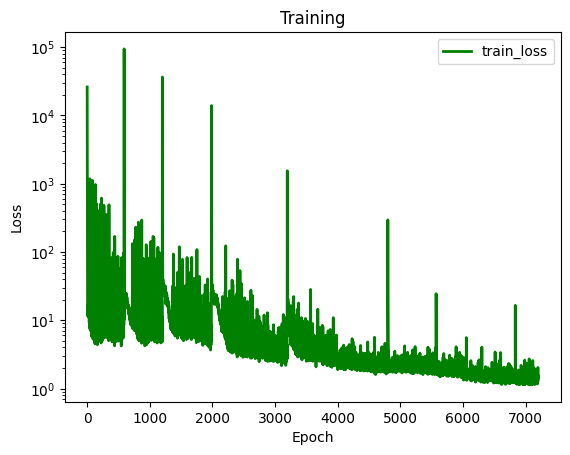

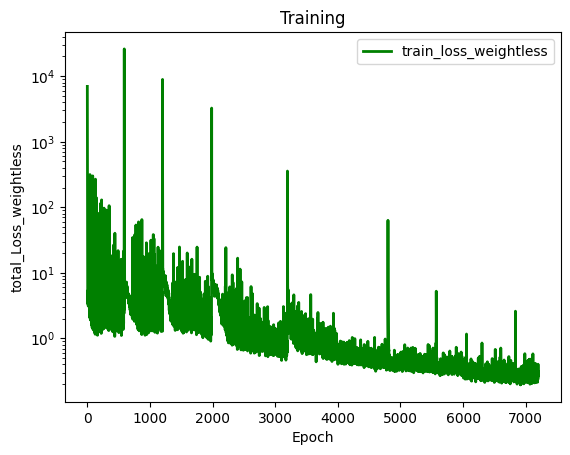

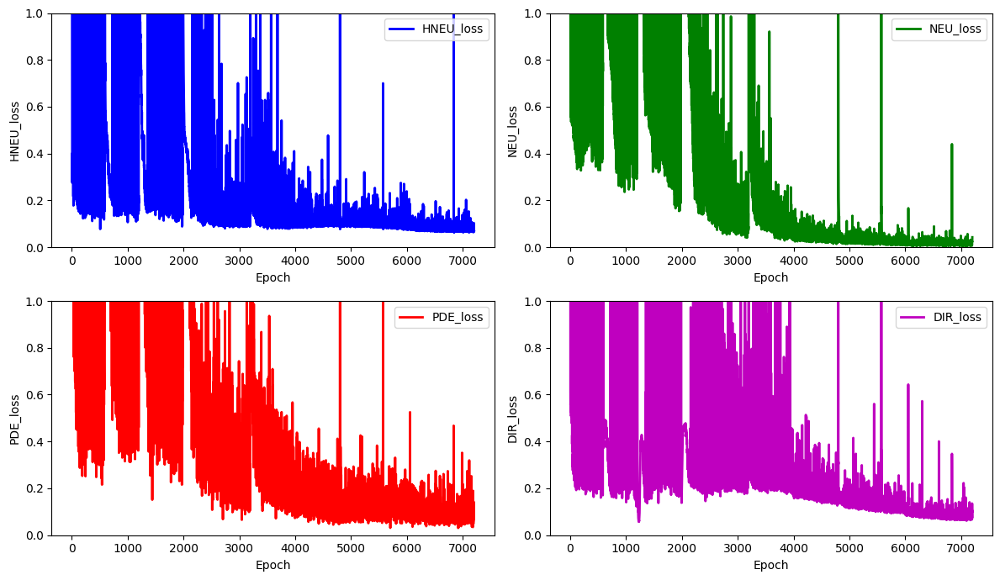

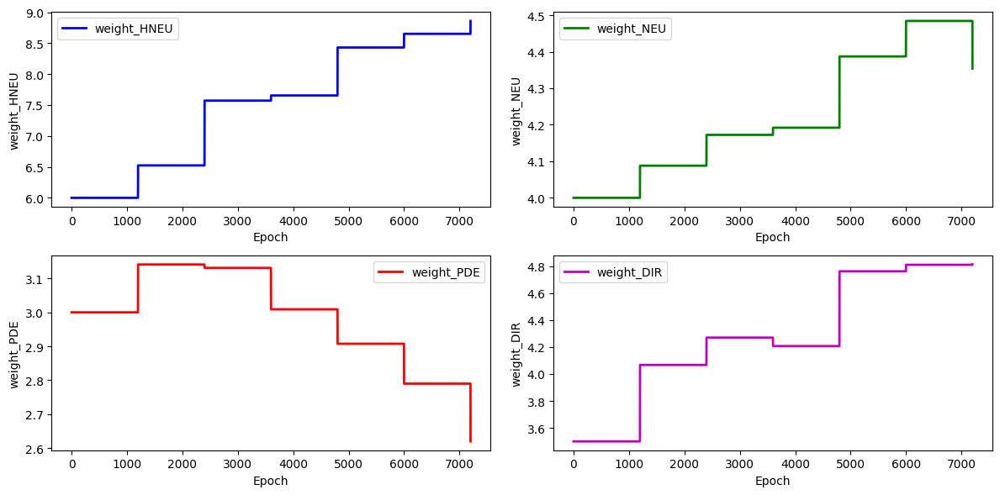

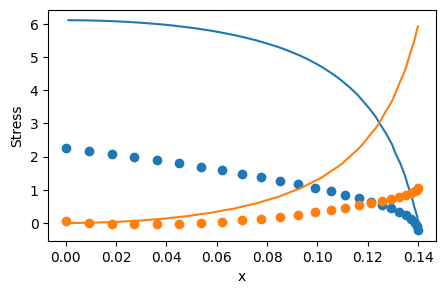

 52%|█████▏    | 7799/15000 [3:31:35<3:20:55,  1.67s/it]

total_loss: 0.2112861505298017, hole_loss:  0.0706042802303702, neumann_loss:  0.013392690238660798, pde_loss: 0.05793370889421989, dirichlet_loss: 0.06935547116655083


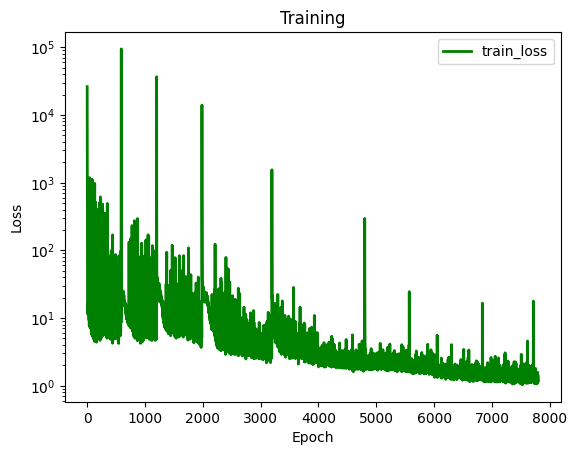

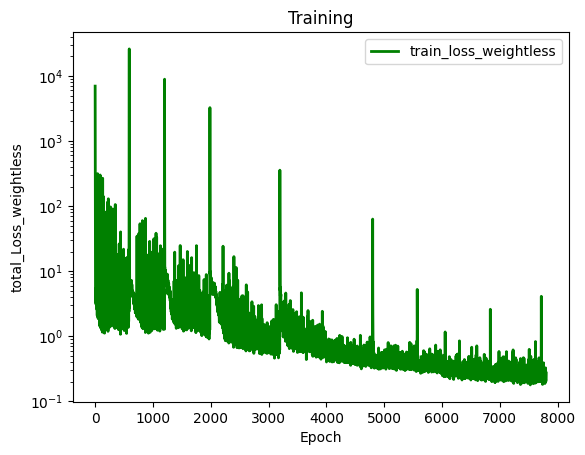

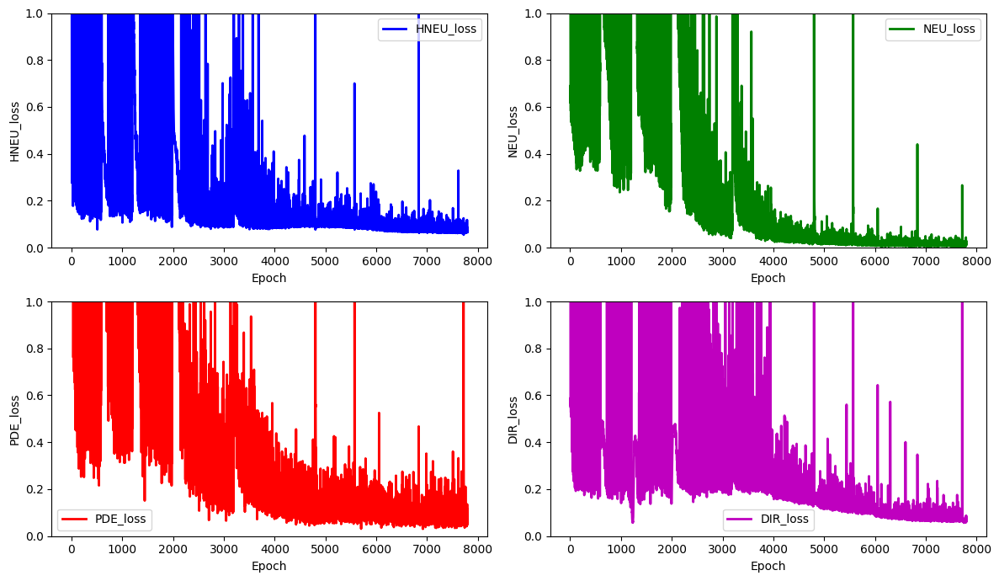

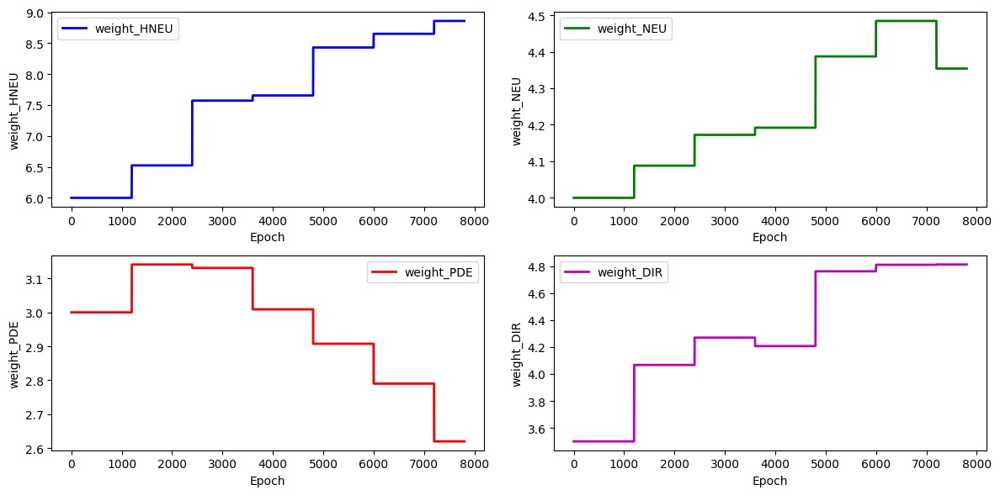

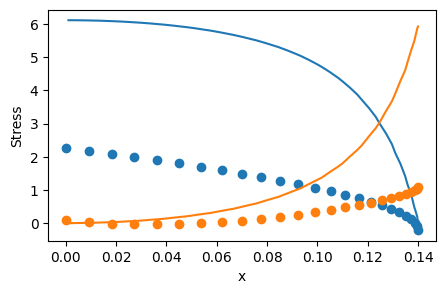

 56%|█████▌    | 8399/15000 [3:47:57<2:59:22,  1.63s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 9.45813151426478
for weight 1 new weight_value: 4.959143430737735
for weight 2 new weight_value: 2.6351710111377415
for weight 3 new weight_value: 5.689606173251744
total_loss: 0.2822678374685639, hole_loss:  0.08033434479784161, neumann_loss:  0.010423299966579551, pde_loss: 0.11491180664011336, dirichlet_loss: 0.07659838606402934


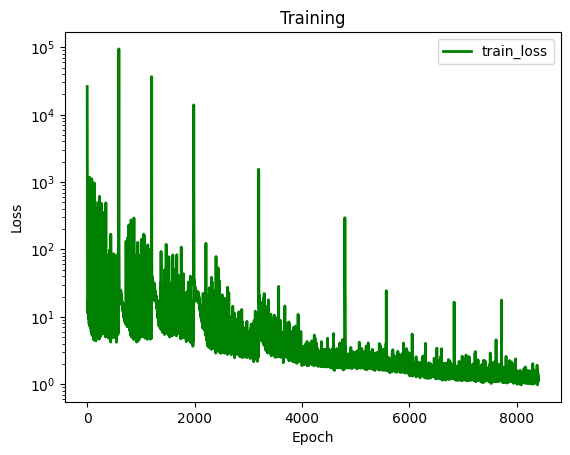

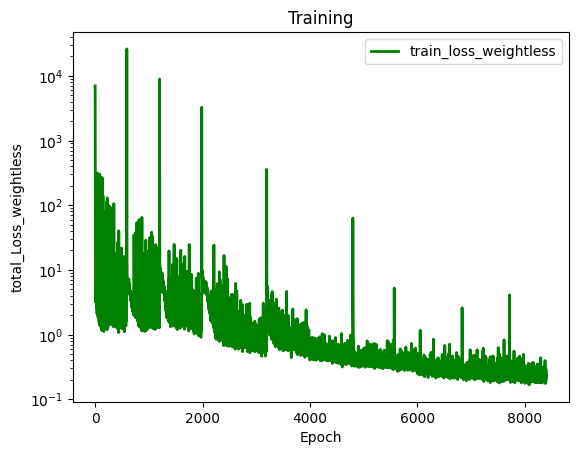

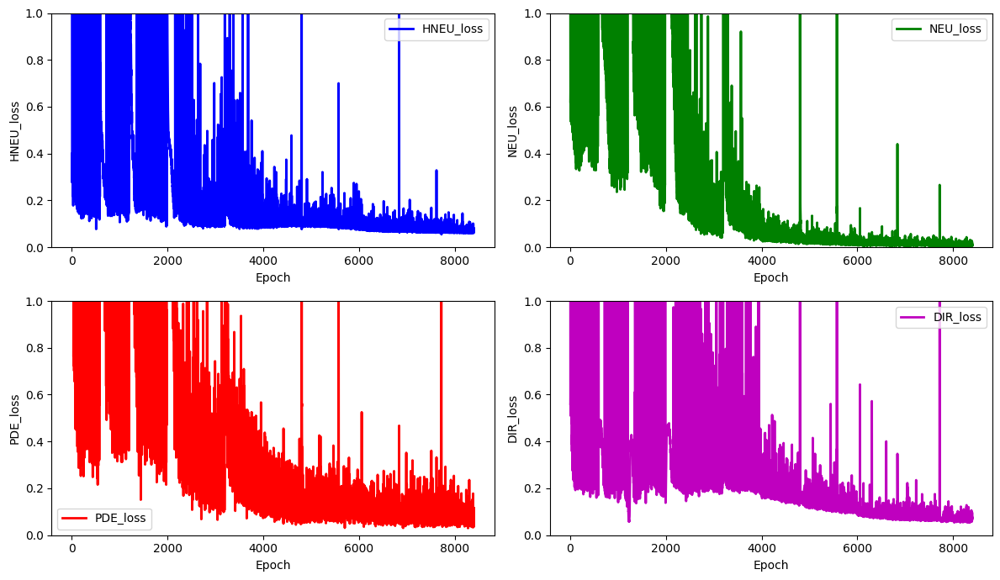

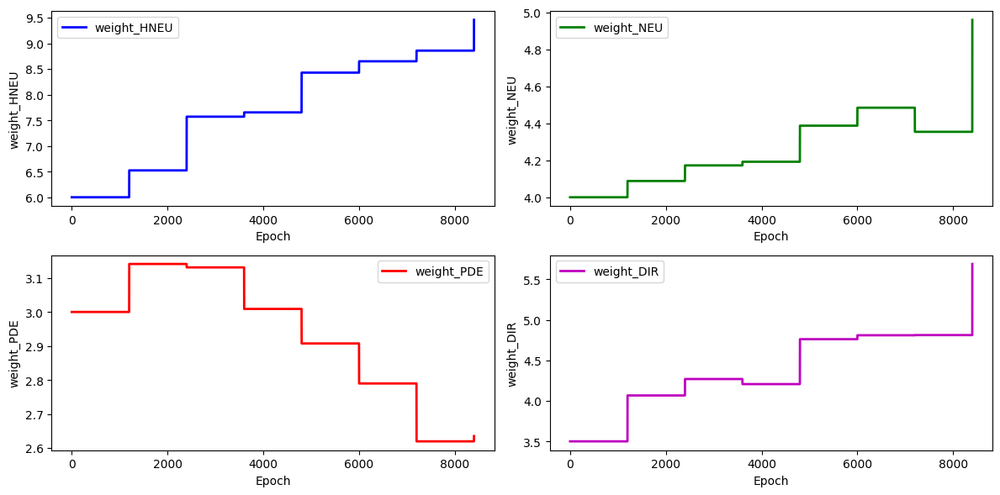

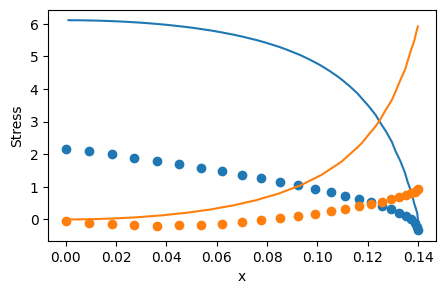

 60%|█████▉    | 8999/15000 [4:04:21<2:43:55,  1.64s/it]

total_loss: 0.19547634570268185, hole_loss:  0.06689662696746818, neumann_loss:  0.012246373864517053, pde_loss: 0.06682347461609366, dirichlet_loss: 0.049509870254602954


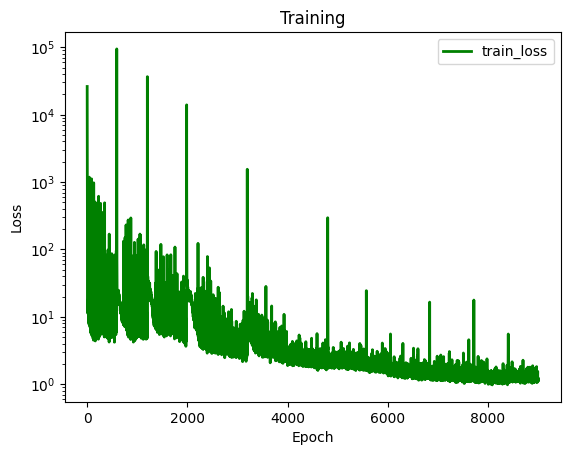

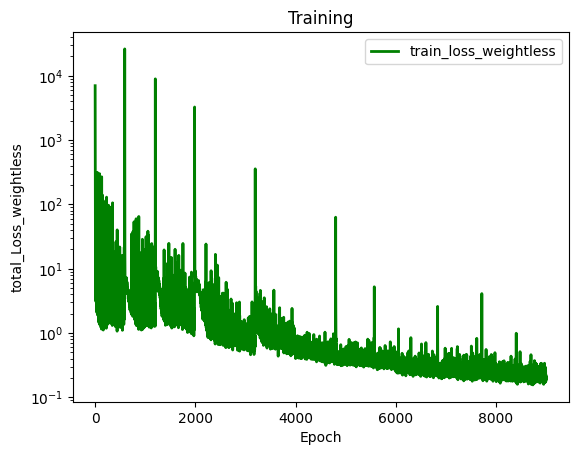

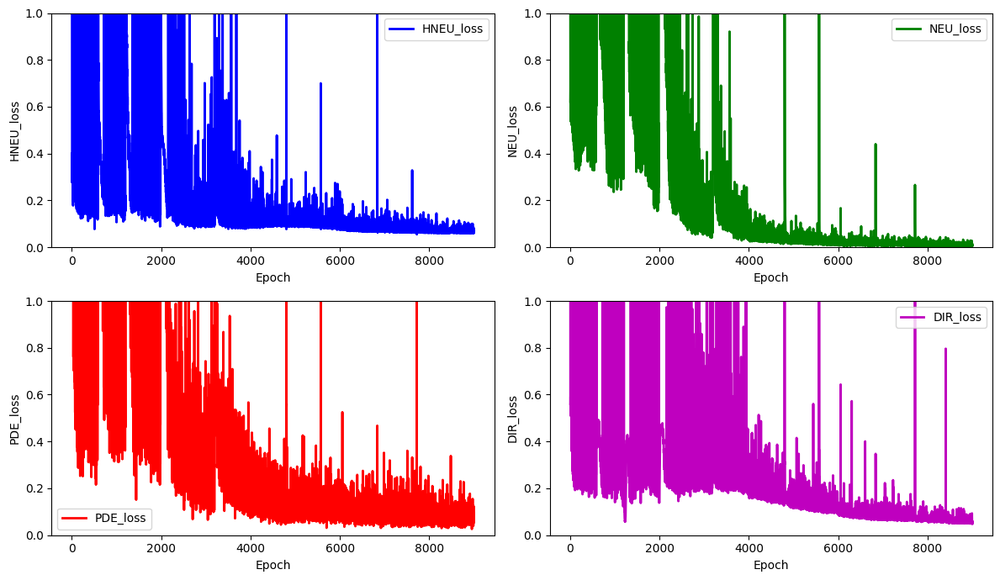

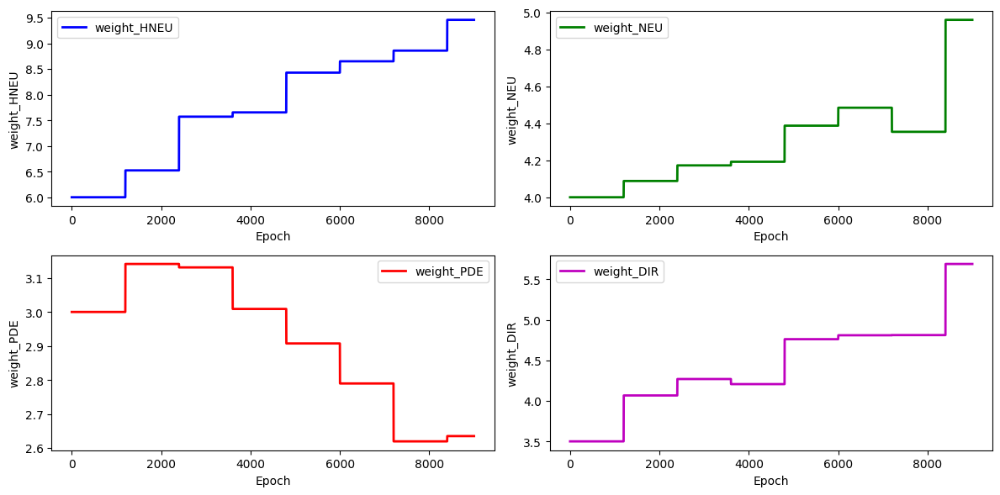

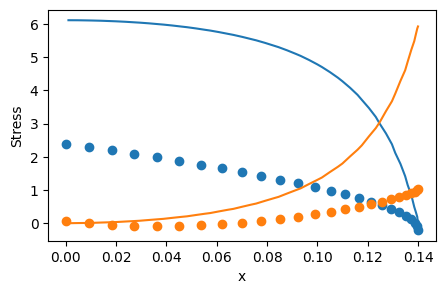

 64%|██████▍   | 9599/15000 [4:20:20<2:23:11,  1.59s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 9.902433070238374
for weight 1 new weight_value: 4.919315502772697
for weight 2 new weight_value: 2.5428799549612644
for weight 3 new weight_value: 5.726148984139964
total_loss: 0.17109863707857764, hole_loss:  0.06298814791351545, neumann_loss:  0.008633916582670598, pde_loss: 0.03625524083102616, dirichlet_loss: 0.06322133175136543


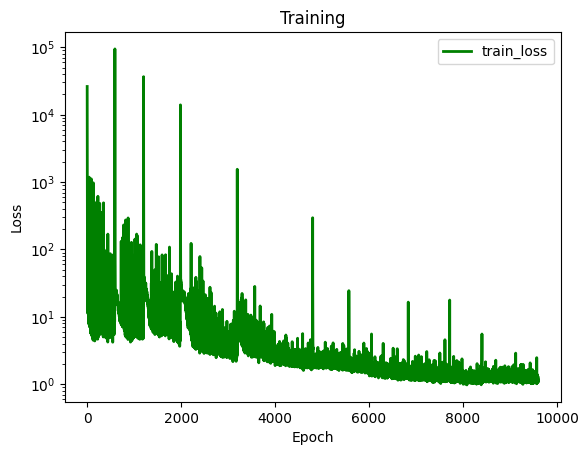

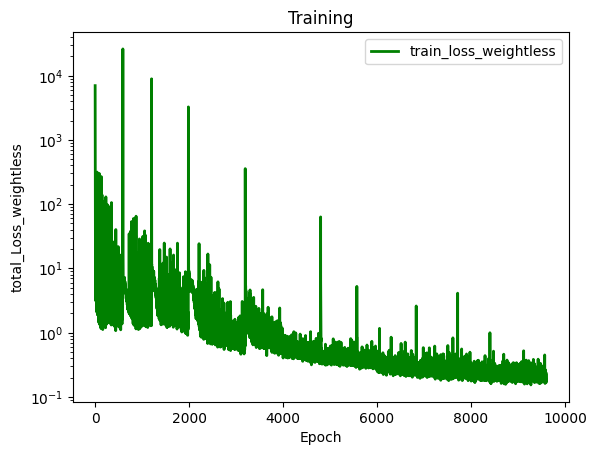

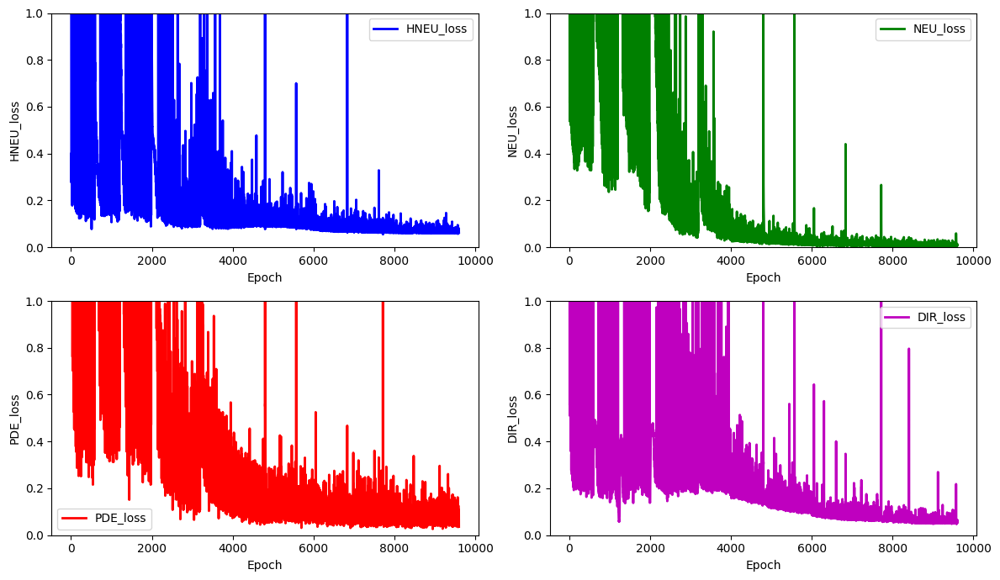

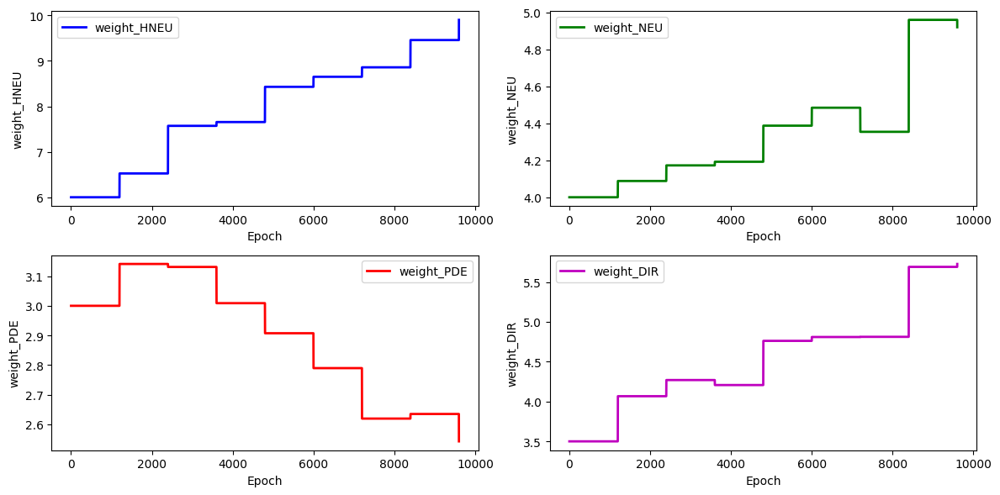

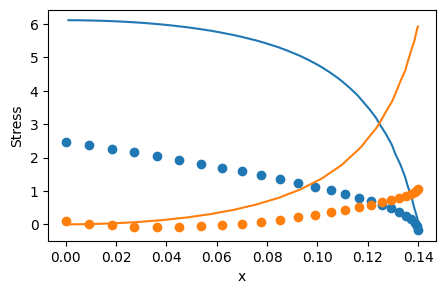

 68%|██████▊   | 10199/15000 [4:36:39<2:11:28,  1.64s/it]

total_loss: 0.17259620147470633, hole_loss:  0.05789226780710518, neumann_loss:  0.005089036495556828, pde_loss: 0.053923777945477466, dirichlet_loss: 0.055691119226566846


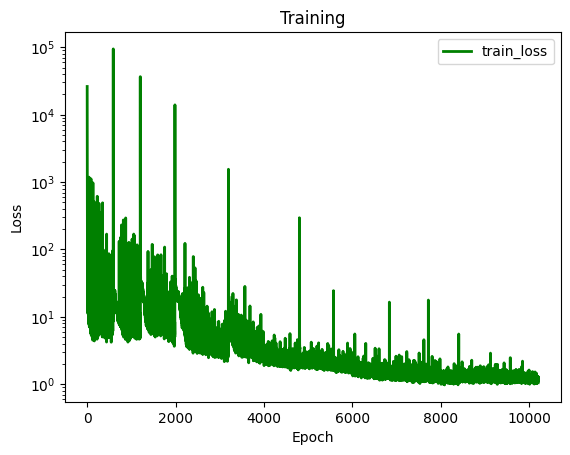

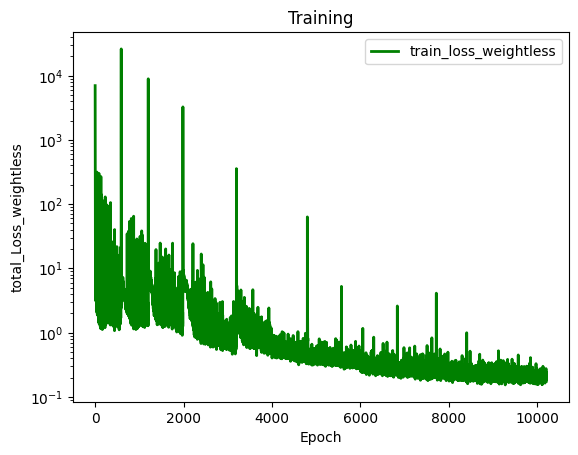

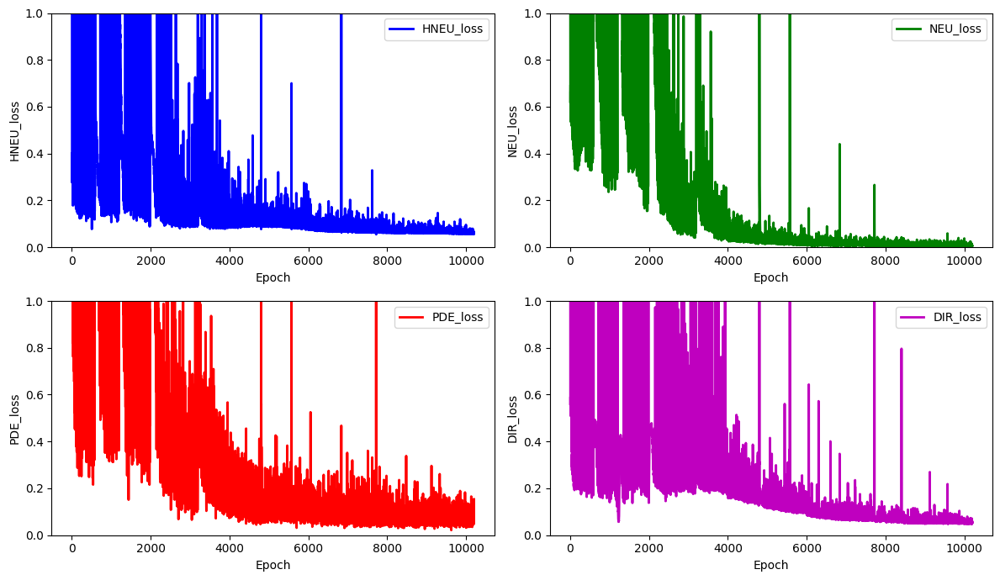

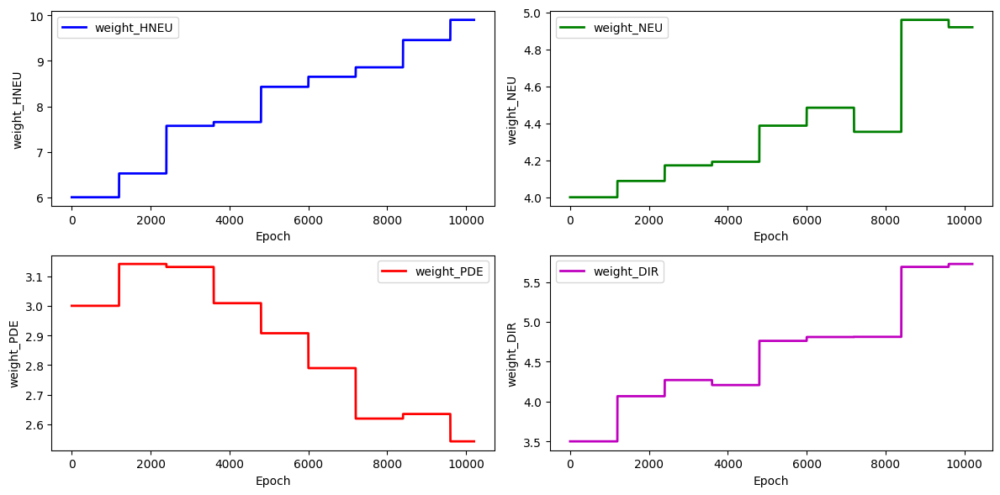

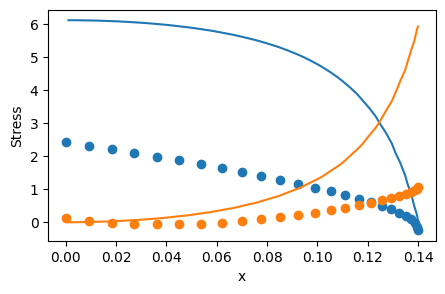

 72%|███████▏  | 10799/15000 [4:52:40<2:11:13,  1.87s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 9.99092831202335
for weight 1 new weight_value: 4.809708336421717
for weight 2 new weight_value: 2.4177043108893863
for weight 3 new weight_value: 5.918943196052296
total_loss: 0.15013448715042285, hole_loss:  0.06192546763910398, neumann_loss:  0.0035640040783189537, pde_loss: 0.03658753482895751, dirichlet_loss: 0.04805748060404241


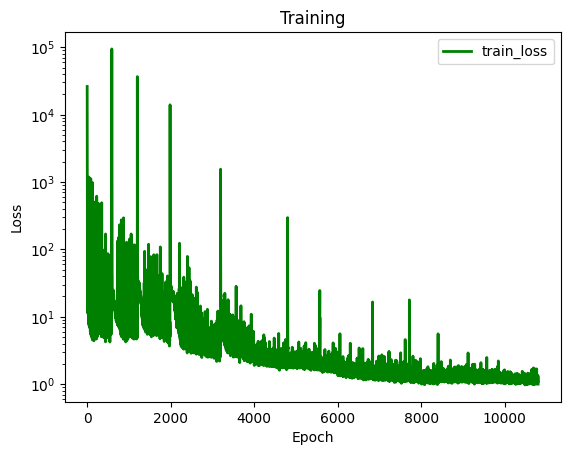

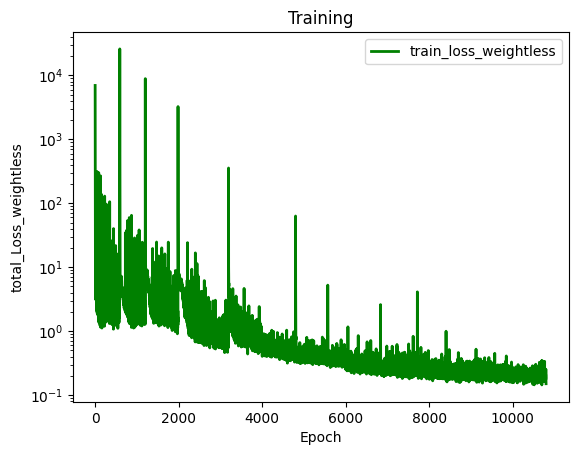

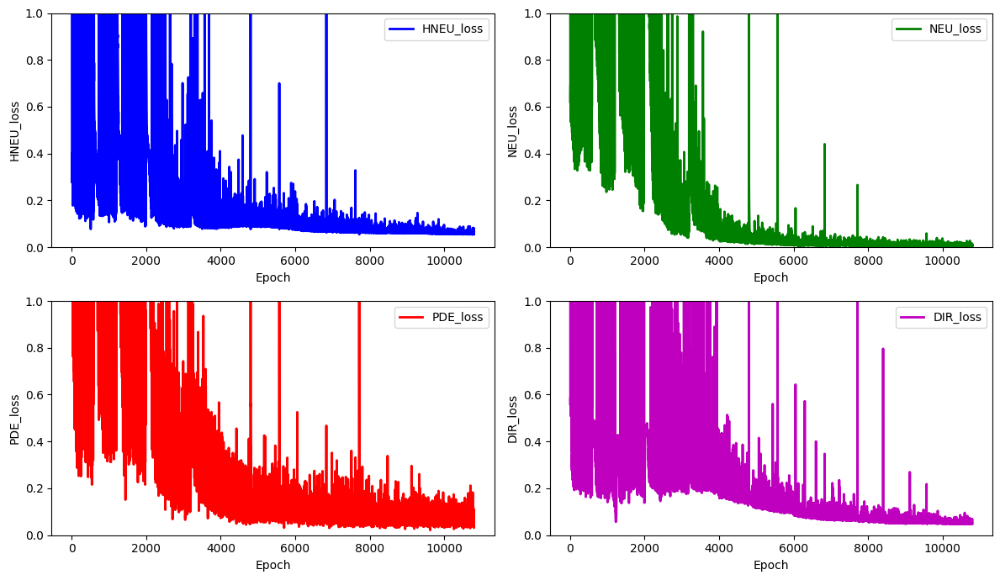

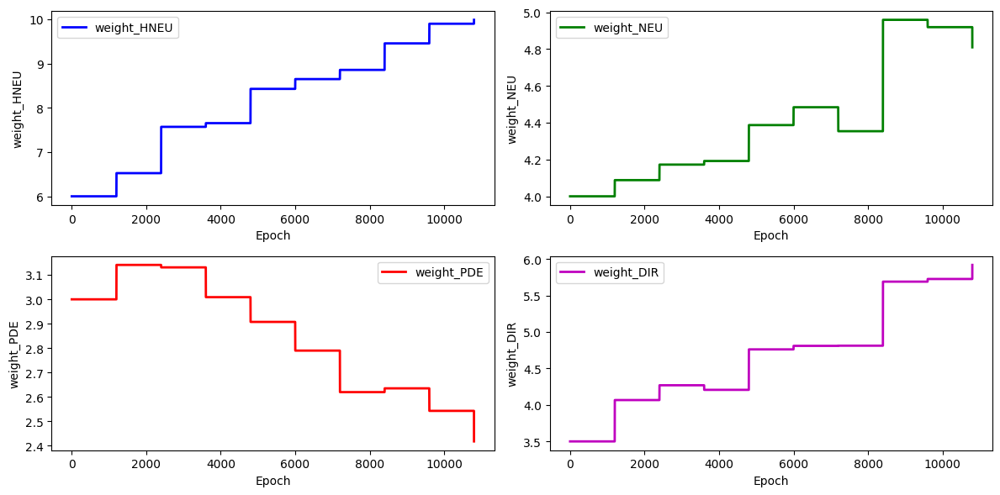

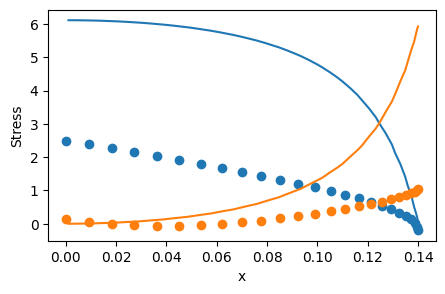

 76%|███████▌  | 11399/15000 [5:09:02<1:37:51,  1.63s/it]

total_loss: 0.21903295073361662, hole_loss:  0.05449271264841437, neumann_loss:  0.00555508155522007, pde_loss: 0.11041553375017789, dirichlet_loss: 0.04856962277980427


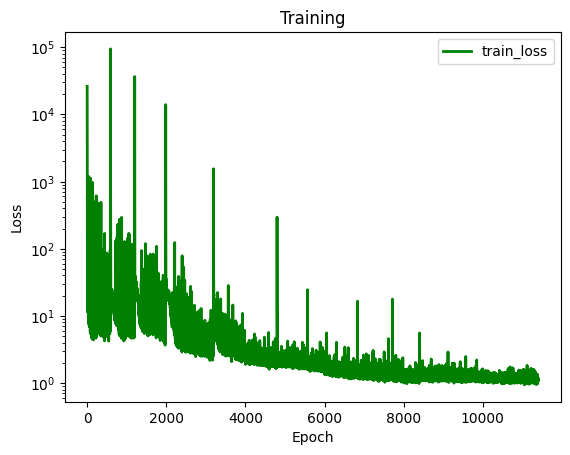

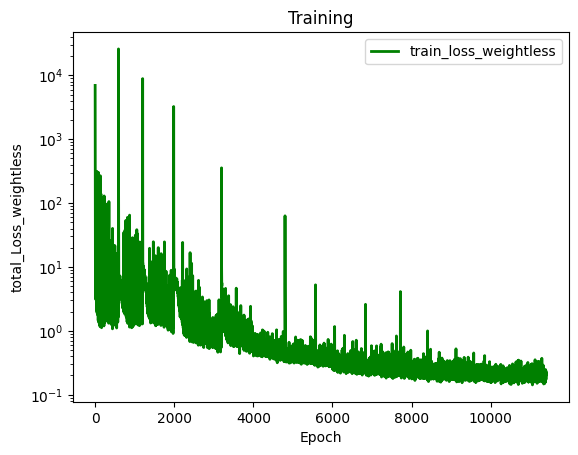

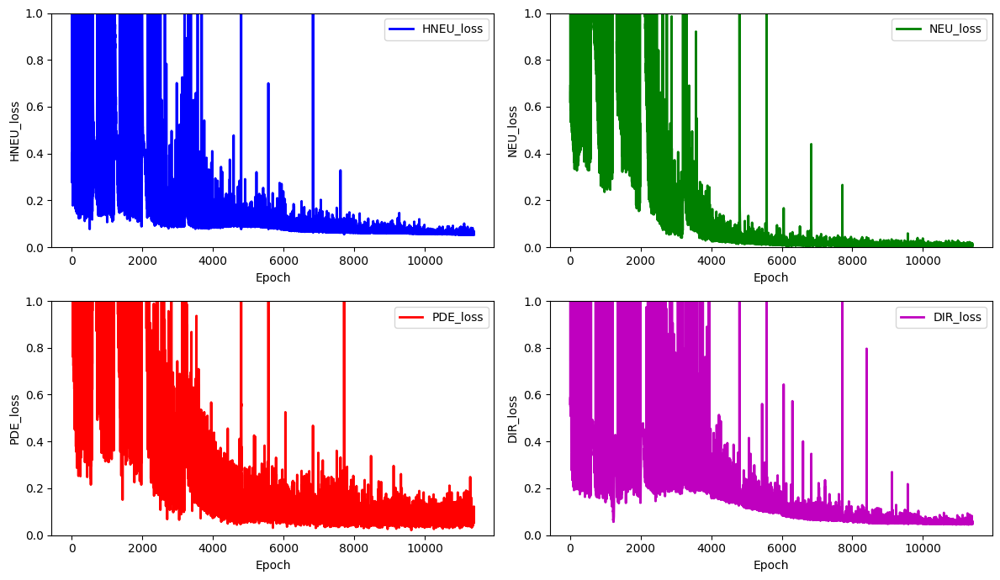

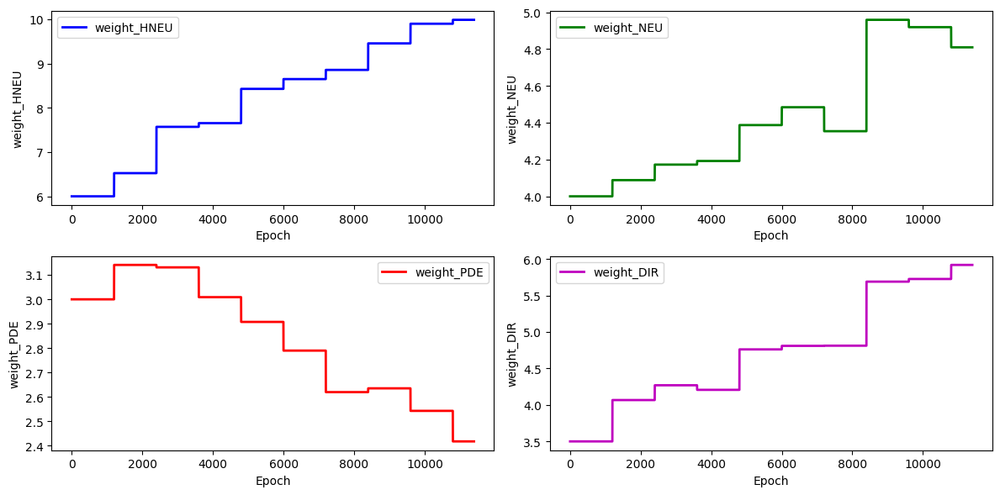

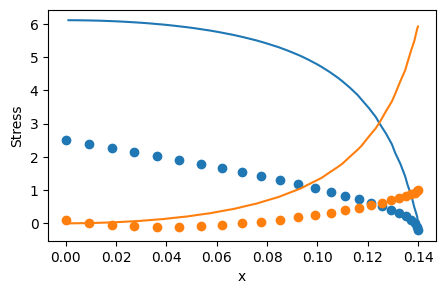

 80%|███████▉  | 11999/15000 [5:27:16<1:18:27,  1.57s/it] 

adopting weights after 1200 epochs
for weight 0 new weight_value: 10.161424644963331
for weight 1 new weight_value: 4.833209970083666
for weight 2 new weight_value: 2.3301925652607025
for weight 3 new weight_value: 6.375899359516637
total_loss: 0.17954424890721954, hole_loss:  0.05328170694211051, neumann_loss:  0.007278559474230738, pde_loss: 0.07186411957002445, dirichlet_loss: 0.04711986292085384


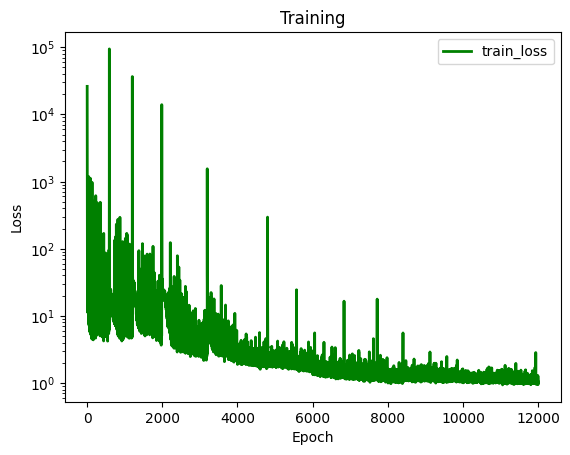

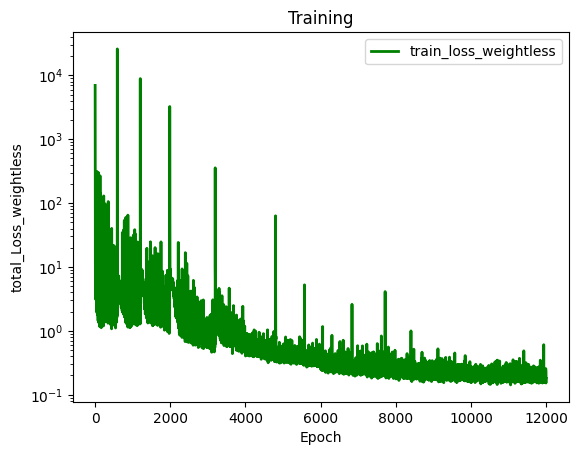

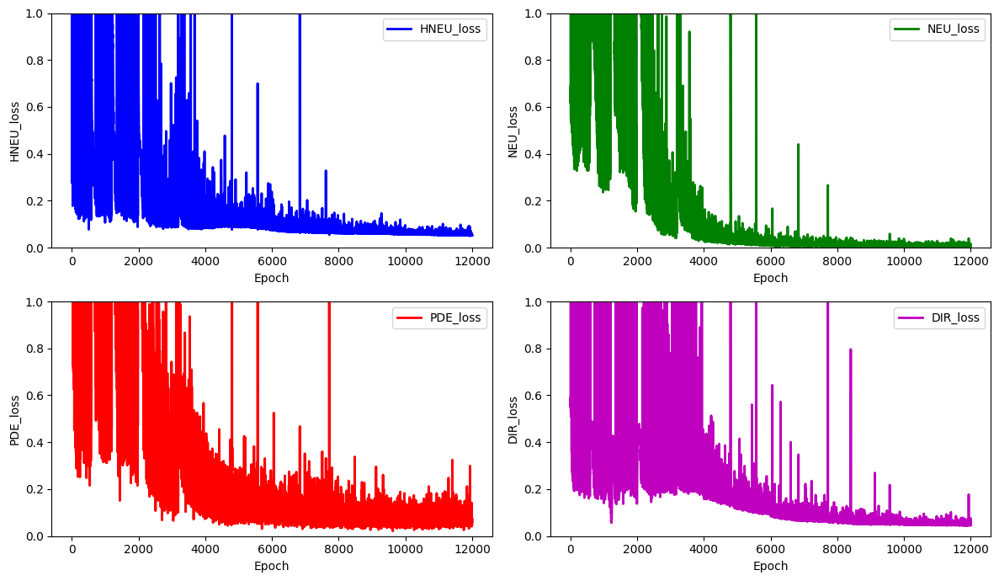

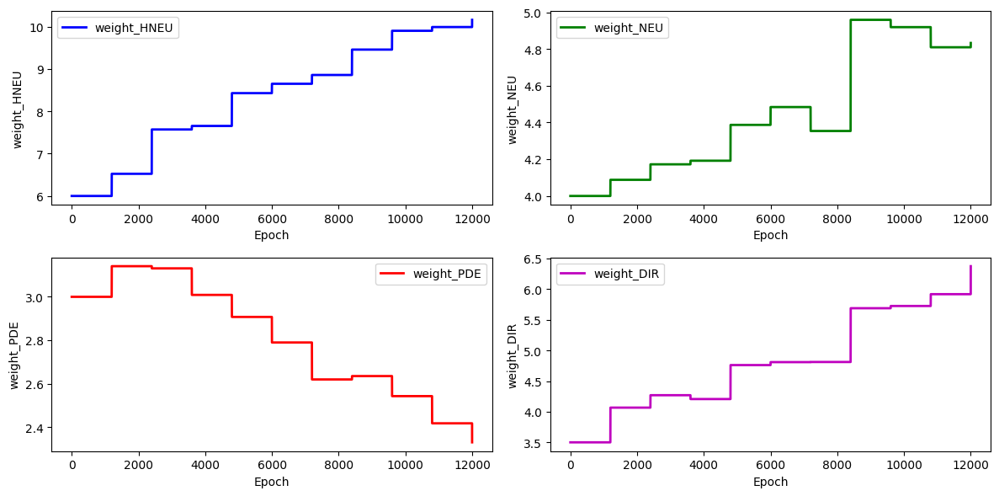

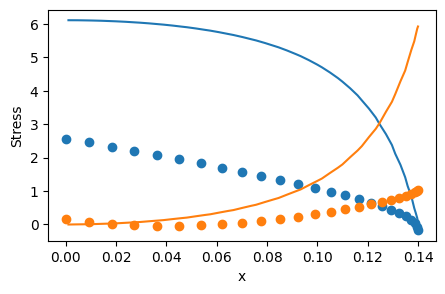

 84%|████████▍ | 12599/15000 [5:43:44<1:05:14,  1.63s/it]

total_loss: 0.1928144389943598, hole_loss:  0.05272515416174152, neumann_loss:  0.00563139137532378, pde_loss: 0.09000898220881041, dirichlet_loss: 0.044448911248484074


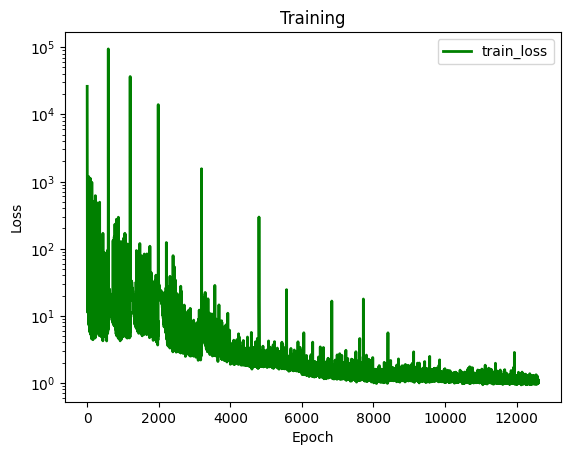

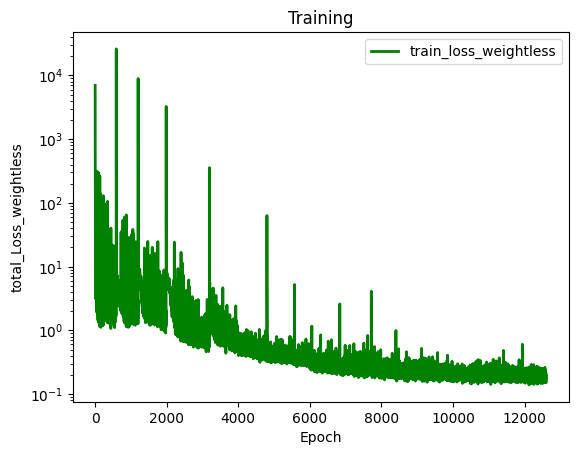

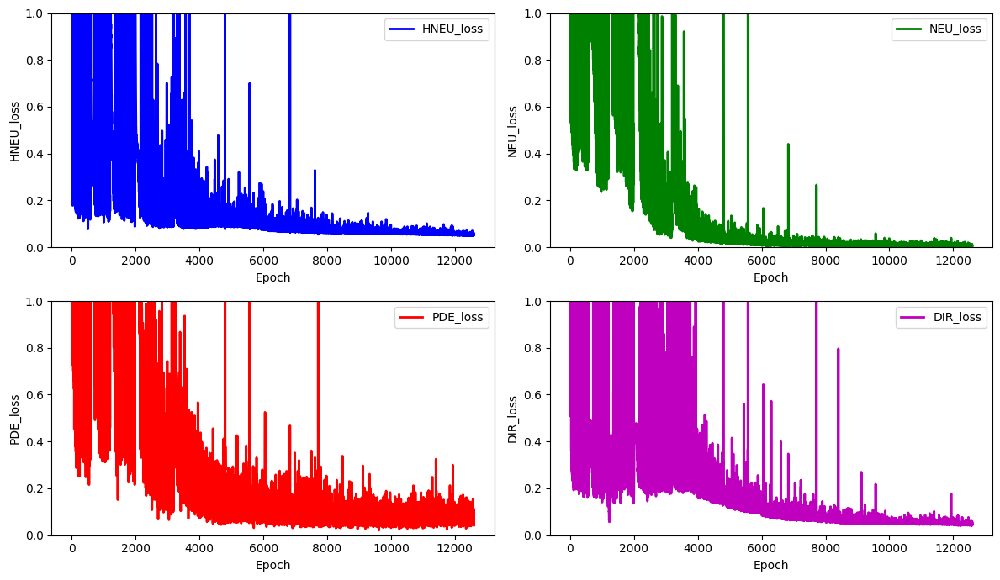

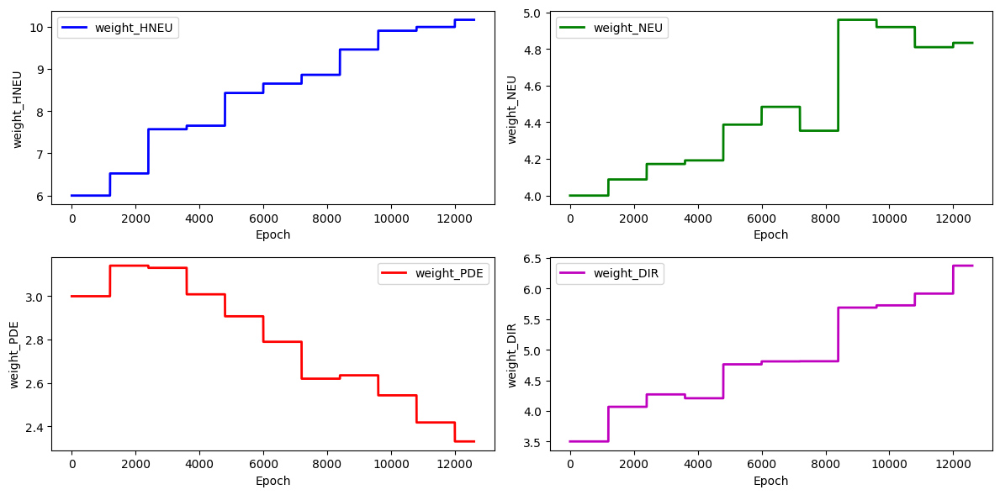

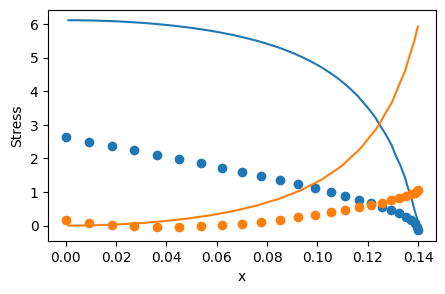

 88%|████████▊ | 13199/15000 [6:00:51<50:40,  1.69s/it]  

adopting weights after 1200 epochs
for weight 0 new weight_value: 10.749843394314077
for weight 1 new weight_value: 4.8750126178963145
for weight 2 new weight_value: 2.259476221044188
for weight 3 new weight_value: 7.160709433991758
total_loss: 0.19252539601222785, hole_loss:  0.05101662802754854, neumann_loss:  0.018076897967808418, pde_loss: 0.08302506336082072, dirichlet_loss: 0.04040680665605019


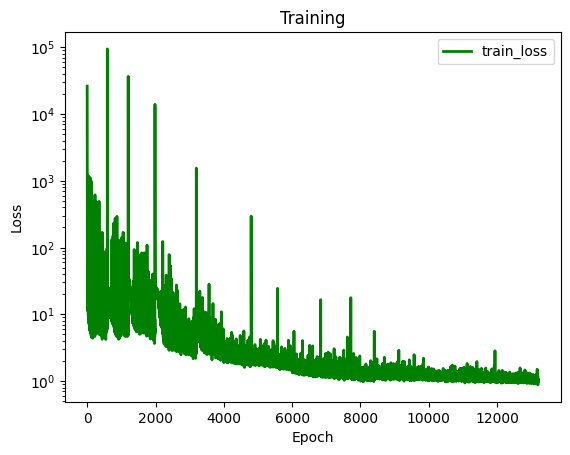

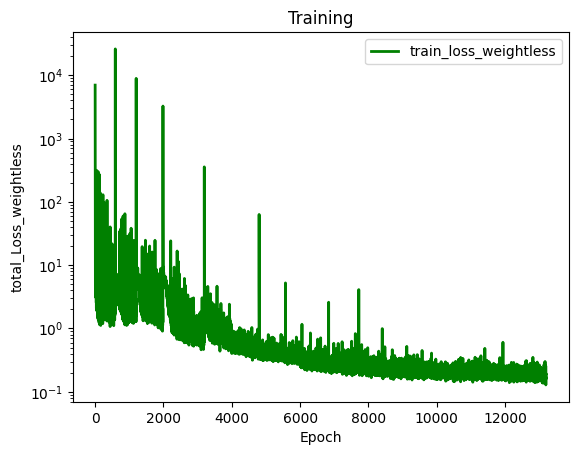

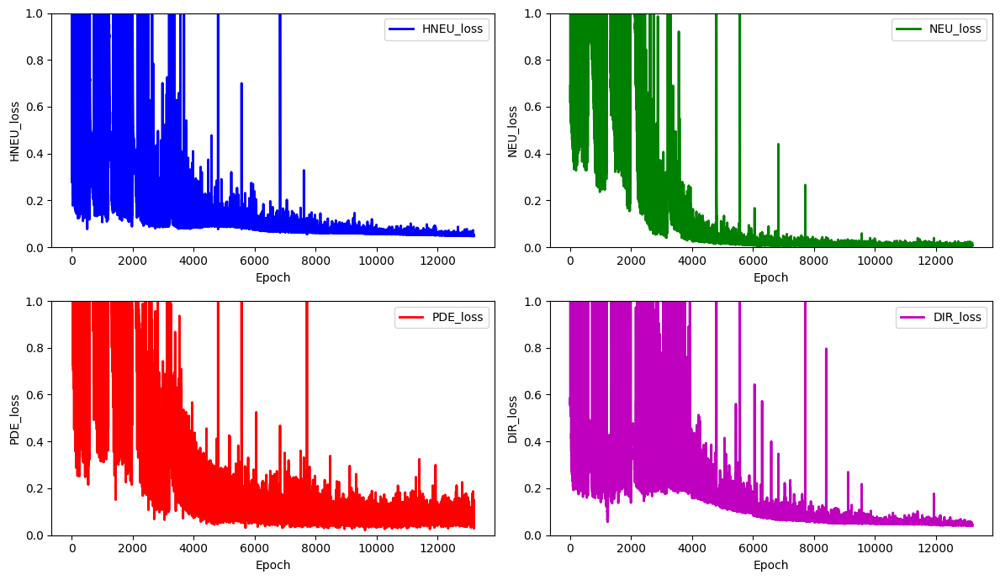

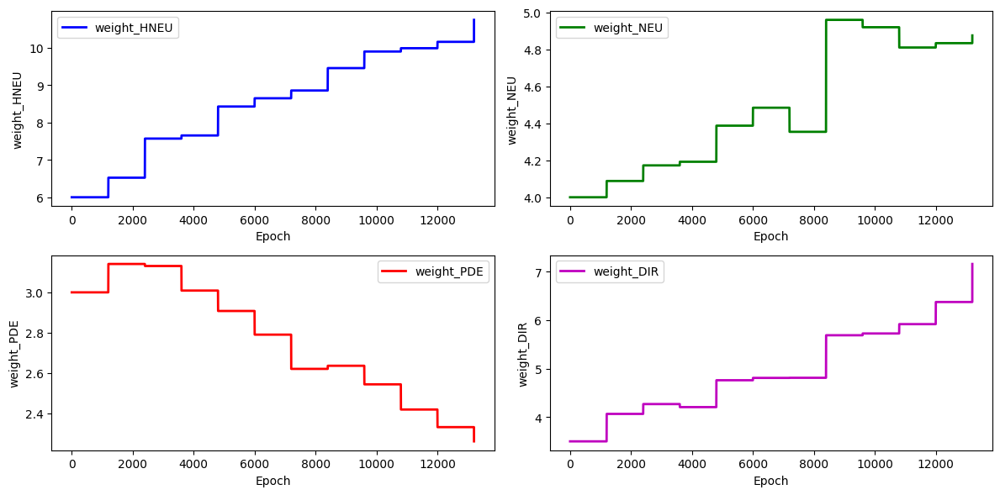

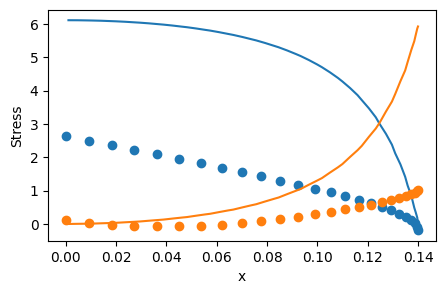

 92%|█████████▏| 13799/15000 [6:17:30<32:59,  1.65s/it]  

total_loss: 0.19778106663871975, hole_loss:  0.04932751812334506, neumann_loss:  0.011884513341221101, pde_loss: 0.09630664780009497, dirichlet_loss: 0.04026238737405864


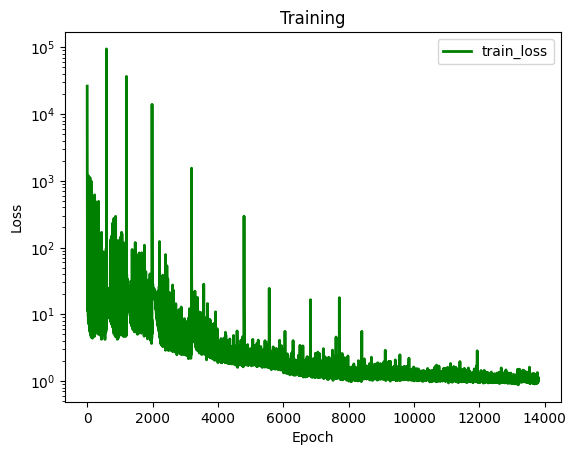

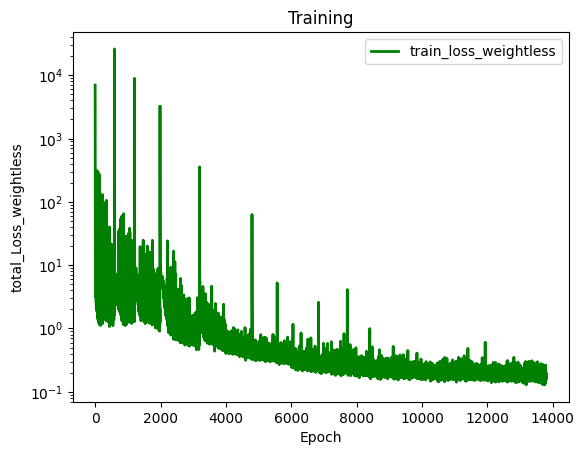

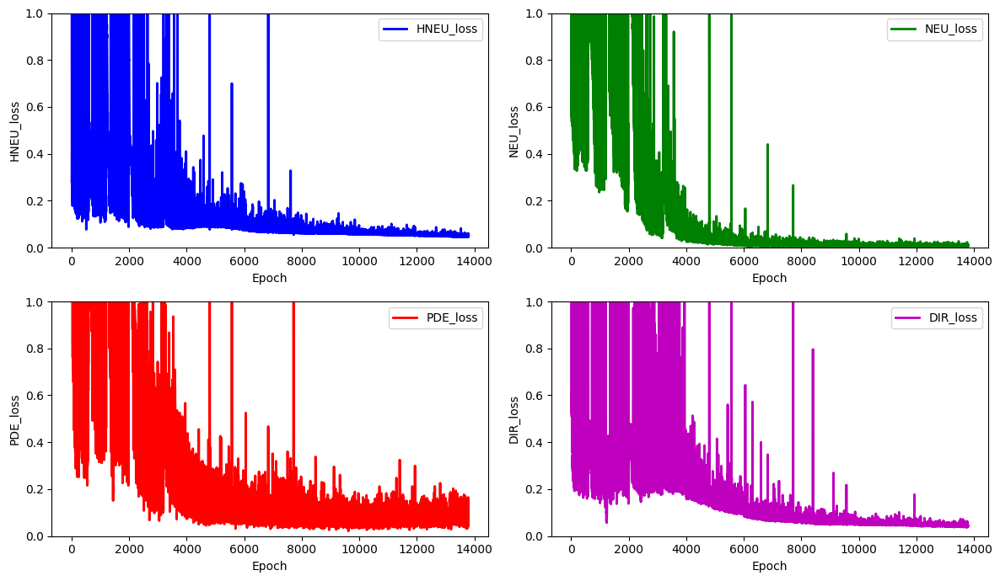

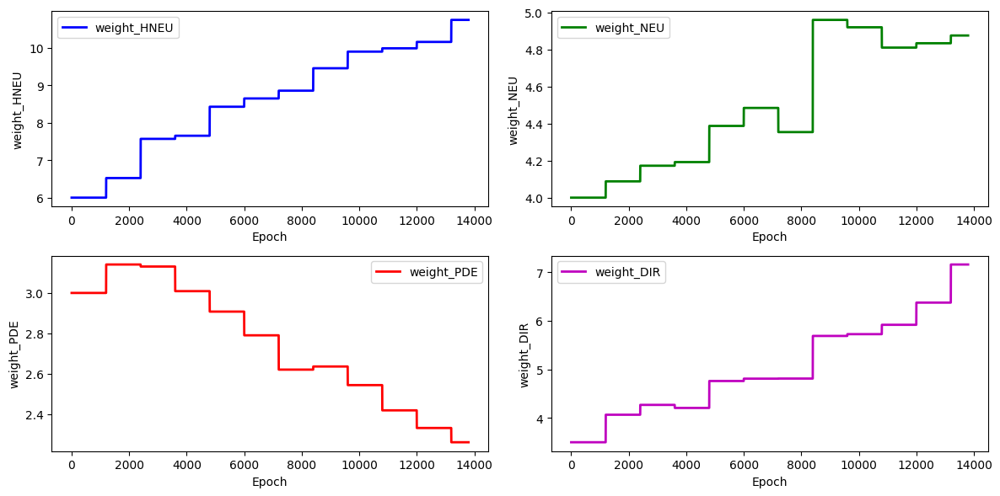

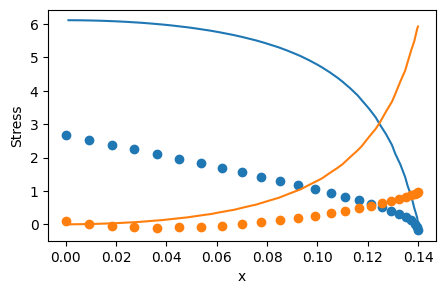

 96%|█████████▌| 14399/15000 [6:34:38<16:55,  1.69s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 11.235593231998978
for weight 1 new weight_value: 5.1398751406309655
for weight 2 new weight_value: 2.2200415654805705
for weight 3 new weight_value: 7.879690754317615
total_loss: 0.19387592370331933, hole_loss:  0.048251013397521164, neumann_loss:  0.008631784859626441, pde_loss: 0.0982795828400504, dirichlet_loss: 0.03871354260612133


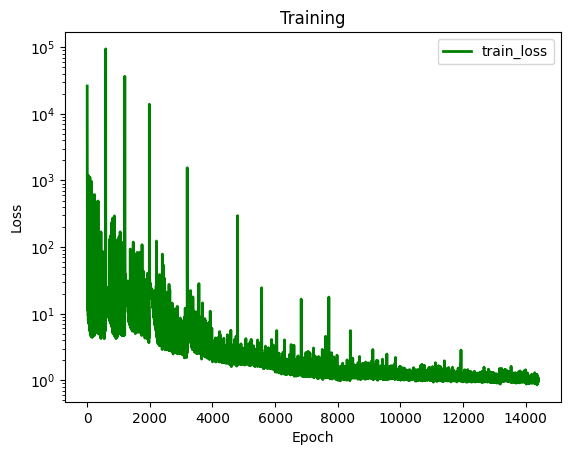

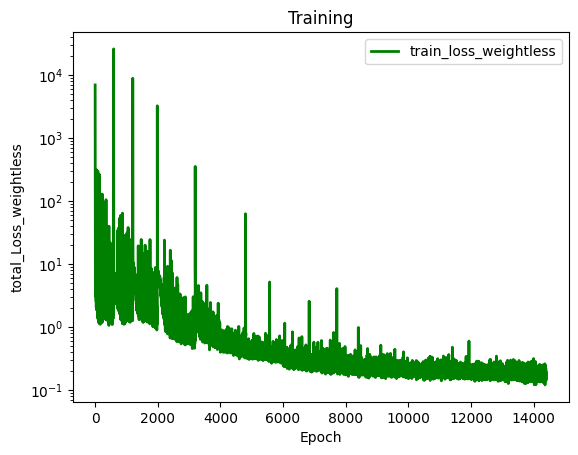

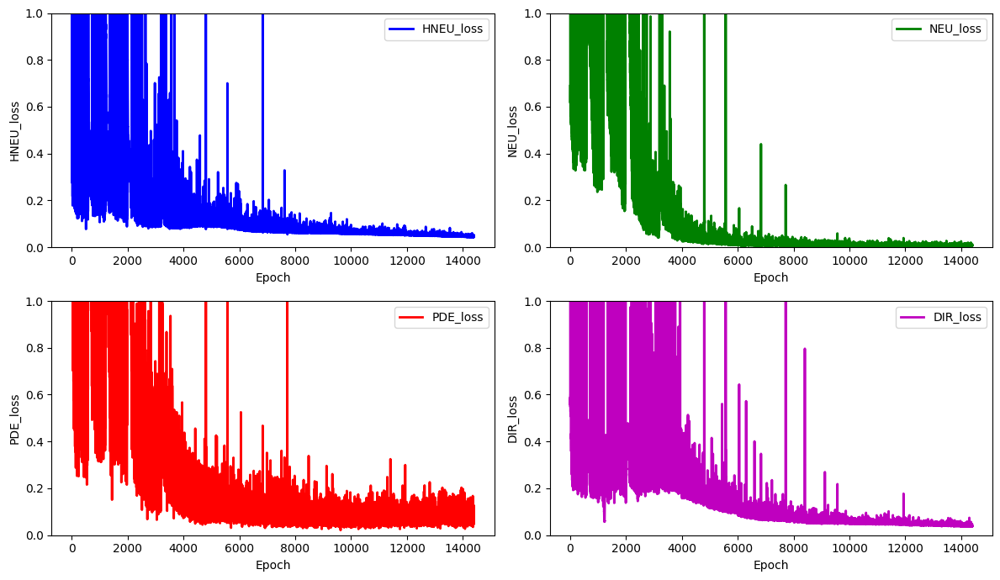

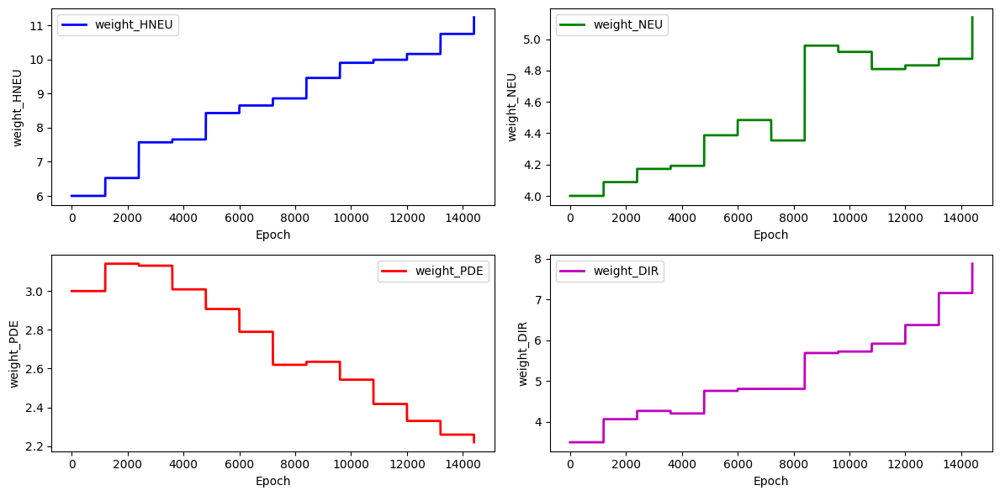

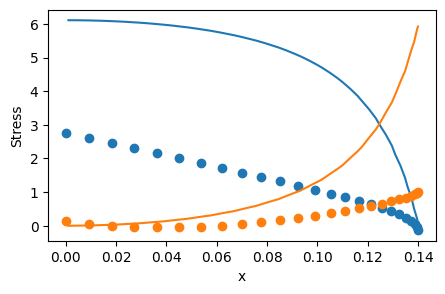

100%|█████████▉| 14999/15000 [6:51:18<00:01,  1.67s/it]

total_loss: 0.13790872785127234, hole_loss:  0.04842898410107661, neumann_loss:  0.005419747635498939, pde_loss: 0.04645143729183498, dirichlet_loss: 0.03760855882286183


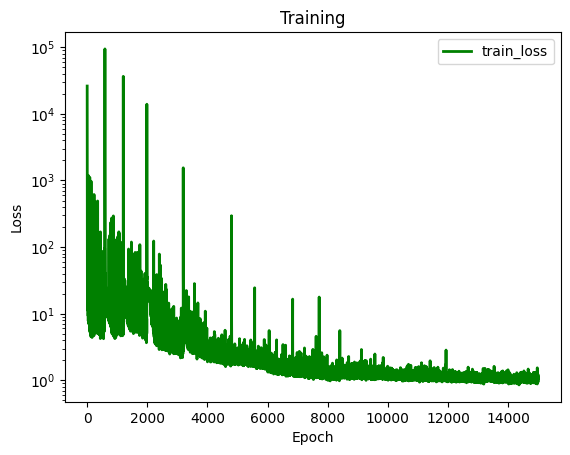

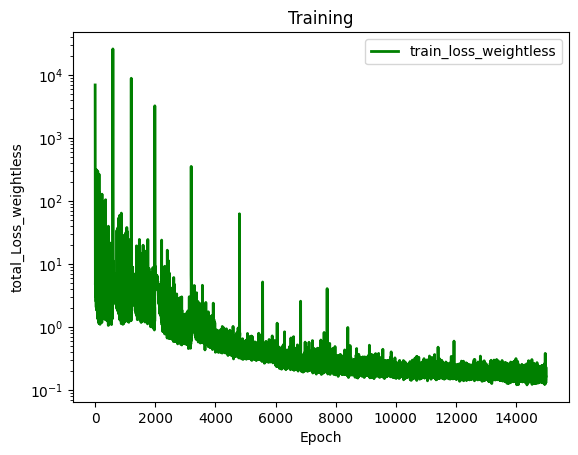

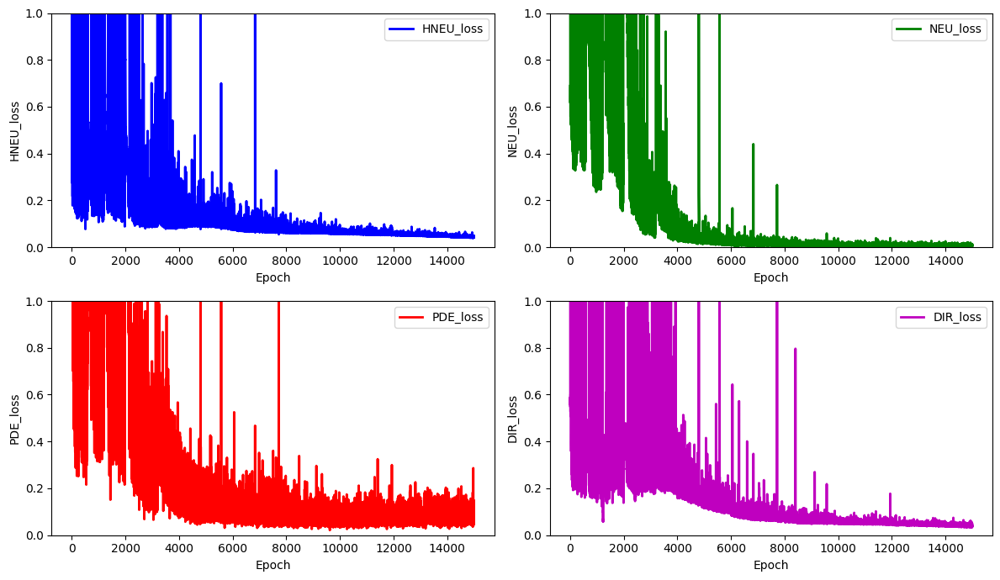

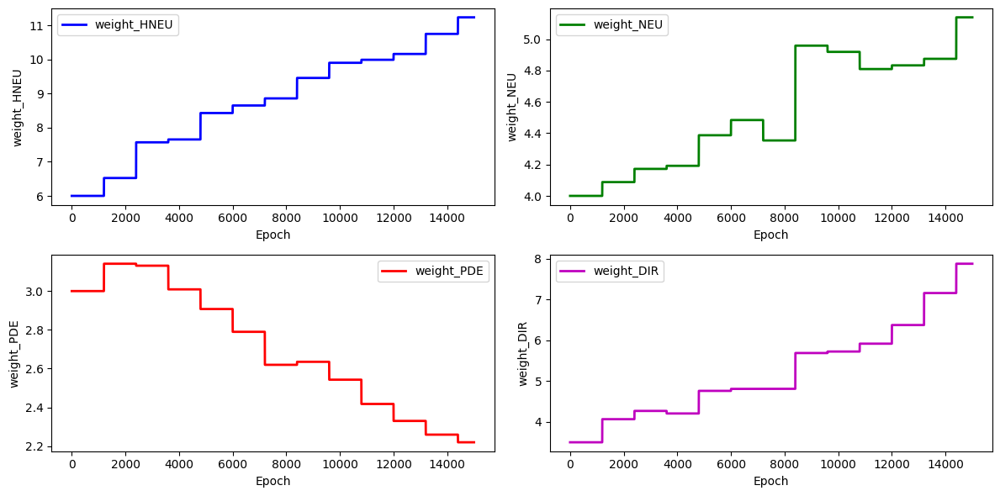

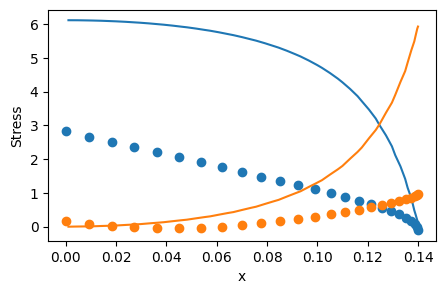

100%|██████████| 15000/15000 [6:51:22<00:00,  1.65s/it]

total_loss: 0.13790872785127234, hole_loss:  0.04842898410107661, neumann_loss:  0.005419747635498939, pde_loss: 0.04645143729183498, dirichlet_loss: 0.03760855882286183
previous lowest lost  5
lowest loss 0.9714531269427393 archived, PINN is saved: 'net_param/net_0.97145313.pth


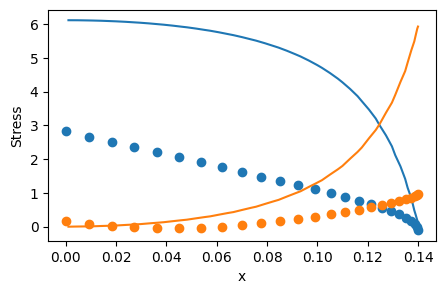

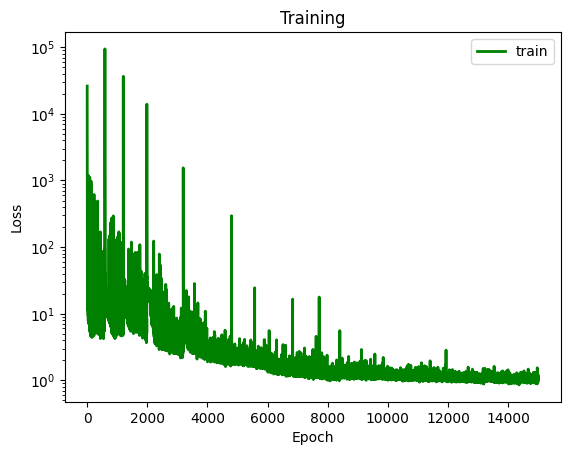

Weight_HNEU: 6.0, Weight_NEU: 4.0, Weight_PDE: 3.0, Weight_STRESS: 1.0, Stress Error: 16.969116712560705
Starting with Adam optimizer...


  4%|▍         | 599/15000 [16:29<6:31:36,  1.63s/it]

total_loss: 0.3789603874192336, hole_loss:  0.06548210818451769, neumann_loss:  0.020843726818840554, pde_loss: 0.0952536270296152, dirichlet_loss: 0.19738092538626015


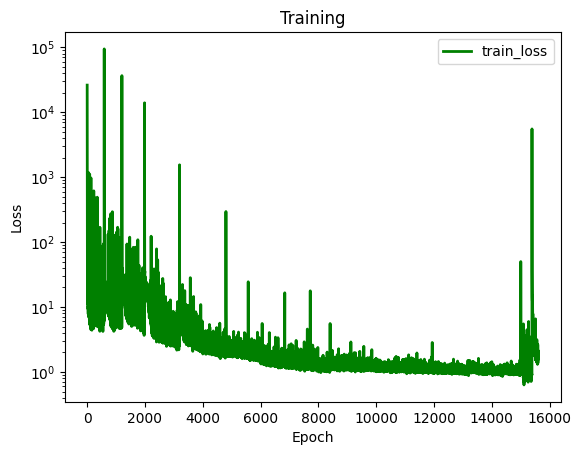

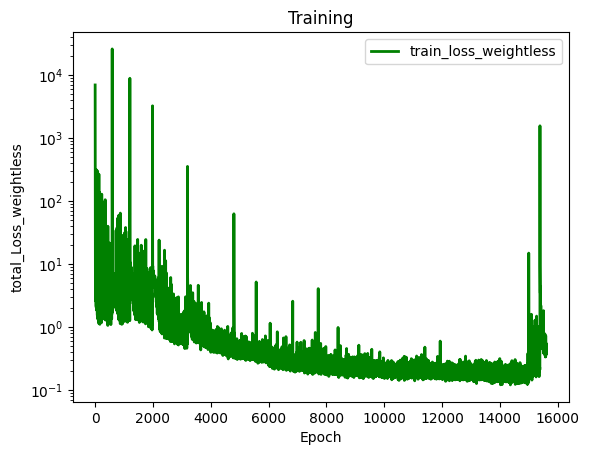

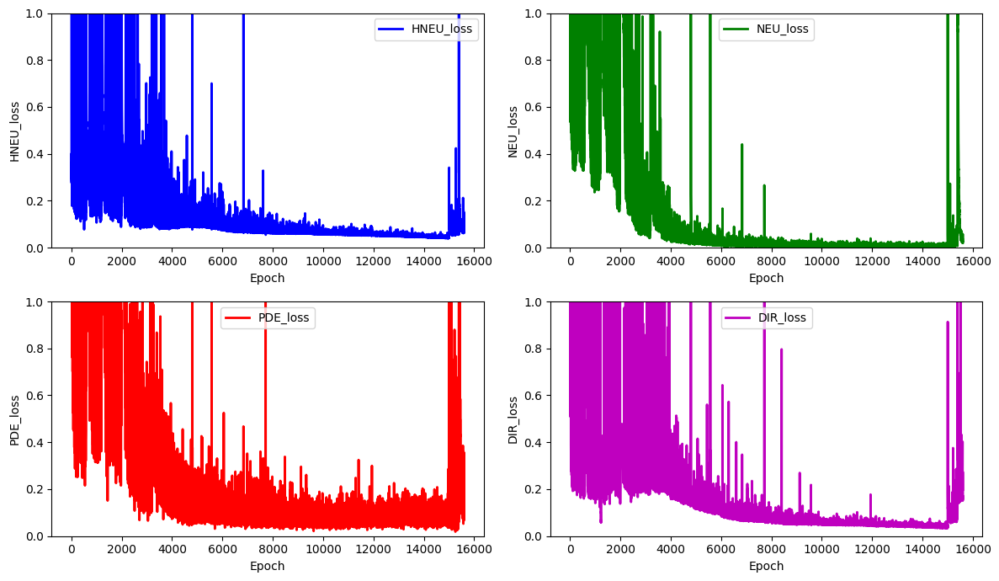

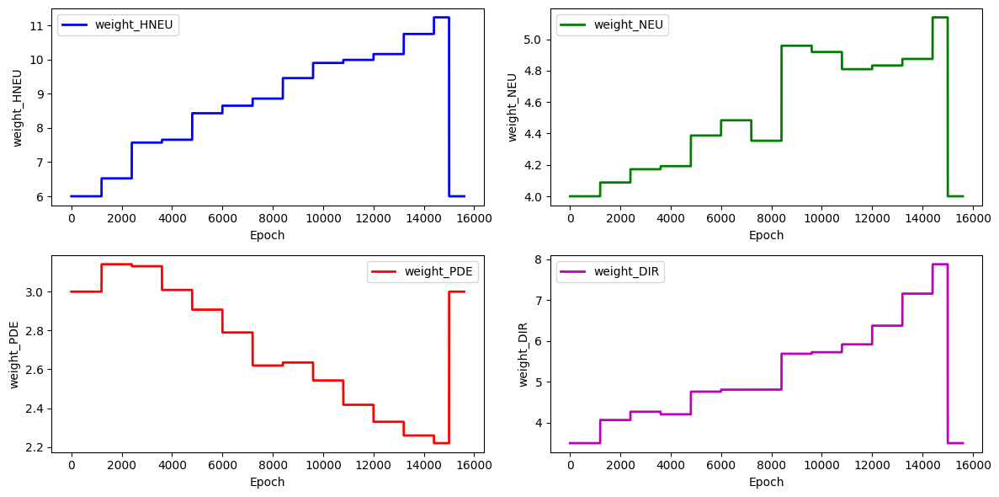

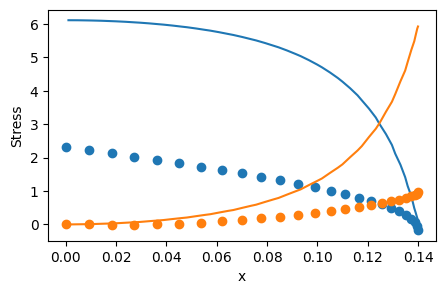

  8%|▊         | 1199/15000 [33:37<6:32:01,  1.70s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 6.393256093543556
for weight 1 new weight_value: 5.410275831461497
for weight 2 new weight_value: 2.906373949565126
for weight 3 new weight_value: 4.654302049112447
total_loss: 0.324987158231723, hole_loss:  0.13881724570945772, neumann_loss:  0.00916462479438348, pde_loss: 0.07454327878377187, dirichlet_loss: 0.1024620089441099


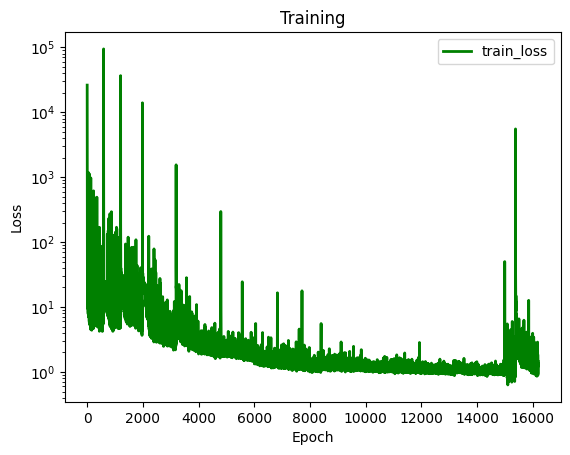

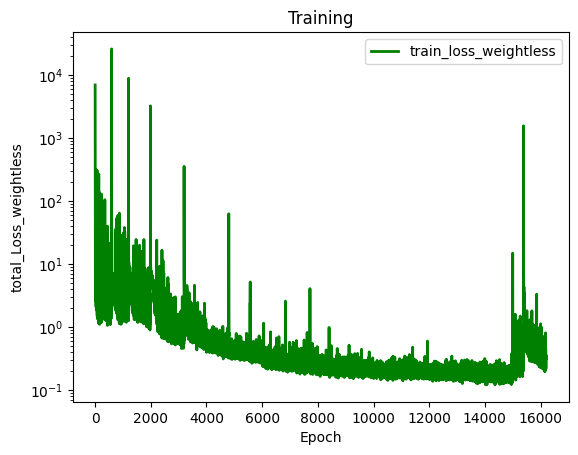

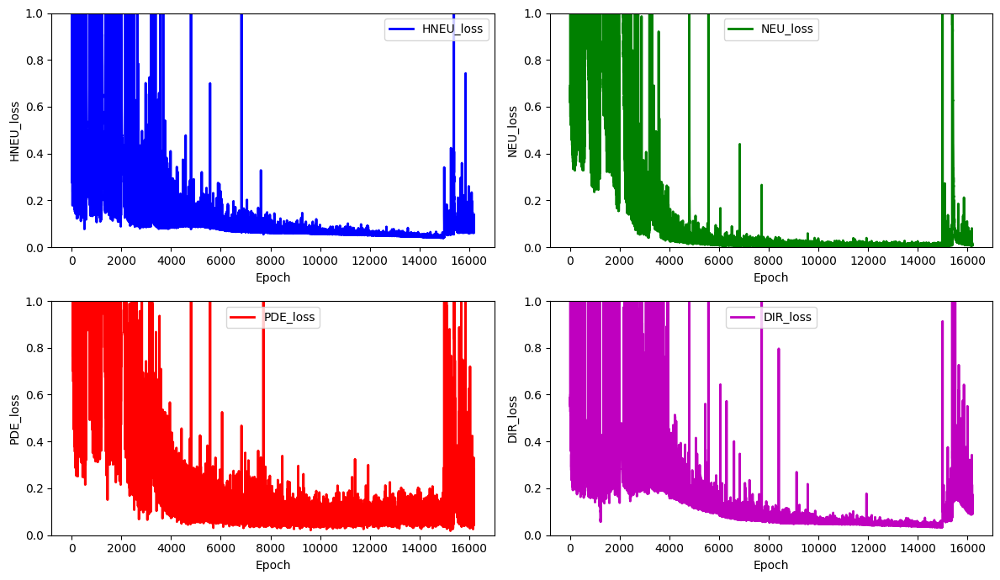

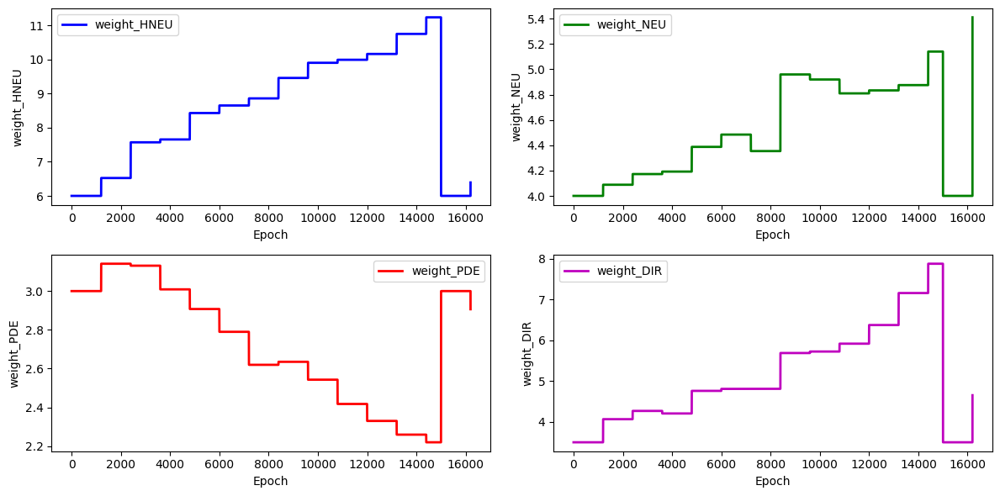

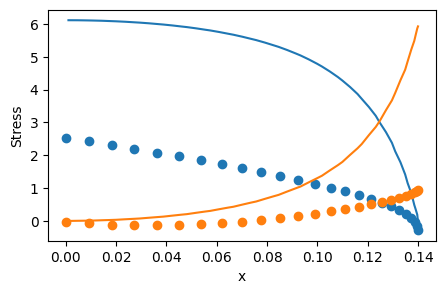

 12%|█▏        | 1799/15000 [50:32<6:12:33,  1.69s/it]

total_loss: 0.26741531520969464, hole_loss:  0.07477636418299217, neumann_loss:  0.01781887370709197, pde_loss: 0.07212323861577796, dirichlet_loss: 0.1026968387038325


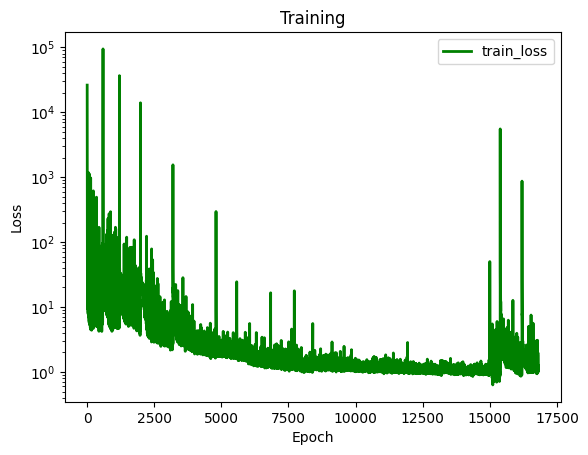

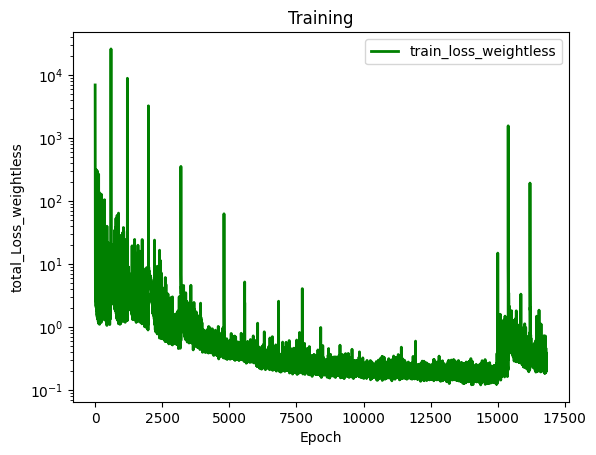

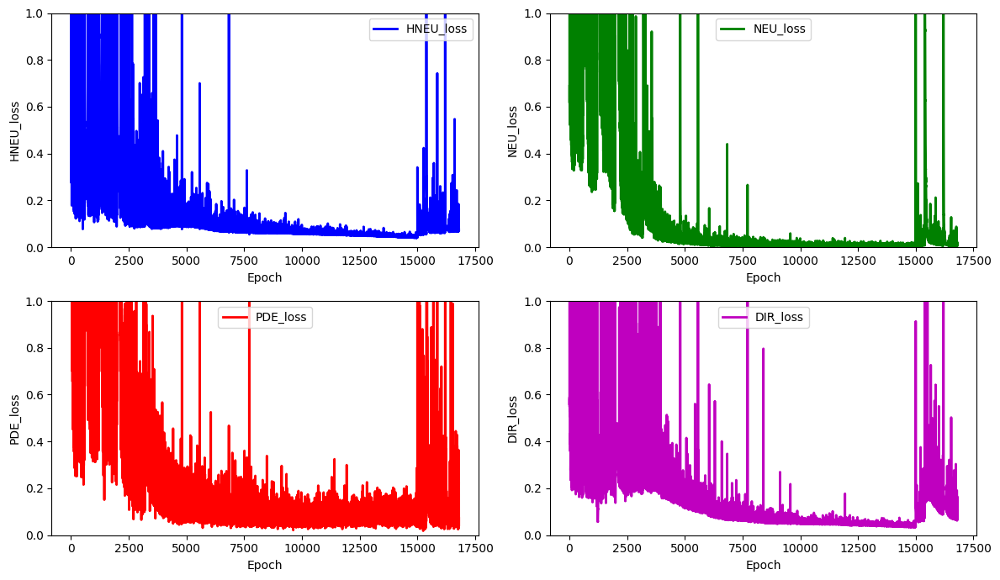

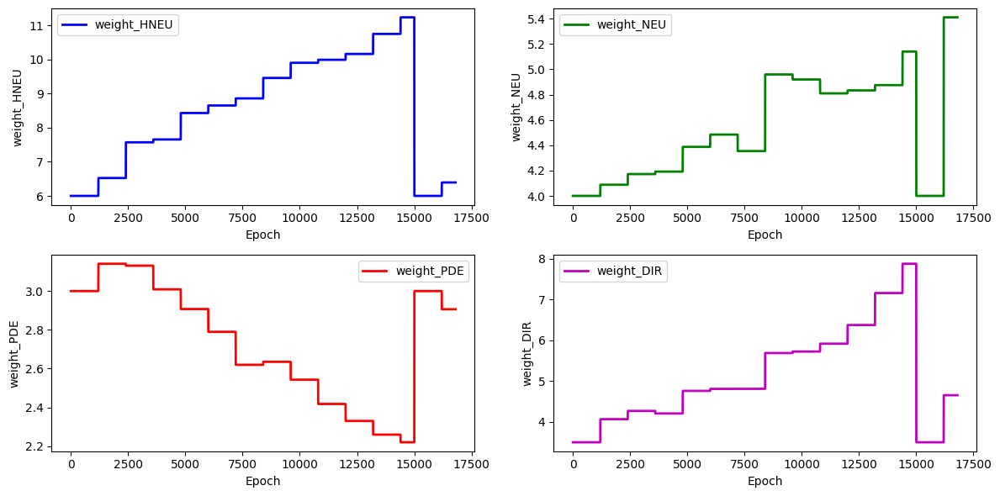

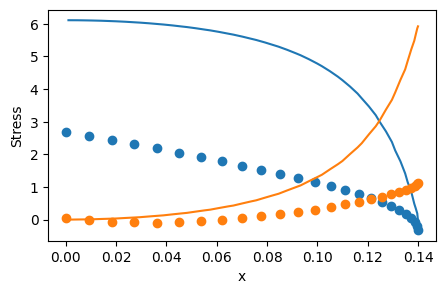

 16%|█▌        | 2399/15000 [1:08:00<5:59:40,  1.71s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 6.8223351322037
for weight 1 new weight_value: 6.429869256182298
for weight 2 new weight_value: 2.792061345745498
for weight 3 new weight_value: 5.912498095732682
total_loss: 0.2746462984330897, hole_loss:  0.08049031816586803, neumann_loss:  0.01340171204273583, pde_loss: 0.09746513434365499, dirichlet_loss: 0.08328913388083085


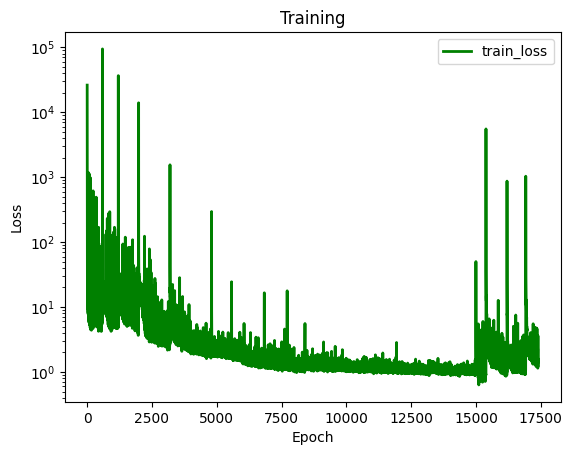

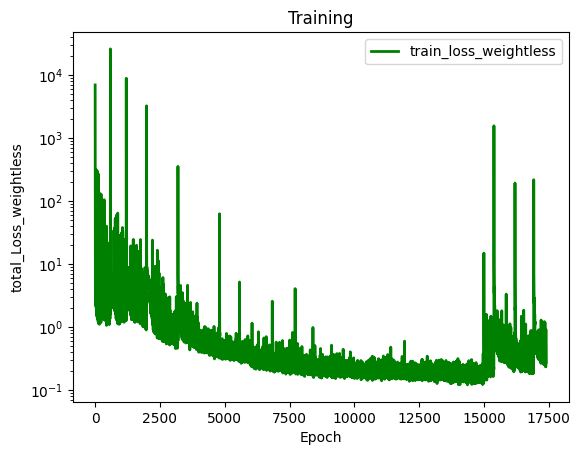

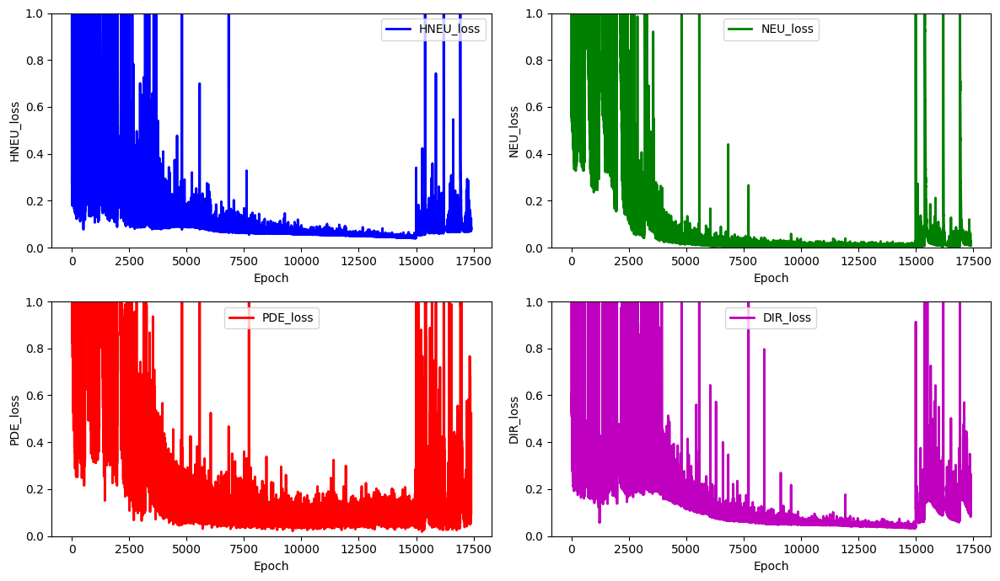

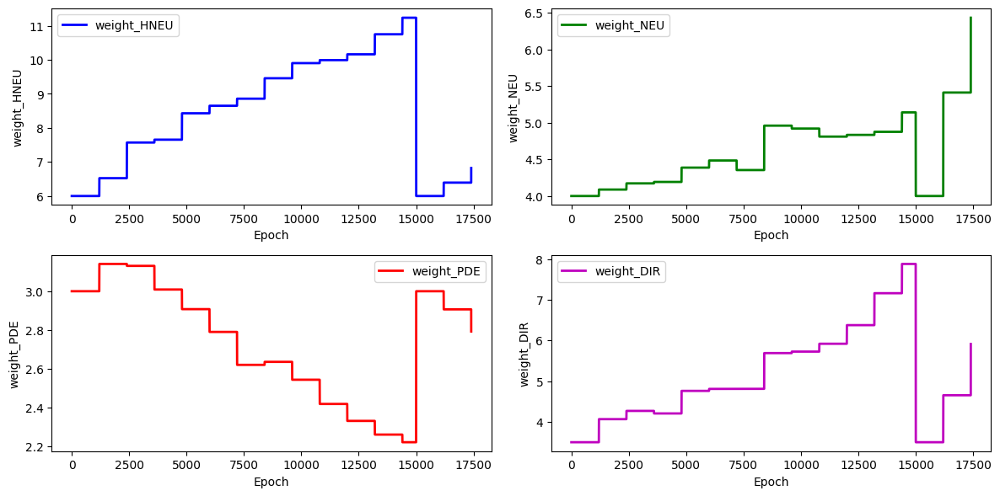

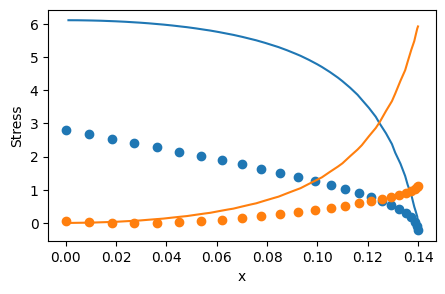

 20%|█▉        | 2999/15000 [1:24:30<5:29:47,  1.65s/it]

total_loss: 0.9232802622698525, hole_loss:  0.12980166830868015, neumann_loss:  0.12371790666533315, pde_loss: 0.5463934457556046, dirichlet_loss: 0.12336724154023464


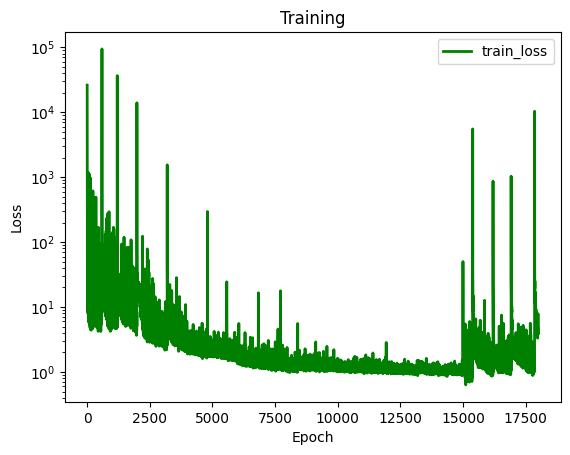

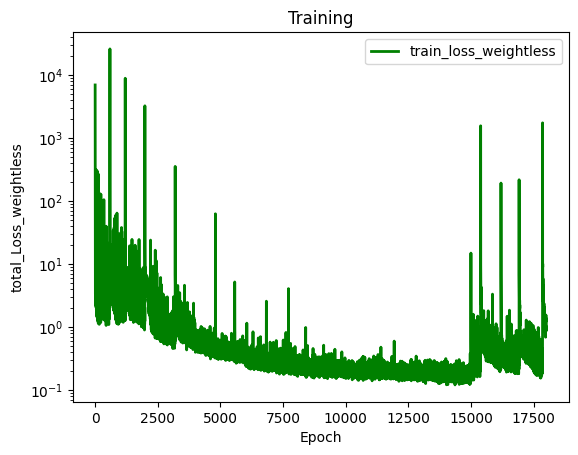

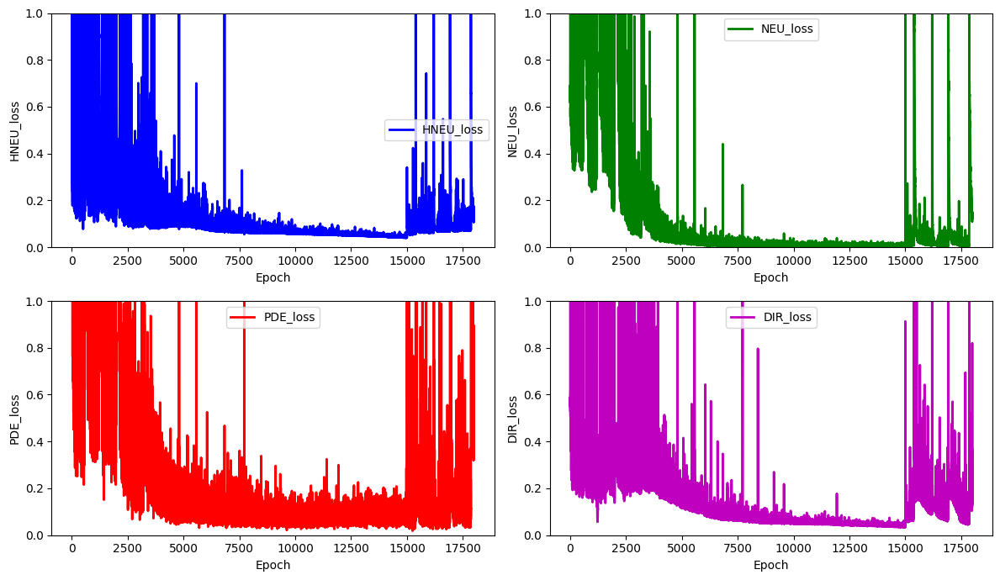

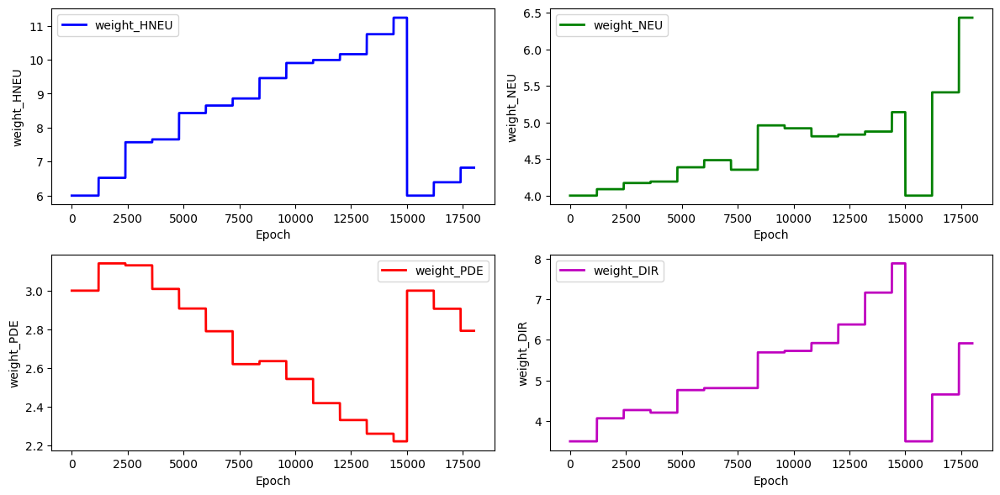

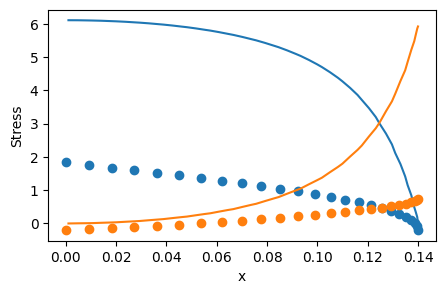

 24%|██▍       | 3599/15000 [1:41:28<5:21:11,  1.69s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 7.048250706463052
for weight 1 new weight_value: 6.514528286069861
for weight 2 new weight_value: 2.6798936749673166
for weight 3 new weight_value: 6.0958609188160535
total_loss: 0.44181433279831694, hole_loss:  0.11152678471058718, neumann_loss:  0.039512157398852124, pde_loss: 0.17321328373867215, dirichlet_loss: 0.1175621069502055


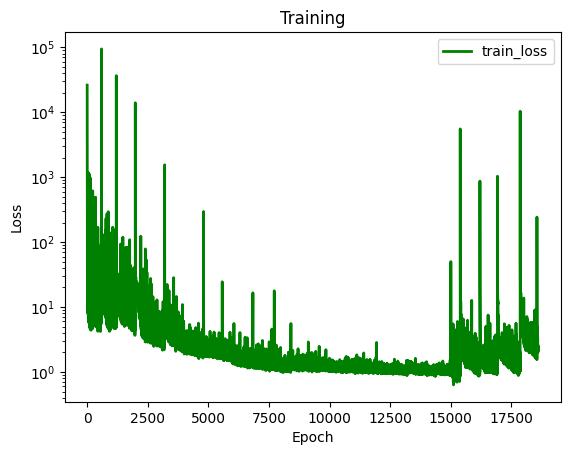

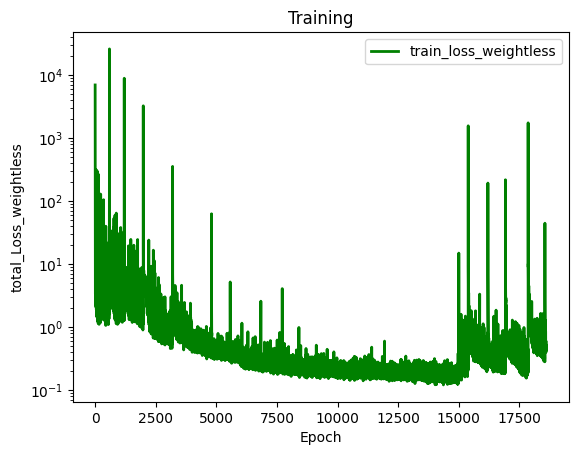

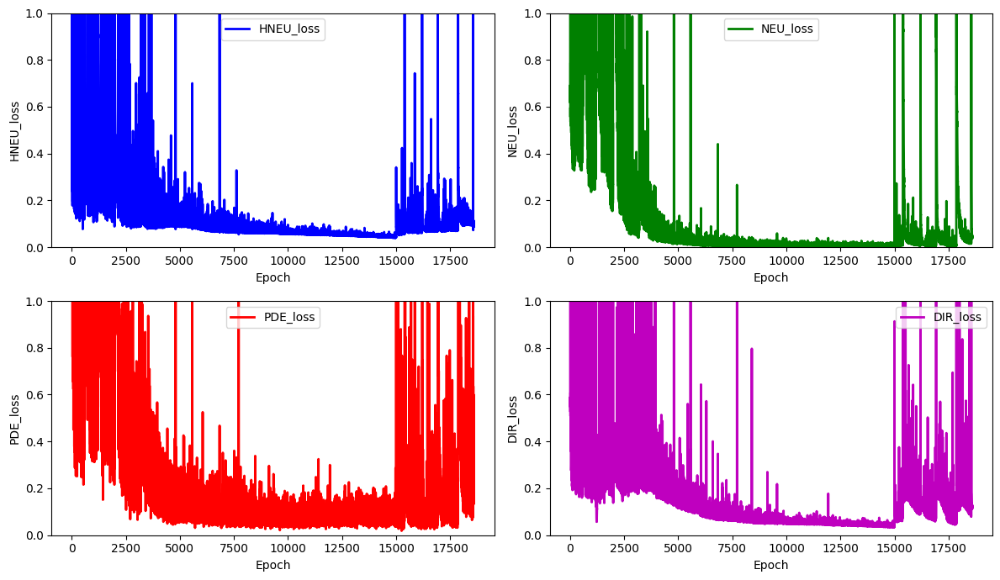

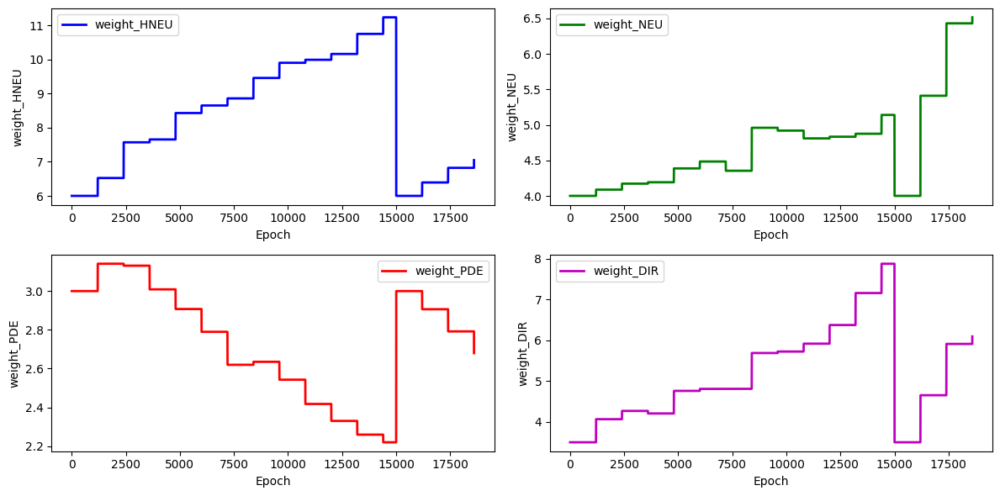

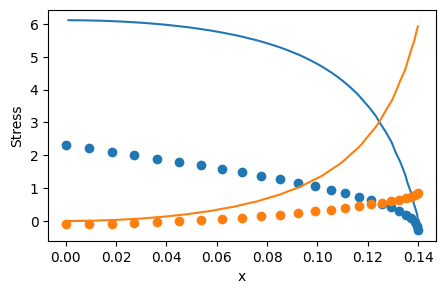

 28%|██▊       | 4199/15000 [1:57:58<4:55:12,  1.64s/it]

total_loss: 0.277879097835432, hole_loss:  0.08387077716730779, neumann_loss:  0.012265581289371602, pde_loss: 0.11453510828941373, dirichlet_loss: 0.06720763108933892


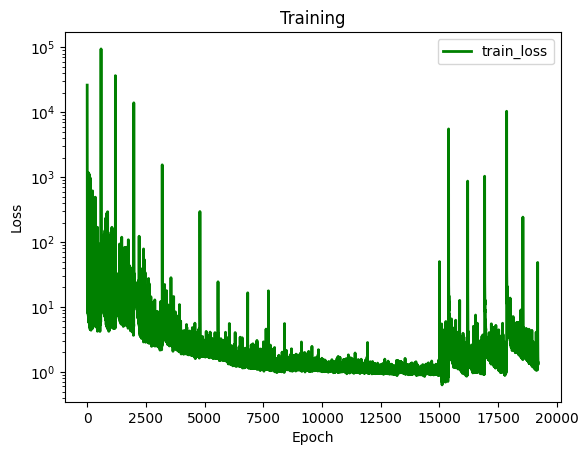

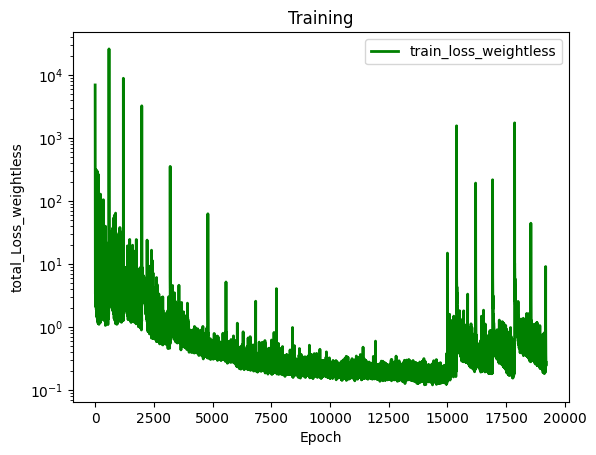

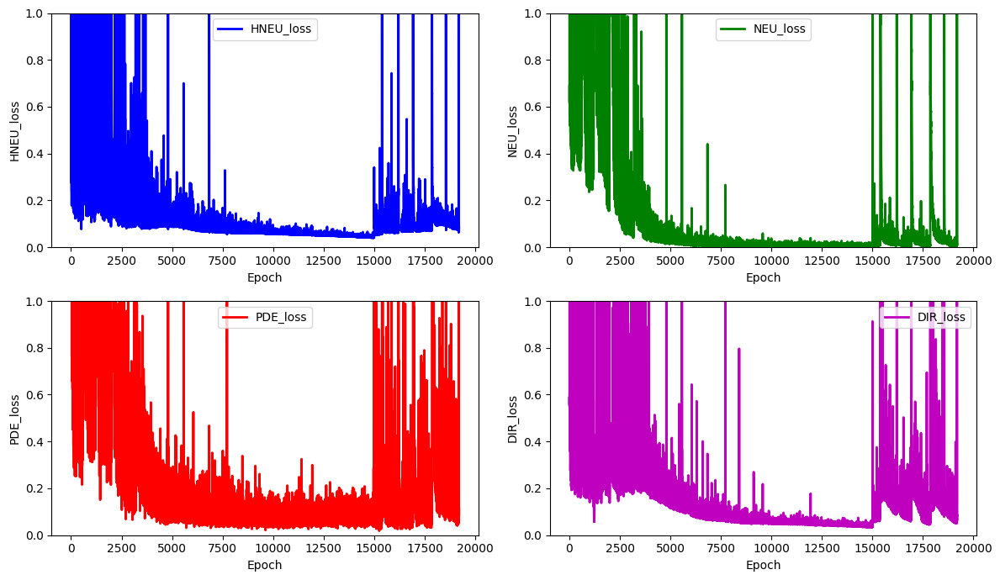

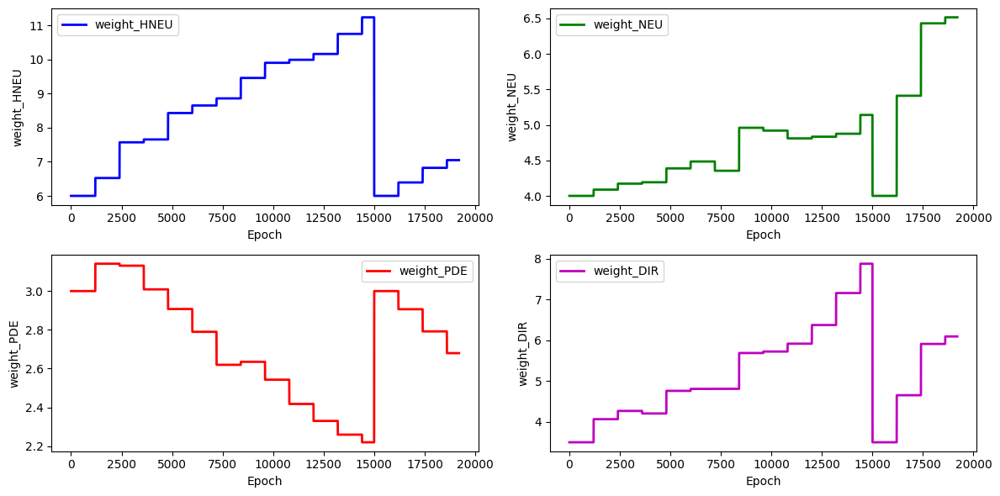

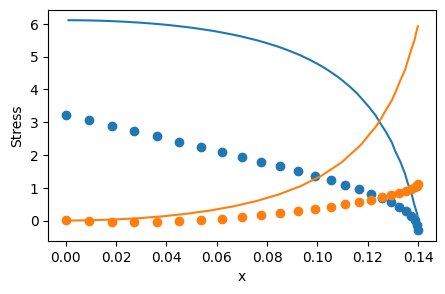

 32%|███▏      | 4799/15000 [2:14:54<4:48:02,  1.69s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 6.967854124841285
for weight 1 new weight_value: 6.64491601821859
for weight 2 new weight_value: 2.5163682359113437
for weight 3 new weight_value: 6.070779475350148
total_loss: 0.15163394022516474, hole_loss:  0.07183694456271307, neumann_loss:  0.0029018186811882204, pde_loss: 0.03370637110156134, dirichlet_loss: 0.04318880587970213


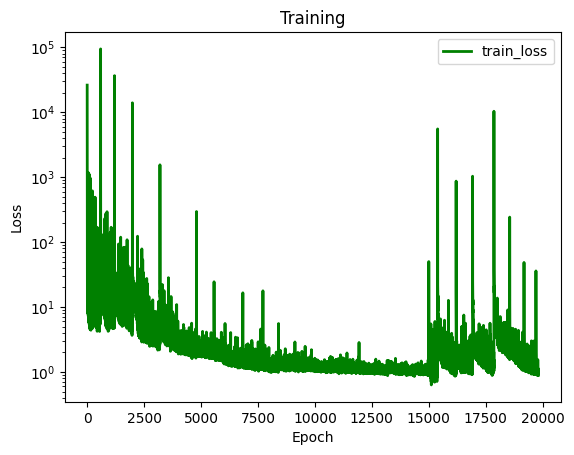

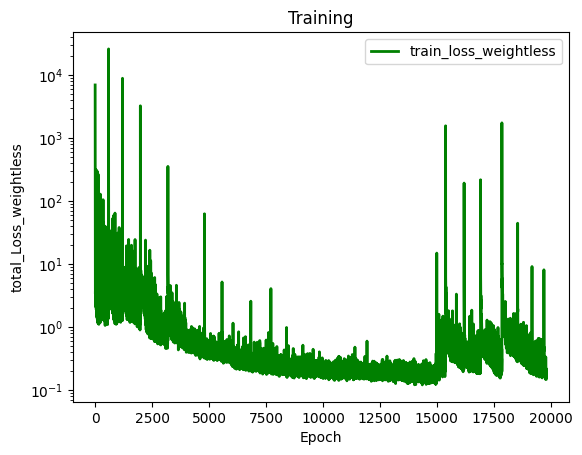

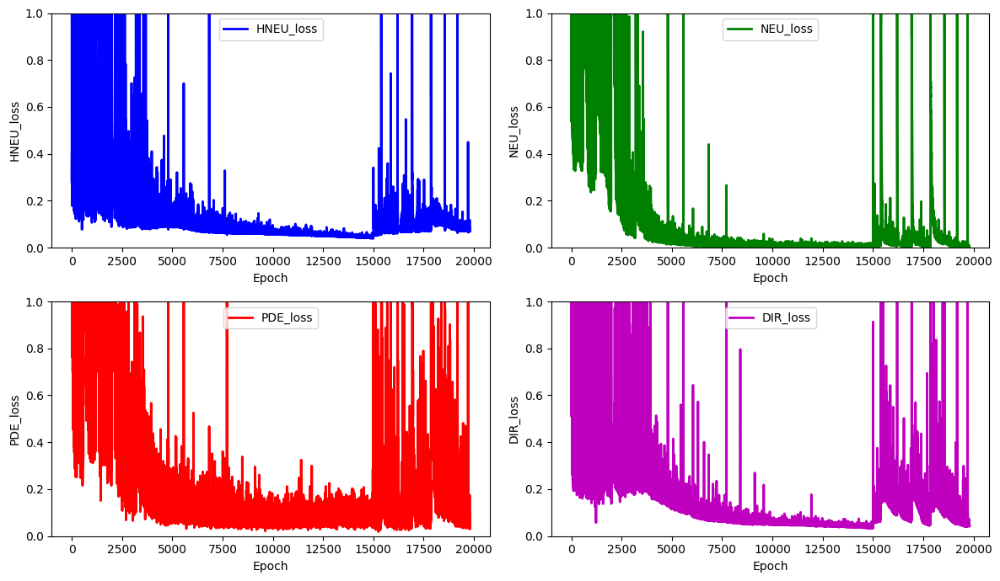

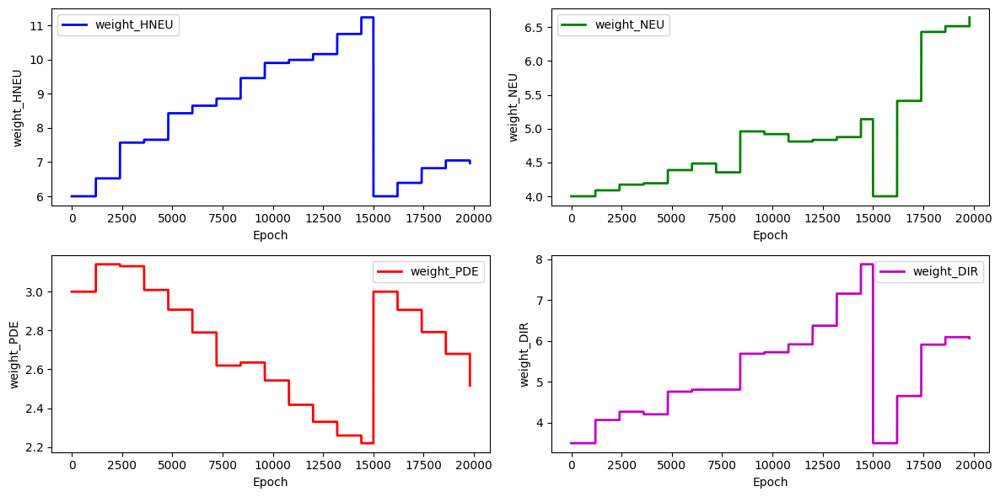

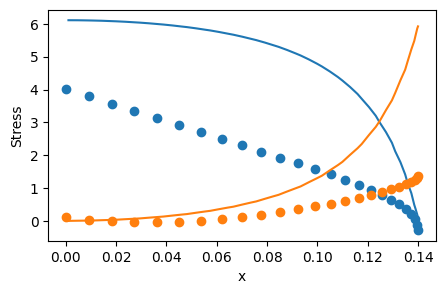

 36%|███▌      | 5399/15000 [2:31:28<4:21:58,  1.64s/it]

total_loss: 0.17278382439467826, hole_loss:  0.068983885337907, neumann_loss:  0.003944049942013543, pde_loss: 0.06112568892733134, dirichlet_loss: 0.03873020018742637


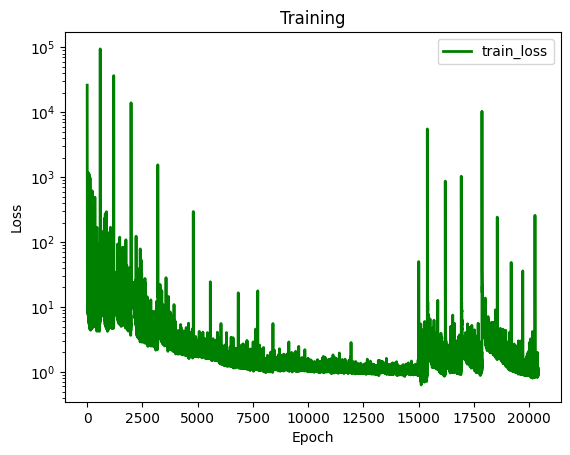

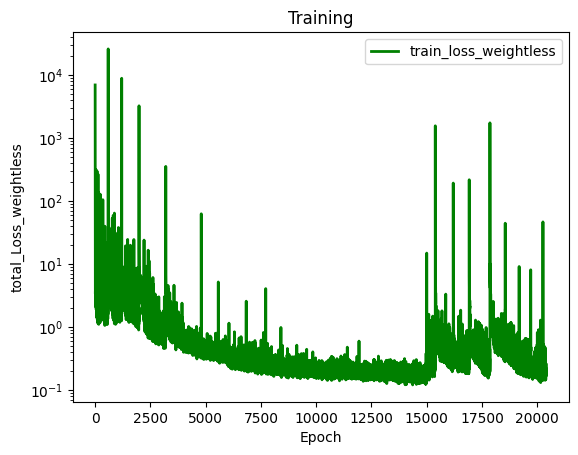

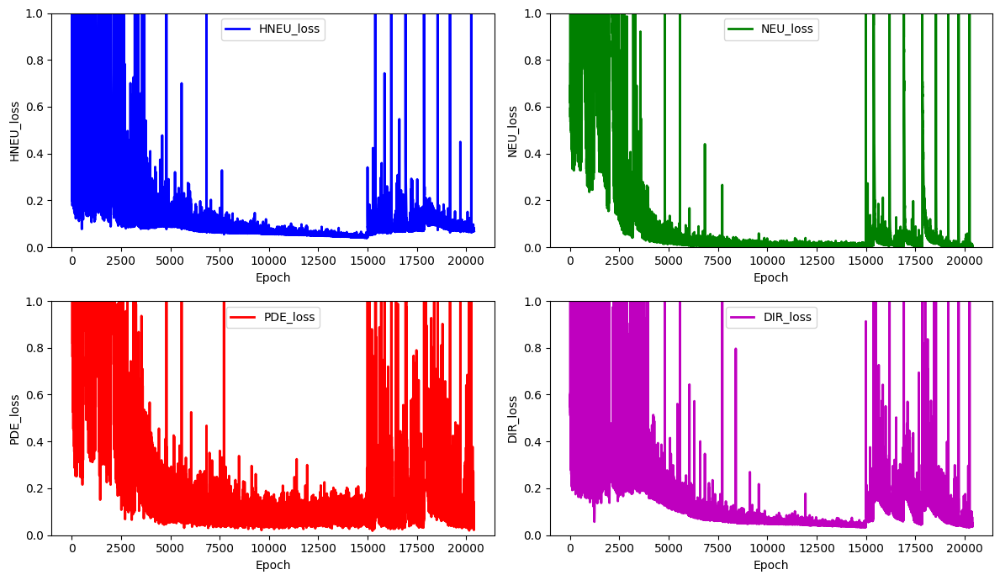

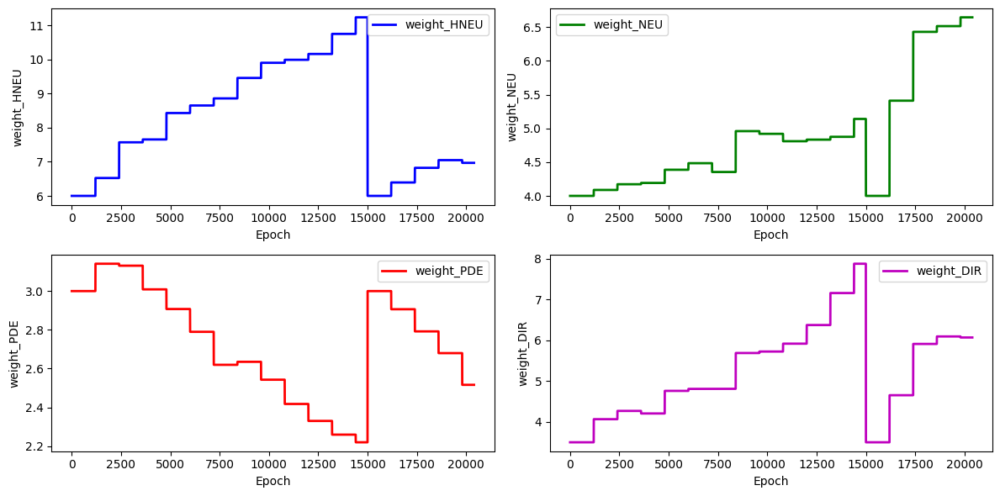

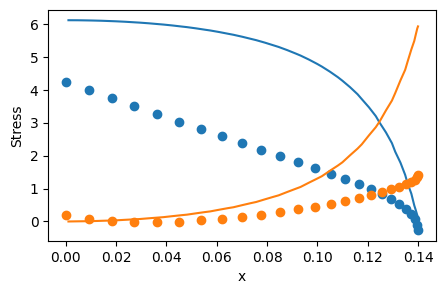

 40%|███▉      | 5999/15000 [2:48:21<4:12:40,  1.68s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 6.959012396851069
for weight 1 new weight_value: 6.660770071754755
for weight 2 new weight_value: 2.327240910181233
for weight 3 new weight_value: 5.764923715823169
total_loss: 0.23800628225771978, hole_loss:  0.0715143628364292, neumann_loss:  0.004728006933058017, pde_loss: 0.1258497853434698, dirichlet_loss: 0.035914127144762754


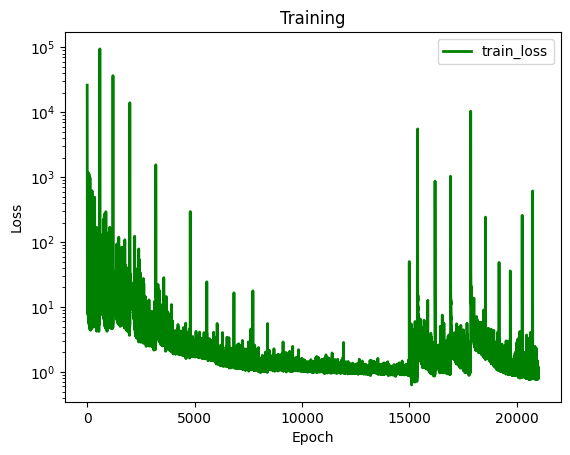

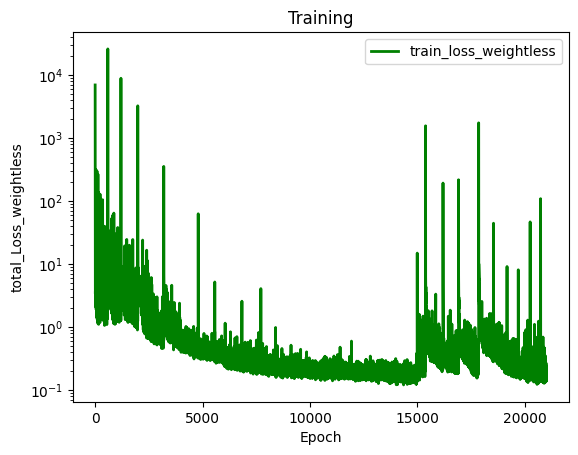

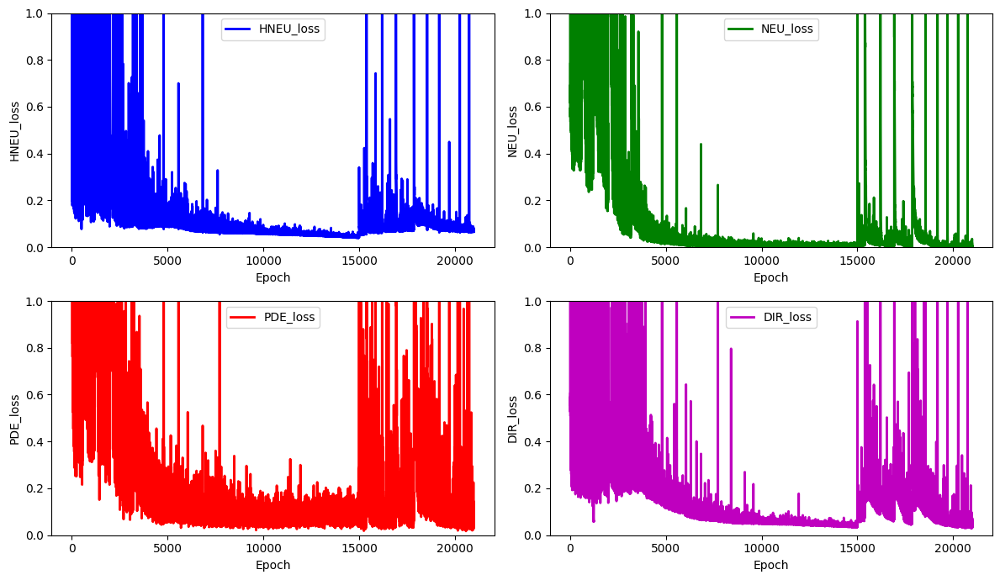

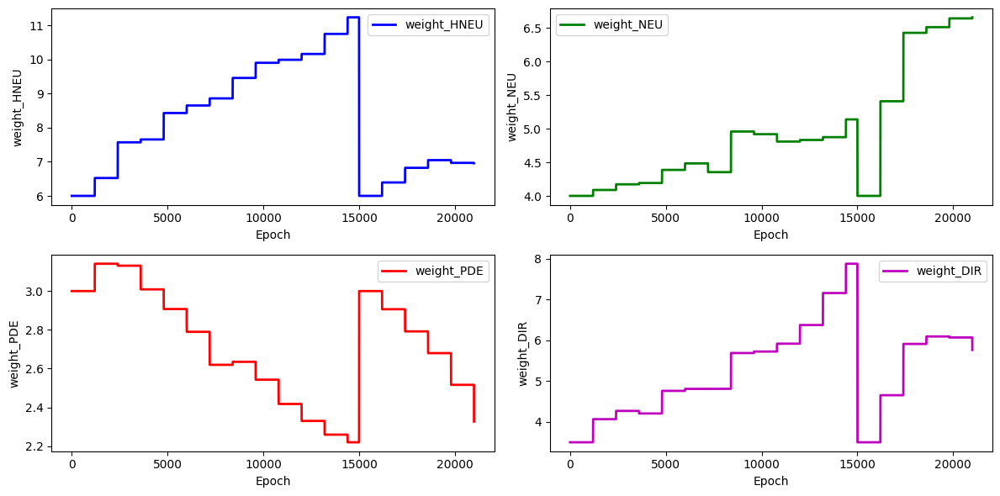

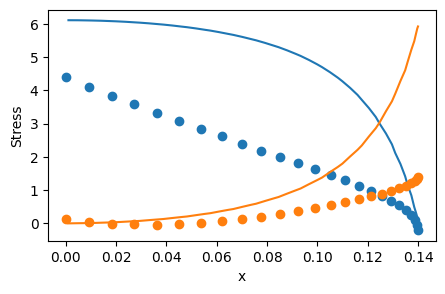

 44%|████▍     | 6599/15000 [3:06:13<4:09:06,  1.78s/it]

total_loss: 0.14887784492566983, hole_loss:  0.061590986564299226, neumann_loss:  0.0037868361159396546, pde_loss: 0.03685034593162893, dirichlet_loss: 0.04664967631380202


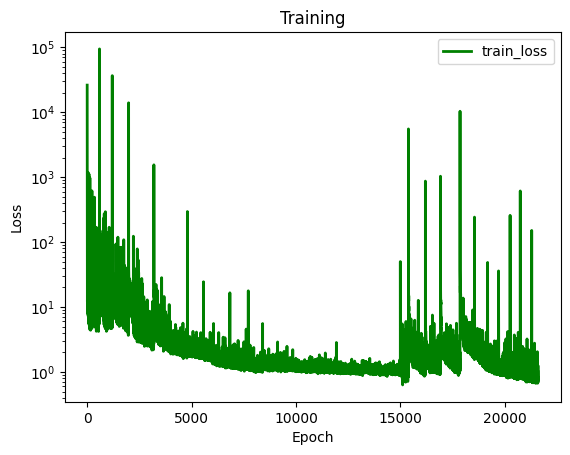

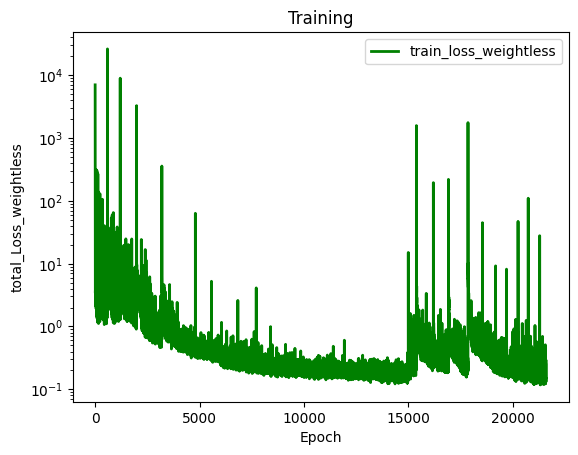

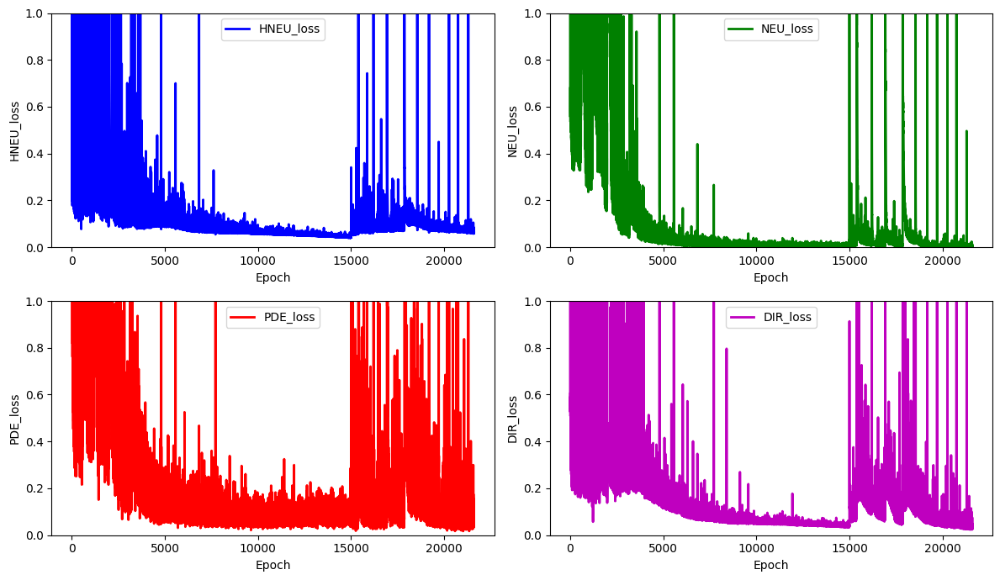

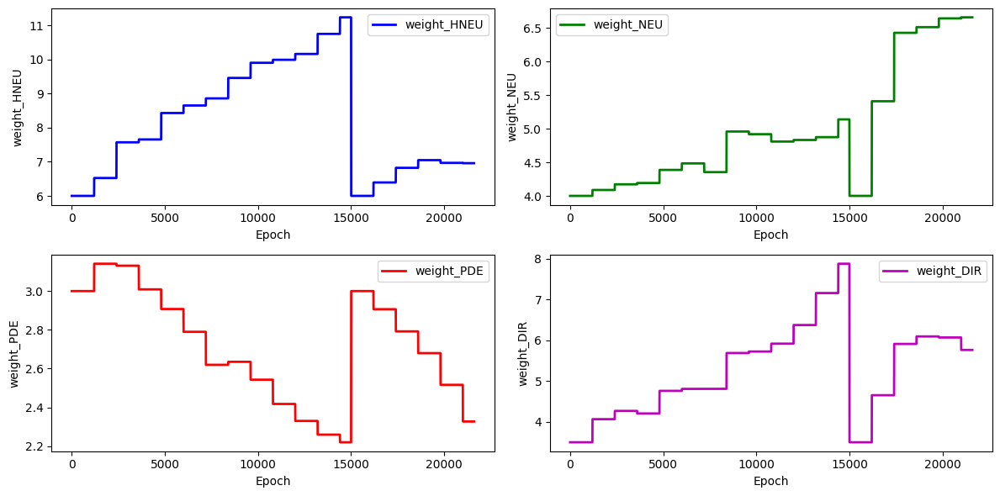

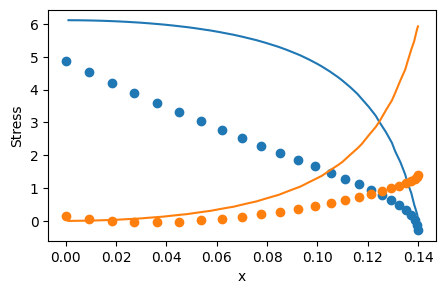

 48%|████▊     | 7199/15000 [3:23:43<3:42:58,  1.71s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 8.041535554052107
for weight 1 new weight_value: 6.604966767539954
for weight 2 new weight_value: 2.185921670490423
for weight 3 new weight_value: 6.422463832492248
total_loss: 0.19024210137289999, hole_loss:  0.05642085759237955, neumann_loss:  0.0108473152784875, pde_loss: 0.08341631897650285, dirichlet_loss: 0.03955760952553006


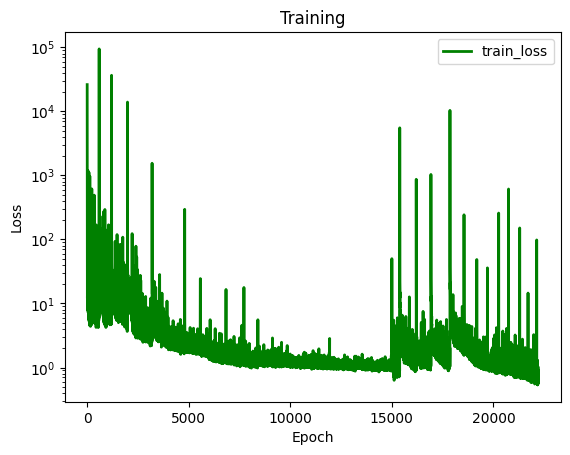

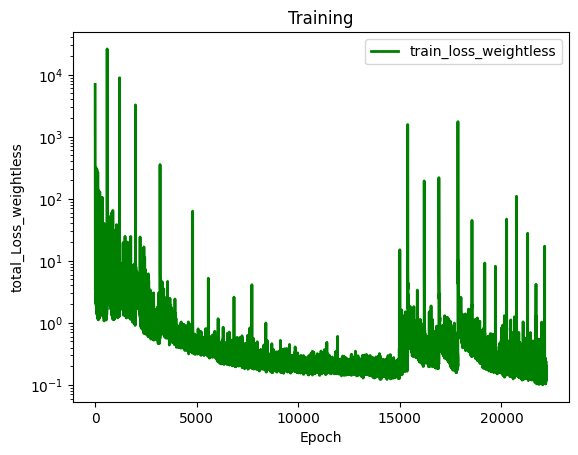

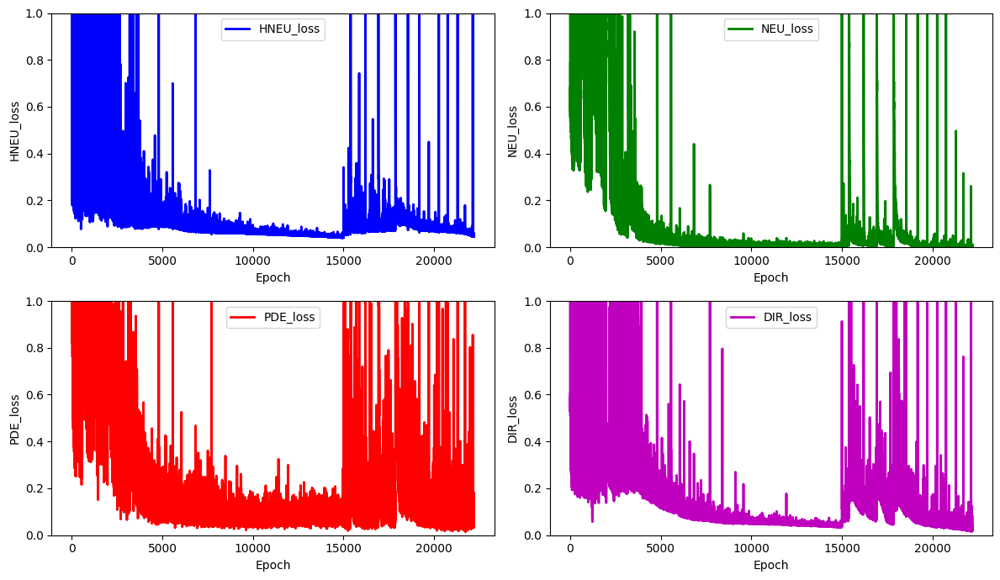

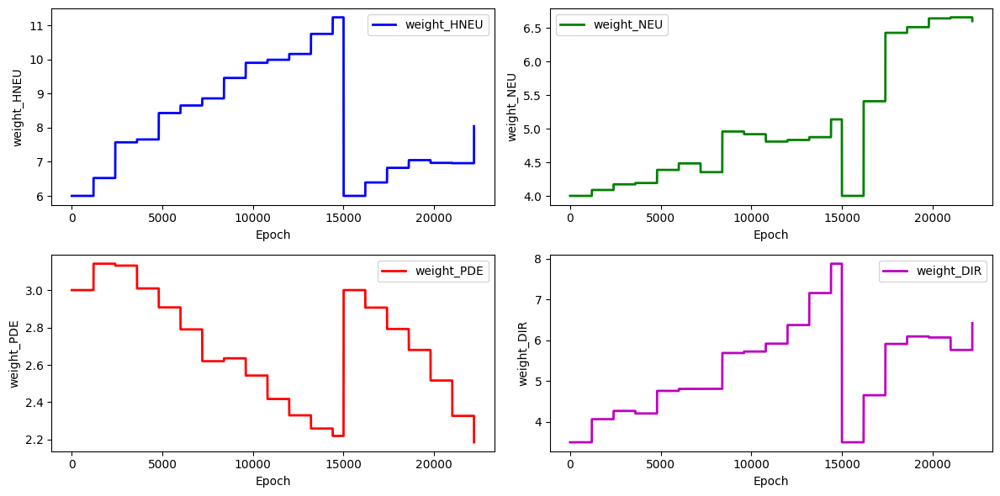

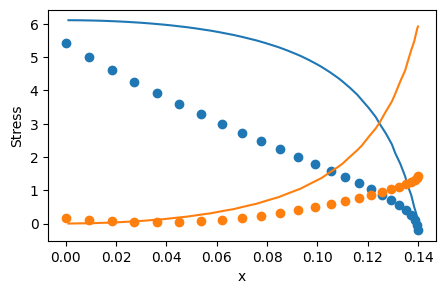

 52%|█████▏    | 7799/15000 [3:41:08<3:34:15,  1.79s/it]

total_loss: 0.30551728668838407, hole_loss:  0.07523543475430662, neumann_loss:  0.014252709662803623, pde_loss: 0.16309795802593324, dirichlet_loss: 0.05293118424534059


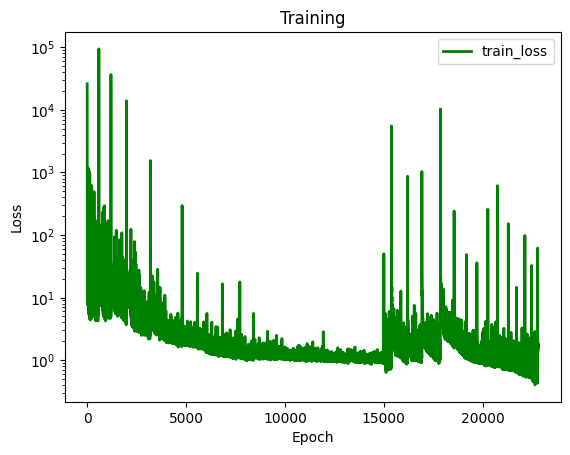

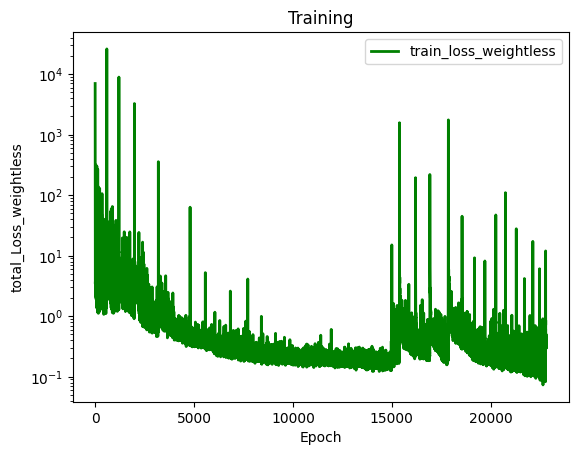

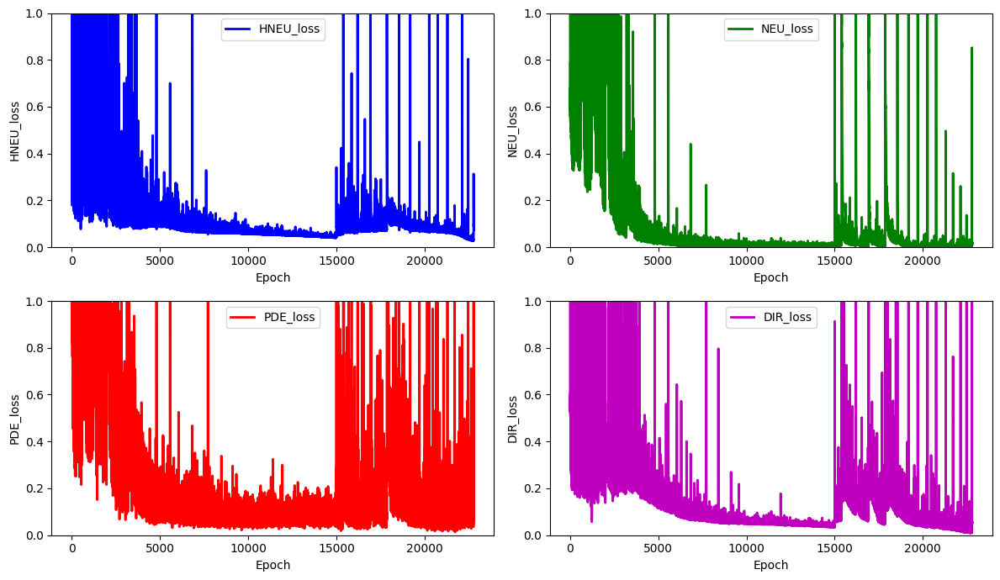

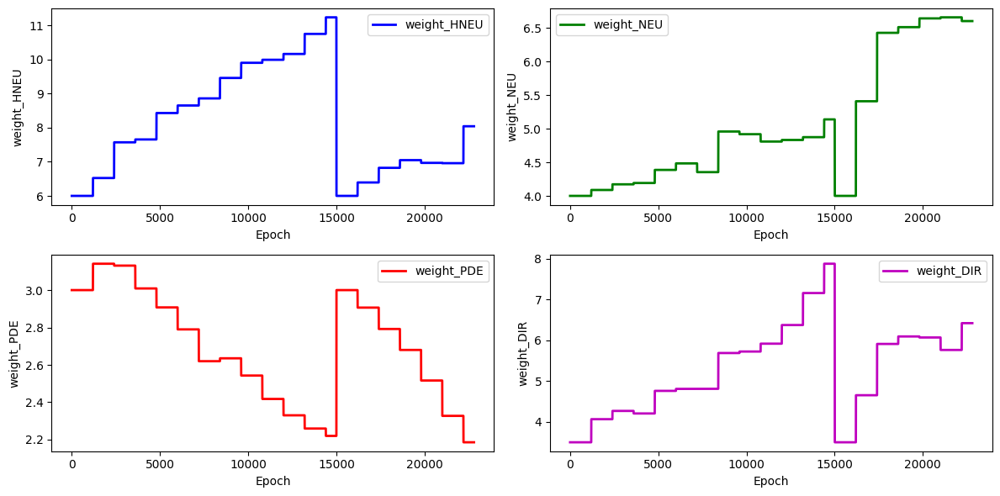

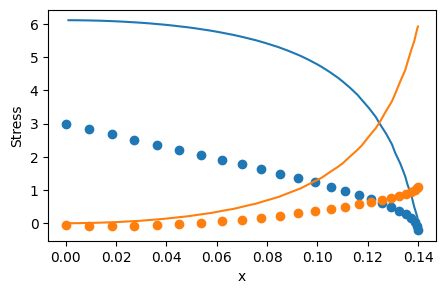

 56%|█████▌    | 8399/15000 [3:58:27<3:10:49,  1.73s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 8.104525659955486
for weight 1 new weight_value: 6.574253081132467
for weight 2 new weight_value: 2.0406930304281667
for weight 3 new weight_value: 6.490475827368188
total_loss: 0.10241305472384493, hole_loss:  0.03073799537472211, neumann_loss:  0.003911771439433705, pde_loss: 0.04460848387863156, dirichlet_loss: 0.023154804031057543


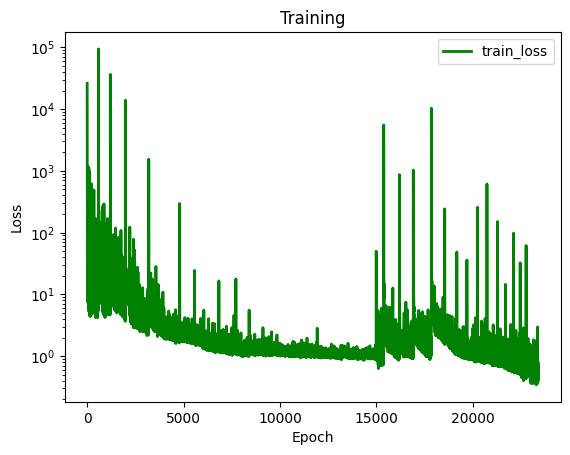

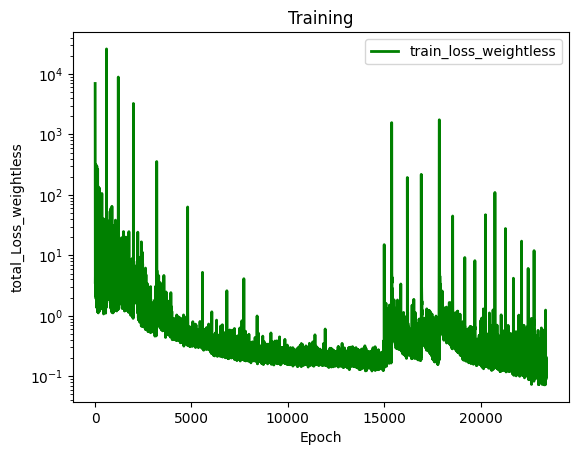

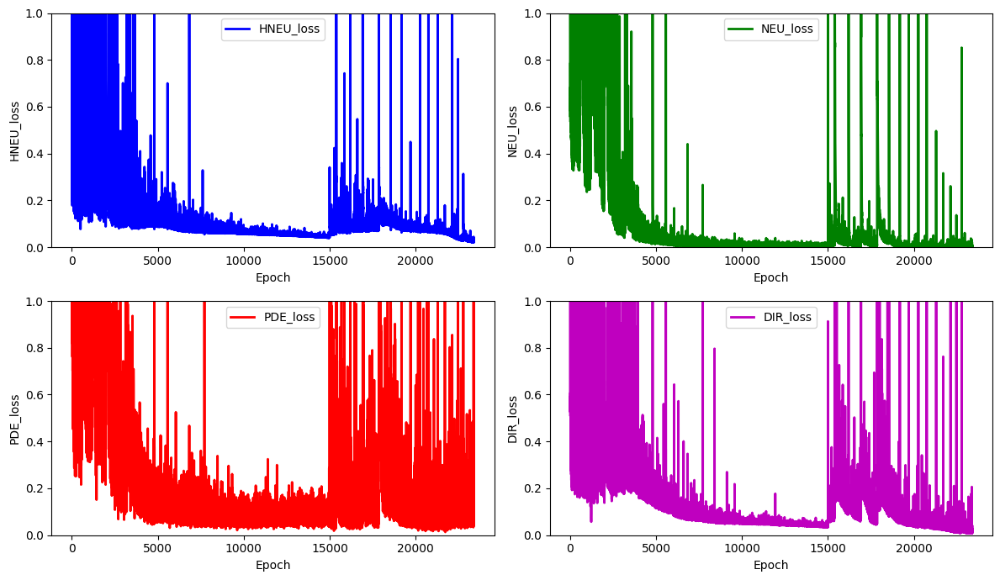

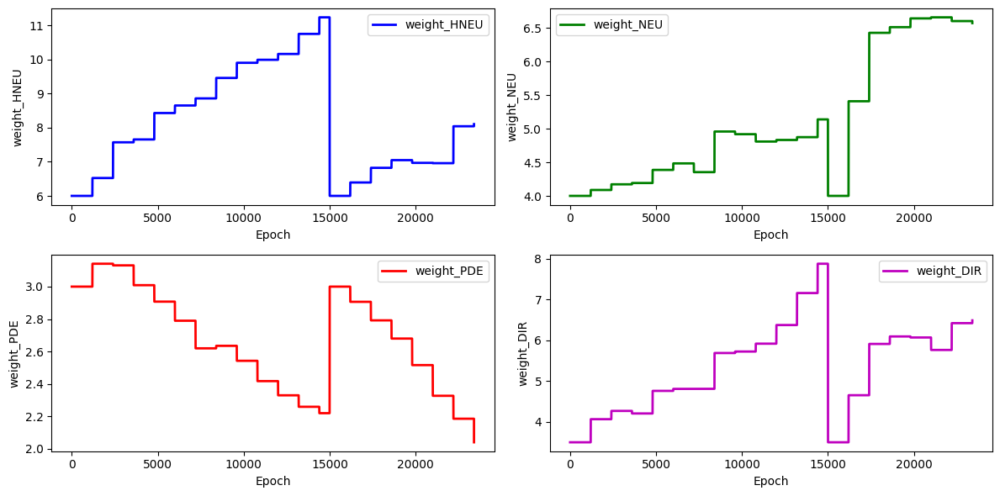

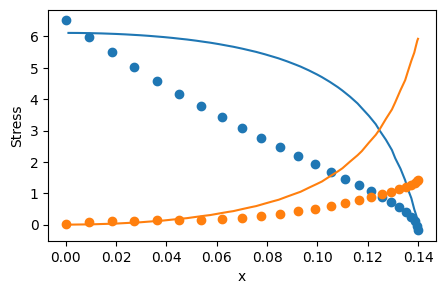

 60%|█████▉    | 8999/15000 [4:16:31<2:59:12,  1.79s/it]

total_loss: 0.18971939179121028, hole_loss:  0.030888466530083047, neumann_loss:  0.0073111857262775914, pde_loss: 0.12517434018955295, dirichlet_loss: 0.02634539934529666


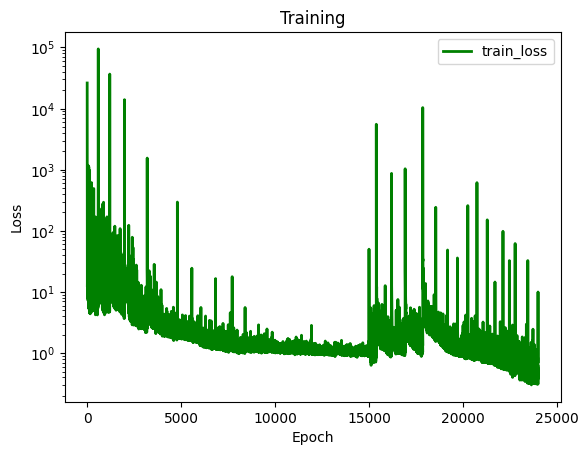

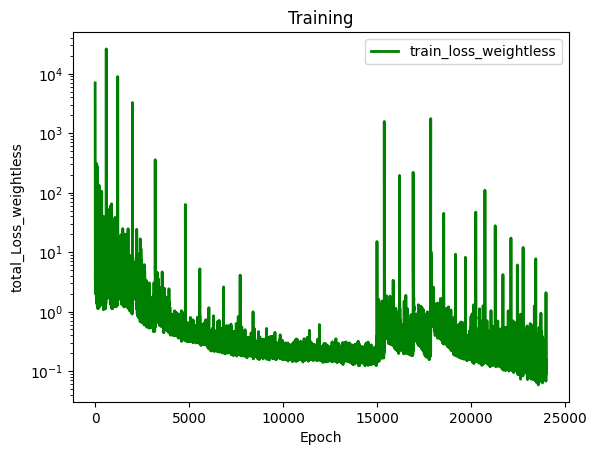

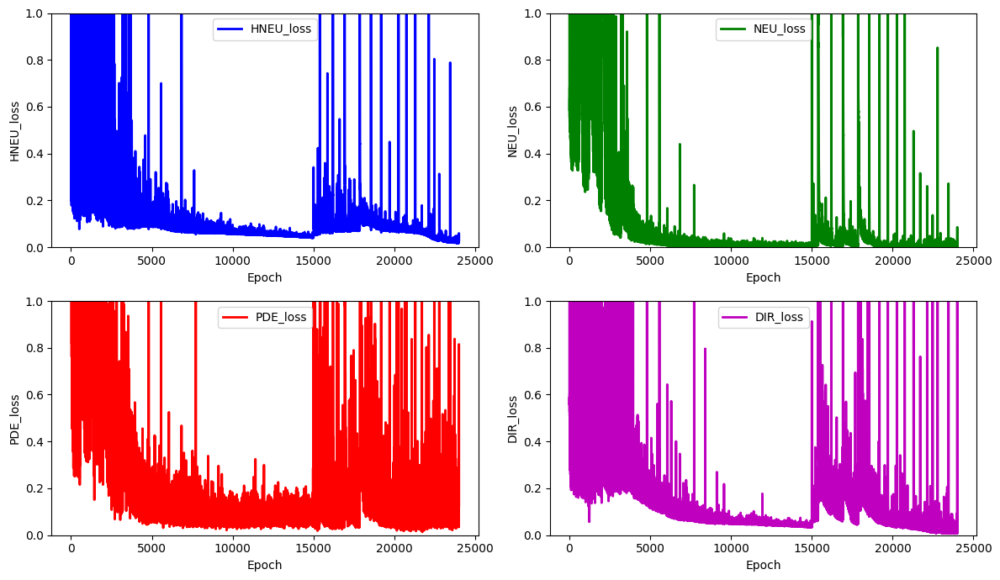

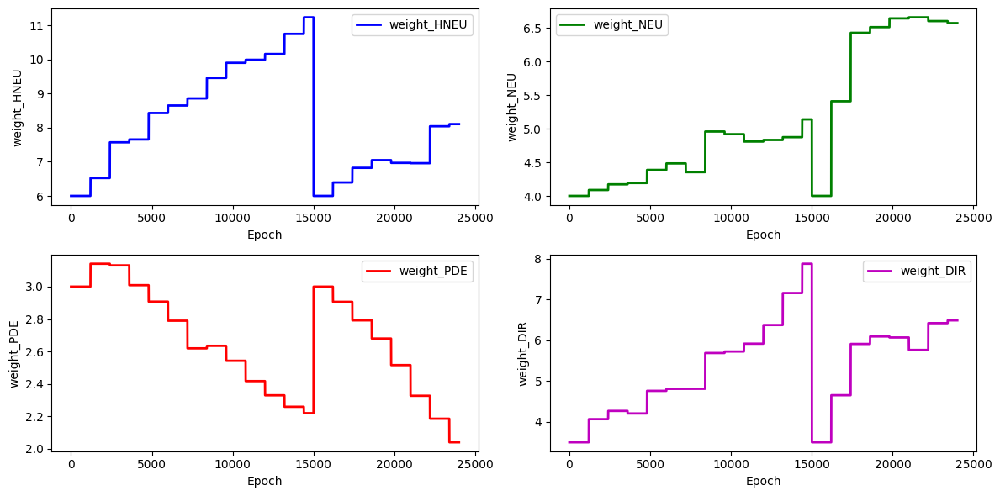

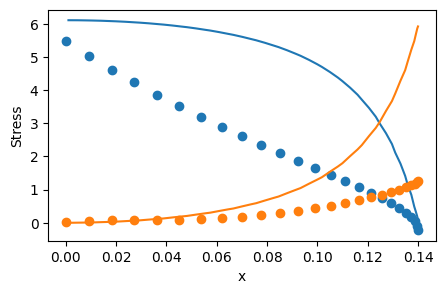

 64%|██████▍   | 9599/15000 [4:33:49<2:35:36,  1.73s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 9.990492977304037
for weight 1 new weight_value: 6.596215480959096
for weight 2 new weight_value: 2.0197738024498437
for weight 3 new weight_value: 8.256170980512799
total_loss: 0.08014861381966122, hole_loss:  0.02005448484766771, neumann_loss:  0.0023490559768704717, pde_loss: 0.048424042678309215, dirichlet_loss: 0.009321030316813821


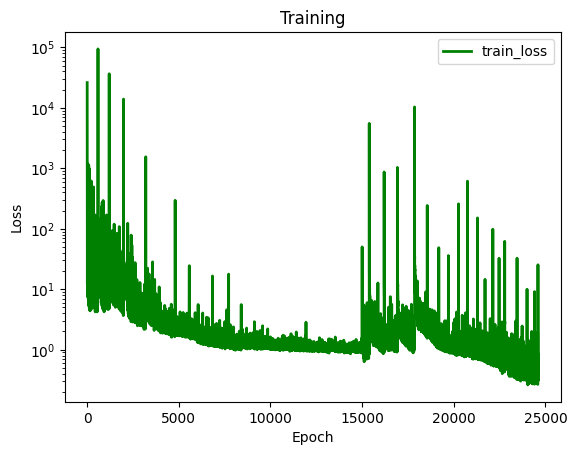

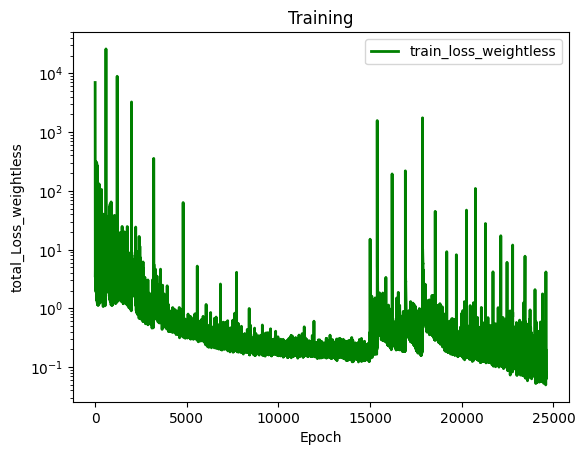

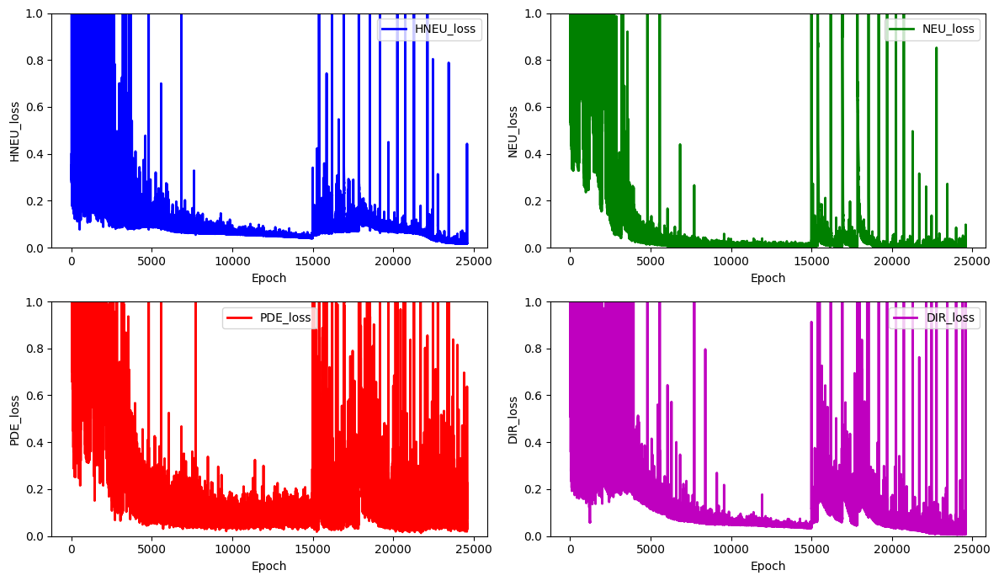

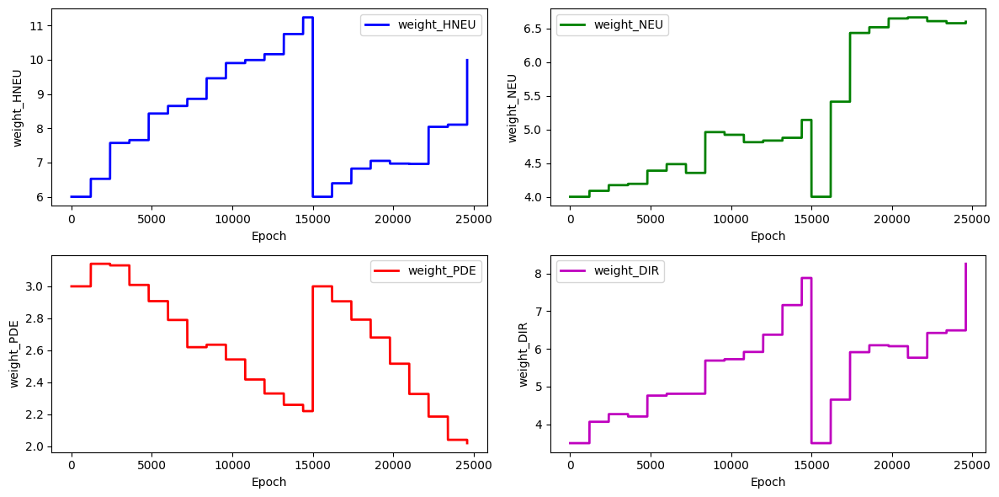

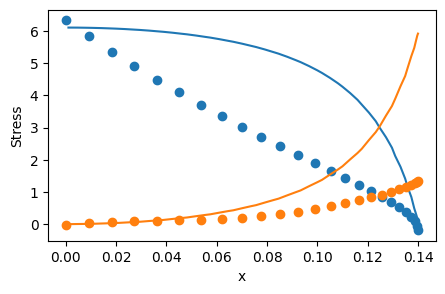

 68%|██████▊   | 10199/15000 [4:51:56<2:24:13,  1.80s/it]

total_loss: 0.07315182385058507, hole_loss:  0.013849947578136464, neumann_loss:  0.004182480347472871, pde_loss: 0.04896330032525212, dirichlet_loss: 0.006156095599723614


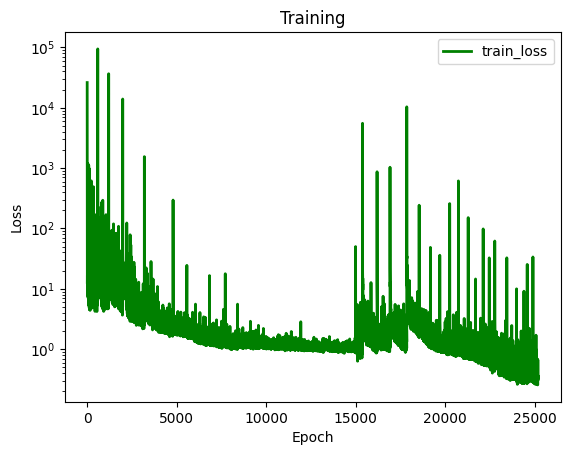

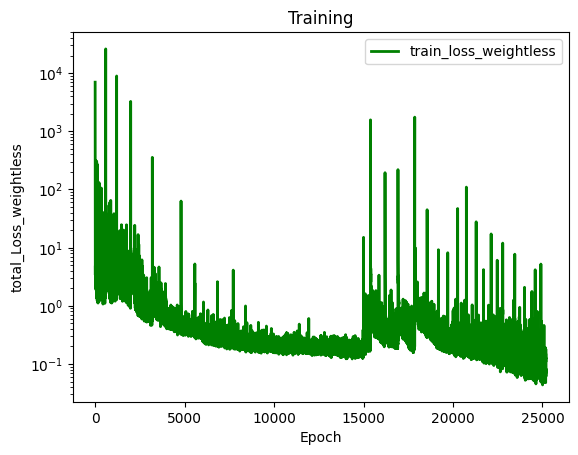

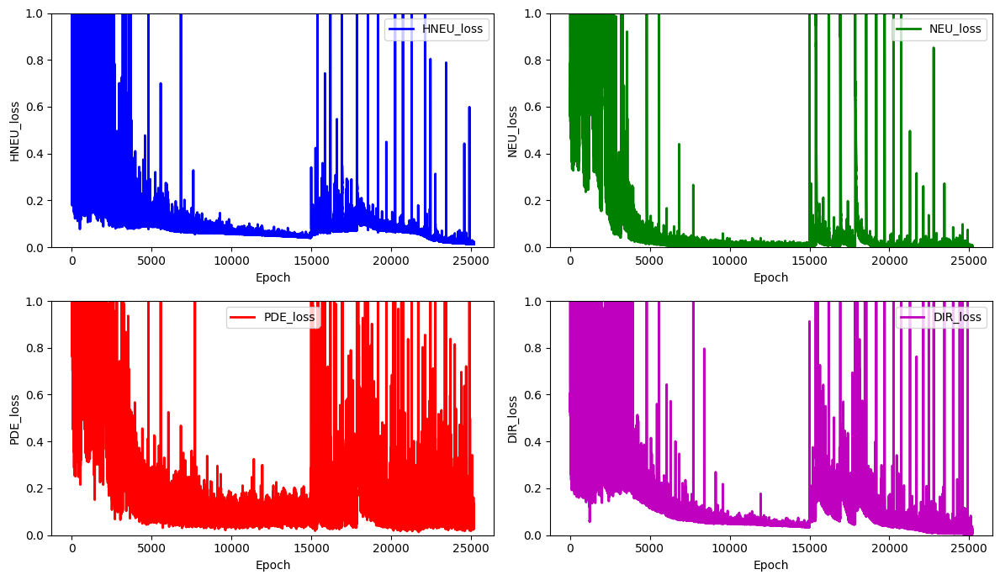

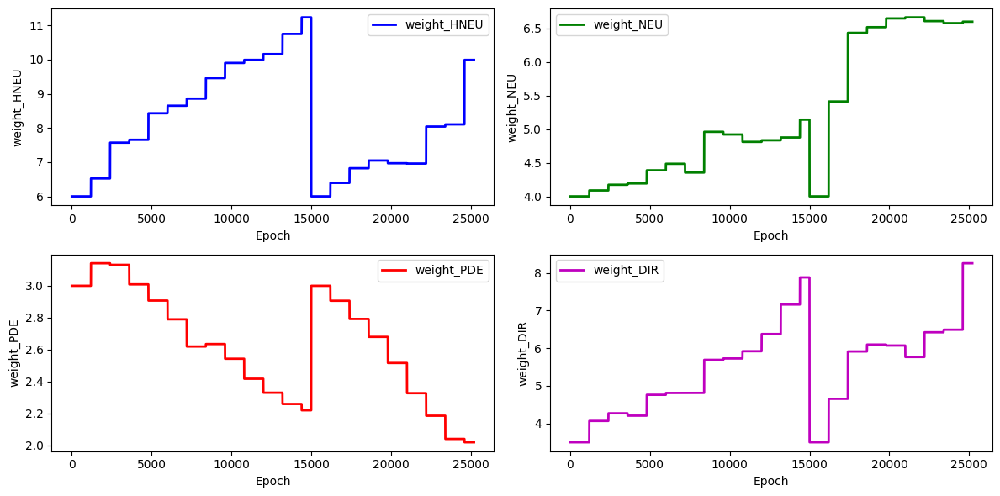

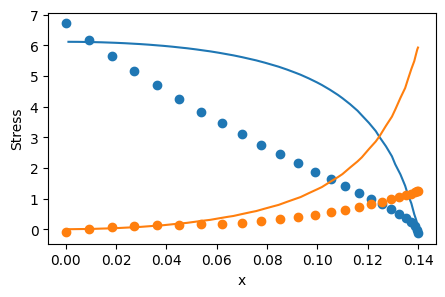

 72%|███████▏  | 10799/15000 [5:09:12<2:00:31,  1.72s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 10.797243354650641
for weight 1 new weight_value: 7.06925166353901
for weight 2 new weight_value: 1.9667663048499695
for weight 3 new weight_value: 8.280954558338152
total_loss: 0.17724704926628898, hole_loss:  0.012936730617922011, neumann_loss:  0.00422824074886956, pde_loss: 0.15332909480192677, dirichlet_loss: 0.006752983097570633


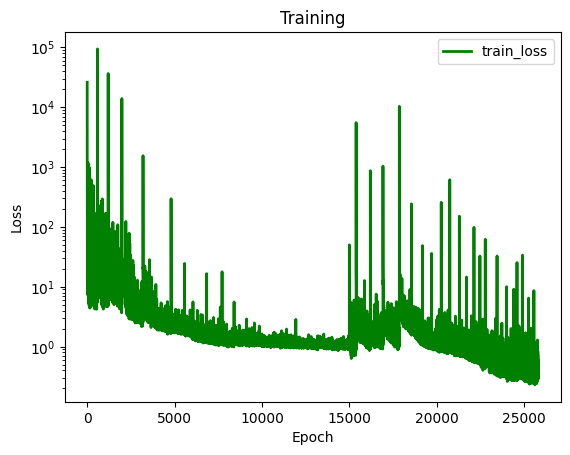

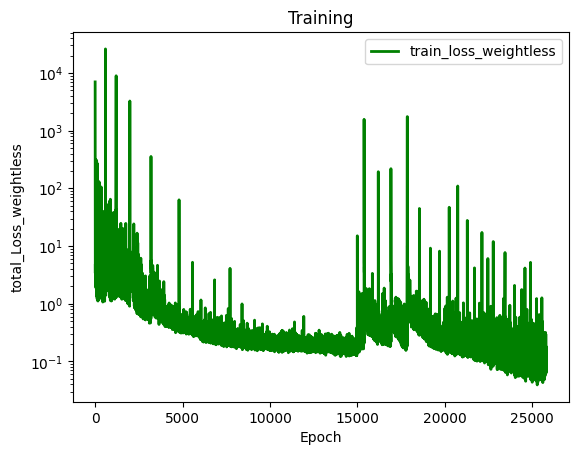

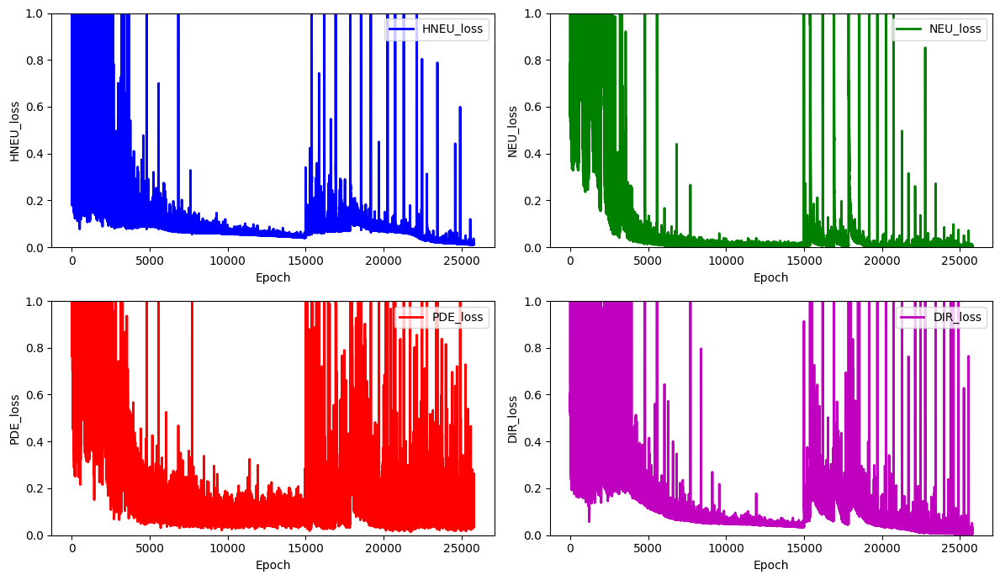

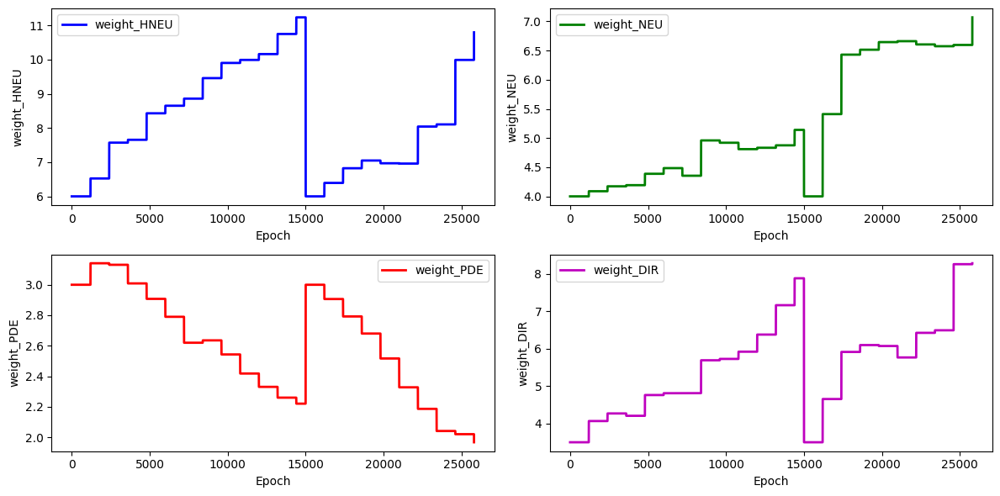

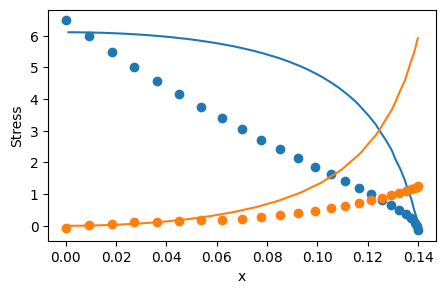

 76%|███████▌  | 11399/15000 [5:24:11<1:29:01,  1.48s/it]

total_loss: 0.15517541741451438, hole_loss:  0.010181710478172892, neumann_loss:  0.004997918664645078, pde_loss: 0.12770683417491024, dirichlet_loss: 0.012288954096786165


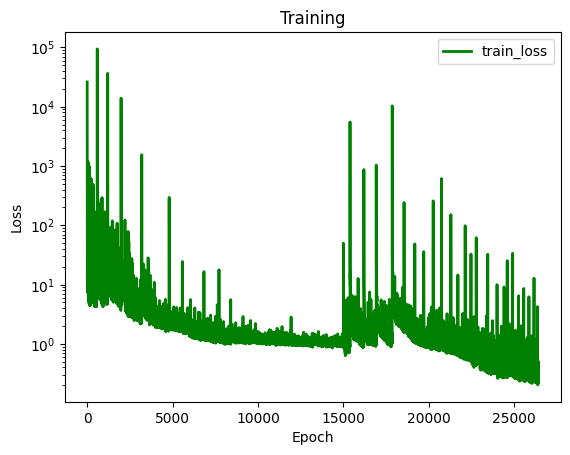

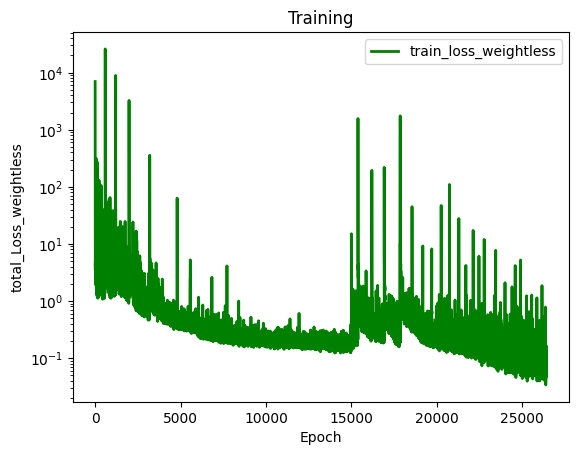

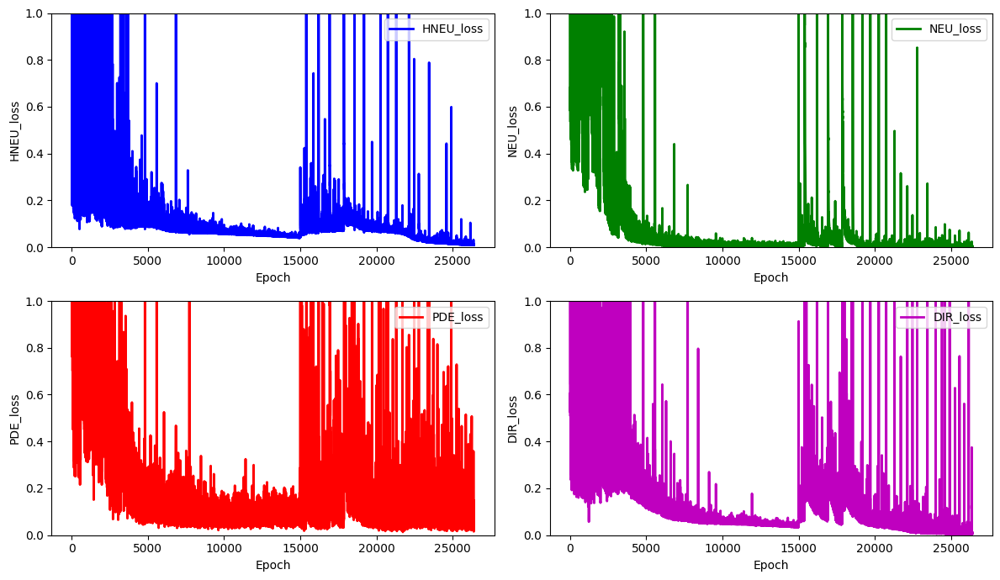

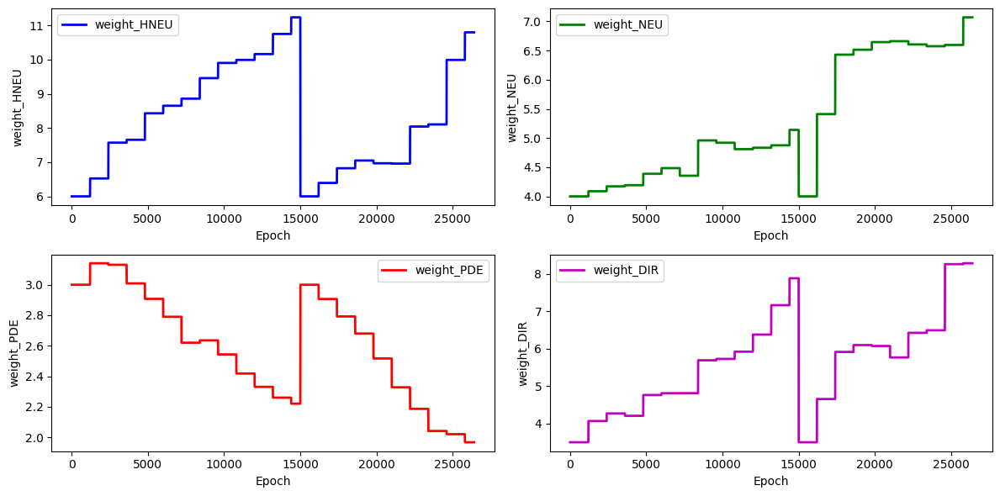

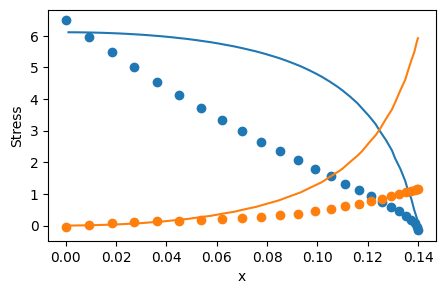

 80%|███████▉  | 11999/15000 [5:38:16<1:09:47,  1.40s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 13.494538070655986
for weight 1 new weight_value: 7.819253347038516
for weight 2 new weight_value: 2.006590857236272
for weight 3 new weight_value: 10.025275133425463
total_loss: 0.08062371490936461, hole_loss:  0.008680834718490396, neumann_loss:  0.0033326040762227485, pde_loss: 0.06355304862391392, dirichlet_loss: 0.005057227490737545


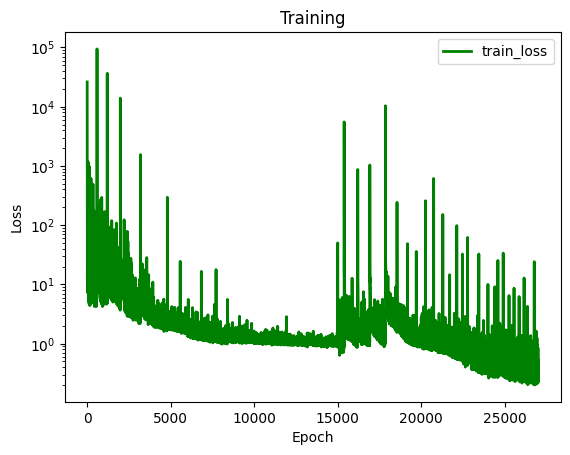

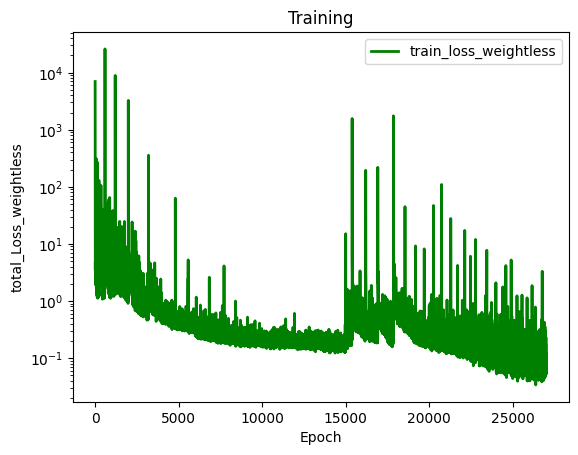

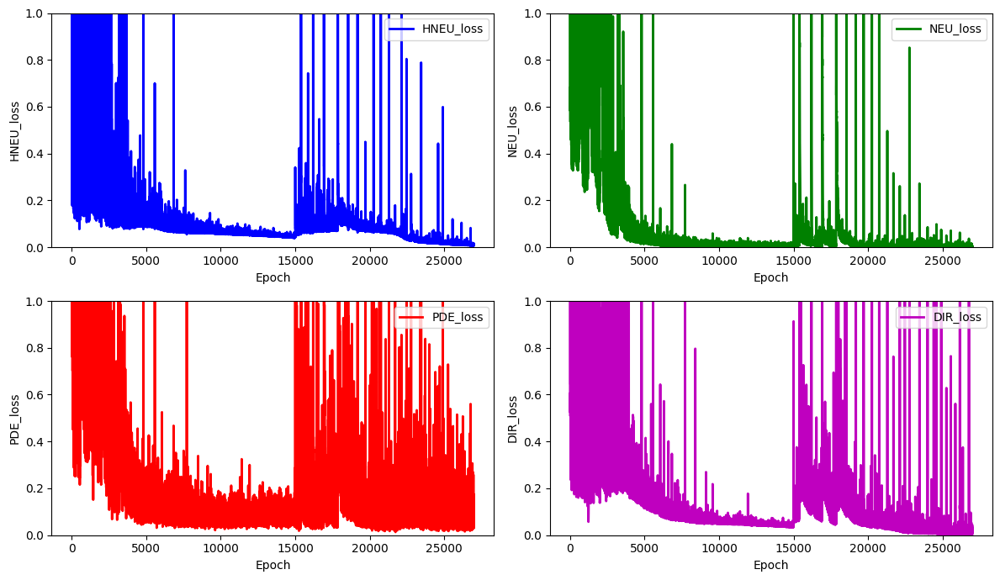

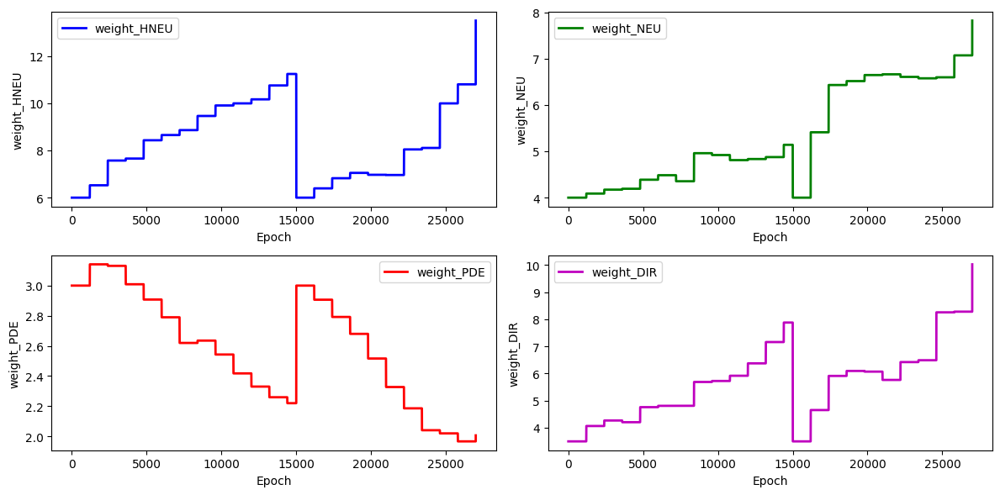

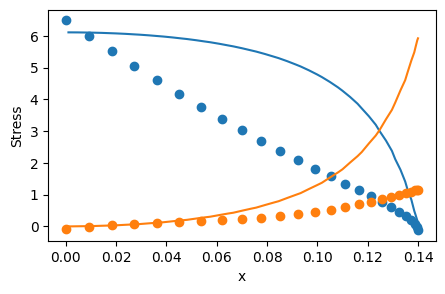

 84%|████████▍ | 12599/15000 [5:53:19<59:40,  1.49s/it]  

total_loss: 0.06054196487377268, hole_loss:  0.006173164135016089, neumann_loss:  0.003117664779327684, pde_loss: 0.04574777762416448, dirichlet_loss: 0.005503358335264426


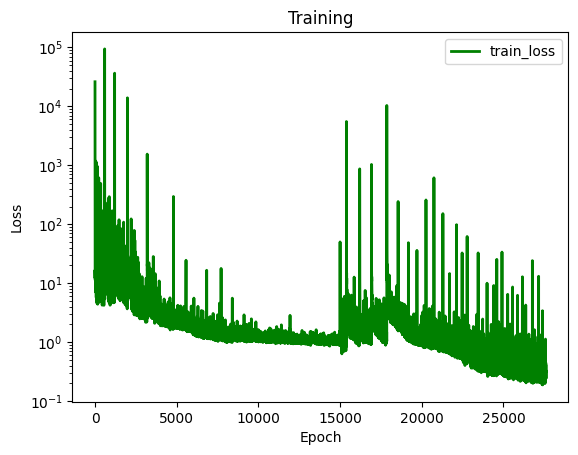

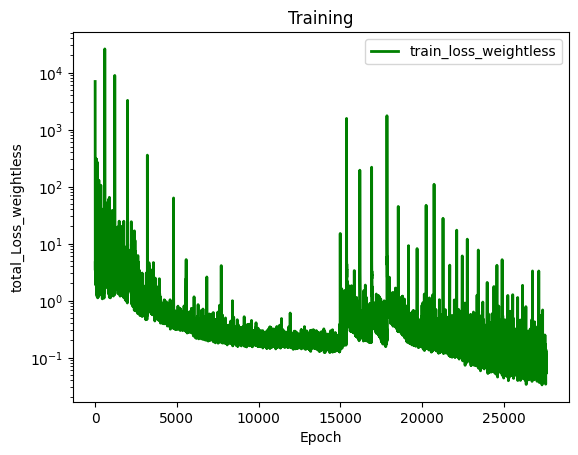

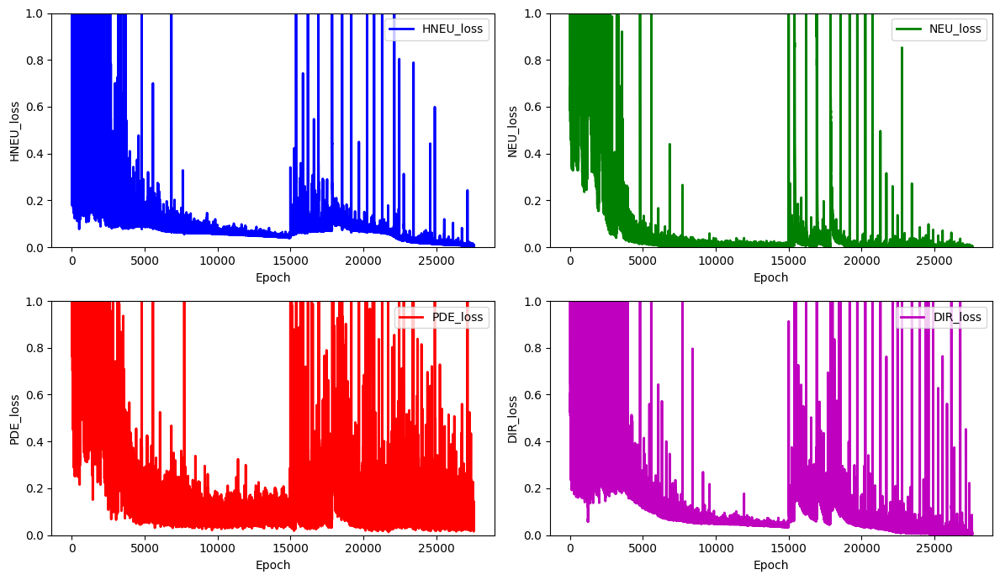

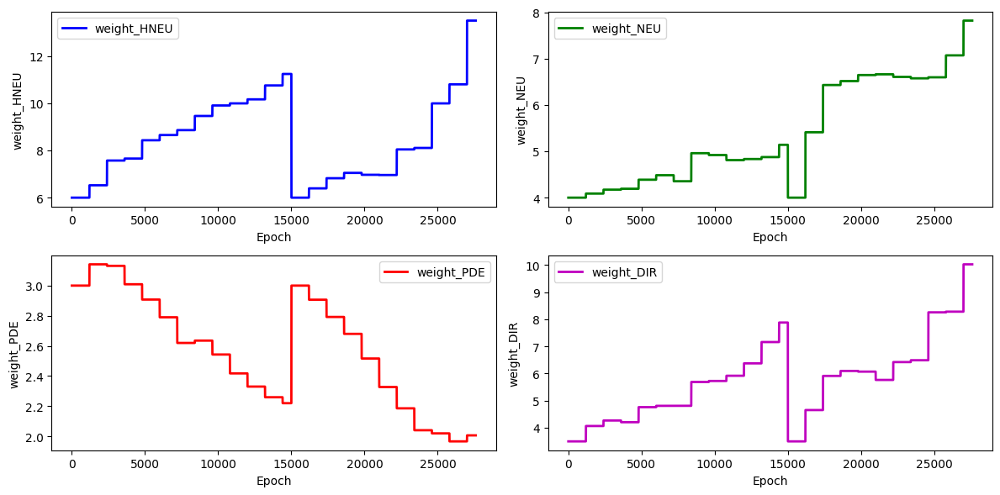

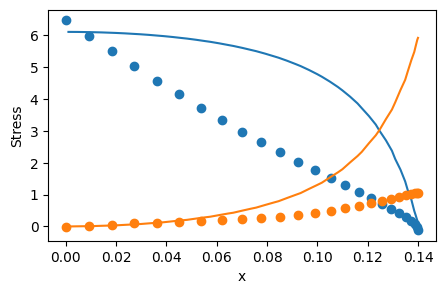

 88%|████████▊ | 13199/15000 [6:09:06<46:21,  1.54s/it]  

adopting weights after 1200 epochs
for weight 0 new weight_value: 13.030983547582128
for weight 1 new weight_value: 7.467829660774136
for weight 2 new weight_value: 1.8731516343343948
for weight 3 new weight_value: 10.67233956277125
total_loss: 0.05187573027138752, hole_loss:  0.0053158947104575026, neumann_loss:  0.002985874974477054, pde_loss: 0.03638822254118866, dirichlet_loss: 0.007185738045264302


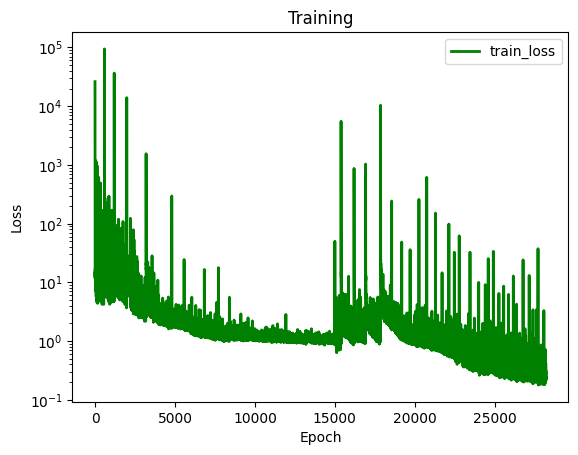

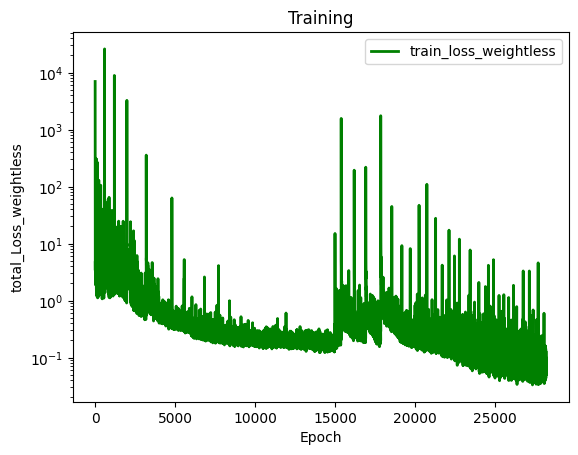

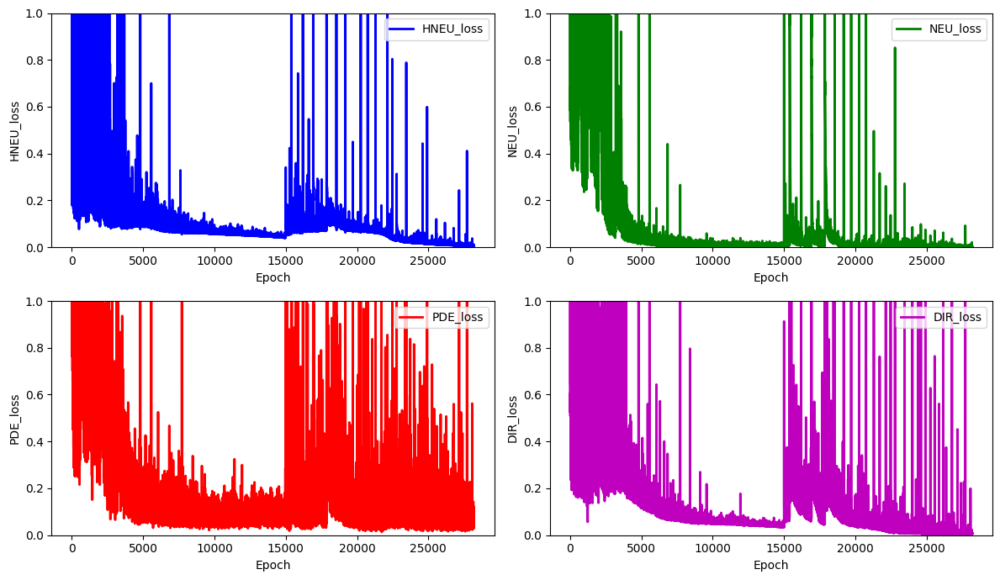

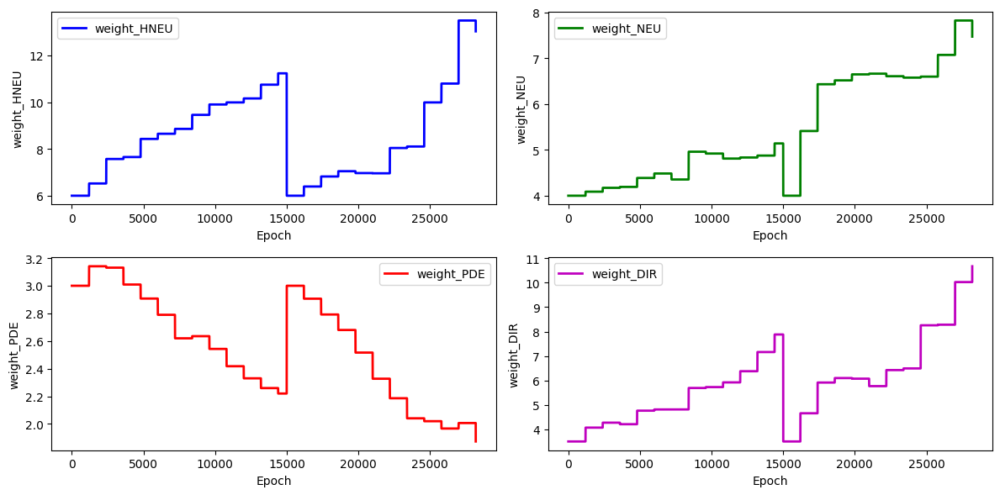

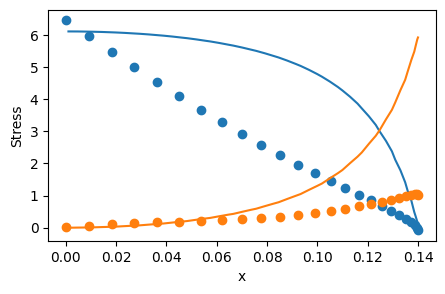

 92%|█████████▏| 13799/15000 [6:23:54<29:07,  1.46s/it]  

total_loss: 0.12273277634732582, hole_loss:  0.0072049199724969915, neumann_loss:  0.0026362773201959793, pde_loss: 0.10887853516931018, dirichlet_loss: 0.004013043885322663


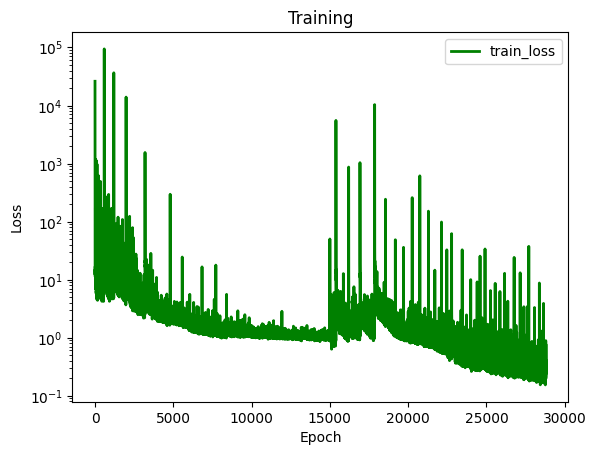

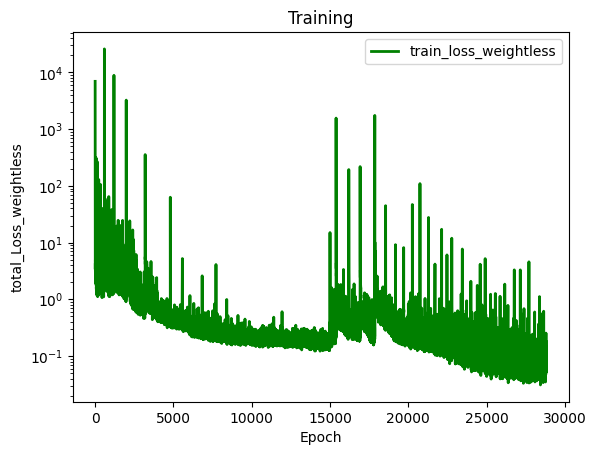

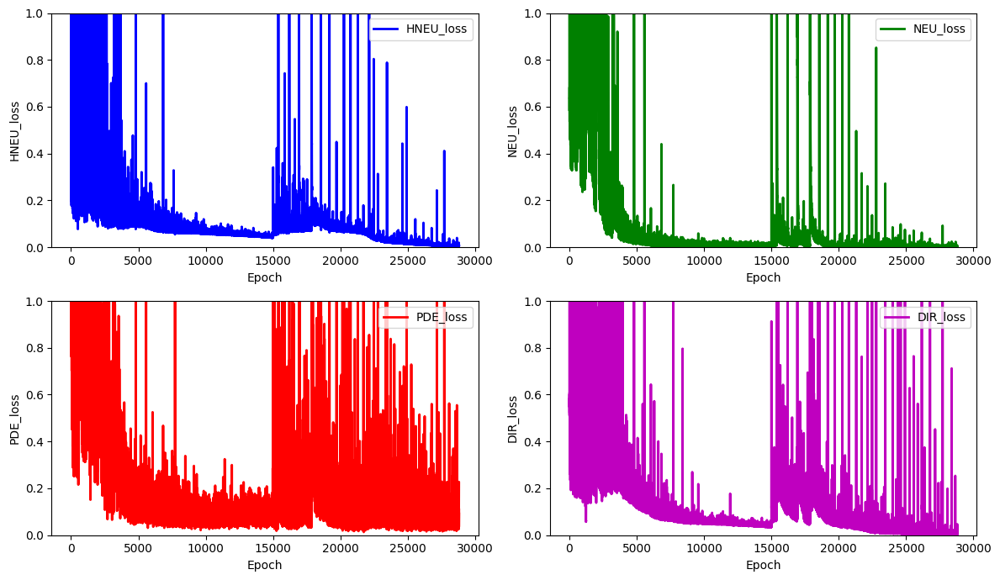

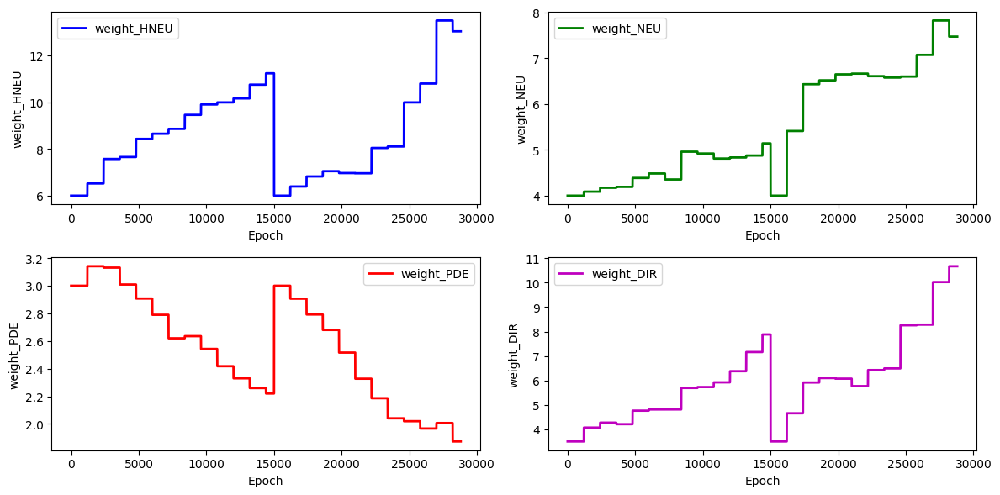

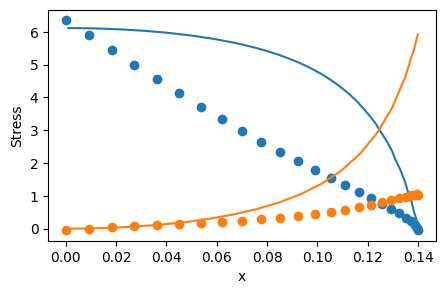

 96%|█████████▌| 14399/15000 [6:39:12<15:14,  1.52s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 14.940677058937268
for weight 1 new weight_value: 9.89663726457582
for weight 2 new weight_value: 1.8515602077018178
for weight 3 new weight_value: 12.945840595628933
total_loss: 0.08463974290606066, hole_loss:  0.004409501896901414, neumann_loss:  0.0026240204144472447, pde_loss: 0.072466883930206, dirichlet_loss: 0.005139336664506001


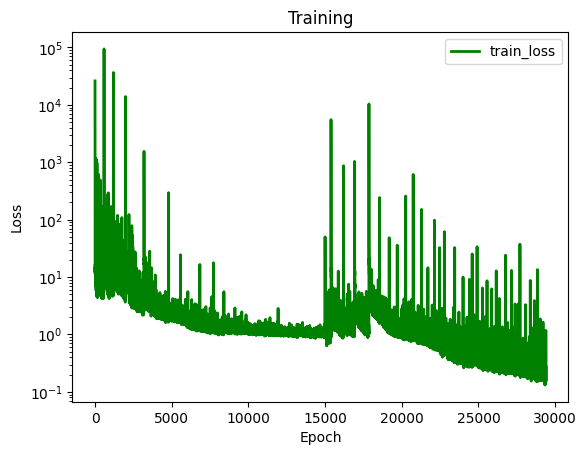

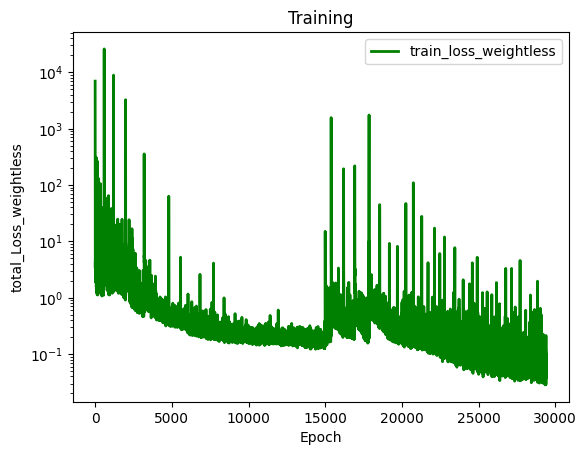

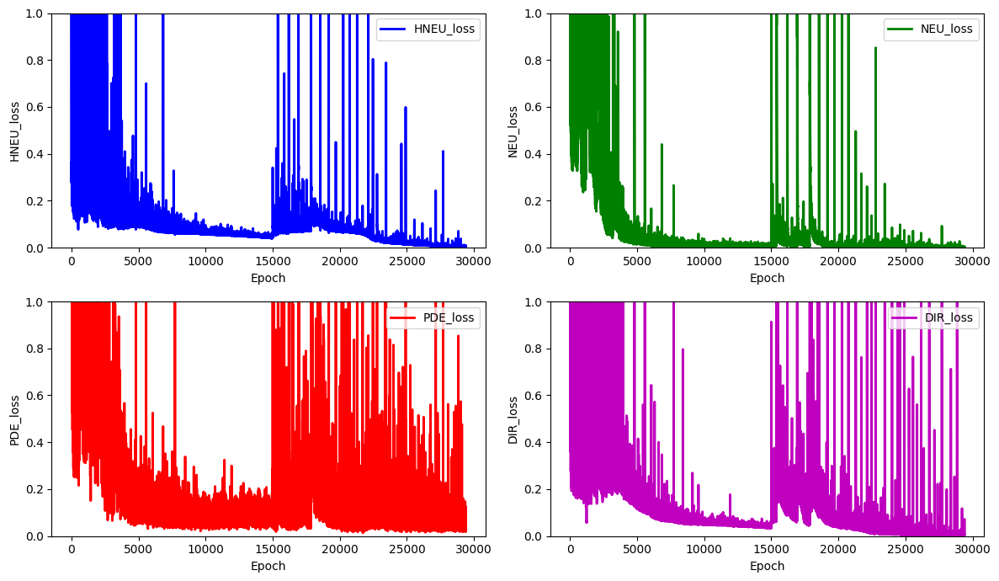

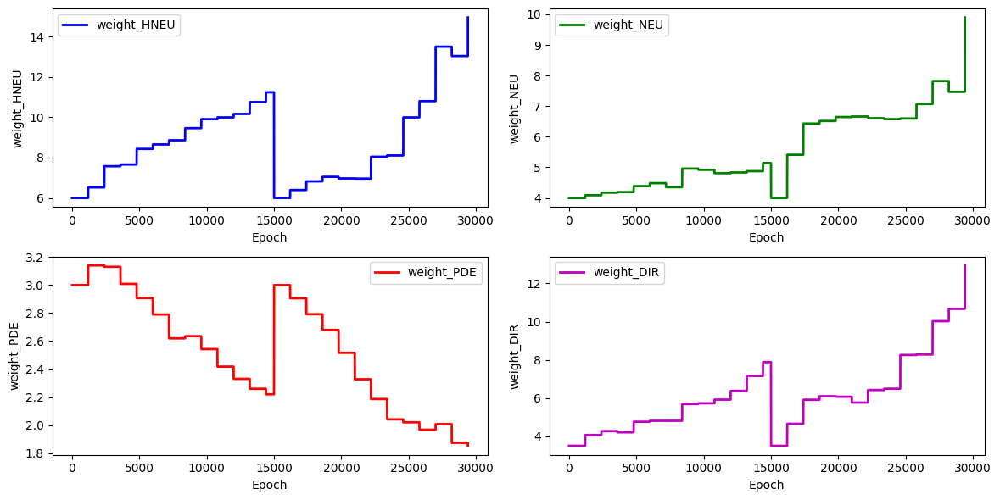

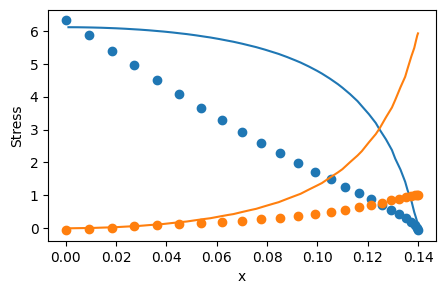

100%|█████████▉| 14999/15000 [6:53:23<00:01,  1.40s/it]

total_loss: 0.0451054440299593, hole_loss:  0.002619666973605723, neumann_loss:  0.002436144896037583, pde_loss: 0.03646672927289317, dirichlet_loss: 0.0035829028874228203


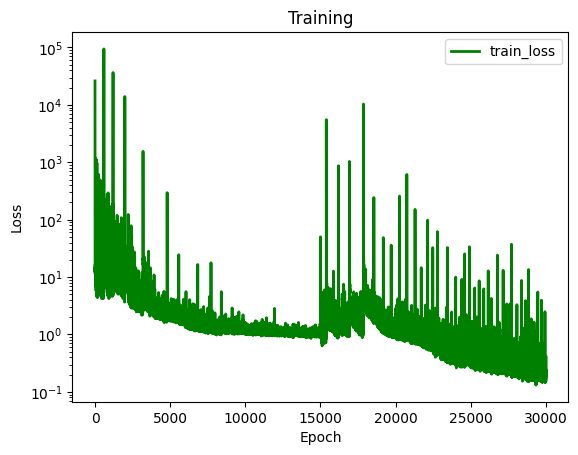

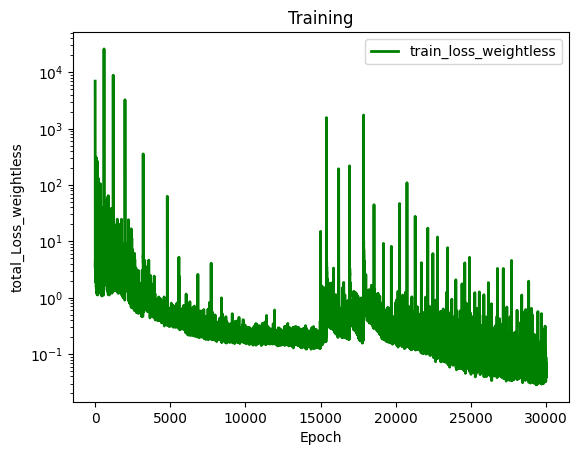

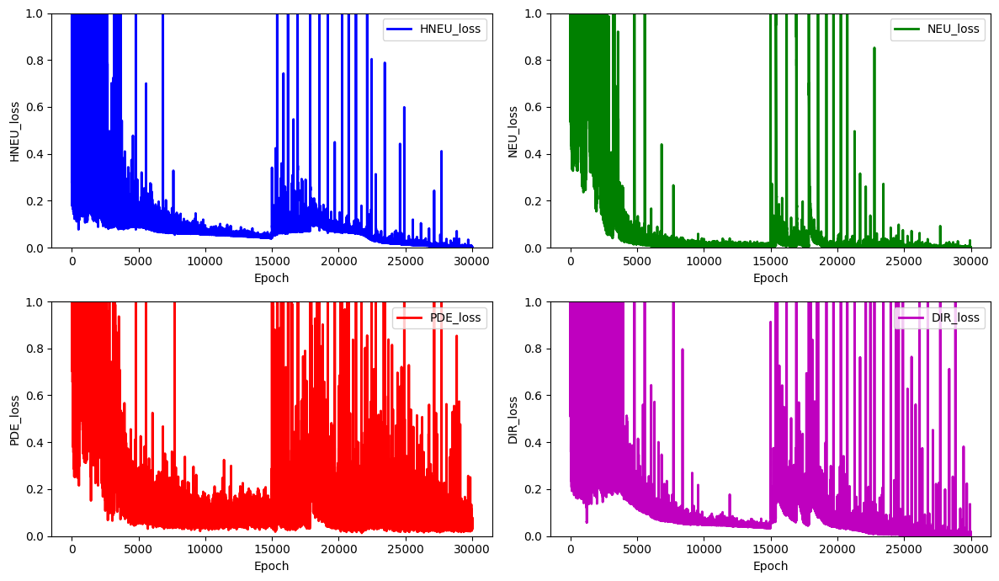

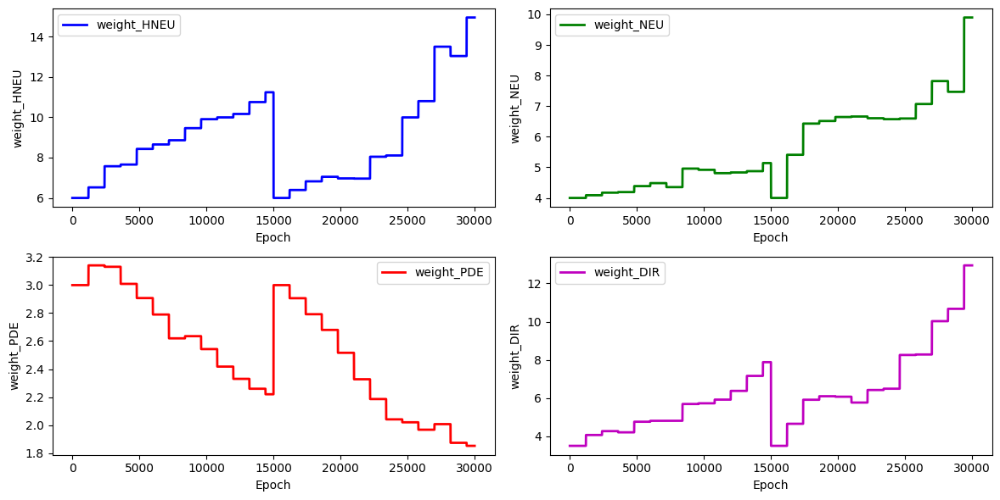

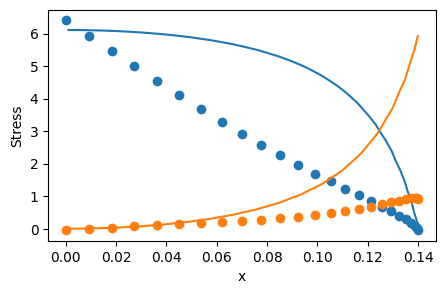

100%|██████████| 15000/15000 [6:53:27<00:00,  1.65s/it]

total_loss: 0.0451054440299593, hole_loss:  0.002619666973605723, neumann_loss:  0.002436144896037583, pde_loss: 0.03646672927289317, dirichlet_loss: 0.0035829028874228203
previous lowest lost  0.9714531269427393
lowest loss 0.17715327509155687 archived, PINN is saved: 'net_param/net_0.17715328.pth


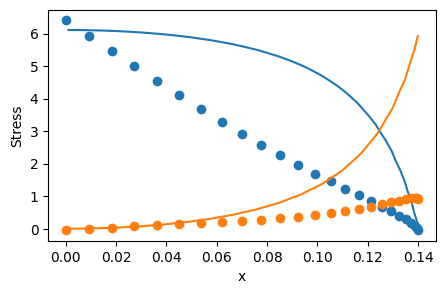

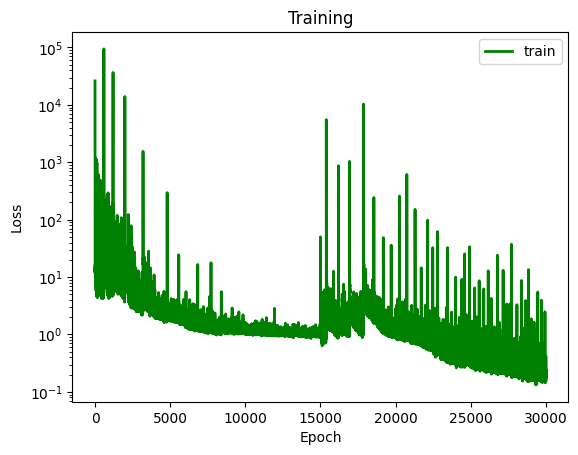

Weight_HNEU: 6.0, Weight_NEU: 4.0, Weight_PDE: 3.0, Weight_STRESS: 1.0, Stress Error: 11.156392685915769
Starting with Adam optimizer...


  4%|▍         | 599/15000 [14:12<5:38:14,  1.41s/it]

total_loss: 1.0424561622060522, hole_loss:  0.10177728993579367, neumann_loss:  0.03257101590989964, pde_loss: 0.7842762171284398, dirichlet_loss: 0.12383163923191923


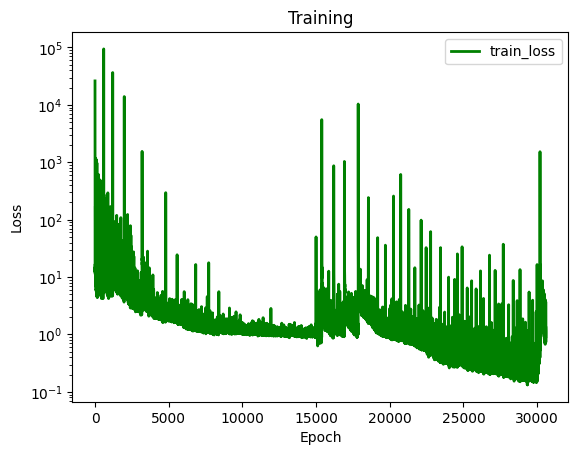

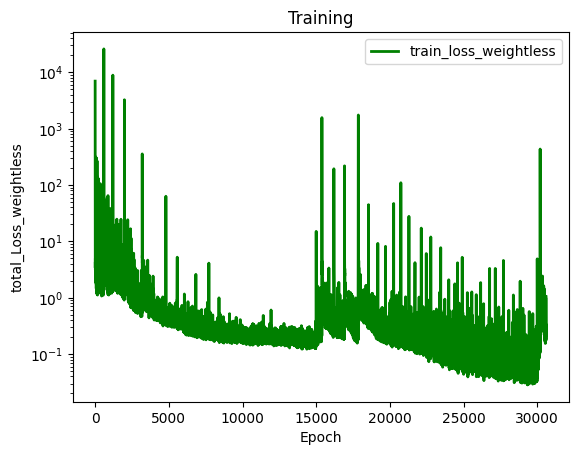

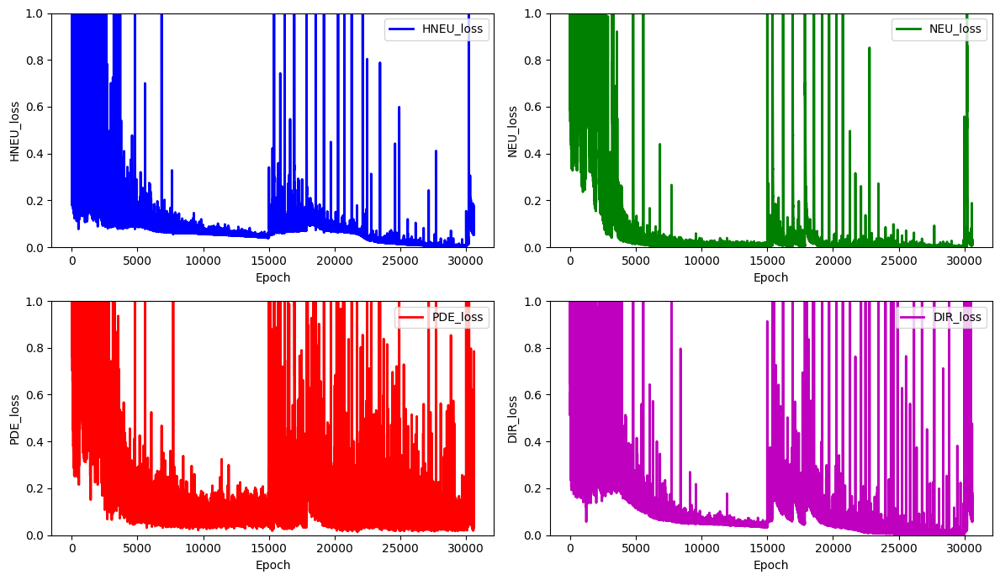

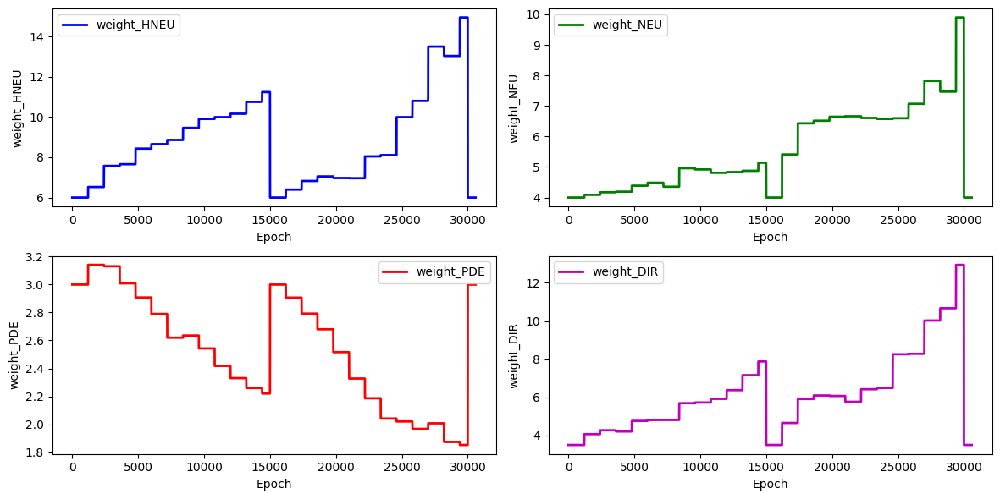

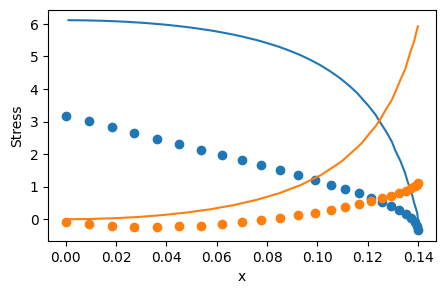

  8%|▊         | 1199/15000 [29:36<5:56:14,  1.55s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 6.295913209234144
for weight 1 new weight_value: 4.423450860234725
for weight 2 new weight_value: 2.8415880835045457
for weight 3 new weight_value: 3.6897194928269914
total_loss: 0.2851641585992442, hole_loss:  0.07076663880291198, neumann_loss:  0.01597853086941573, pde_loss: 0.07862943142325152, dirichlet_loss: 0.119789557503665


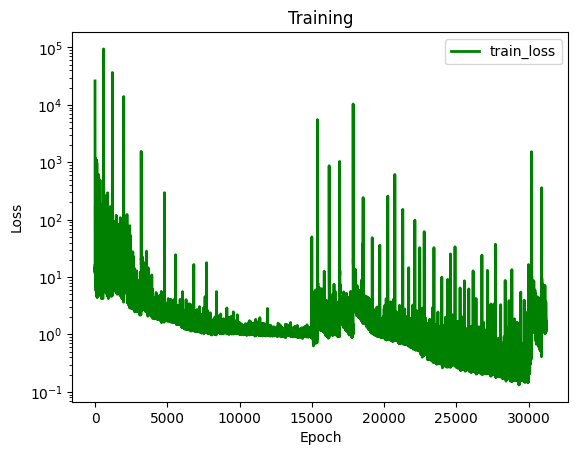

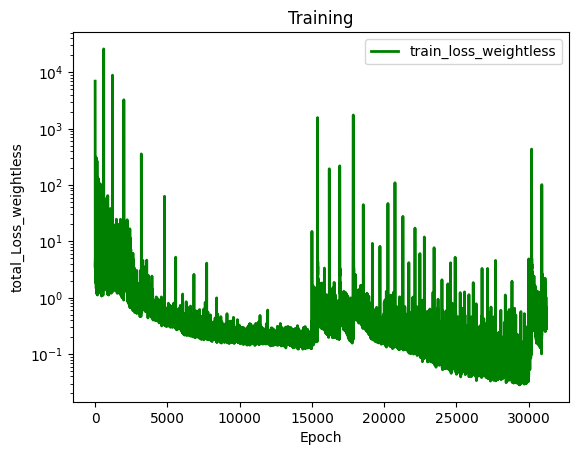

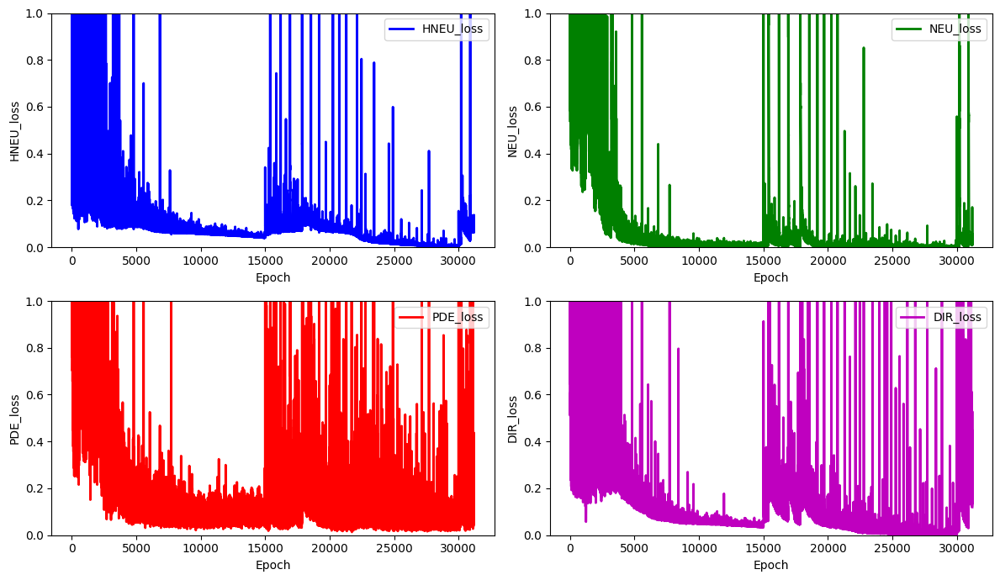

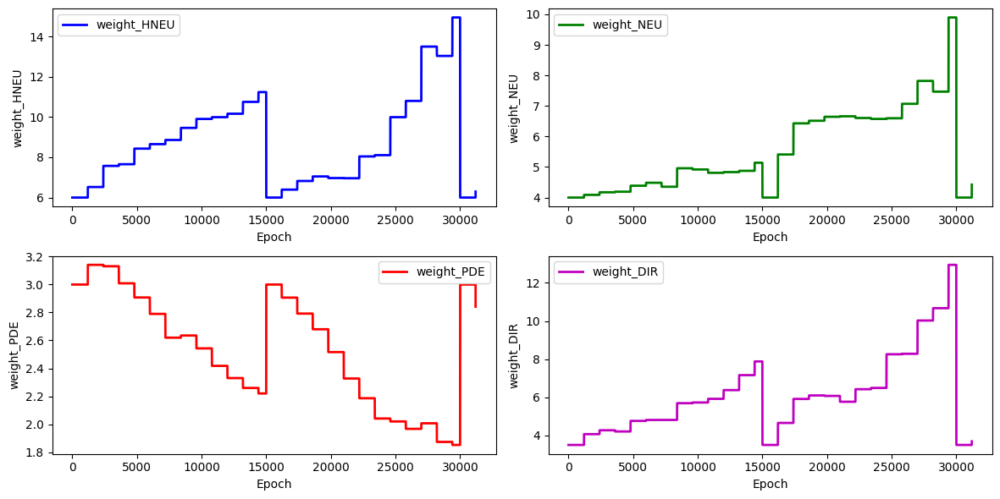

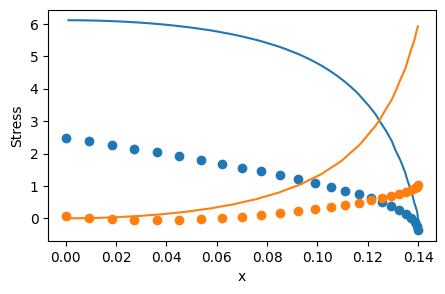

 12%|█▏        | 1799/15000 [44:02<5:18:07,  1.45s/it]

total_loss: 0.26568794320260797, hole_loss:  0.061364107633598834, neumann_loss:  0.019802424608518374, pde_loss: 0.07653964035373105, dirichlet_loss: 0.10798177060675972


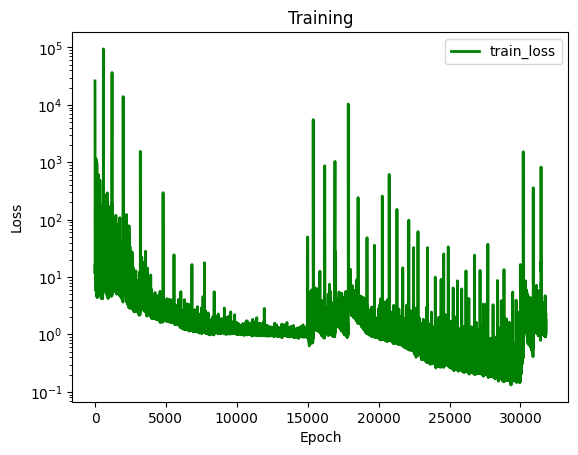

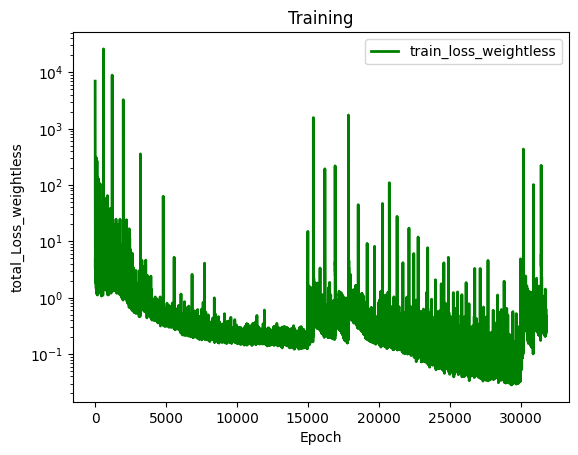

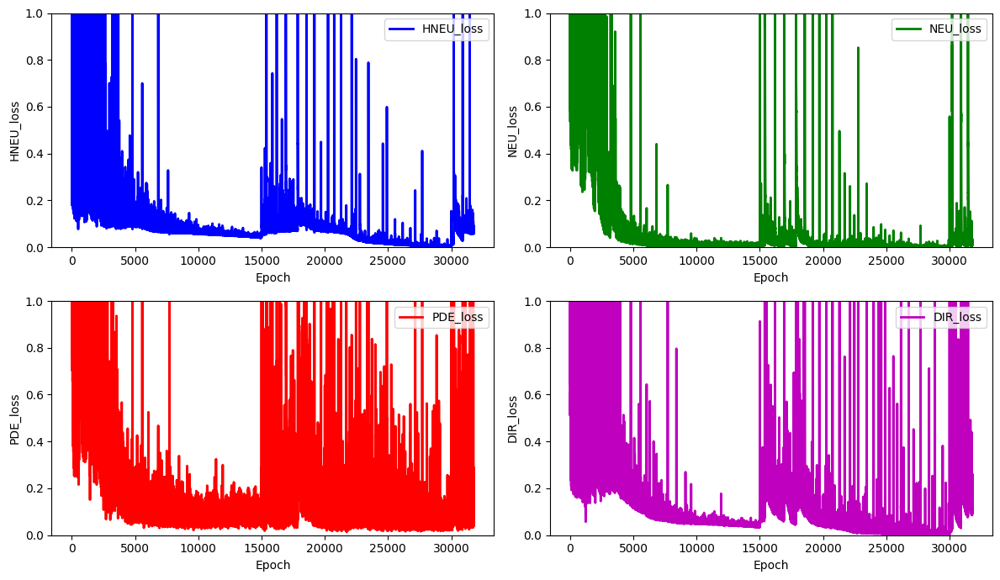

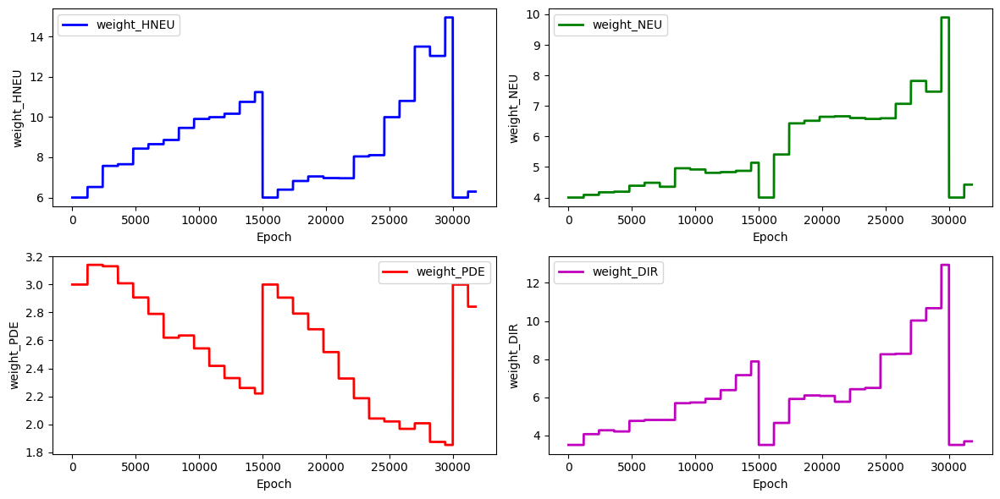

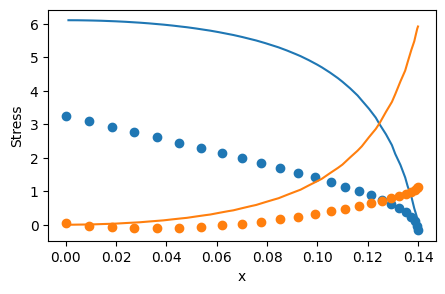

 16%|█▌        | 2399/15000 [59:39<5:30:44,  1.57s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 8.187387436789255
for weight 1 new weight_value: 5.5848642507326485
for weight 2 new weight_value: 2.8168754299900534
for weight 3 new weight_value: 4.9425000679909585
total_loss: 0.3899415431996794, hole_loss:  0.0701211988510551, neumann_loss:  0.014225580239072841, pde_loss: 0.2424630840550504, dirichlet_loss: 0.06313168005450105


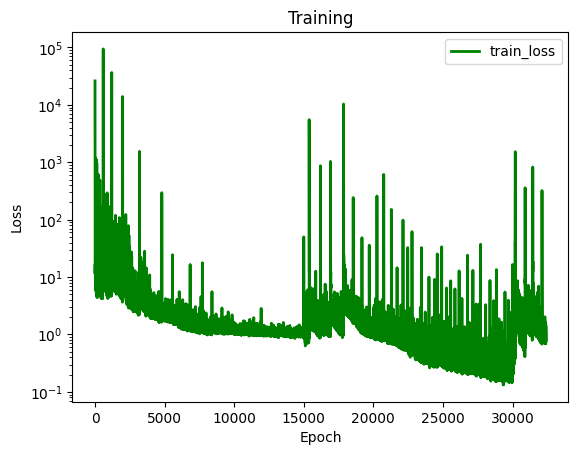

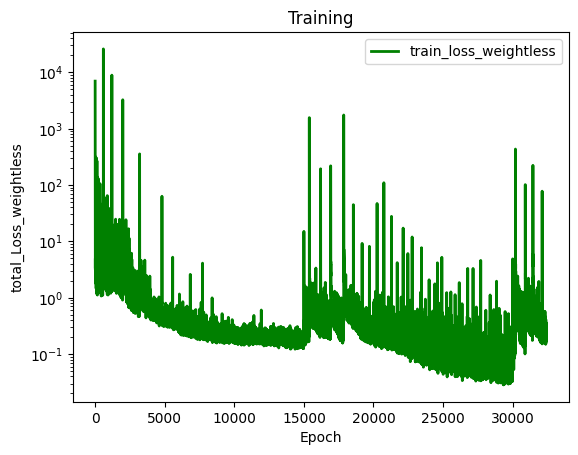

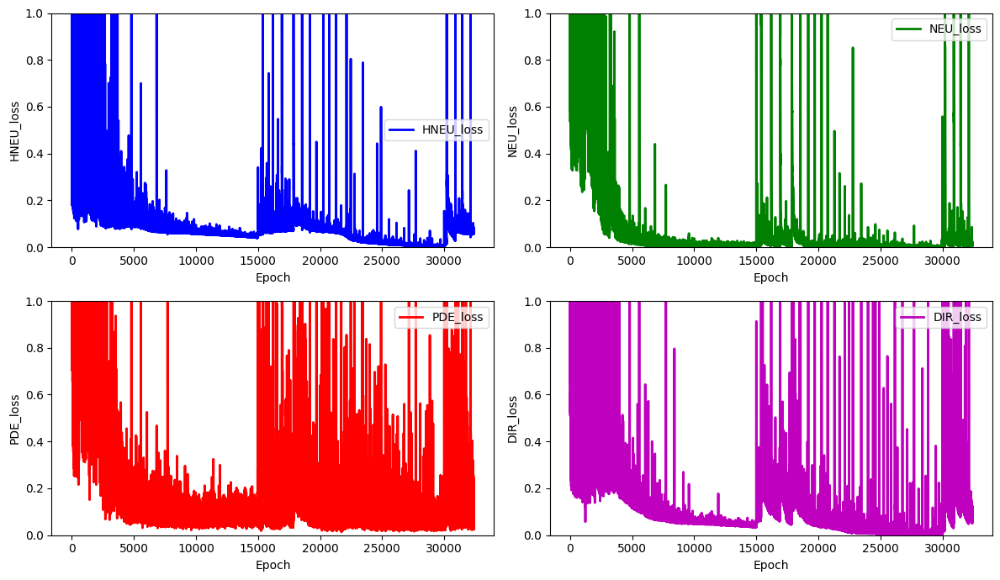

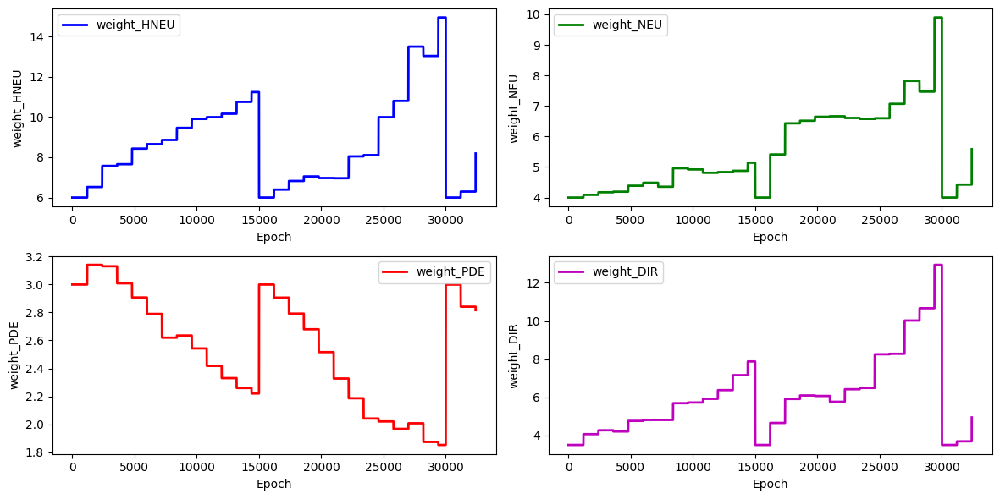

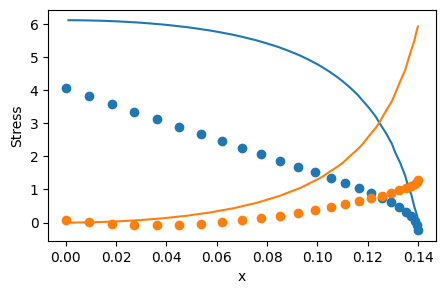

 20%|█▉        | 2999/15000 [1:14:14<4:48:05,  1.44s/it]

total_loss: 0.2131109751801012, hole_loss:  0.06029083061973653, neumann_loss:  0.006884827255402656, pde_loss: 0.08092280027473495, dirichlet_loss: 0.06501251703022706


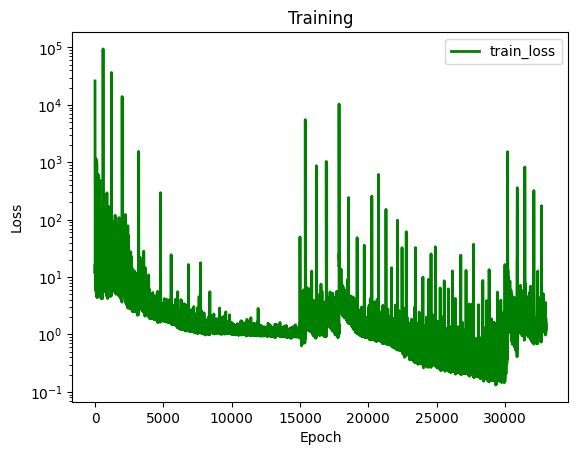

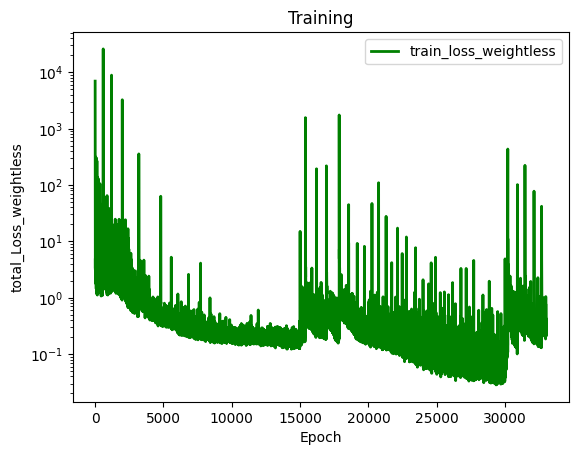

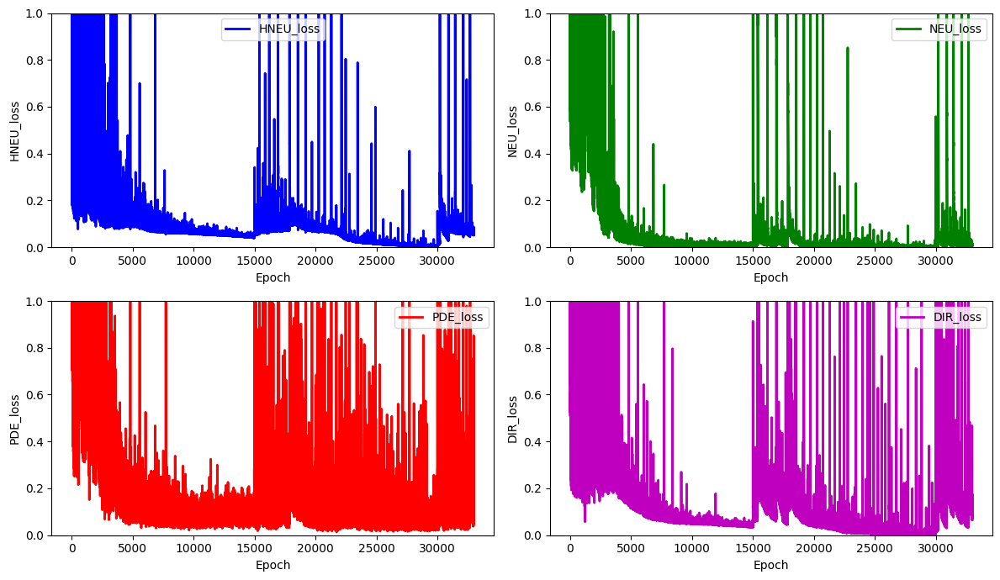

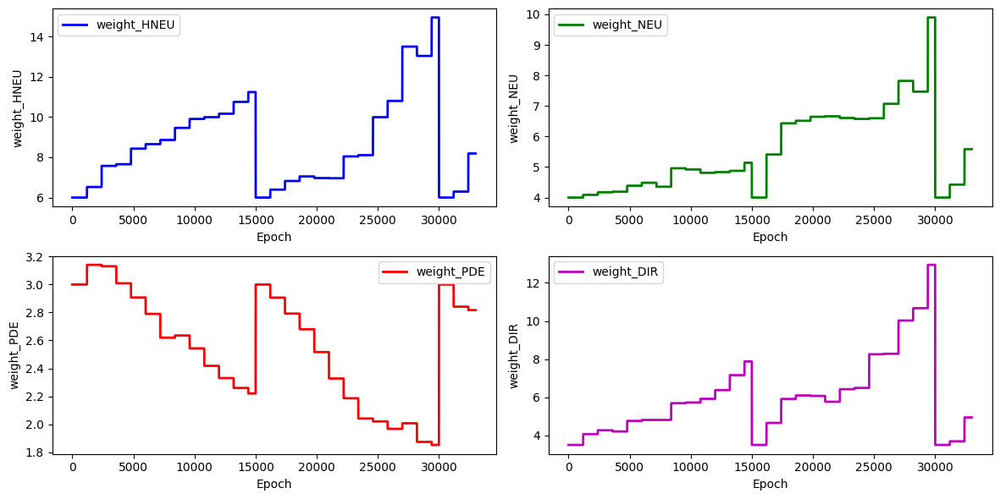

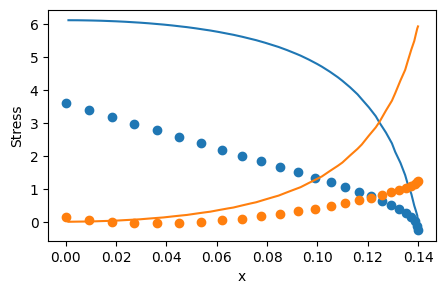

 24%|██▍       | 3599/15000 [1:29:23<4:47:05,  1.51s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 9.667026738288289
for weight 1 new weight_value: 6.976046518878484
for weight 2 new weight_value: 2.780770538678306
for weight 3 new weight_value: 7.200594356595763
total_loss: 0.2371647947773505, hole_loss:  0.051991773412607675, neumann_loss:  0.011269729998106928, pde_loss: 0.13270153092288026, dirichlet_loss: 0.04120176044375565


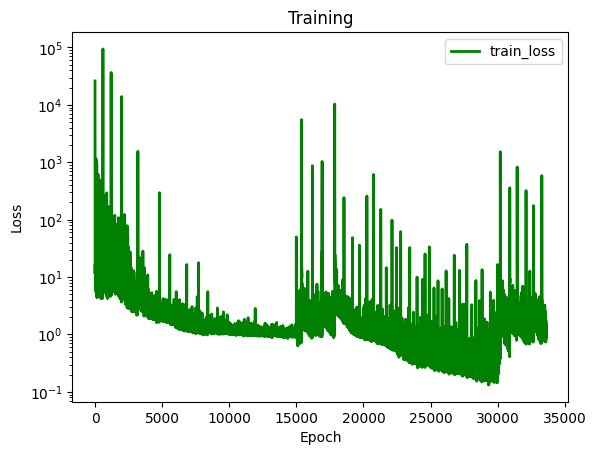

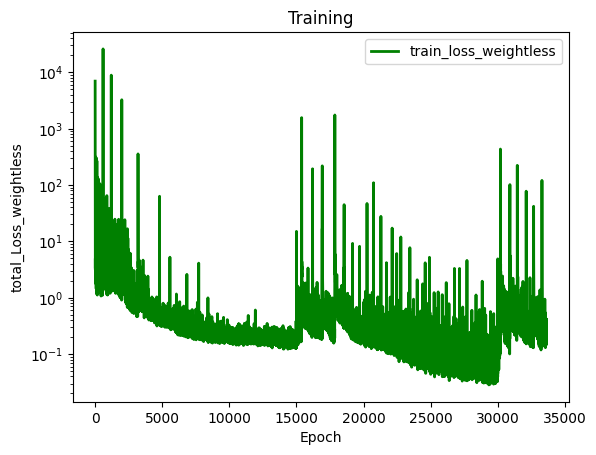

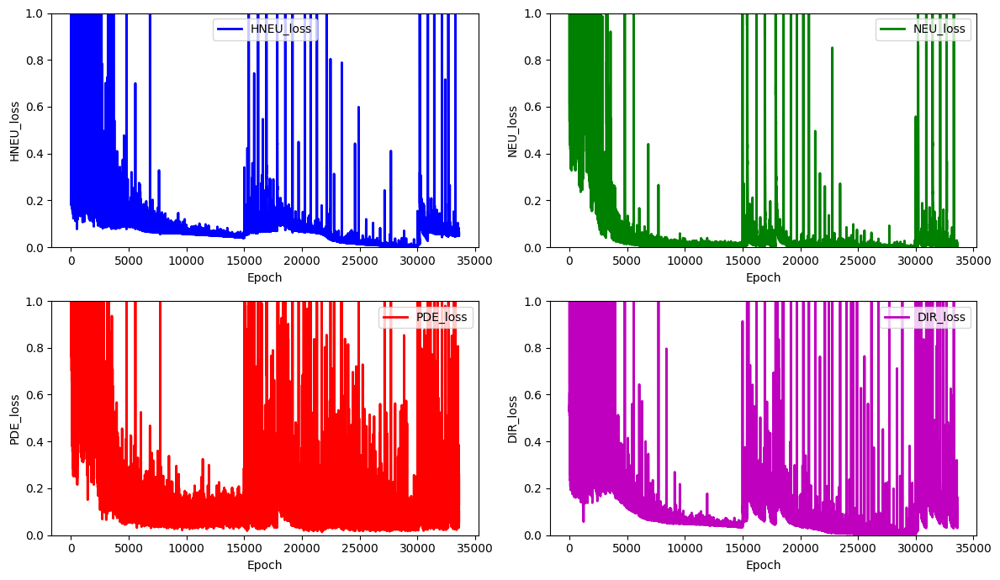

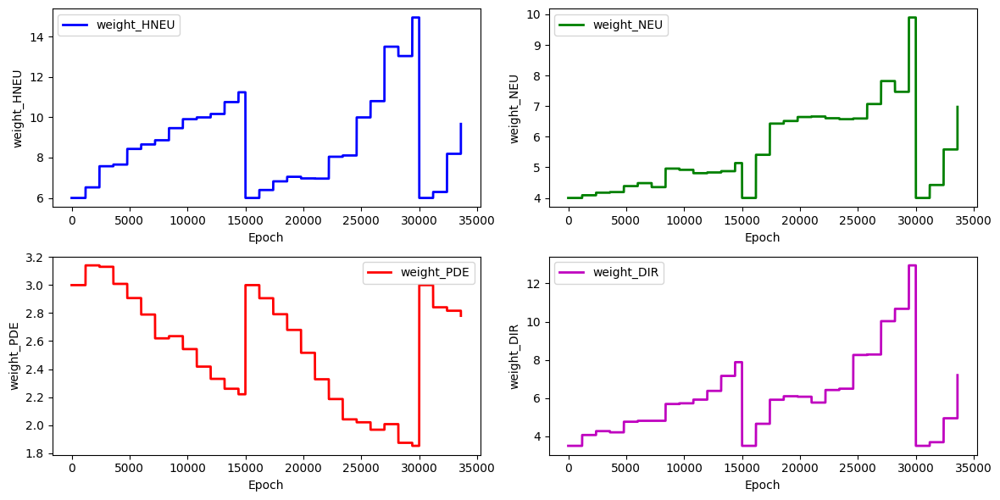

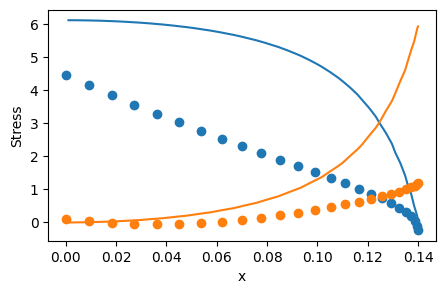

 28%|██▊       | 4199/15000 [1:43:43<4:16:57,  1.43s/it]

total_loss: 0.1534903157733979, hole_loss:  0.03528882977335654, neumann_loss:  0.021360564004497956, pde_loss: 0.07387997569323629, dirichlet_loss: 0.02296094630230711


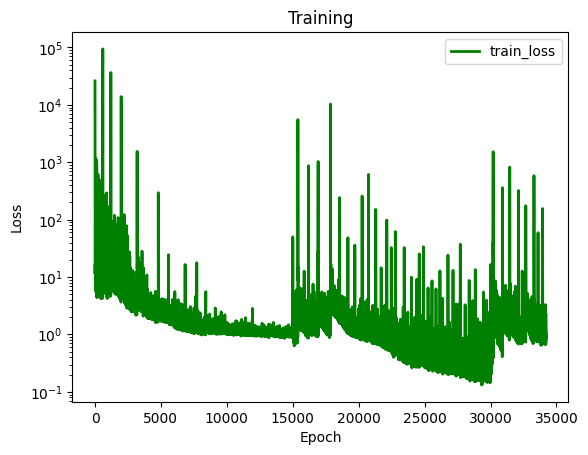

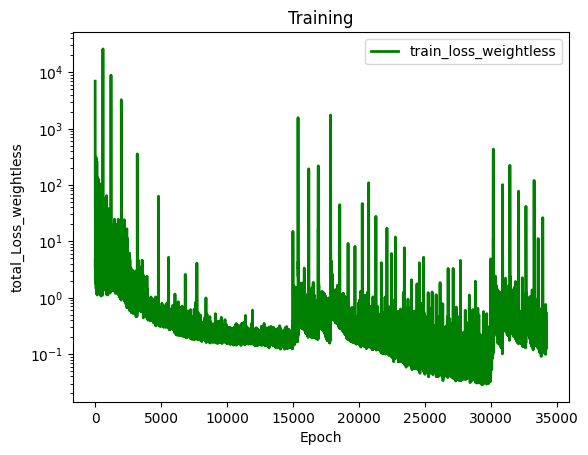

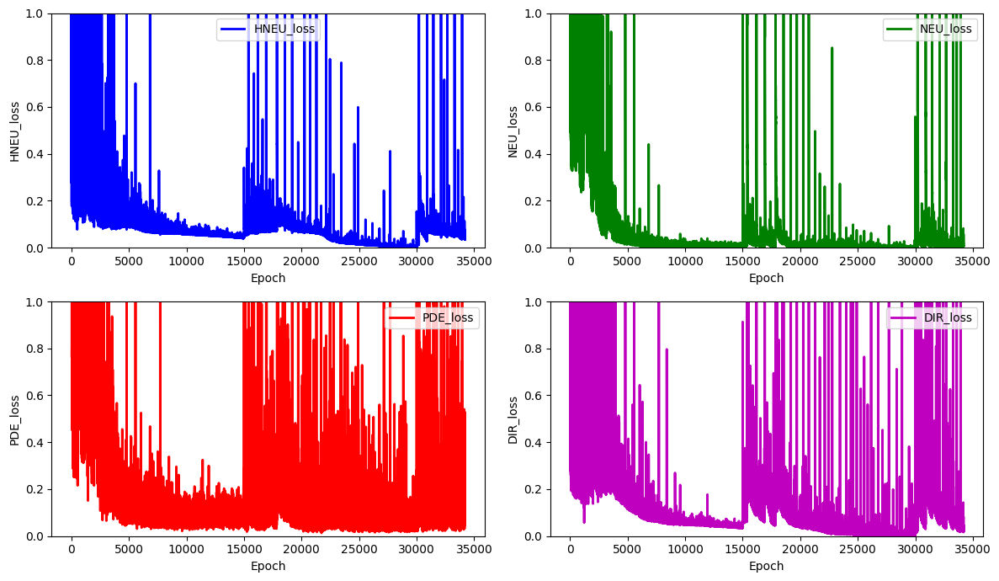

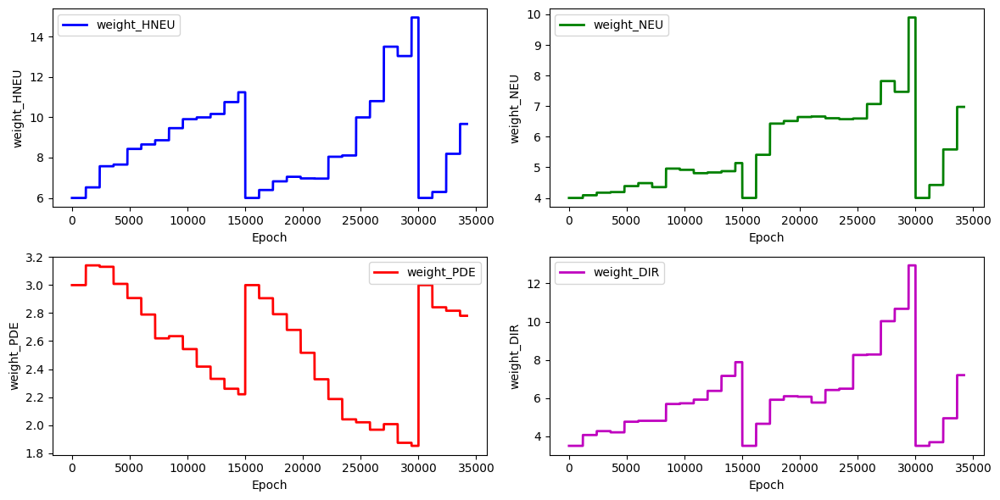

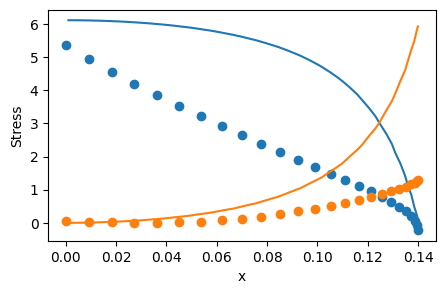

 32%|███▏      | 4799/15000 [1:58:25<4:08:58,  1.46s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 9.295413716304974
for weight 1 new weight_value: 7.0347692529650585
for weight 2 new weight_value: 2.5742241324893187
for weight 3 new weight_value: 7.3651483938689655
total_loss: 0.08694636081777822, hole_loss:  0.03864541141800015, neumann_loss:  0.0021137614649832134, pde_loss: 0.03302262120997448, dirichlet_loss: 0.013164566724820376


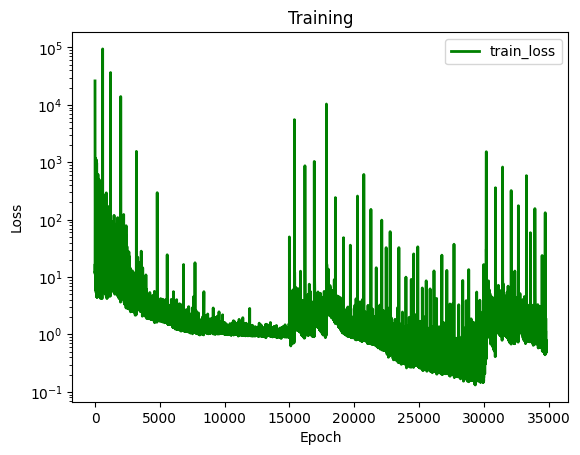

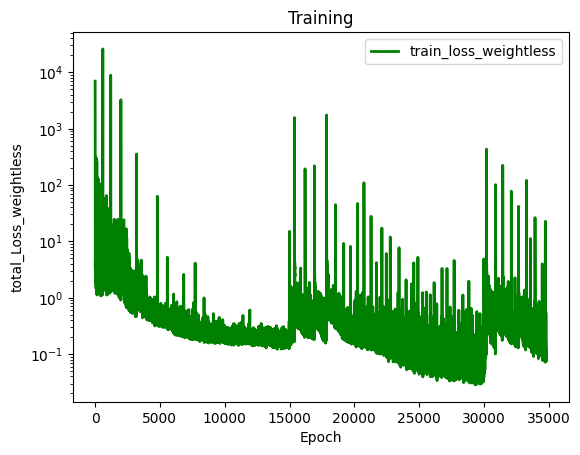

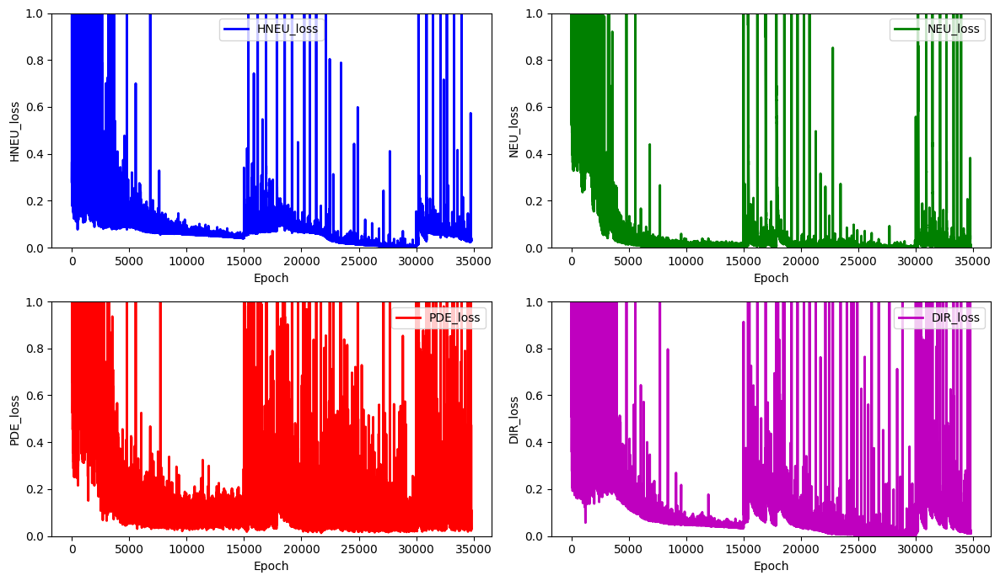

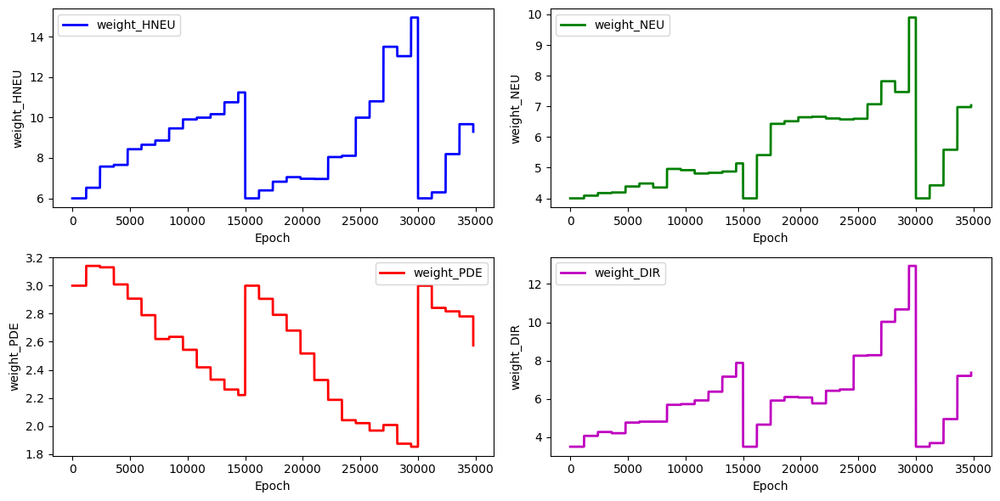

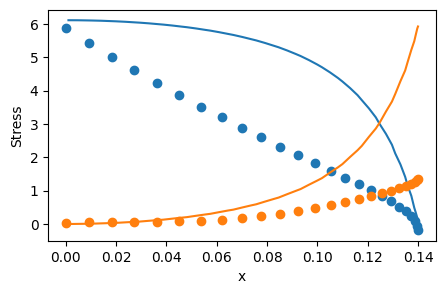

 36%|███▌      | 5399/15000 [2:12:46<3:48:58,  1.43s/it]

total_loss: 0.12645002657391333, hole_loss:  0.017368979347796024, neumann_loss:  0.0023147563239404255, pde_loss: 0.0960832156435511, dirichlet_loss: 0.010683075258625782


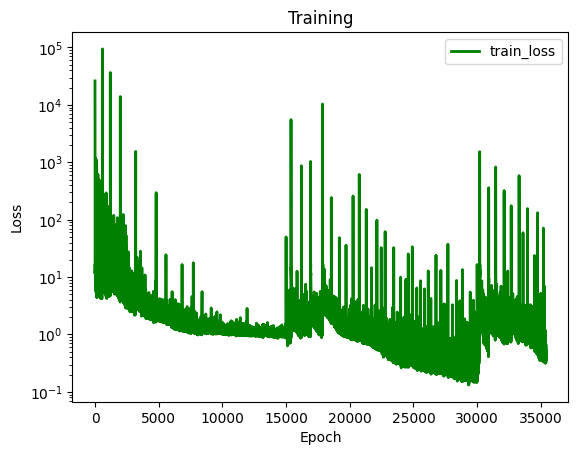

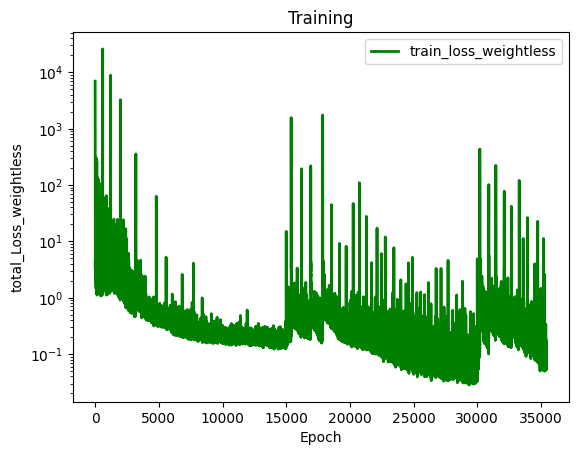

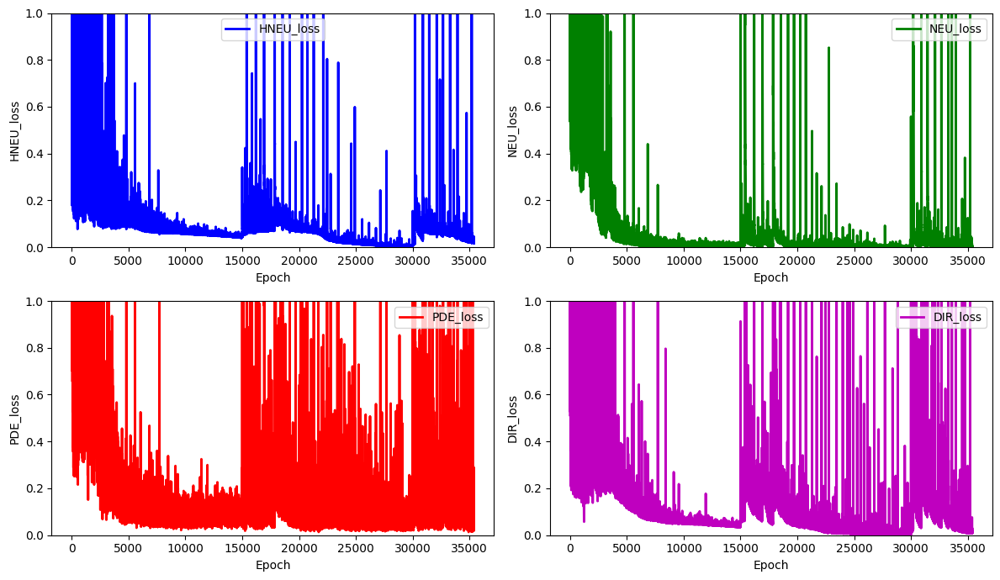

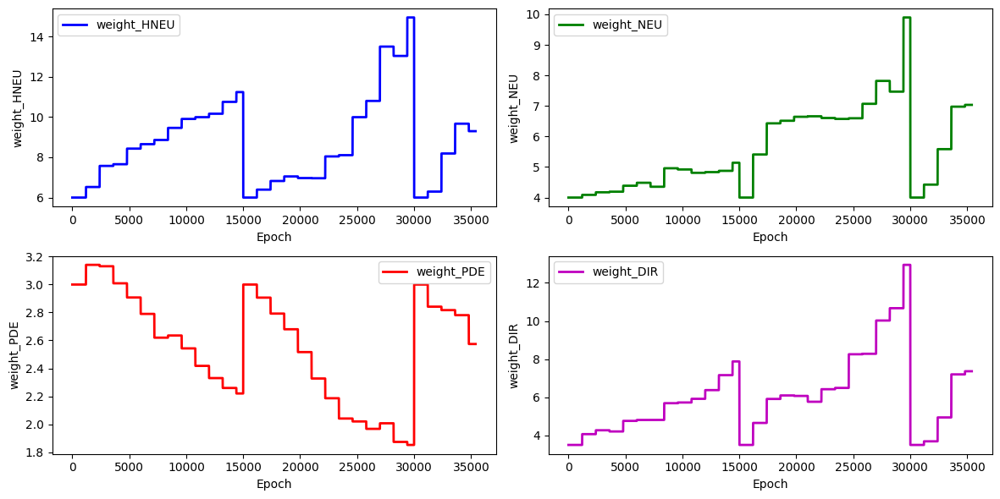

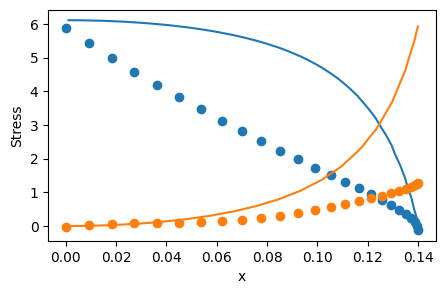

 40%|███▉      | 5999/15000 [2:27:26<3:39:04,  1.46s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 12.07225703433751
for weight 1 new weight_value: 7.579490045063467
for weight 2 new weight_value: 2.557025953091511
for weight 3 new weight_value: 7.812423528357591
total_loss: 0.28013816254448587, hole_loss:  0.019791538588240506, neumann_loss:  0.010512558537450721, pde_loss: 0.15287946243964592, dirichlet_loss: 0.09695460297914868


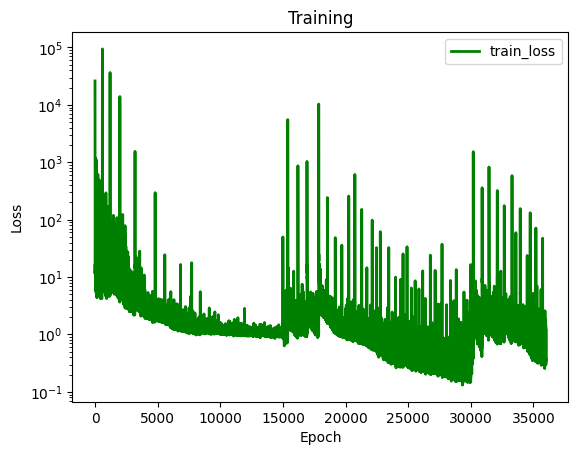

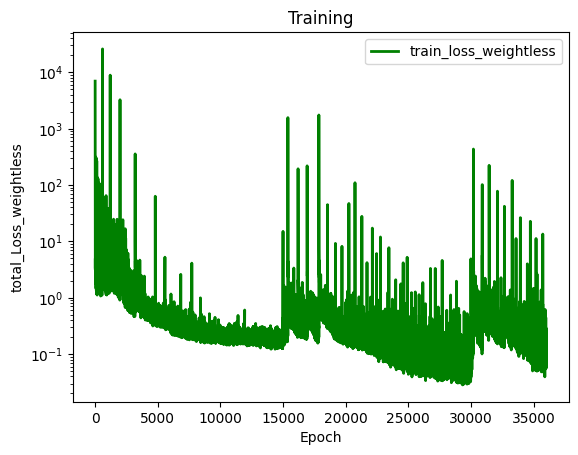

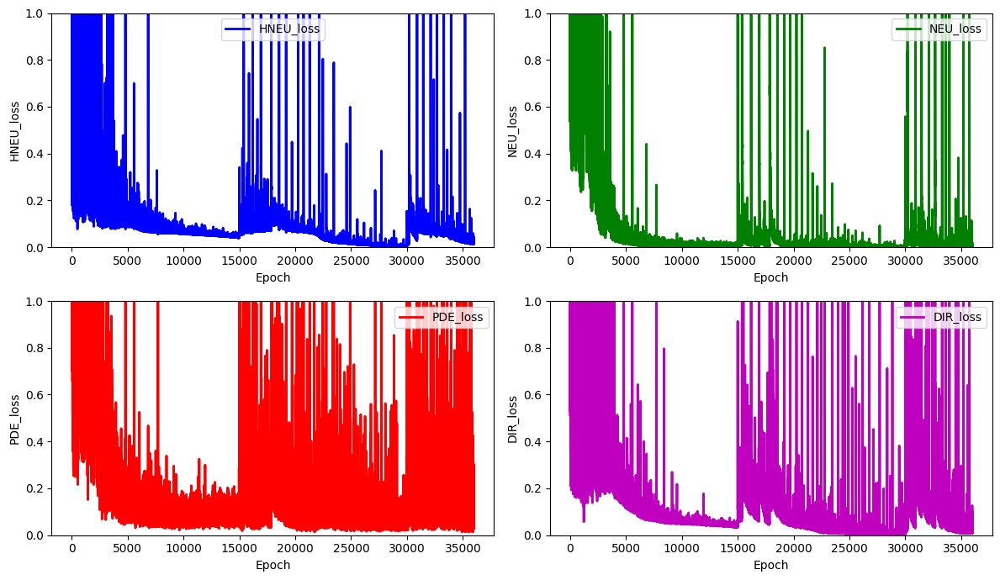

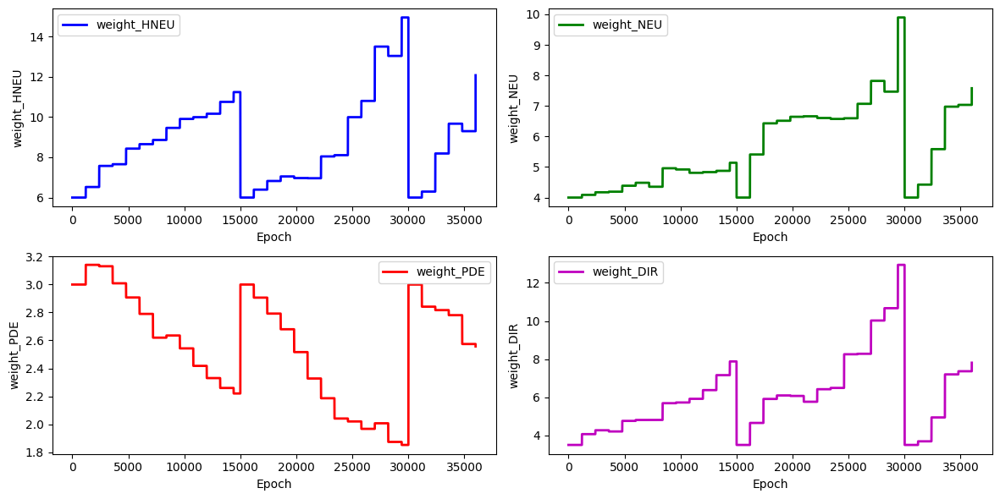

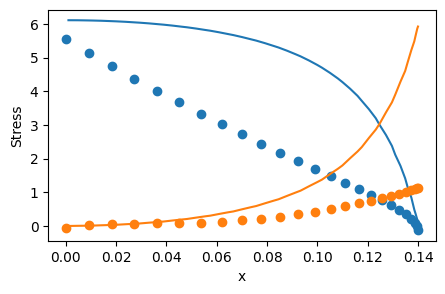

 44%|████▍     | 6599/15000 [2:42:55<3:33:34,  1.53s/it]

total_loss: 0.0851921666491662, hole_loss:  0.01011326186880417, neumann_loss:  0.0011174980172133152, pde_loss: 0.06323281951981508, dirichlet_loss: 0.010728587243333643


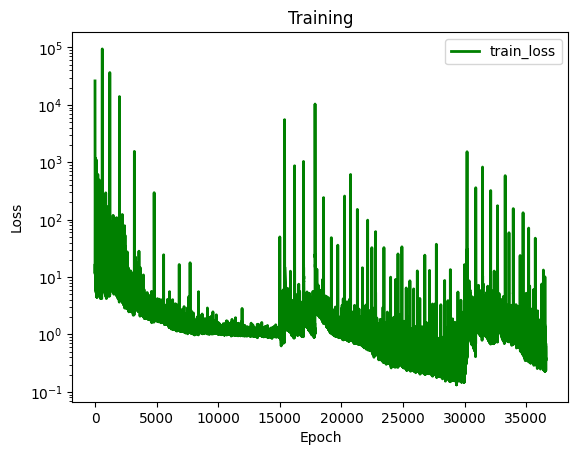

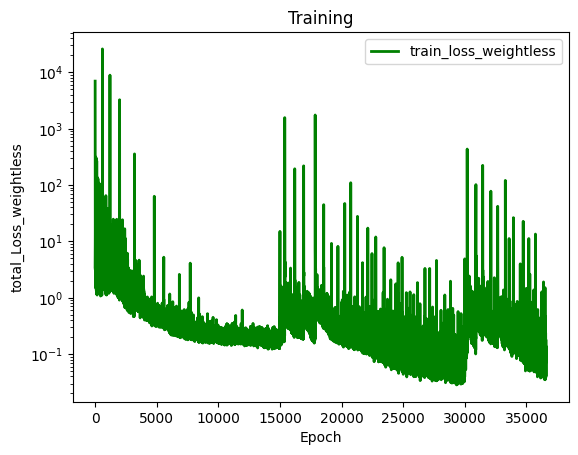

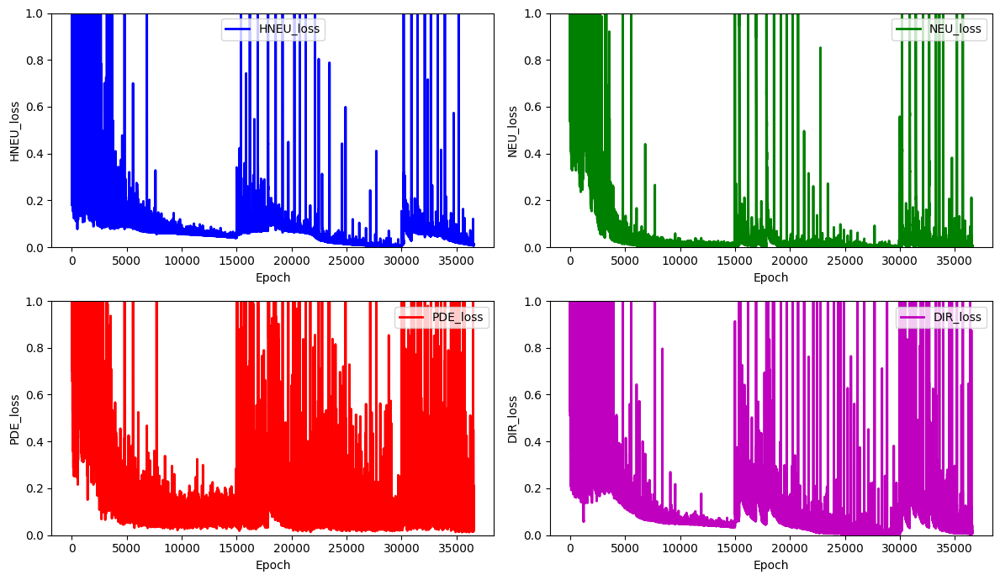

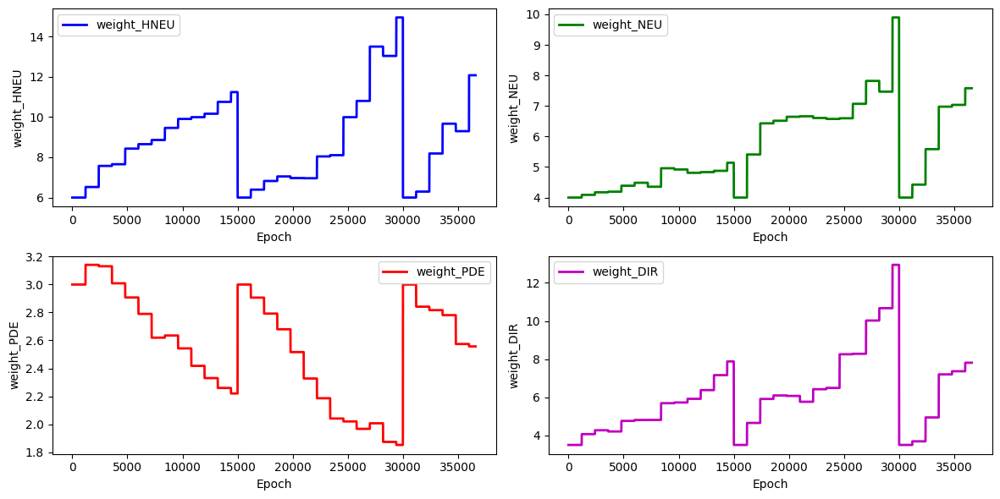

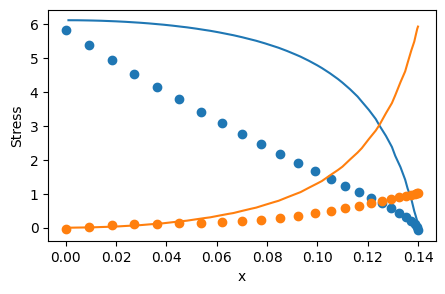

 48%|████▊     | 7199/15000 [2:57:38<3:10:51,  1.47s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 11.701719625285046
for weight 1 new weight_value: 7.13173993974324
for weight 2 new weight_value: 2.373038453263475
for weight 3 new weight_value: 7.626857902307899
total_loss: 0.029006569240873765, hole_loss:  0.007120040027559825, neumann_loss:  0.0010142280068139546, pde_loss: 0.014972151941789493, dirichlet_loss: 0.005900149264710493


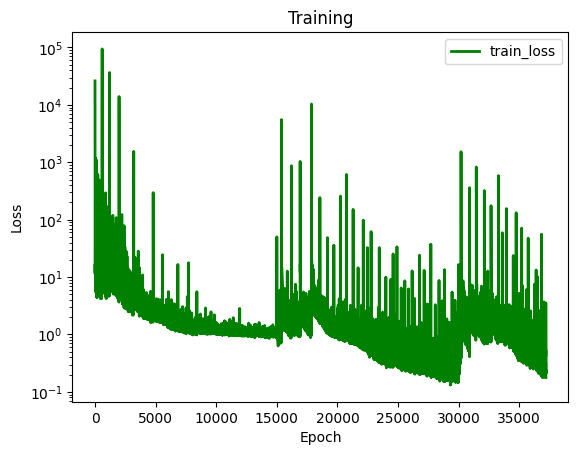

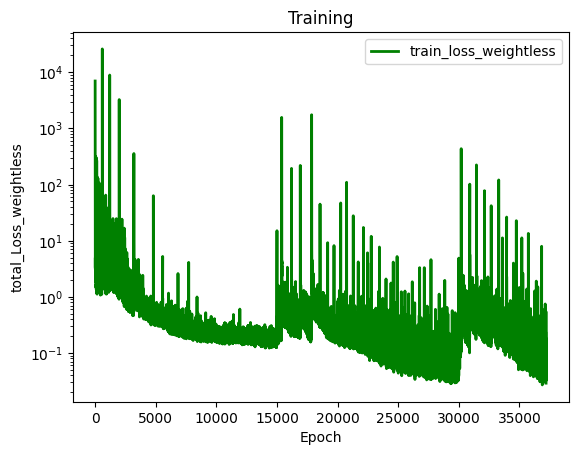

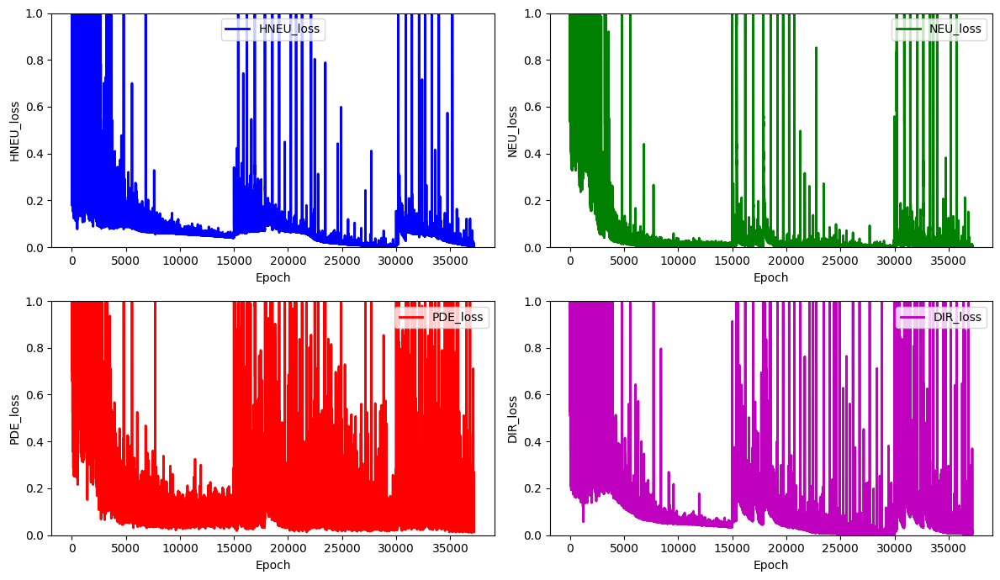

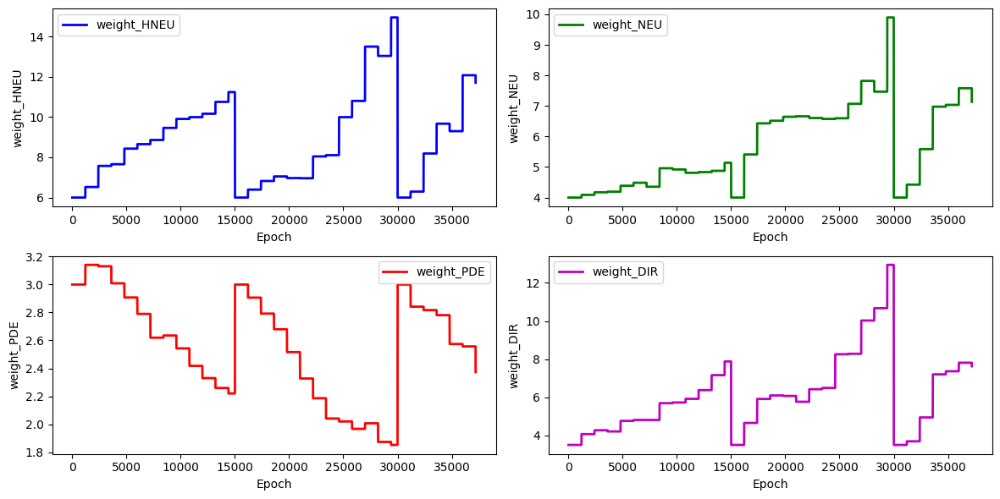

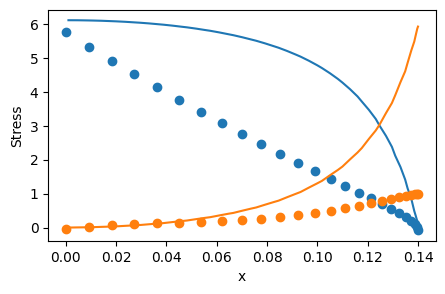

 52%|█████▏    | 7799/15000 [3:12:58<2:59:56,  1.50s/it]

total_loss: 0.03840073686950528, hole_loss:  0.0063018510598118116, neumann_loss:  0.0009526708670029695, pde_loss: 0.024591378865292675, dirichlet_loss: 0.0065548360773978204


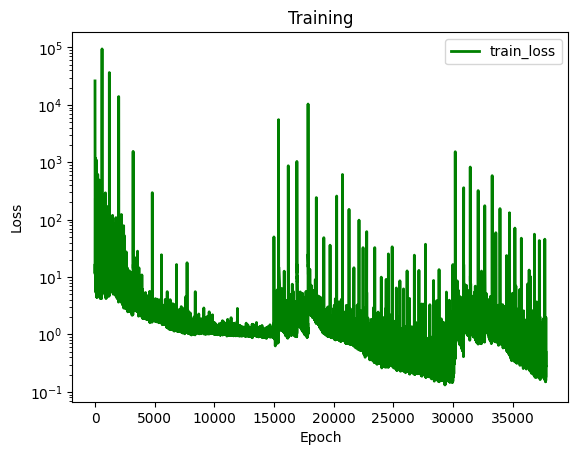

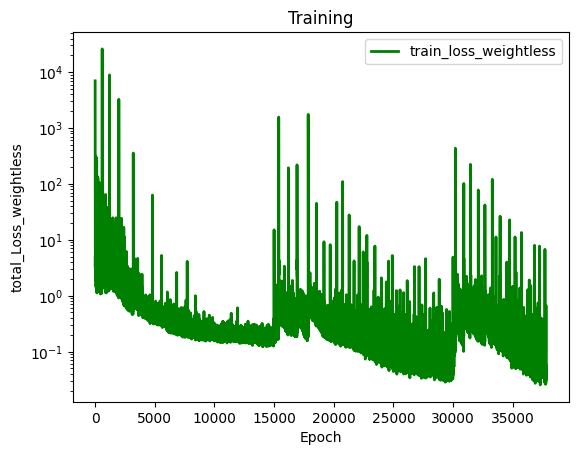

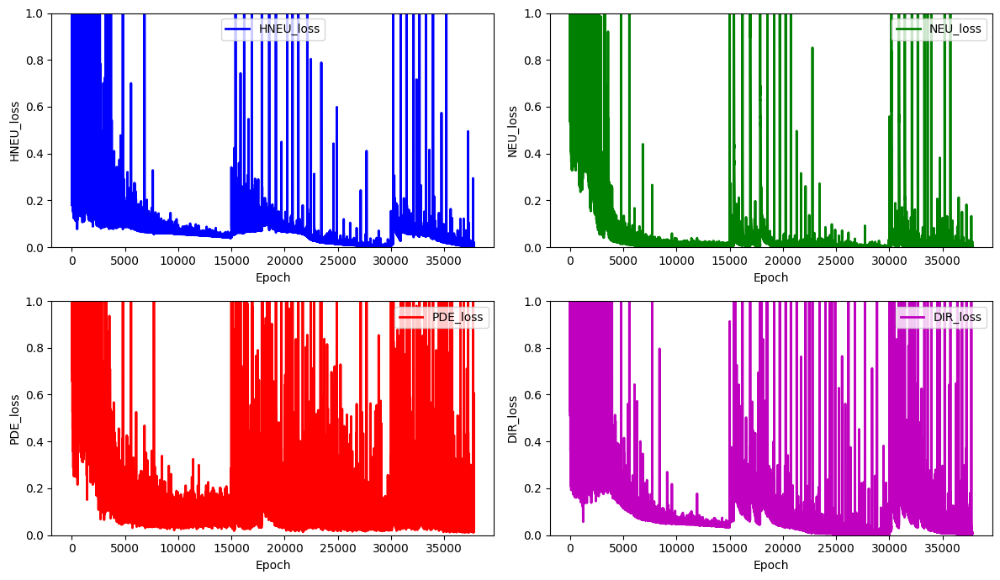

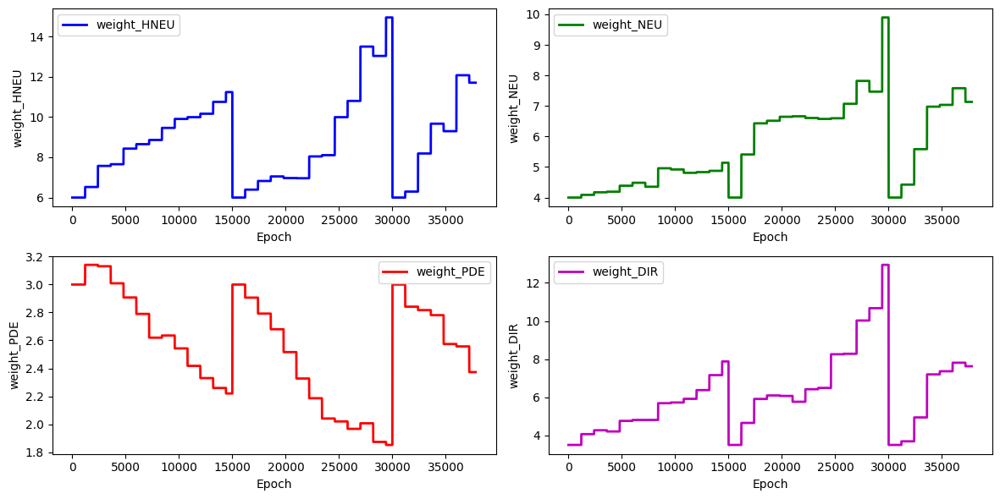

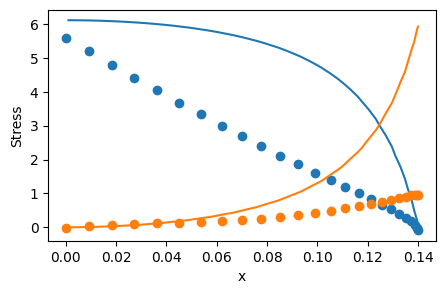

 56%|█████▌    | 8399/15000 [3:27:24<2:37:52,  1.43s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 11.40719446884084
for weight 1 new weight_value: 6.86945180439843
for weight 2 new weight_value: 2.240527289013514
for weight 3 new weight_value: 7.6343588820983355
total_loss: 0.0341397557421165, hole_loss:  0.0051807715733688565, neumann_loss:  0.002095578393983686, pde_loss: 0.021014516673276577, dirichlet_loss: 0.005848889101487378


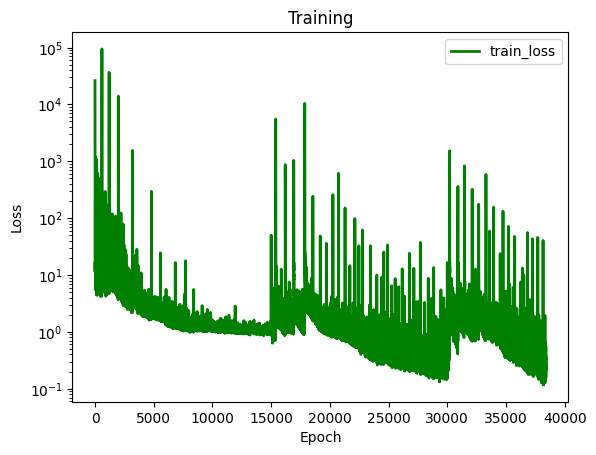

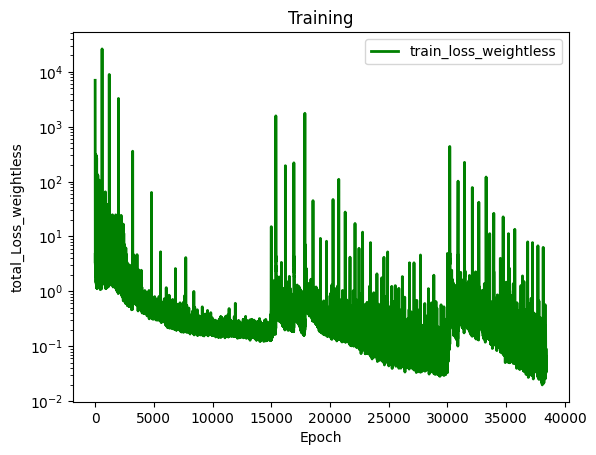

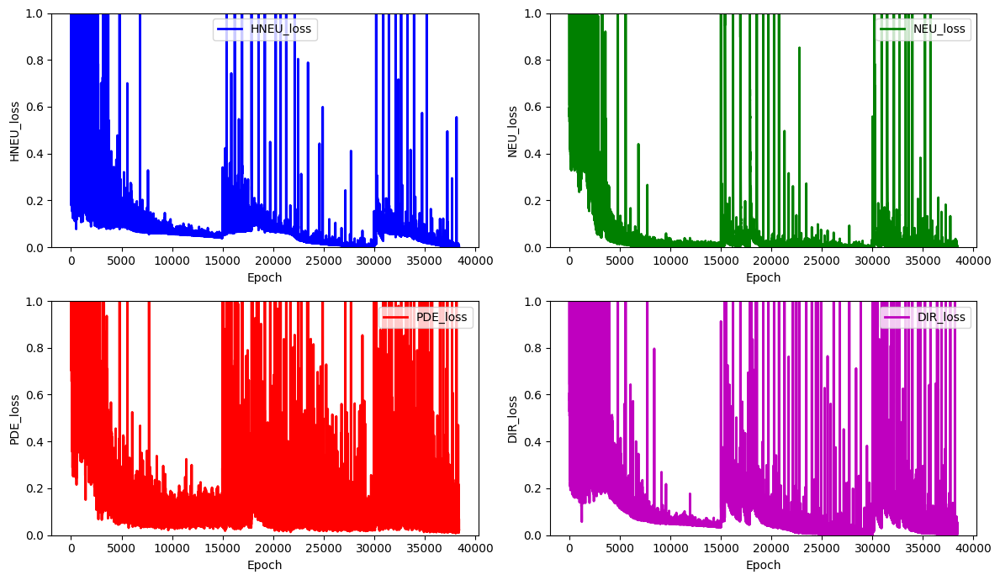

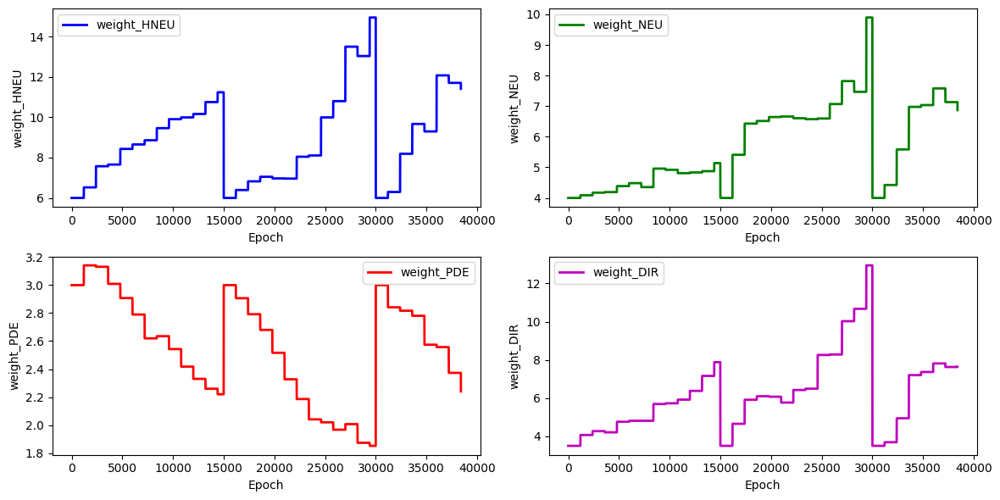

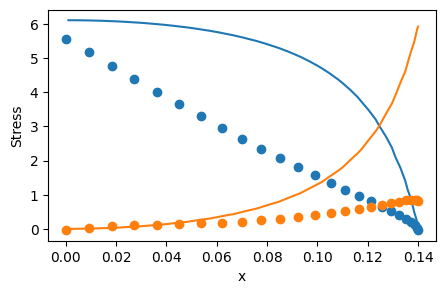

 60%|█████▉    | 8999/15000 [3:42:29<2:28:31,  1.49s/it]

total_loss: 0.15122152344051562, hole_loss:  0.005997176486325738, neumann_loss:  0.007650099958341851, pde_loss: 0.12782458171133965, dirichlet_loss: 0.00974966528450838


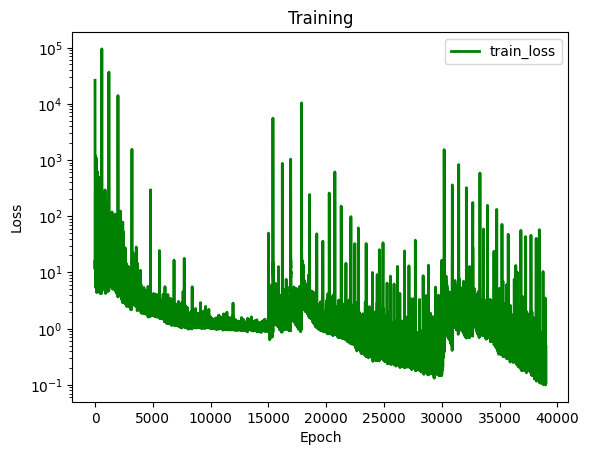

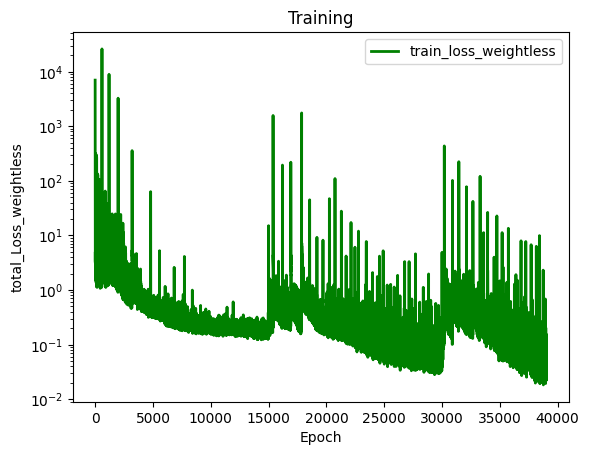

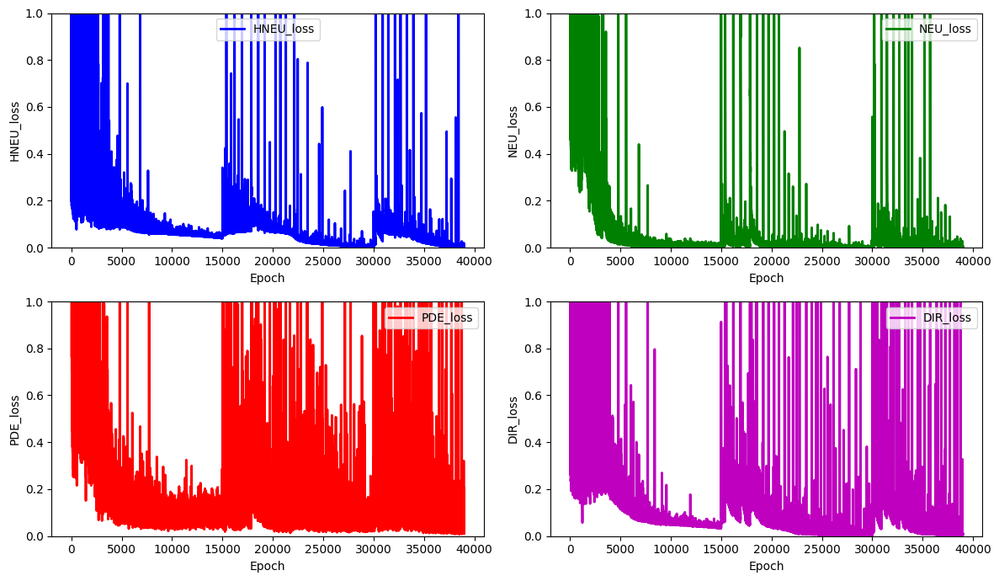

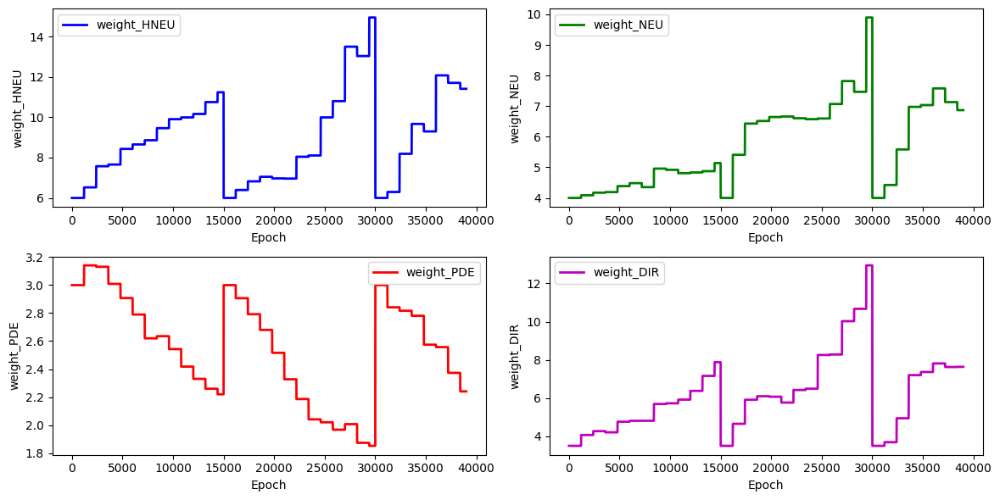

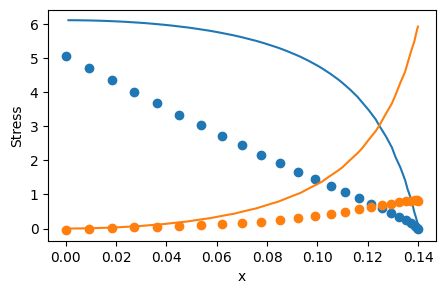

 64%|██████▍   | 9599/15000 [3:58:36<2:14:32,  1.49s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 12.548635613476787
for weight 1 new weight_value: 6.807400817254836
for weight 2 new weight_value: 2.091409633401631
for weight 3 new weight_value: 8.124980173627824
total_loss: 0.0316533478392053, hole_loss:  0.0029323996583876673, neumann_loss:  0.0012379283063844138, pde_loss: 0.018246265536591897, dirichlet_loss: 0.009236754337841322


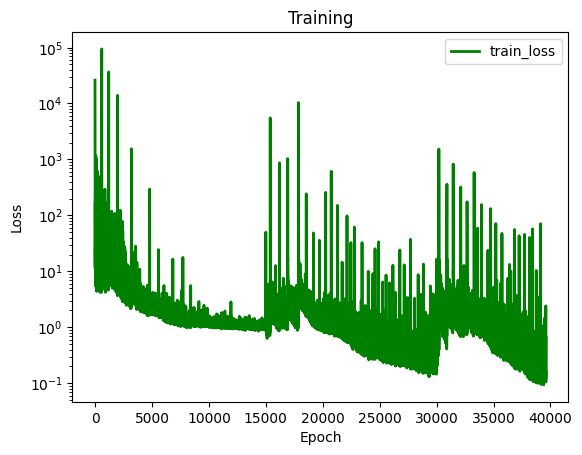

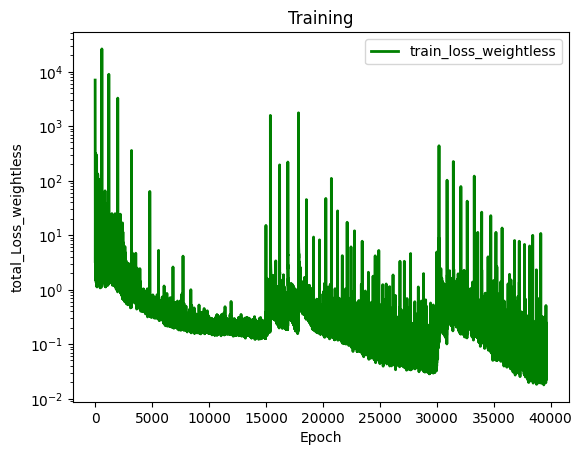

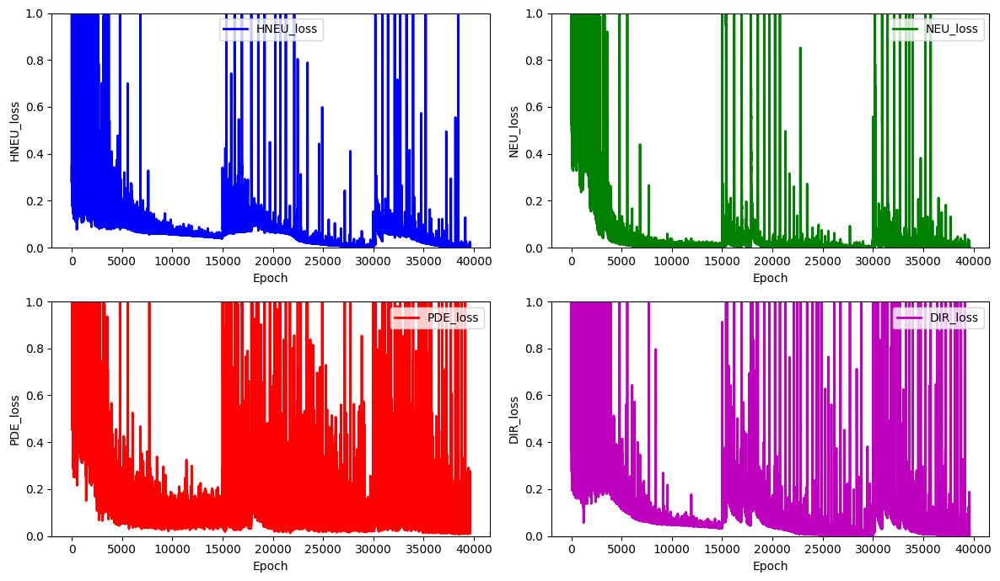

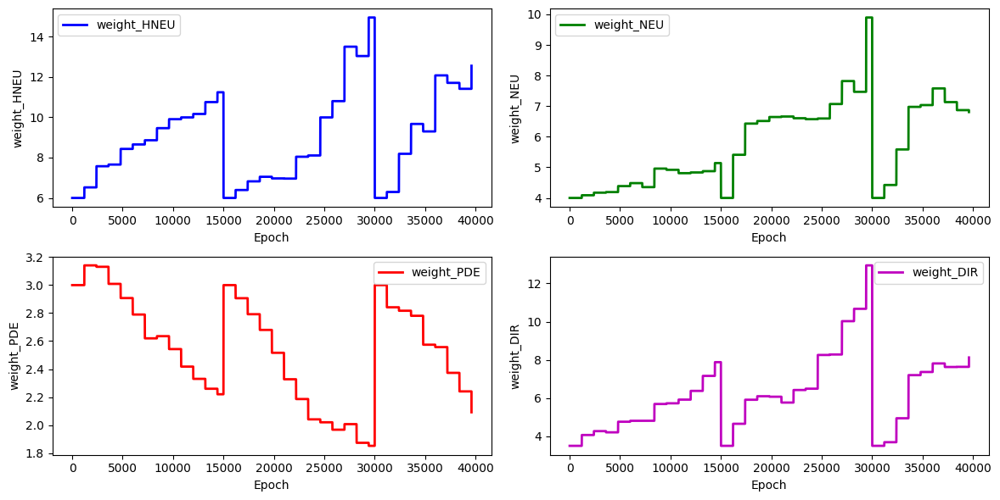

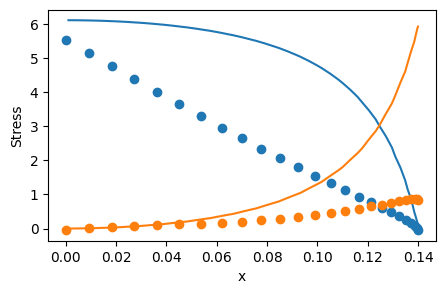

 68%|██████▊   | 10199/15000 [4:13:04<1:54:01,  1.43s/it]

total_loss: 0.0732340003261734, hole_loss:  0.0019477155277257895, neumann_loss:  0.0018042379869507715, pde_loss: 0.06172472133278676, dirichlet_loss: 0.007757325478710087


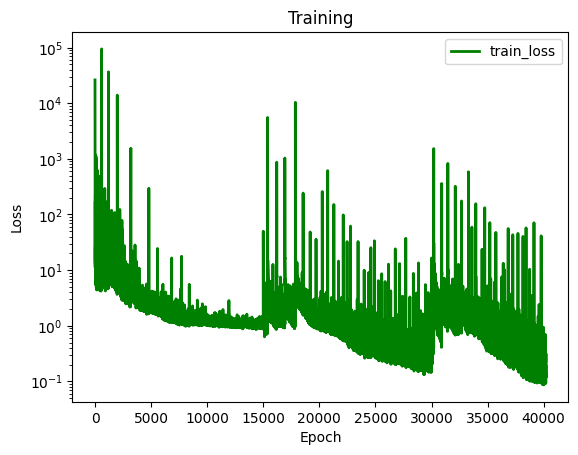

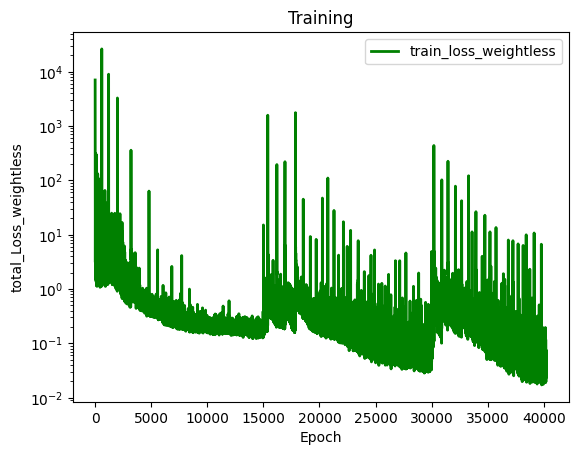

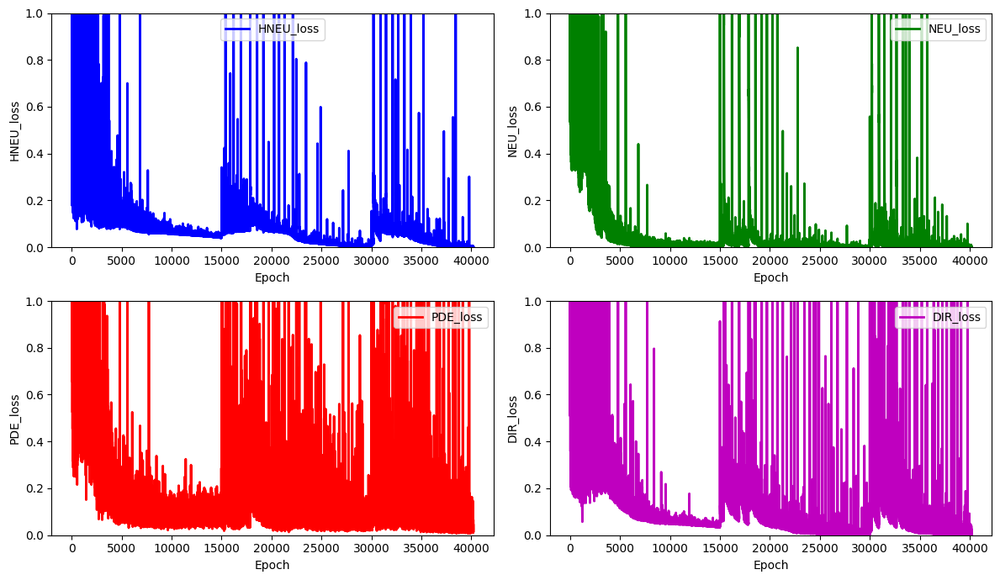

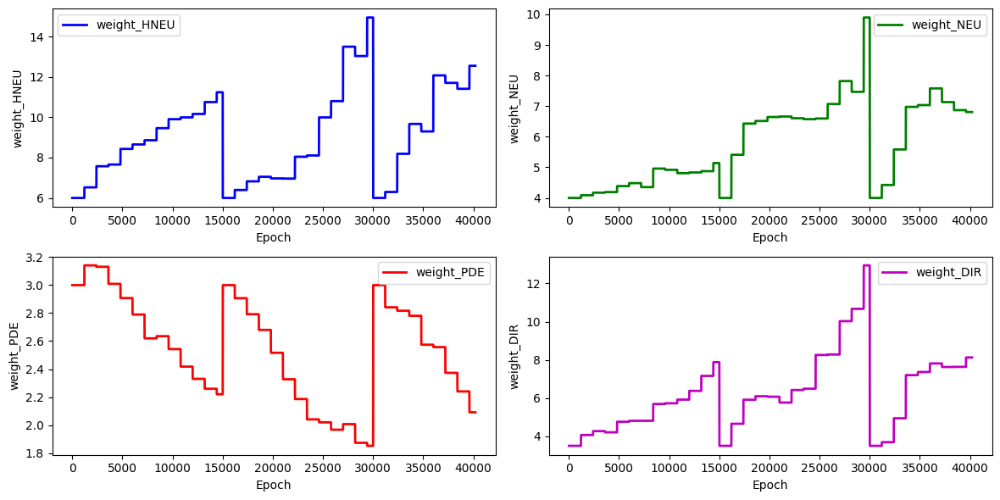

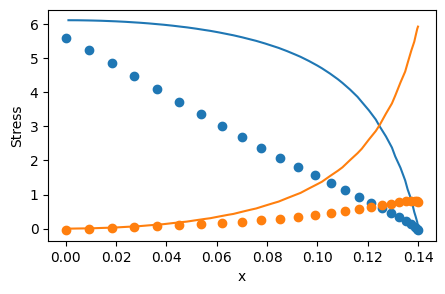

 72%|███████▏  | 10799/15000 [4:28:05<1:44:01,  1.49s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 12.81310311511547
for weight 1 new weight_value: 6.642805808474754
for weight 2 new weight_value: 1.9784972740791884
for weight 3 new weight_value: 7.703155574172554
total_loss: 0.03744358810364721, hole_loss:  0.0017757005134936394, neumann_loss:  0.003773818697257819, pde_loss: 0.016664926823408456, dirichlet_loss: 0.015229142069487294


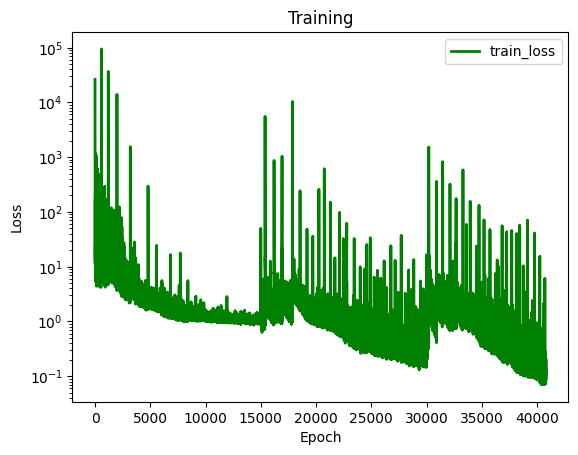

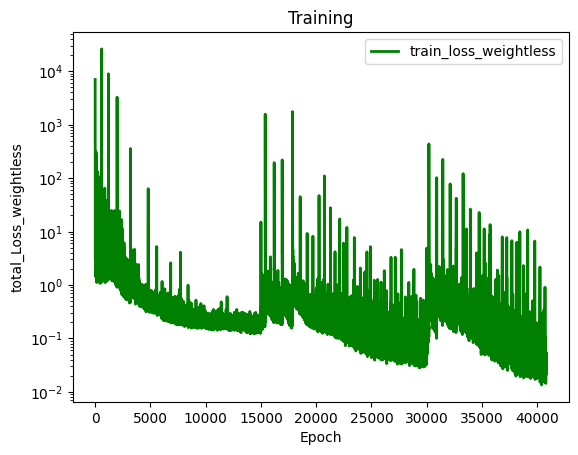

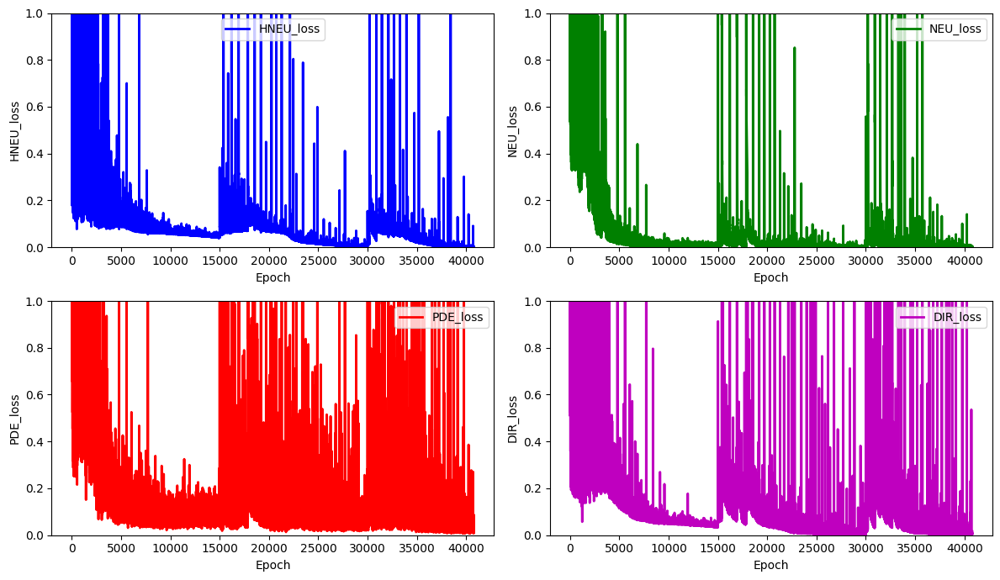

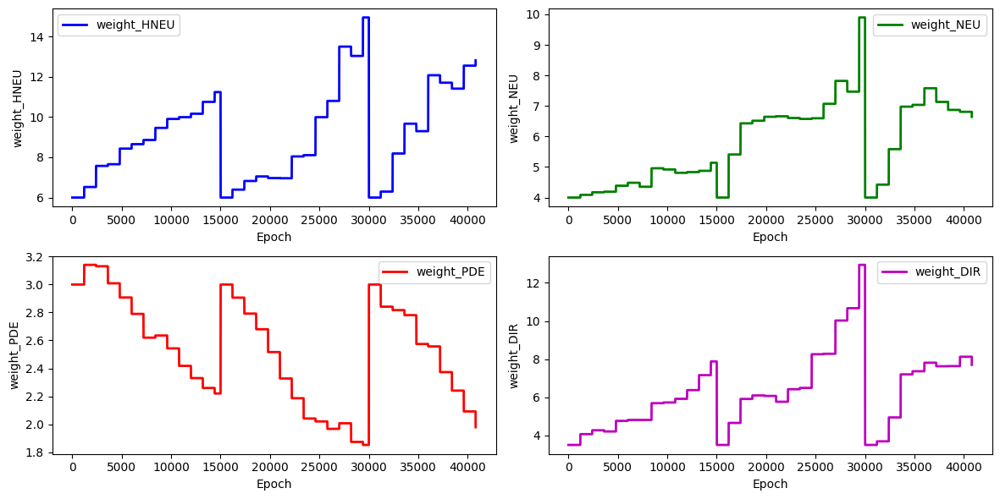

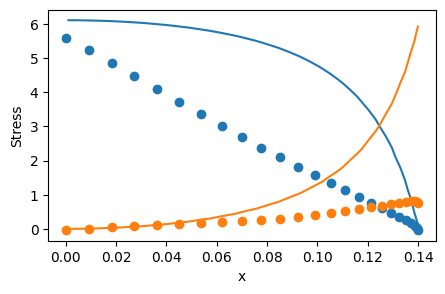

 76%|███████▌  | 11399/15000 [4:42:09<1:23:30,  1.39s/it]

total_loss: 0.09263121373765196, hole_loss:  0.001549639223297679, neumann_loss:  0.0013385234392886498, pde_loss: 0.08186049079423295, dirichlet_loss: 0.007882560280832666


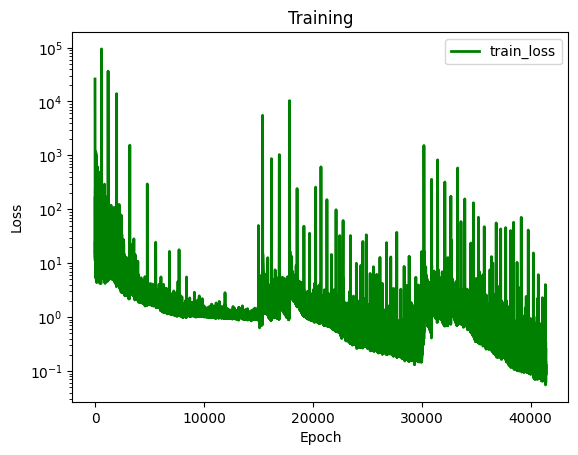

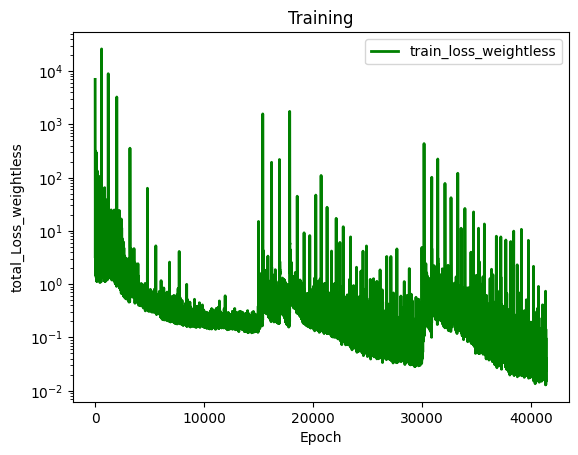

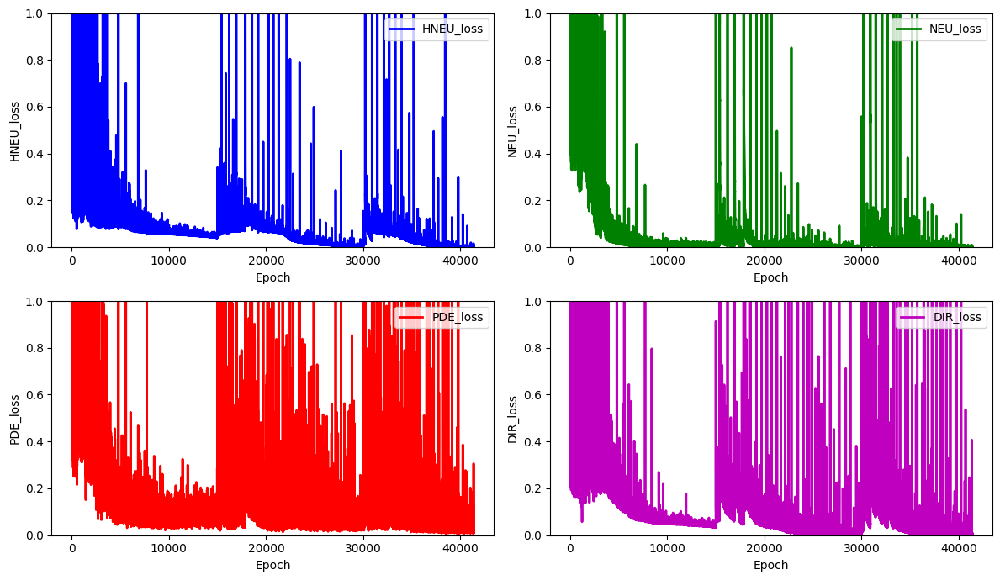

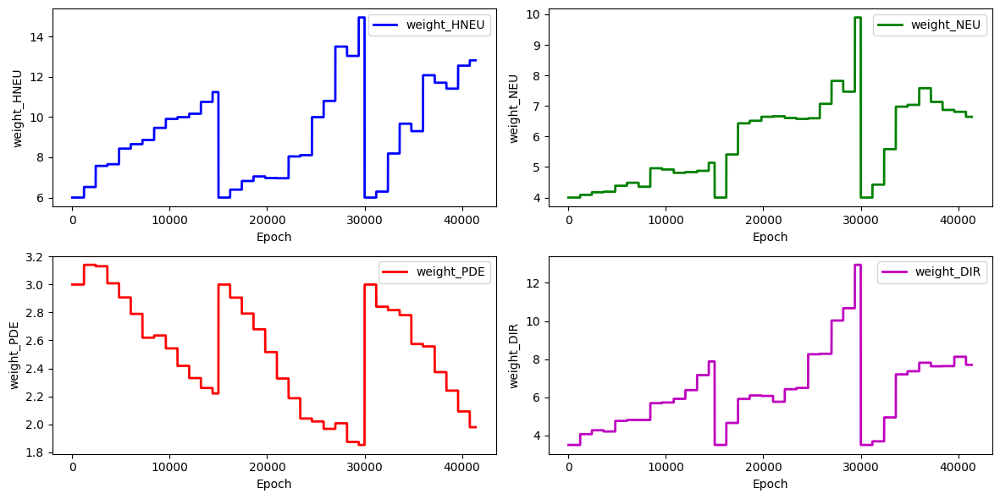

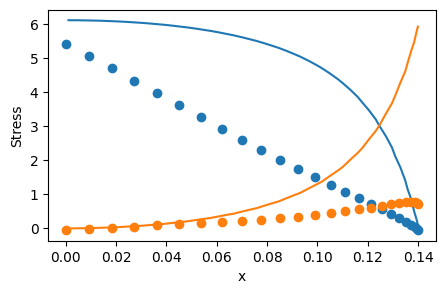

 80%|███████▉  | 11999/15000 [4:56:42<1:12:24,  1.45s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 13.817151983149968
for weight 1 new weight_value: 7.046464298088811
for weight 2 new weight_value: 1.9531508772271293
for weight 3 new weight_value: 8.843241411735121
total_loss: 0.030315073791056038, hole_loss:  0.002430338767977706, neumann_loss:  0.0025852616116137732, pde_loss: 0.01789322915465955, dirichlet_loss: 0.007406244256805012


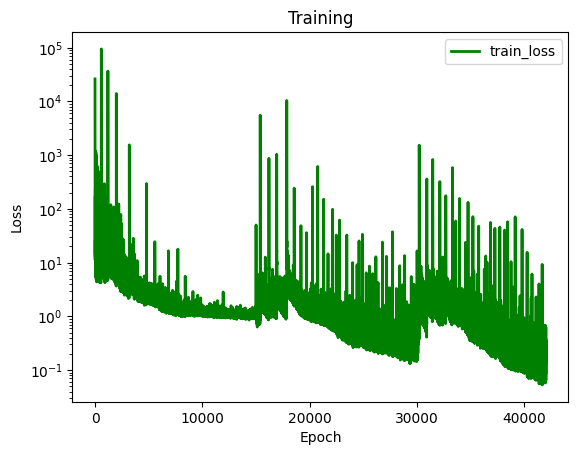

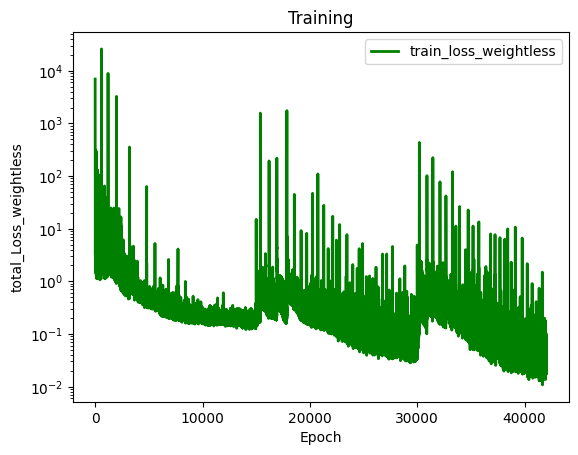

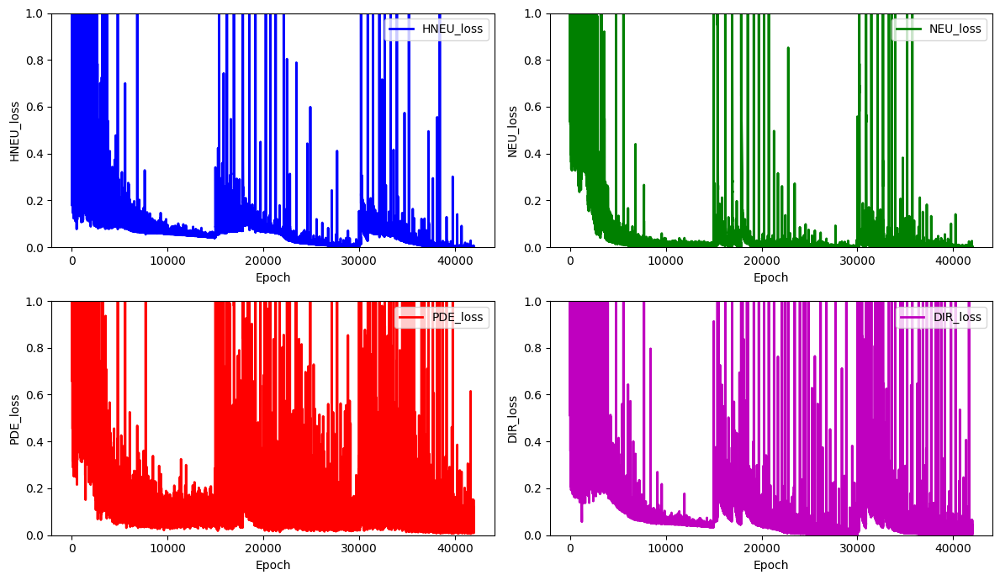

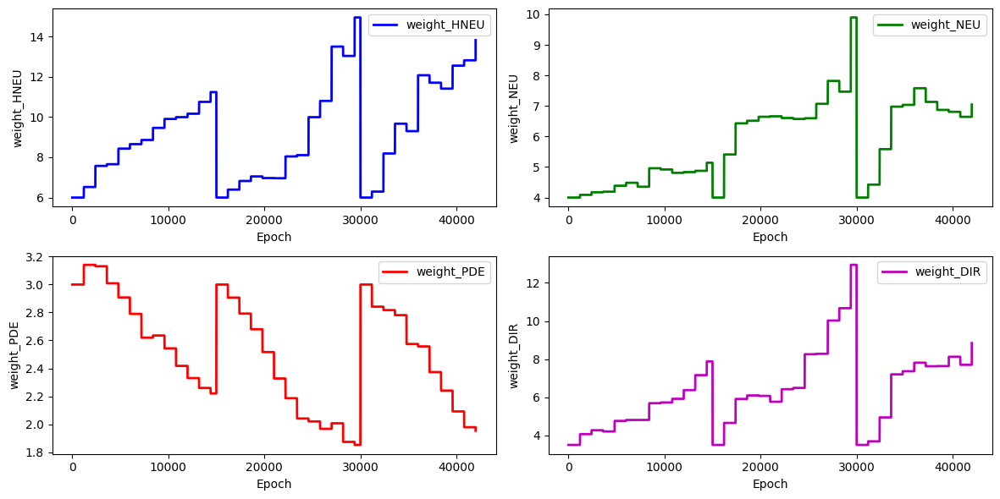

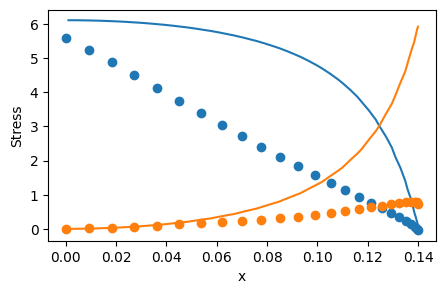

 84%|████████▍ | 12599/15000 [5:11:52<59:48,  1.49s/it]  

total_loss: 0.017577177841728693, hole_loss:  0.001018428541248691, neumann_loss:  0.0012164145012930863, pde_loss: 0.011044040197580256, dirichlet_loss: 0.0042982946016066614


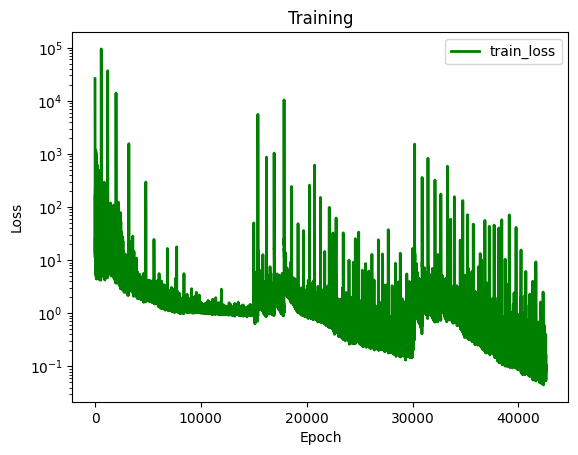

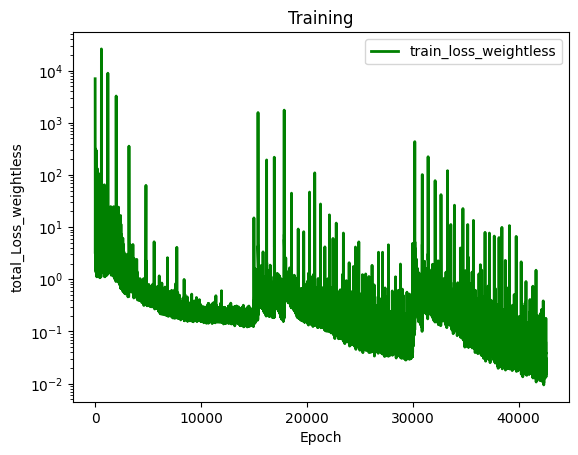

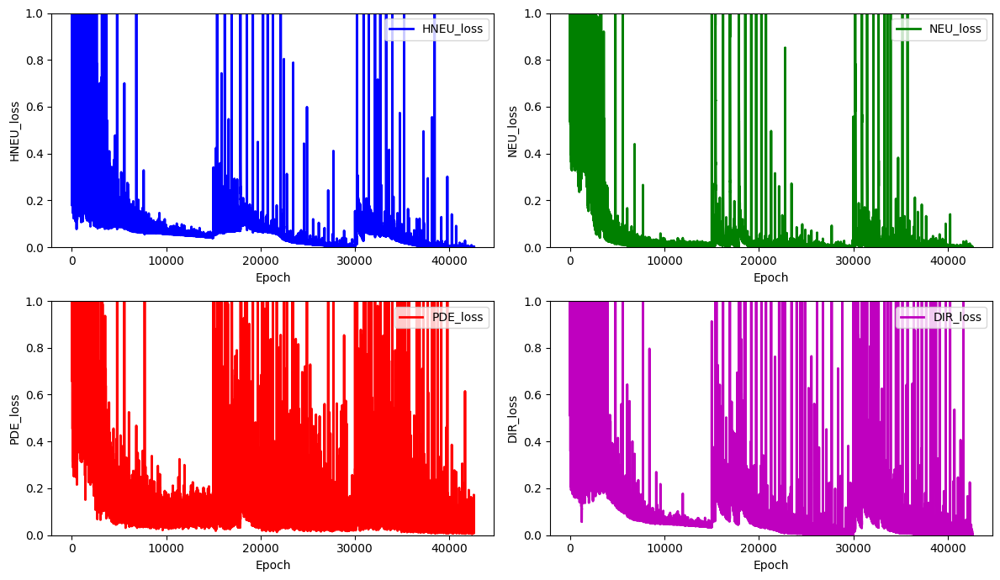

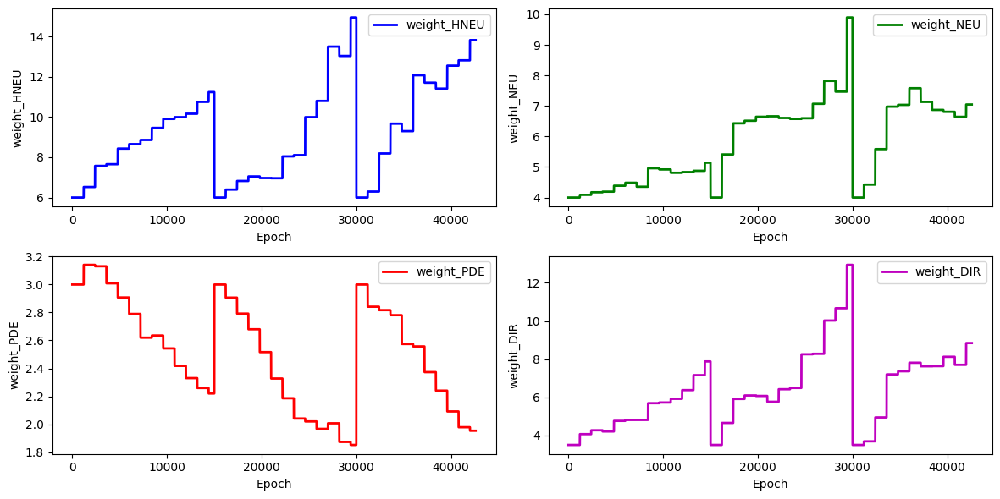

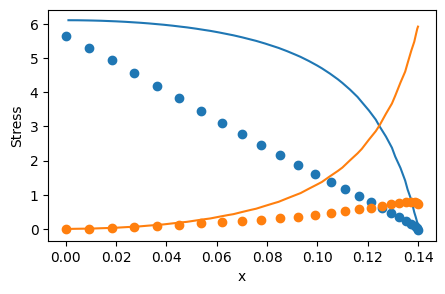

 88%|████████▊ | 13199/15000 [5:26:13<41:54,  1.40s/it]  

adopting weights after 1200 epochs
for weight 0 new weight_value: 15.806468658937327
for weight 1 new weight_value: 7.661619580375169
for weight 2 new weight_value: 1.935953553342704
for weight 3 new weight_value: 13.404863579936908
total_loss: 0.018488007348716782, hole_loss:  0.0010674988304415873, neumann_loss:  0.0005098871037637952, pde_loss: 0.01557966212976665, dirichlet_loss: 0.0013309592847447478


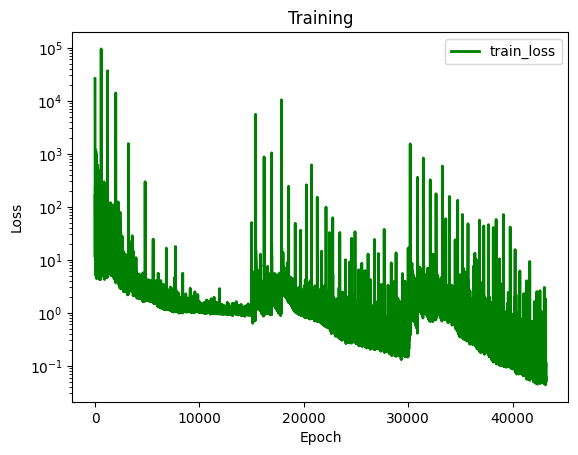

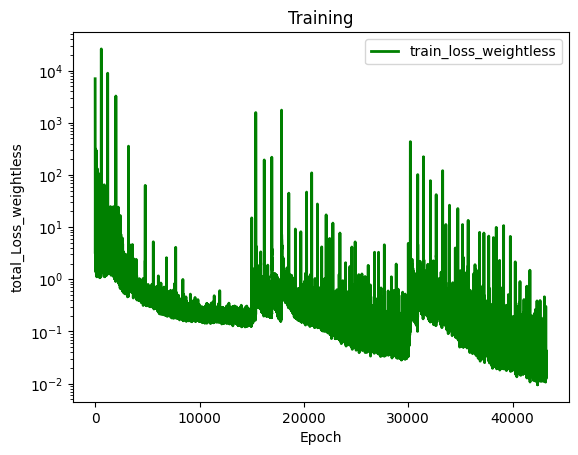

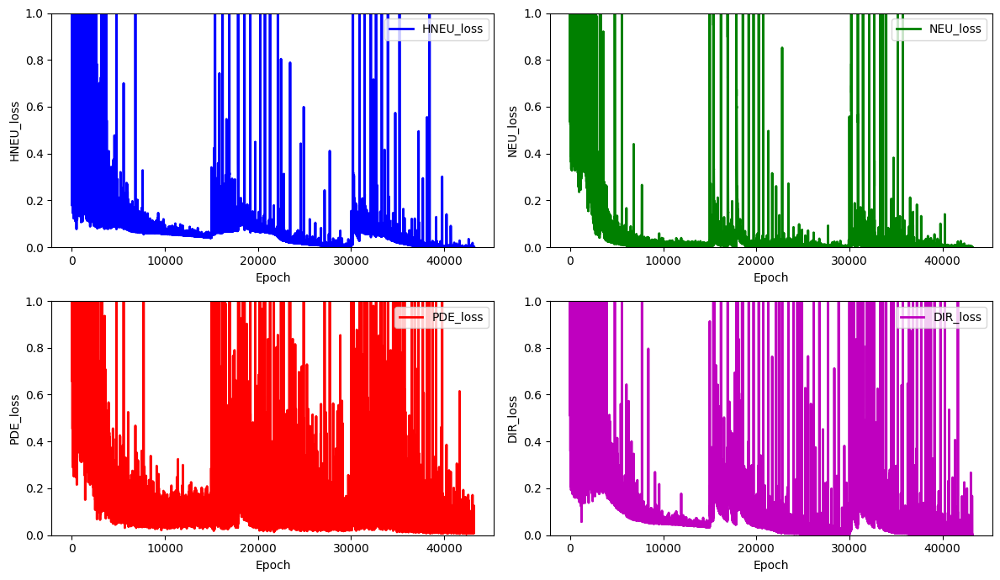

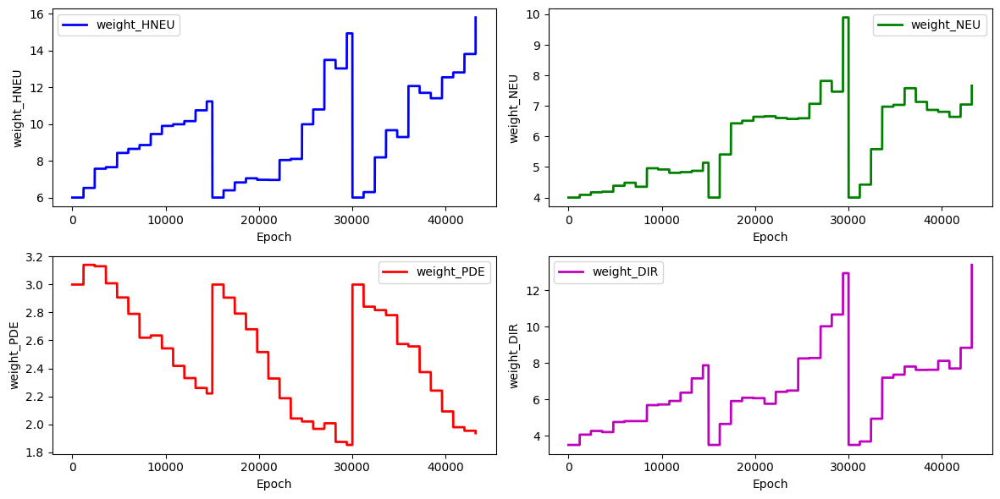

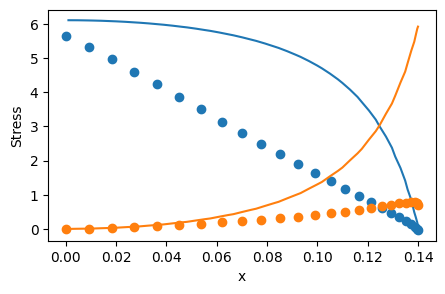

 92%|█████████▏| 13799/15000 [5:41:02<29:24,  1.47s/it]  

total_loss: 0.02748132947771329, hole_loss:  0.0012056971166264877, neumann_loss:  0.0012296139207384179, pde_loss: 0.0222854270728301, dirichlet_loss: 0.0027605913675182877


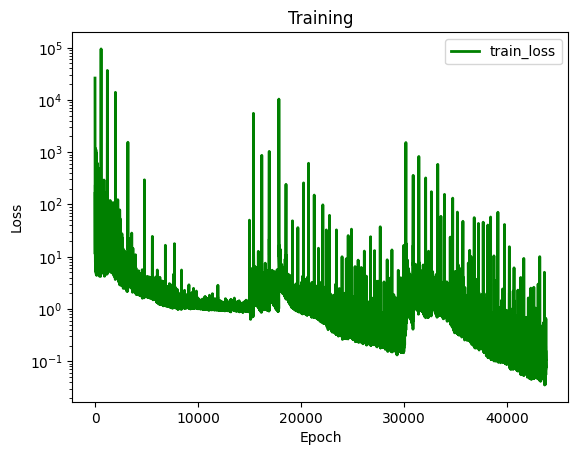

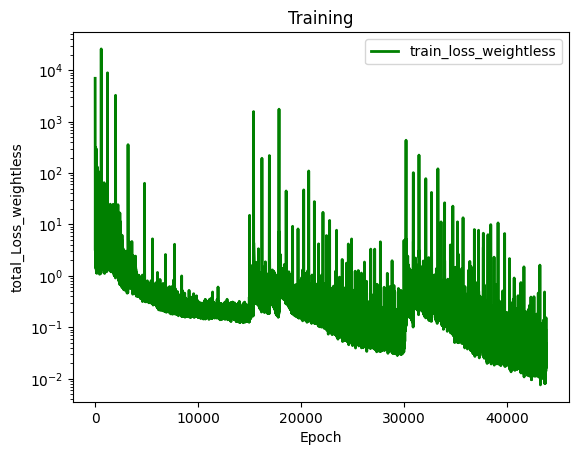

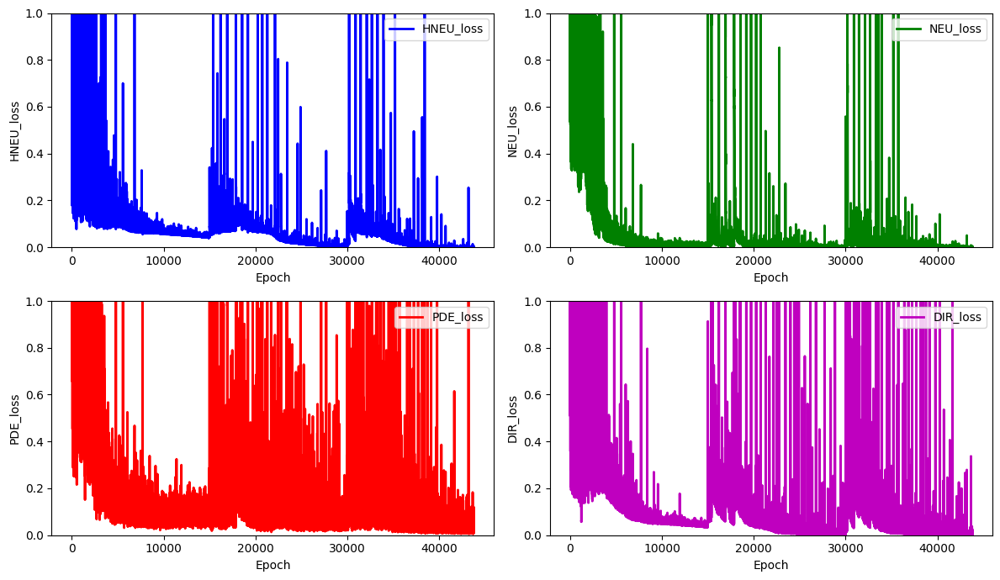

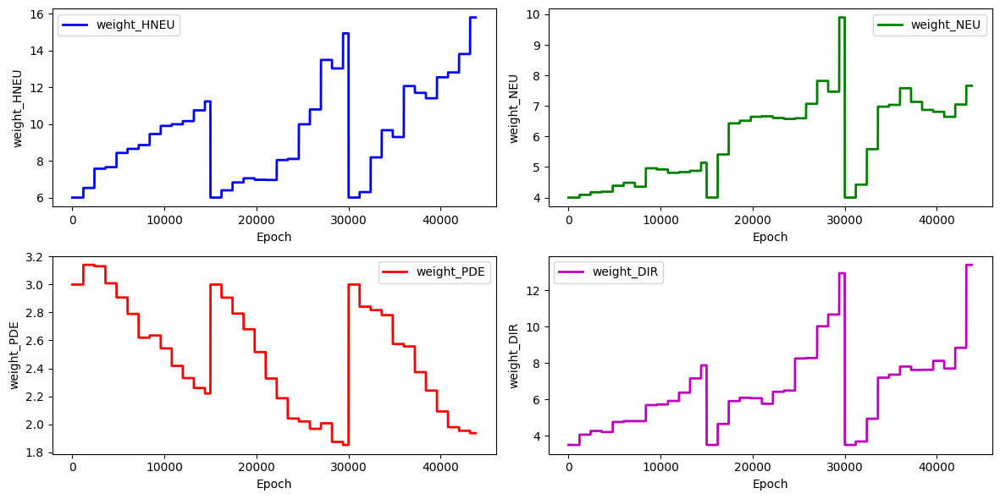

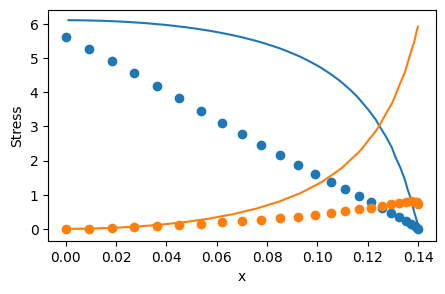

 96%|█████████▌| 14399/15000 [5:54:49<13:37,  1.36s/it]

adopting weights after 1200 epochs
for weight 0 new weight_value: 16.467674960534872
for weight 1 new weight_value: 7.537743026894711
for weight 2 new weight_value: 1.867333858544988
for weight 3 new weight_value: 14.298668068995424
total_loss: 0.022942636304764487, hole_loss:  0.0010318069289178156, neumann_loss:  0.0003288641639437168, pde_loss: 0.019666947511906733, dirichlet_loss: 0.0019150176999962222


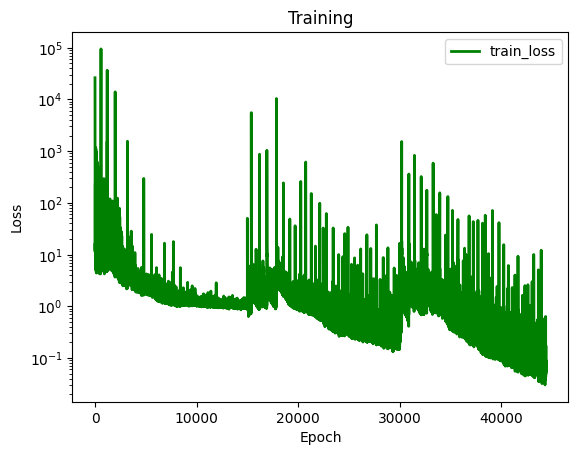

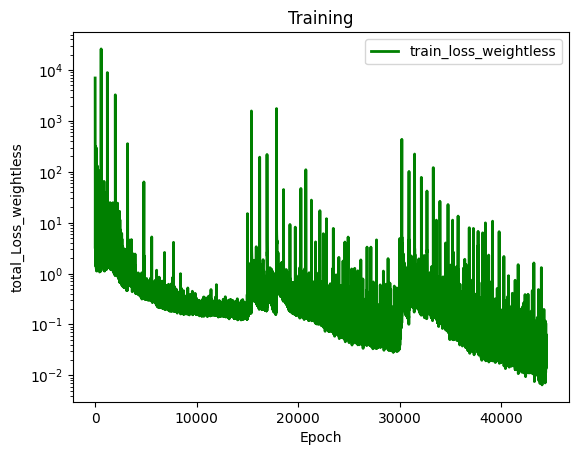

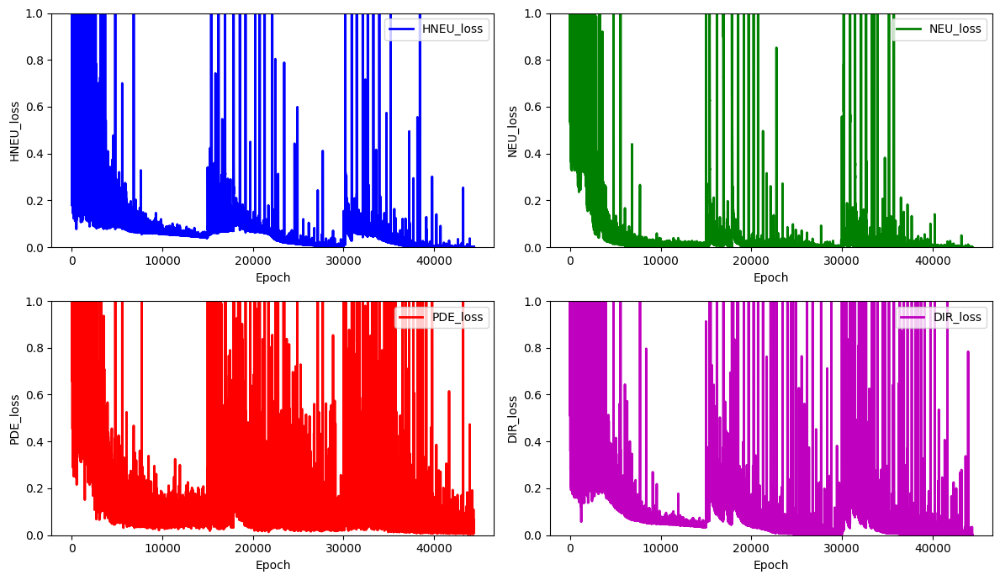

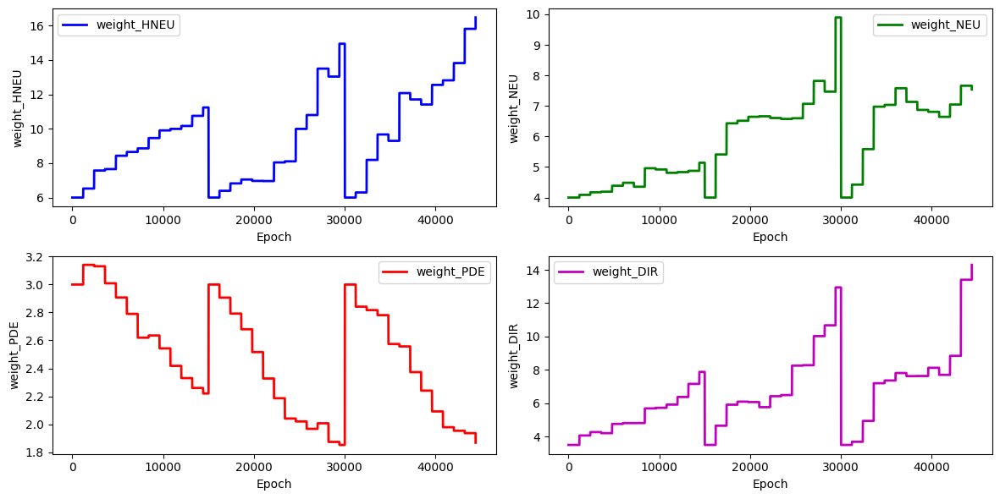

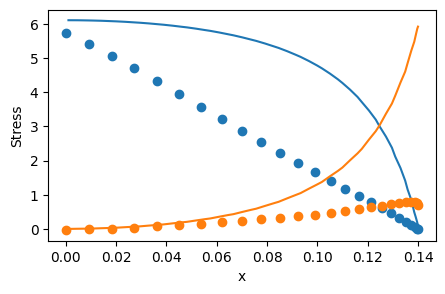

100%|█████████▉| 14999/15000 [6:09:39<00:01,  1.44s/it]

total_loss: 0.06509049598787597, hole_loss:  0.001744609004961808, neumann_loss:  0.0008164360179670964, pde_loss: 0.06172896459486902, dirichlet_loss: 0.0008004863700780549


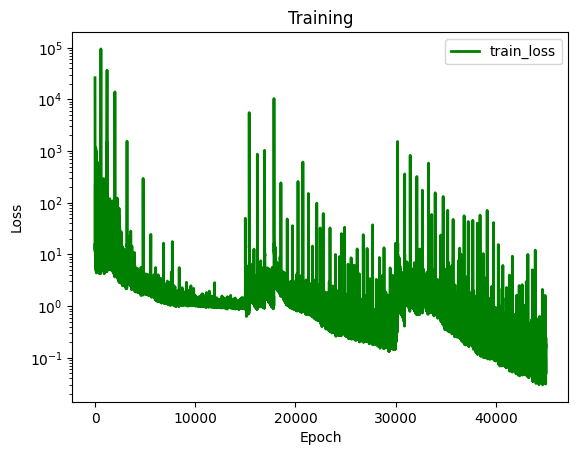

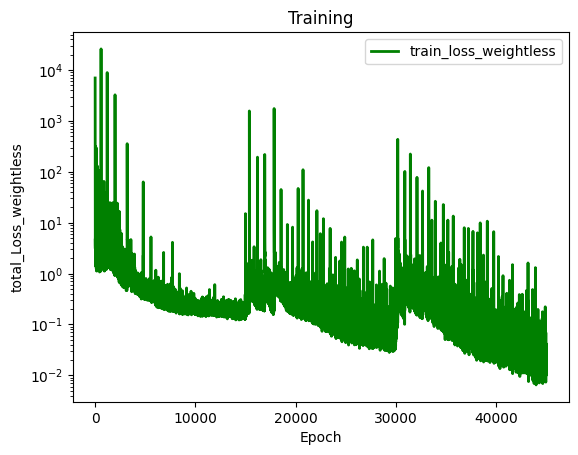

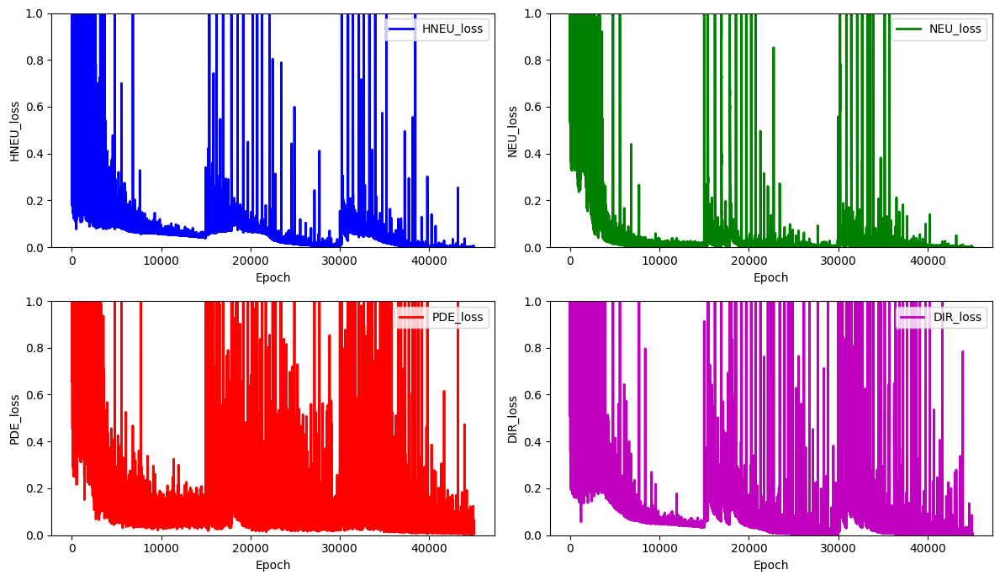

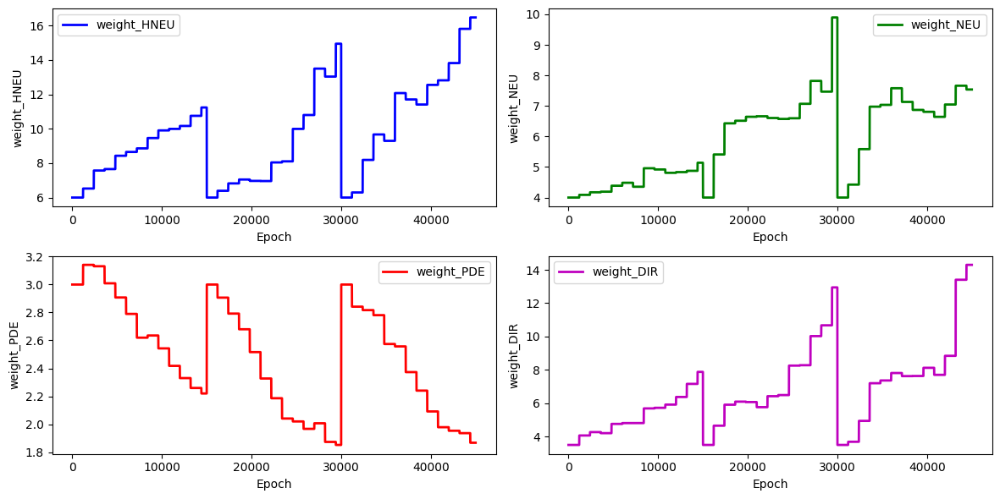

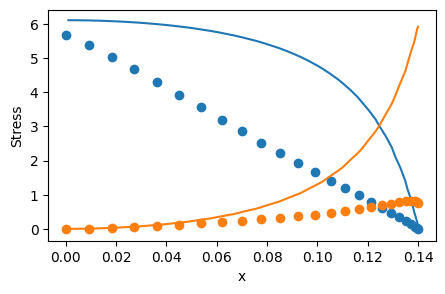

100%|██████████| 15000/15000 [6:09:43<00:00,  1.48s/it]

total_loss: 0.06509049598787597, hole_loss:  0.001744609004961808, neumann_loss:  0.0008164360179670964, pde_loss: 0.06172896459486902, dirichlet_loss: 0.0008004863700780549
previous lowest lost  0.17715327509155687
lowest loss 0.1615982134686952 archived, PINN is saved: 'net_param/net_0.16159821.pth


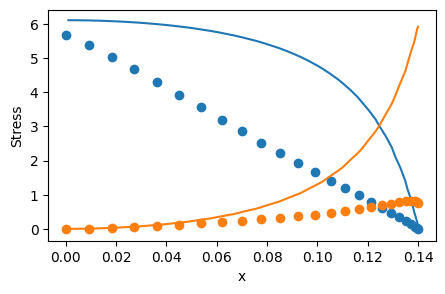

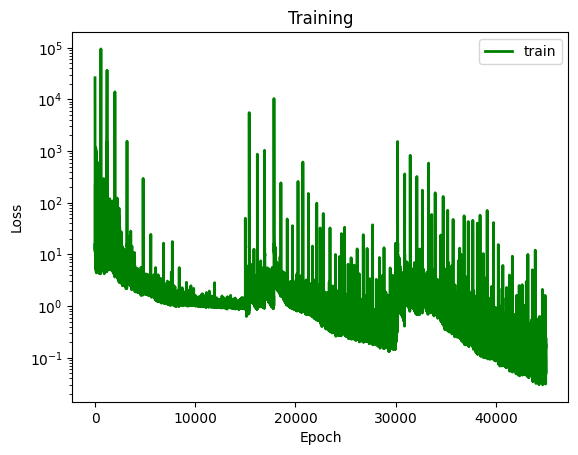

Weight_HNEU: 6.0, Weight_NEU: 4.0, Weight_PDE: 3.0, Weight_STRESS: 1.0, Stress Error: 11.755595968907267


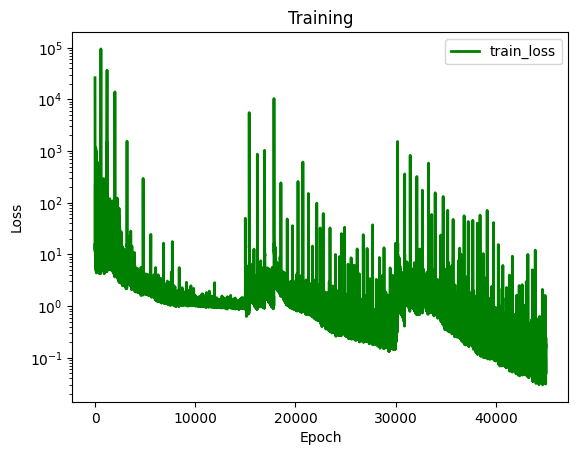

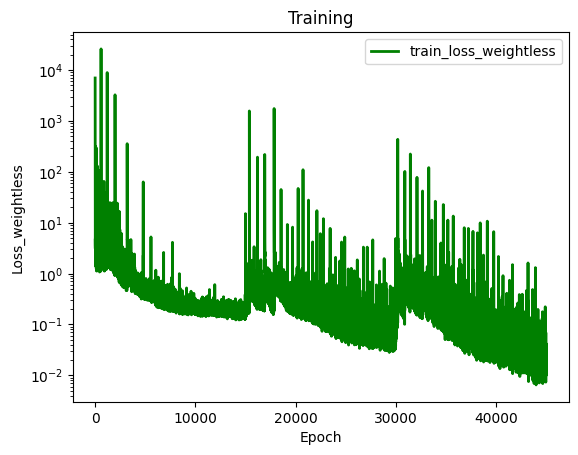

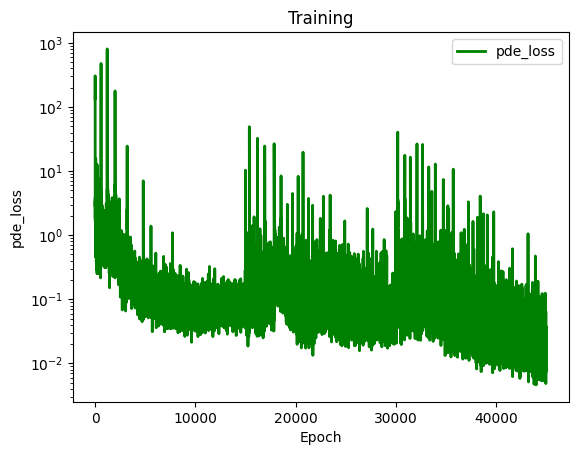

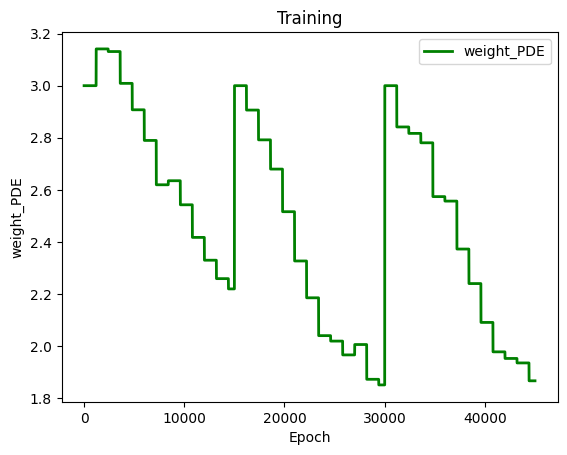

In [40]:

#scheduler = ExponentialLR(optimizer, gamma=0.999)
loss_history = []
HNEU_loss_history = []
PDE_loss_history = []
NEU_loss_history = []
DIR_loss_history = []
loss_weightless_history = []
weightHNEU_history = []
weightNEU_history = []
weightPDE_history = []
weightDIR_history = []


# Weight of PDE lossWeight_NEU: 1.8841683879627231e-06, Weight_PDE: 3.1355081392423563e-06
# Weight of Neumann loss explicitly for the right and top boundary condition
W_NEU = 6.4531255763296895e-06 #previous value -> 1.88e-06
# Weight of Neumann loss explicitly for the hole boundary condition
W_HNEU = 8.2e-05
W_PDE = 8.376708219353885e-06 #previous value -> 3.14e-06
# Weight of data losses
W_DIR = 1.0
W_STRESS = 0.0 #previous value -> 1.0e-07 
W_DISP = 0.0


target_loss = torch.tensor(5)

#Weight_NEU and Weight_PDE 
Weight_NEU = torch.tensor(W_NEU, requires_grad=True) #previous value -> 6.4531255763296895e-06
Weight_HNEU = torch.tensor(W_HNEU, requires_grad=True)
Weight_PDE = torch.tensor(W_PDE, requires_grad=True) #previous value -> 8.376708219353885e-06
Weight_DIR = torch.tensor(W_DIR, requires_grad=True)
Weight_STRESS = torch.tensor(W_STRESS, requires_grad=True)

#set all weights to 1 
Weight_NEU = torch.tensor(4.0, requires_grad=True) #previous value -> 6.4531255763296895e-06
Weight_HNEU = torch.tensor(6.0, requires_grad=True)
Weight_PDE = torch.tensor(3.0, requires_grad=True) #previous value -> 8.376708219353885e-06
Weight_DIR = torch.tensor(3.5, requires_grad=True)
Weight_STRESS = torch.tensor(1.0, requires_grad=True)


char_HNEU_loss= torch.tensor(0.3)#torch.tensor(0.029125697950096088)
char_NEU_loss = torch.tensor(0.3) #torch.tensor(0.7272956427332002)
char_pde_loss = torch.tensor(0.6)#torch.tensor(0.6245099393893354)
char_dirichlet_loss = torch.tensor(5.10e-05)#torch.tensor(1.10e-06)

# #constants for weight and Loss Non-dimensionalization
# slope = 1
# # Aggregate losses

# # Compute physics losses
# left_l, right_l, bottom_l, top_l, hole_l, pde_l = compute_physics_losses(collocation, top, right, left, bottom, hole)
# dirichlet_losses = left_l + bottom_l 
# neumann_losses = right_l + top_l 
# hole_neumann_losses = hole_l
# loss = (
#     dirichlet_losses
#     + Weight_NEU * neumann_losses
#     + Weight_HNEU * hole_neumann_losses
#     + Weight_PDE * pde_l
# )
# #selecting characteristic values:
# char_HNEU_loss= 0.029125697950096088, 
# char_NEU_loss = 0.7272956427332002
# char_pde_loss = 0.6245099393893354
# char_dirichlet_loss: 1.1044902637681307e-06

# #non dimensionalization of the loss function
# hole_neumann_losses_nd = hole_l / char_HNEU_loss
# neumann_losses_nd = (right_l + top_l) / char_NEU_loss
# pde_losses_nd = pde_l / char_pde_loss
# dirichlet_losses_nd = (left_l + bottom_l) / char_dirichlet_loss

# #compute total loss
# loss = (
#     Weight_HNEU * hole_neumann_losses_nd 
#     + Weight_NEU * neumann_losses_nd 
#     + Weight_PDE * pde_losses_nd 
#     + Weight_DIR * dirichlet_losses_nd 
# )





def training(compare_rad_x, target_loss):

    #reset all net parameters 
    #net.apply(weight_reset)

    #hyperparameter weights
    weights = [Weight_HNEU, Weight_NEU, Weight_PDE, Weight_DIR]
    
    
    p1 = Plate(compare_rad_x, N, M) 
    data_input, data_output, data_hole = p1.load_reference_data()
    compare_collo, compare_top, compare_right, compare_left, compare_bottom, compare_hole = p1.generate_dataset()

    #collocation, top, right, left, bottom, hole = generate_multiple_plates(0.04, 0.18, 0.01)
    collocation, top, right, left, bottom, hole = generate_multiple_plates(0.14, 0.14, 0.0)
    data_hole = data_hole.numpy()
    data_hole = data_hole[data_hole[:, 0].argsort()]
    data_stress_x = data_hole[:, 2]
    data_stress_y = data_hole[:, 3]

    #interpolate data_stress_x and data_stress_y
    f_stress_x = interp1d(data_hole[:, 0], data_hole[:, 2], kind='cubic')
    f_stress_y = interp1d(data_hole[:, 0], data_hole[:, 3], kind='cubic')
    x_new = np.linspace(data_hole[:, 0][-1], data_hole[:, 0][0], compare_hole[:, 0].size(dim=0))
    y_stress_x = f_stress_x(x_new)
    y_stress_y = f_stress_y(x_new)

    optimizer = torch.optim.Adam(net.parameters(), lr=lr)
    scheduler = StepLR(optimizer, step_size=scheduler_step, gamma=scheduler_gamma)
    #scheduler = ExponentialLR(optimizer,  gamma= expo_gamma)
    print("Starting with Adam optimizer...")
    for epoch in tqdm(range(epochs)):

        # Reset batch count at the start of each epoch
        batch_count = 0

        #norm_of_weights_list for L2 norm computation (for updating weights during training)
        norm_grad_HNEU_loss_list = []
        norm_grad_NEU_loss_list = []
        norm_grad_PDE_loss_list = []
        norm_grad_DIR_loss_list = []
        # Permutation to shuffle collocation points randomly in each epoch
        permutation = torch.randperm(collocation.size()[0])

        for i in range(0, collocation.size()[0], batch_size):
            indices = permutation[i : i + batch_size]
            collo = collocation[indices]
            optimizer.zero_grad()

            # Compute physics losses
            left_l, right_l, bottom_l, top_l, hole_l, pde_l = compute_physics_losses(collo, top, right, left, bottom, hole)

            if W_DISP < 1E-10 and W_STRESS < 1E-10:
                # No data losses needed (we can accelerate training by skipping this part)
                stress_l = 0.0
                disp_l = 0.0
            else:
                # Get samples from reference solution
                samples = torch.randperm(data_output.size()[0])[::100]
                # Reference solutions
                s_data = data_output[samples, 0:3]
                e_data = data_output[samples, 4:7]
                u_data = data_output[samples, 7:10]
                # Predictions
                s_pred = torch.vmap(sigma)(data_input[samples, 0:3])
                e_pred = torch.vmap(epsilon)(data_input[samples, 0:3])
                u_pred = net(data_input[samples, 0:3])
                # Compute data losses
                ds_xx = mse(s_data[:, 0], s_pred[:, 0, 0])
                ds_yy = mse(s_data[:, 1], s_pred[:, 1, 1])
                ds_xy = mse(s_data[:, 2], s_pred[:, 0, 1])
                stress_l = ds_xx + ds_yy + ds_xy
                du_x = mse(u_data[:, 0], u_pred[:, 0])
                du_y = mse(u_data[:, 1], u_pred[:, 1])
                disp_l = du_x + du_y

            # Aggregate losses
            # dirichlet_losses = left_l + bottom_l 
            # neumann_losses = right_l + top_l 
            # hole_neumann_losses = hole_l
            # loss = (
            #     dirichlet_losses
            #     + Weight_NEU * neumann_losses
            #     + Weight_HNEU * hole_neumann_losses
            #     + Weight_PDE * pde_l
            #     + Weight_STRESS * stress_l
            #     #+ W_DISP * disp_l
            # )

            #non dimensionalization of the loss function
            hole_neumann_losses_nd = hole_l / char_NEU_loss
            neumann_losses_nd = (right_l + top_l) / char_NEU_loss
            total_neumann_loss_nd = (right_l + top_l + hole_l) / char_NEU_loss
            pde_losses_nd = pde_l / char_pde_loss
            dirichlet_losses_nd = (left_l + bottom_l) / char_dirichlet_loss

            # if epoch <= HNEU_split *epochs:
            #     loss = (
            #             weights[1] * total_neumann_loss_nd  #Weight_NEU
            #             + weights[2] * pde_losses_nd #Weight_PDE 
            #             + weights[3] * dirichlet_losses_nd #Weight_DIR
            #             )
                
            #     loss_weightless = (
            #         hole_neumann_losses_nd 
            #         + neumann_losses_nd 
            #         + pde_losses_nd 
            #         + dirichlet_losses_nd 
            #     )
            # else: 
            loss = (
                    weights[0] * hole_neumann_losses_nd #Weight_HNEU 
                    + weights[1] * neumann_losses_nd  #Weight_NEU
                    + weights[2] * pde_losses_nd #Weight_PDE 
                    + weights[3] * dirichlet_losses_nd #Weight_DIR
                    )
            
            loss_weightless = (
                hole_neumann_losses_nd 
                + neumann_losses_nd 
                + pde_losses_nd 
                + dirichlet_losses_nd 
            )
            


            if (epoch+1) % step_size == 0:
                #print(f"Epoch {epoch+1}, batch {batch_count}: computing gradients")
                # Get only the weight parameters
                weight_params = [param for name, param in net.named_parameters() if 'weight' in name]

                # Compute gradients for each loss
                grad_hole_neumann_losses_nd = torch.autograd.grad(hole_neumann_losses_nd, weight_params, retain_graph=True)[0]
                grad_neumann_losses_nd = torch.autograd.grad(neumann_losses_nd, weight_params, retain_graph=True)[0]
                grad_pde_losses_nd = torch.autograd.grad(pde_losses_nd, weight_params, retain_graph=True)[0]
                grad_dirichlet_losses_nd = torch.autograd.grad(dirichlet_losses_nd, weight_params, retain_graph=True)[0]

                # Compute L2 norm for each gradient
                norm_grad_hole_neumann_losses_nd = torch.linalg.norm(grad_hole_neumann_losses_nd)
                norm_grad_neumann_losses_nd = torch.linalg.norm(grad_neumann_losses_nd)
                norm_grad_pde_losses_nd = torch.linalg.norm(grad_pde_losses_nd)
                norm_grad_dirichlet_losses_nd = torch.linalg.norm(grad_dirichlet_losses_nd)

                norm_grad_HNEU_loss_list.append(norm_grad_hole_neumann_losses_nd)
                norm_grad_NEU_loss_list.append(norm_grad_neumann_losses_nd)
                norm_grad_PDE_loss_list.append(norm_grad_pde_losses_nd)
                norm_grad_DIR_loss_list.append(norm_grad_dirichlet_losses_nd)

                # # Print the shape of each weight parameter
                # for weight in weight_params:
                #     print("weight_shape: ", weight.shape)

                # print("Gradient for hole_neumann_losses_nd: ", grad_hole_neumann_losses_nd.shape)
                # print("Gradient for neumann_losses_nd: ", grad_neumann_losses_nd.shape)
                # print("Gradient for pde_losses_nd: ", grad_pde_losses_nd.shape)
                # print("Gradient for dirichlet_losses_nd: ", grad_dirichlet_losses_nd.shape)

                # print("L2 norm of gradient for hole_neumann_losses_nd: ", norm_grad_hole_neumann_losses_nd)
                # print("L2 norm of gradient for neumann_losses_nd: ", norm_grad_neumann_losses_nd)
                # print("L2 norm of gradient for pde_losses_nd: ", norm_grad_pde_losses_nd)
                # print("L2 norm of gradient for dirichlet_losses_nd: ", norm_grad_dirichlet_losses_nd)

            # Make optimization step after batch
            loss.backward(retain_graph=True)

            optimizer.step()

            batch_count += 1     
            
            
        #update non dimensionalizated weights 
        if (epoch+1) % step_size == 0:
            print(f"adopting weights after {step_size} epochs")
            new_weights = [Weight_HNEU, Weight_NEU, Weight_PDE, Weight_DIR]

            norm_grad_losses_nd = [np.mean(norm_grad_HNEU_loss_list), np.mean(norm_grad_NEU_loss_list), 
                                   np.mean(norm_grad_PDE_loss_list), np.mean(norm_grad_DIR_loss_list)]
            with torch.no_grad():
                for index, weight in enumerate(weights):
                    # print(f"Gradient of weight: {index} w.r.t to L: {weight.grad}, old_weight: {weight}")
                    # print("weights_grad", weights[index].grad)
                    # print("zeros", torch.zeros(1))
                    # print("mse_of_weights_grad", mse(weights[index].grad, torch.zeros(1)))
                    # print("squared_error of weights_grad", weights[index].grad*weights[index].grad)

                    # Compute sum of all gradients for each loss
                    weight_grad_sum = (
                        norm_grad_hole_neumann_losses_nd
                        + norm_grad_neumann_losses_nd
                        + norm_grad_pde_losses_nd
                        + norm_grad_dirichlet_losses_nd
                    )

                    new_weights[index] = weight_grad_sum/ norm_grad_losses_nd[index]

                #update new weights
                for index, weight in enumerate(weights):
                    new_weight = 0.9*weight + 0.1*new_weights[index]
                    weights[index] = new_weight.clone().detach().requires_grad_(True)
                    print(f"for weight {index} new weight_value: {weights[index]}")

        # Make scheduler step after full epoch
        scheduler.step()  

  
        
        # append loss to history (=for plotting)
        with torch.autograd.no_grad():
            loss_history.append(float(loss.data))
            loss_weightless_history.append(float(loss_weightless.data))
            HNEU_loss_history.append(float(hole_neumann_losses_nd))
            NEU_loss_history.append(float(neumann_losses_nd))
            PDE_loss_history.append(float(pde_losses_nd))
            DIR_loss_history.append(float(dirichlet_losses_nd))
            weightHNEU_history.append(float(weights[0]))
            weightNEU_history.append(float(weights[1]))
            weightPDE_history.append(float(weights[2]))
            weightDIR_history.append(float(weights[3]))
            

        #print progress during training
        if (epoch+1) % (step_size*0.5) == 0:
            print(f"total_loss: {loss_weightless.data}, hole_loss:  {hole_neumann_losses_nd}, neumann_loss:  {neumann_losses_nd}, pde_loss: {pde_losses_nd}, dirichlet_loss: {dirichlet_losses_nd}")
            
            with torch.autograd.no_grad():
                plt.plot(loss_history, c='g', label='train_loss', linewidth=2.0)
                plt.yscale("log")
                plt.title("Training")
                plt.ylabel("Loss")
                plt.xlabel("Epoch")
                plt.legend()
                plt.show()

                plt.plot(loss_weightless_history, c='g', label='train_loss_weightless', linewidth=2.0)
                plt.yscale("log")
                plt.title("Training")
                plt.ylabel("total_Loss_weightless")
                plt.xlabel("Epoch")
                plt.legend()
                plt.show()

                fig, axs = plt.subplots(2, 2, figsize=(12, 7))

                # plot for HNEU_loss_history
                axs[0, 0].plot(HNEU_loss_history, c='b', label='HNEU_loss', linewidth=2.0)
                axs[0, 0].set_ylabel("HNEU_loss")
                axs[0, 0].set_xlabel("Epoch")
                axs[0, 0].legend()
                axs[0, 0].set_ylim([0, 1])  

                # plot for NEU_loss_history
                axs[0, 1].plot(NEU_loss_history, c='g', label='NEU_loss', linewidth=2.0)
                axs[0, 1].set_ylabel("NEU_loss")
                axs[0, 1].set_xlabel("Epoch")
                axs[0, 1].legend()
                axs[0, 1].set_ylim([0, 1])  

                # plot for PDE_loss_history
                axs[1, 0].plot(PDE_loss_history, c='r', label='PDE_loss', linewidth=2.0)
                axs[1, 0].set_ylabel("PDE_loss")
                axs[1, 0].set_xlabel("Epoch")
                axs[1, 0].legend()
                axs[1, 0].set_ylim([0, 1])  

                # plot for DIR_loss_history
                axs[1, 1].plot(DIR_loss_history, c='m', label='DIR_loss', linewidth=2.0)
                axs[1, 1].set_ylabel("DIR_loss")
                axs[1, 1].set_xlabel("Epoch")
                axs[1, 1].legend()
                axs[1, 1].set_ylim([0, 1]) 

                plt.tight_layout()
                plt.show()




                fig, axs = plt.subplots(2, 2, figsize=(12, 6))

                # plot for weightHNEU_history
                axs[0, 0].plot(weightHNEU_history, c='b', label='weight_HNEU', linewidth=2.0)
                axs[0, 0].set_ylabel("weight_HNEU")
                axs[0, 0].set_xlabel("Epoch")
                axs[0, 0].legend()

                # plot for weightNEU_history
                axs[0, 1].plot(weightNEU_history, c='g', label='weight_NEU', linewidth=2.0)
                axs[0, 1].set_ylabel("weight_NEU")
                axs[0, 1].set_xlabel("Epoch")
                axs[0, 1].legend()

                #plot for weightPDE_history
                axs[1, 0].plot(weightPDE_history, c='r', label='weight_PDE', linewidth=2.0)
                axs[1, 0].set_ylabel("weight_PDE")
                axs[1, 0].set_xlabel("Epoch")
                axs[1, 0].legend()

                # plot for weightDIR_history
                axs[1, 1].plot(weightDIR_history, c='m', label='weight_DIR', linewidth=2.0)
                axs[1, 1].set_ylabel("weight_DIR")
                axs[1, 1].set_xlabel("Epoch")
                axs[1, 1].legend()

                plt.tight_layout()
                plt.show()

                # compare computed stressError(PINN) with actual stressError
                stress_hole = torch.vmap(sigma)(compare_hole[:, :-2])
                stressError = mse(stress_hole[:, 0, 0], torch.tensor(y_stress_x)) + mse(stress_hole[:, 1, 1], torch.tensor(y_stress_y))

                #weight_history.append(float(mse_error.data))
                plt.figure(figsize=(5, 3))
                plt.plot(compare_hole[:, 0], stress_hole[:, 0, 0], "o", color="tab:blue", label="σ_xx (PINN)")
                plt.plot(data_hole[:, 0], data_hole[:, 2], "-", color="tab:blue", label="σ_xx (FEM)")
                plt.plot(compare_hole[:, 0], stress_hole[:, 1, 1], "o", color="tab:orange", label="σ_yy (PINN)")
                plt.plot(data_hole[:, 0], data_hole[:, 3], "-", color="tab:orange", label="σ_yy (FEM)")
                plt.xlabel("x")
                plt.ylabel("Stress")
                #plt.legend()
                plt.show()


    print(f"total_loss: {loss_weightless.data}, hole_loss:  {hole_neumann_losses_nd}, neumann_loss:  {neumann_losses_nd}, pde_loss: {pde_losses_nd}, dirichlet_loss: {dirichlet_losses_nd}")

    # compare computed stressError(PINN) with actual stressError
    stress_hole = torch.vmap(sigma)(compare_hole[:, :-2])
    stressError = mse(stress_hole[:, 0, 0], torch.tensor(y_stress_x)) + mse(stress_hole[:, 1, 1], torch.tensor(y_stress_y))

    lowest_loss = target_loss
    if(loss.data < target_loss):
        print(f"previous lowest lost  {target_loss}")
        lowest_loss = loss.data
        print(f"lowest loss {lowest_loss} archived, PINN is saved: 'net_param/net_{lowest_loss:.8f}.pth")
        torch.save(net.state_dict(), f'net_param/net_{lowest_loss:.8f}.pth')
    return stressError, data_hole, stress_hole, compare_hole, lowest_loss


# weights_optimizer = torch.optim.Adam([Weight_NEU, Weight_PDE], lr=1)
# weights_scheduler = ExponentialLR(weights_optimizer, gamma=1)
net = Net()
for i in range(3):
#weights_optimizer.zero_grad()
    mse_error, data_hole, stress_hole, hole, lowest_loss = training(0.14, target_loss)
    target_loss = lowest_loss

    #mse_error.backward()
    #weights_optimizer.step()
    #weights_scheduler.step()

    #save net parameters
    #torch.save(net.state_dict(), f'net_param/net_{rad_x:.2f}.pth')


    with torch.autograd.no_grad():
        #weight_history.append(float(mse_error.data))
        plt.figure(figsize=(5, 3))
        plt.plot(hole[:, 0], stress_hole[:, 0, 0], "o", color="tab:blue", label="σ_xx (PINN)")
        plt.plot(data_hole[:, 0], data_hole[:, 2], "-", color="tab:blue", label="σ_xx (FEM)")
        plt.plot(hole[:, 0], stress_hole[:, 1, 1], "o", color="tab:orange", label="σ_yy (PINN)")
        plt.plot(data_hole[:, 0], data_hole[:, 3], "-", color="tab:orange", label="σ_yy (FEM)")
        plt.xlabel("x")
        plt.ylabel("Stress")
        #plt.legend()
        plt.show()

        plt.plot(loss_history, c='g', label='train', linewidth=2.0)
        plt.yscale("log")
        plt.title("Training")
        plt.ylabel("Loss")
        plt.xlabel("Epoch")
        plt.legend()
        plt.show()
    
    # print weights and stress error and modify weight values for the next iteration
    print(f"Weight_HNEU: {Weight_HNEU.item()}, Weight_NEU: {Weight_NEU.item()}, Weight_PDE: {Weight_PDE.item()}, Weight_STRESS: {Weight_STRESS.item()}, Stress Error: {mse_error.item()}") 
    #Weight_STRESS = Weight_STRESS *1/1.1
    # Weight_NEU = Weight_NEU * (1.1/1.0)
    # Weight_PDE = Weight_PDE * (1.1/1.0)
    # Weight_HNEU = Weight_HNEU * (1.1/1.0)

#plt.figure(figsize=(8, 4))
plt.plot(loss_history, c='g', label='train_loss', linewidth=2.0)
plt.yscale("log")
plt.title("Training")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.legend()
plt.show()

plt.plot(loss_weightless_history, c='g', label='train_loss_weightless', linewidth=2.0)
plt.yscale("log")
plt.title("Training")
plt.ylabel("Loss_weightless")
plt.xlabel("Epoch")
plt.legend()
plt.show()

plt.plot(PDE_loss_history, c='g', label='pde_loss', linewidth=2.0)
plt.yscale("log")
plt.title("Training")
plt.ylabel("pde_loss")
plt.xlabel("Epoch")
plt.legend()
plt.show()

plt.plot(weightPDE_history, c='g', label='weight_PDE', linewidth=2.0)
plt.title("Training")
plt.ylabel("weight_PDE")
plt.xlabel("Epoch")
plt.legend()
plt.show()




## Visualization of results

In [41]:
val_rad_x = 0.14
val_plate = Plate(val_rad_x, N, M) 
data_input, data_output, data_hole = val_plate.load_reference_data()
val_collo, val_top, val_right, val_left, val_bottom, val_hole = val_plate.generate_dataset()

stress_hole = torch.vmap(sigma)(val_hole[:,:-2])
data_hole = np.loadtxt(f"data/hole_Rx={Rx}.csv", delimiter=",")
data_hole = data_hole[data_hole[:, 0].argsort()]

with torch.no_grad():
    fig = go.Figure()
    m1 = dict(color="blue")
    m2 = dict(color="orange")
    fig.add_trace(
        go.Scatter(
            x=hole[:, 0],
            y=stress_hole[:, 0, 0],
            marker=m1,
            mode="markers",
            name="σ_xx (PINN)",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=data_hole[:, 0],
            y=data_hole[:, 2],
            marker=m1,
            mode="lines",
            name="σ_xx (FEM)",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=hole[:, 0],
            y=stress_hole[:, 1, 1],
            marker=m2,
            mode="markers",
            name="σ_yy (PINN)",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=data_hole[:, 0],
            y=data_hole[:, 3],
            marker=m2,
            mode="lines",
            name="σ_yy (FEM)",
        )
    )
    fig.update_layout(
        template="none", width=600, height=400, title="Stress at hole", showlegend=True
    )
    fig.show()

In [42]:
# Create a validation domain different from the training domain
val_x, val_y = np.meshgrid(np.linspace(0, L, 50), np.linspace(0, L, 50))
val_r = Rx * np.ones(np.shape(val_x))
val_domain = np.vstack([val_x.ravel(), val_y.ravel(), val_r.ravel()]).T
mask = (
    ((val_domain[:, 0] ** 2) / (Rx**2)) + ((val_domain[:, 1] ** 2) / (Ry**2))
) > 1
val = torch.tensor(val_domain[mask], requires_grad=True).double()


# Compute model predictions on the validation domain
disp = net(val)
def_val = val[:, :-1] + disp
stress = torch.vmap(sigma)(val)
mises = torch.sqrt(
    stress[:, 0, 0] ** 2
    + stress[:, 1, 1] ** 2
    - stress[:, 0, 0] * stress[:, 1, 1]
    + 3 * stress[:, 0, 1] ** 2
)
# print([loss.item() for loss in compute_les(val)])


@torch.no_grad()
def make_plot(x, y, variable, title, cmap=sequential.Viridis, size=8.0):
    fig = go.Figure()

    # Plot boundaries
    m = dict(color="black")
    fig.add_trace(go.Scatter(x=top[:, 0], y=top[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=bottom[:, 0], y=bottom[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=left[:, 0], y=left[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=right[:, 0], y=right[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=hole[:, 0], y=hole[:, 1], mode="lines", marker=m))

    # Plot variable values
    m = dict(color=variable, colorscale=cmap, size=size, colorbar=dict(thickness=10))
    fig.add_trace(go.Scatter(x=x, y=y, marker=m, mode="markers"))

    # plot settings
    fig.layout.yaxis.scaleanchor = "x"
    fig.update_layout(
        template="none", width=400, height=400, title=title, showlegend=False
    )
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)
    fig.show()


# Compute data error
s_data = data_output[:, 0:3]
s_pred = torch.vmap(sigma)(data_input[:, 0:3])
ds_xx = s_data[:, 0] - s_pred[:, 0, 0]
ds_yy = s_data[:, 1] - s_pred[:, 1, 1]
ds_xy = s_data[:, 2] - s_pred[:, 0, 1]


# Plot stress errors
cmap = sequential.RdBu_r
make_plot(*data_input[:, 0:2].T, ds_xx, "Stress error xx", size=2.0, cmap=cmap)
make_plot(*data_input[:, 0:2].T, ds_yy, "Stress error yy", size=2.0, cmap=cmap)
make_plot(*data_input[:, 0:2].T, ds_xy, "Stress error xy", size=2.0, cmap=cmap)

# Plot stresses
make_plot(*def_val.T, stress[:, 0, 0], "Stress xx")
make_plot(*def_val.T, stress[:, 0, 1], "Stress xy")
make_plot(*def_val.T, stress[:, 1, 1], "Stress yy")
make_plot(*def_val.T, mises, "Mises stress")

# Plot displacements
make_plot(*def_val.T, disp[:, 0], "Displacement in x", cmap=sequential.Inferno)
make_plot(*def_val.T, disp[:, 1], "Displacement in y", cmap=sequential.Inferno)
